# Background & Context

AllLife Bank is a US bank that has a growing customer base. The majority of these customers are liability customers (depositors) with varying sizes of deposits. The number of customers who are also borrowers (asset customers) is quite small, and the bank is interested in expanding this base rapidly to bring in more loan business and in the process, earn more through the interest on loans. In particular, the management wants to explore ways of converting its liability customers to personal loan customers (while retaining them as depositors).

A campaign that the bank ran last year for liability customers showed a healthy conversion rate of over 9% success. This has encouraged the retail marketing department to devise campaigns with better target marketing to increase the success ratio.

You as a Data scientist at AllLife bank have to build a model that will help the marketing department to identify the potential customers (liability customers) who have a higher probability of purchasing the loan.

How do we know who will purchase a loan in the next campaign? By looking at who purchased the loan from the last campaign and predicting the liklihood that they will again accept the loan offer. By answering the question "Did this customer accept the personal loan offered in the last campaign?" we can predict whether they will do so in the future. 


# Objective

* To predict whether a liability customer will buy a personal loan or not.

* Which variables are most significant.

* Which segment of customers should be targeted more.

# Data Dictionary

**Data Dictionary - Loan_Modelling.csv**  (originally from Kaggle: https://www.kaggle.com/krantiswalke/bank-personal-loan-modelling)

5000 rows by 14 columns.

`ID`: Customer ID

`Age`: Customer’s age in completed years

`Experience`: #years of professional experience

`Income`: Annual income of the customer (in thousand dollars)

`ZIP Code`: Home Address ZIP code.

`Family`: the Family size of the customer

`CCAvg`: Average spending on credit cards per month (in thousand dollars) for customers of AllBank.

`Education`: Education Level. 1: Undergrad; 2: Graduate;3: Advanced/Professional

`Mortgage`: Value of house mortgage if any. (in thousand dollars)

`Personal_Loan`: Did this customer accept the personal loan offered in the last campaign?

`Securities_Account`: Does the customer have securities account with the bank?

`CD_Account`: Does the customer have a certificate of deposit (CD) account with the bank?

`Online`: Do customers use internet banking facilities?

`CreditCard`: Does the customer use a credit card issued by any other Bank (excluding All life Bank)?

# Project Statement

**Target variable:** Personal Loan.

**What are we doing?** Prediction based on classification. It's about explanation and accuracy. Choosing simplest model because business has to get a decision. Logistic Regression. .

**What variables explain the change in the taking of a loan or not?**
A Decision Tree can help set up or uncover the business rules to select the right segement of customers.

# Juypter Notebook copy/paste error fix

In [1]:
"""
import nbformat as nbf
from glob import glob

import uuid
def get_cell_id(id_length=8):
    return uuid.uuid4().hex[:id_length]

# your notebook name/keyword
nb_name = 'All_bank'
notebooks = list(filter(lambda x: nb_name in x, glob("./*.ipynb", recursive=True)))

# iterate over notebooks
for ipath in sorted(notebooks):
    # load notebook
    ntbk = nbf.read(ipath, nbf.NO_CONVERT)
    
    cell_ids = []
    for cell in ntbk.cells:
        cell_ids.append(cell['id'])

    # reset cell ids if there are duplicates
    if not len(cell_ids) == len(set(cell_ids)): 
        for cell in ntbk.cells:
            cell['id'] = get_cell_id()

    nbf.write(ntbk, ipath)
"""

'\nimport nbformat as nbf\nfrom glob import glob\n\nimport uuid\ndef get_cell_id(id_length=8):\n    return uuid.uuid4().hex[:id_length]\n\n# your notebook name/keyword\nnb_name = \'All_bank\'\nnotebooks = list(filter(lambda x: nb_name in x, glob("./*.ipynb", recursive=True)))\n\n# iterate over notebooks\nfor ipath in sorted(notebooks):\n    # load notebook\n    ntbk = nbf.read(ipath, nbf.NO_CONVERT)\n    \n    cell_ids = []\n    for cell in ntbk.cells:\n        cell_ids.append(cell[\'id\'])\n\n    # reset cell ids if there are duplicates\n    if not len(cell_ids) == len(set(cell_ids)): \n        for cell in ntbk.cells:\n            cell[\'id\'] = get_cell_id()\n\n    nbf.write(ntbk, ipath)\n'

# Notes

- But here we have a **bool** data type. What should we do here?
- In Python, True and False are cast implicitly into integers:

    `True == 1`
    
    `False == 0`
    
    This means that an algorithm running in pure Python should work without conversion.

# Loading libraries

In [2]:
# install libraries
!pip install plotly==4.14.3
!pip install uszipcode
import sys

!{sys.executable} -m pip install -U pandas-profiling[notebook]
!jupyter nbextension enable --py widgetsnbextension

# data analysis
import pandas as pd
from pandas_profiling import ProfileReport
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import statsmodels.stats.api as sms
import warnings
import uszipcode
from uszipcode import SearchEngine, SimpleZipcode, Zipcode

# modeling building
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier

# model performrance
from sklearn import metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.model_selection import GridSearchCV

# Notebook settings
warnings.filterwarnings("ignore")

pd.set_option(
    "display.max_columns", None
)  # Removes the limit from the number of displayed columns and rows.
pd.set_option("display.max_rows", 200)

pd.set_option(
    "display.float_format", lambda x: "%.2f" % x
)  # To supress numerical display in scientific notations

%load_ext nb_black

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: ok


<IPython.core.display.Javascript object>

# Loading and exploring the data

Loading the data into python to explore and understand it.

### Read data

In [3]:
# read the file
df = pd.read_csv("Loan_Modelling.csv")
print(f"There are {df.shape[0]} rows and {df.shape[1]} columns.")  # f-string

# Create a copy of the dataframe
df = df.copy()


# View shape of the dataframe
print(f"The dataframe shape is {df.shape}")
# I'm now going to look at 10 random rows
# I'm setting the random seed via np.random.seed so that
# I get the same random results every time
np.random.seed(1)
df.sample(n=10)

There are 5000 rows and 14 columns.
The dataframe shape is (5000, 14)


,ID,Age,Experience,Income,ZIPCode,Family,CCAvg,Education,Mortgage,Personal_Loan,Securities_Account,CD_Account,Online,CreditCard
2764,2765,31,5,84,91320,1,2.90,3,105,0,0,0,0,1
4767,4768,35,9,45,90639,3,0.90,1,101,0,1,0,0,0
3814,3815,34,9,35,94304,3,1.30,1,0,0,0,0,0,0
3499,3500,49,23,114,94550,1,0.30,1,286,0,0,0,1,0
2735,2736,36,12,70,92131,3,2.60,2,165,0,0,0,1,0
3922,3923,31,4,20,95616,4,1.50,2,0,0,0,0,1,0
2701,2702,50,26,55,94305,1,1.60,2,0,0,0,0,1,0
1179,1180,36,11,98,90291,3,1.20,3,0,0,1,0,0,1
932,933,51,27,112,94720,3,1.80,2,0,0,1,1,1,1
792,793,41,16,98,93117,1,4.00,3,0,0,0,0,0,1


<IPython.core.display.Javascript object>

In [4]:
# read top rows
df.head(10)

,ID,Age,Experience,Income,ZIPCode,Family,CCAvg,Education,Mortgage,Personal_Loan,Securities_Account,CD_Account,Online,CreditCard
0,1,25,1,49,91107,4,1.60,1,0,0,1,0,0,0
1,2,45,19,34,90089,3,1.50,1,0,0,1,0,0,0
2,3,39,15,11,94720,1,1.00,1,0,0,0,0,0,0
3,4,35,9,100,94112,1,2.70,2,0,0,0,0,0,0
4,5,35,8,45,91330,4,1.00,2,0,0,0,0,0,1
5,6,37,13,29,92121,4,0.40,2,155,0,0,0,1,0
6,7,53,27,72,91711,2,1.50,2,0,0,0,0,1,0
7,8,50,24,22,93943,1,0.30,3,0,0,0,0,0,1
8,9,35,10,81,90089,3,0.60,2,104,0,0,0,1,0
9,10,34,9,180,93023,1,8.90,3,0,1,0,0,0,0


<IPython.core.display.Javascript object>

In [5]:
# read bottom rows
df.tail(10)

,ID,Age,Experience,Income,ZIPCode,Family,CCAvg,Education,Mortgage,Personal_Loan,Securities_Account,CD_Account,Online,CreditCard
4990,4991,55,25,58,95023,4,2.00,3,219,0,0,0,0,1
4991,4992,51,25,92,91330,1,1.90,2,100,0,0,0,0,1
4992,4993,30,5,13,90037,4,0.50,3,0,0,0,0,0,0
4993,4994,45,21,218,91801,2,6.67,1,0,0,0,0,1,0
4994,4995,64,40,75,94588,3,2.00,3,0,0,0,0,1,0
4995,4996,29,3,40,92697,1,1.90,3,0,0,0,0,1,0
4996,4997,30,4,15,92037,4,0.40,1,85,0,0,0,1,0
4997,4998,63,39,24,93023,2,0.30,3,0,0,0,0,0,0
4998,4999,65,40,49,90034,3,0.50,2,0,0,0,0,1,0
4999,5000,28,4,83,92612,3,0.80,1,0,0,0,0,1,1


<IPython.core.display.Javascript object>

In [6]:
# Get the information on the df
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   ID                  5000 non-null   int64  
 1   Age                 5000 non-null   int64  
 2   Experience          5000 non-null   int64  
 3   Income              5000 non-null   int64  
 4   ZIPCode             5000 non-null   int64  
 5   Family              5000 non-null   int64  
 6   CCAvg               5000 non-null   float64
 7   Education           5000 non-null   int64  
 8   Mortgage            5000 non-null   int64  
 9   Personal_Loan       5000 non-null   int64  
 10  Securities_Account  5000 non-null   int64  
 11  CD_Account          5000 non-null   int64  
 12  Online              5000 non-null   int64  
 13  CreditCard          5000 non-null   int64  
dtypes: float64(1), int64(13)
memory usage: 547.0 KB


<IPython.core.display.Javascript object>

+ All data points are numeric.

+ There are no missing values.

+ There are multiple binary (Ordinal) categories. 

Describe the variable classifications based on the questions, "What kind is it?" or "How many? or How much?":

`ID`: Is a categorical nominal variable. Represents many different customers.

`Age`: Will need to check for wierd values. A continous quantative variable. 

`Experience`: Will need to check for wierd values. A quantatitve continuous variable. Could have parts of a year.

`Income`: A continuous quantitative variable. A range that can be computed on.

`ZIP Code`: Seems to be actual zips. It is a categorical nomial variable. Use a frequency table.

`Family`: Looks like normal values. This is a discrete quantative variable. Cannot have parts of a child.

`CCAvg`: In thousand dollars will need to be kept in mind. A continuous quantitative variable.

`Education`: An ordinal categorical variable. Use a frequency table.

`Mortgage`: A variable that is a quantative continous kind. On the same scale as other money-related variables.

`Personal_Loan`: A categorical binary (numeric) variable. *Target variable*

`Securities_Account`: A categorical binary (numeric) variable. Use a frequency table.

`CD_Account`: A categorical binary (numeric) variable. Use a frequency table.

`Online`: A categorical  binary (numeric) variable. Use a frequency table.

`CreditCard`: A categorical binary (numeric) variable. Use a frequency table.

# Data Pre-processing

**Prepare the data for analysis**

### Data-types

In [7]:
# Find object types
df.dtypes

ID                      int64
Age                     int64
Experience              int64
Income                  int64
ZIPCode                 int64
Family                  int64
CCAvg                 float64
Education               int64
Mortgage                int64
Personal_Loan           int64
Securities_Account      int64
CD_Account              int64
Online                  int64
CreditCard              int64
dtype: object

<IPython.core.display.Javascript object>

#### Dropping unneed variables

Customer ID is interesting from a marketing perspective but not the type of thing that we want to be predicting on. We will drop it.

In [8]:
df = df.drop("ID", axis=1, inplace=False)

<IPython.core.display.Javascript object>

### Sanity Check

**Odd values or mixed-dtypes that need correction (data-entry errors)**

`Age` and `Experience` check.

In [9]:
# crosstabs
pd.crosstab(df.Age, df.Experience)

Experience,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43
Age,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
23,2,4,6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
24,2,9,6,11,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
25,0,1,17,17,18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
26,0,0,1,28,22,27,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
27,0,0,0,8,27,20,36,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
28,0,1,0,0,2,29,37,34,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
29,0,0,3,1,0,7,44,26,42,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
30,0,0,0,1,0,0,7,44,40,44,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
31,0,0,0,0,5,0,0,7,54,22,37,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


<IPython.core.display.Javascript object>

It appears that there are no customers that have more experience than warrants their age. But the negative values will need to be handled.

#### Duplicate data

In [10]:
# find dupes
df[df.duplicated()].count()

Age                   0
Experience            0
Income                0
ZIPCode               0
Family                0
CCAvg                 0
Education             0
Mortgage              0
Personal_Loan         0
Securities_Account    0
CD_Account            0
Online                0
CreditCard            0
dtype: int64

<IPython.core.display.Javascript object>

No duplicates found.

#### Unique Values

In [11]:
# check the number of unique values in each column of the dataframe
df.nunique().sort_values(ascending=False)

ZIPCode               467
Mortgage              347
Income                162
CCAvg                 108
Experience             47
Age                    45
Family                  4
Education               3
Personal_Loan           2
Securities_Account      2
CD_Account              2
Online                  2
CreditCard              2
dtype: int64

<IPython.core.display.Javascript object>

All customers in many different geographic areas with a scale of mortgage sizes and a smaller range of incomes. A smaller range on spending on credit cards for customers with a broader range of experience than age. There are only 0-4 family members and education covers the scale. The binary variables are showing up correctly.

In [12]:
# View the unique items in each row
for i in df.columns:
    display(i, pd.DataFrame(df[i].unique()))

'Age'

,0
0,25
1,45
2,39
3,35
4,37
5,53
6,50
7,34
8,65
9,29


'Experience'

,0
0,1
1,19
2,15
3,9
4,8
5,13
6,27
7,24
8,10
9,39


'Income'

,0
0,49
1,34
2,11
3,100
4,45
5,29
6,72
7,22
8,81
9,180


'ZIPCode'

,0
0,91107
1,90089
2,94720
3,94112
4,91330
...,...
462,90068
463,94970
464,90813
465,94404


'Family'

,0
0,4
1,3
2,1
3,2


'CCAvg'

,0
0,1.60
1,1.50
2,1.00
3,2.70
4,0.40
5,0.30
6,0.60
7,8.90
8,2.40
9,0.10


'Education'

,0
0,1
1,2
2,3


'Mortgage'

,0
0,0
1,155
2,104
3,134
4,111
...,...
342,550
343,283
344,612
345,590


'Personal_Loan'

,0
0,0
1,1


'Securities_Account'

,0
0,1
1,0


'CD_Account'

,0
0,0
1,1


'Online'

,0
0,0
1,1


'CreditCard'

,0
0,0
1,1


<IPython.core.display.Javascript object>

### Missing Value Treatment

In [13]:
# create a list of columns with empty, or na values
nulls = df.columns[df.isna().any().tolist()]

<IPython.core.display.Javascript object>

In [14]:
# looking at which columns have the most missing values
df.isnull().sum().sort_values(ascending=False)  # numpy.nan and None

Age                   0
Experience            0
Income                0
ZIPCode               0
Family                0
CCAvg                 0
Education             0
Mortgage              0
Personal_Loan         0
Securities_Account    0
CD_Account            0
Online                0
CreditCard            0
dtype: int64

<IPython.core.display.Javascript object>

**Observations:**

No missing values.

### Outlier Detection

Let's examine some of the maximum values that stand out as outliers. They could be data entry errors.

In [15]:
# get column list
df.columns

Index(['Age', 'Experience', 'Income', 'ZIPCode', 'Family', 'CCAvg',
       'Education', 'Mortgage', 'Personal_Loan', 'Securities_Account',
       'CD_Account', 'Online', 'CreditCard'],
      dtype='object')

<IPython.core.display.Javascript object>

#### Detection using IQR

In [16]:
# Function from GreatLearning
"""
Another way to flag points as outliers is to compute the IQR, 
which is the interval going from the 1st quartile to the 3rd quartile of the data in question, 
and then flag a point for investigation if it is outside 1.5 * IQR.
"""


def frac_outside_1pt5_IQR(x):
    length = 1.5 * np.diff(np.quantile(x, [0.25, 0.75]))
    return np.mean(np.abs(x - np.median(x)) > length)


for (column_name, column_data) in df.iteritems():

    print(column_name, frac_outside_1pt5_IQR(column_data.to_numpy()) * 100)

Age 0.0
Experience 0.0
Income 8.459999999999999
ZIPCode 0.0
Family 0.0
CCAvg 10.34
Education 0.0
Mortgage 15.52
Personal_Loan 9.6
Securities_Account 10.440000000000001
CD_Account 6.04
Online 0.0
CreditCard 0.0


<IPython.core.display.Javascript object>

With the underlying numeric data this only flags <10% for most of the variables as as suspicious, but with the `Mortgage` and `Securities_Account` data over 10% of the sample is flagged.

#### Detection using 4* Interquartile range method

In [17]:
# for every column in the dataframe get a non-null count above and below a range
for (column_name, column_data) in df.iteritems():
    quartiles = np.quantile(df[column_name][df[column_name].notnull()], [0.25, 0.75])
    column_name_4iqr = 4 * (quartiles[1] - quartiles[0])
    print(
        "\n",
        column_name,
        f"Q1 = {quartiles[0]}, Q3 = {quartiles[1]}, 4*IQR = {column_name_4iqr}",
    )

    # create a dataframe of each place where the difference between value and median for that variable are greater than 4*IQR for that variable
    outlier_column_name = df.loc[
        np.abs(df[column_name] - df[column_name].median()) > column_name_4iqr,
        column_name,
    ]

    # check len and values for each
    print("\n", outlier_column_name)


 Age Q1 = 35.0, Q3 = 55.0, 4*IQR = 80.0

 Series([], Name: Age, dtype: int64)

 Experience Q1 = 10.0, Q3 = 30.0, 4*IQR = 80.0

 Series([], Name: Experience, dtype: int64)

 Income Q1 = 39.0, Q3 = 98.0, 4*IQR = 236.0

 Series([], Name: Income, dtype: int64)

 ZIPCode Q1 = 91911.0, Q3 = 94608.0, 4*IQR = 10788.0

 Series([], Name: ZIPCode, dtype: int64)

 Family Q1 = 1.0, Q3 = 3.0, 4*IQR = 8.0

 Series([], Name: Family, dtype: int64)

 CCAvg Q1 = 0.7, Q3 = 2.5, 4*IQR = 7.2

 9       8.90
787    10.00
881     8.80
917     8.80
1277    8.80
1339    9.00
2101   10.00
2337   10.00
2447    8.80
2769    8.80
2988    8.80
3312    8.80
3804    8.80
3822    9.00
3943    9.30
4225    8.80
Name: CCAvg, dtype: float64

 Education Q1 = 1.0, Q3 = 3.0, 4*IQR = 8.0

 Series([], Name: Education, dtype: int64)

 Mortgage Q1 = 0.0, Q3 = 101.0, 4*IQR = 404.0

 42      412
59      455
303     617
354     419
365     466
459     458
473     547
479     470
570     485
684     449
782     587
952     524
1111 

<IPython.core.display.Javascript object>

**Observations**

1. `CCAvg ` has a few outside the 4*IQR.
2. `Mortgage` has a large amount of outliers on the high range.
3. `Personal_Loan ` has a the expected 480 non-loan purchasers.

#### Visualizing Outliers

'Age'

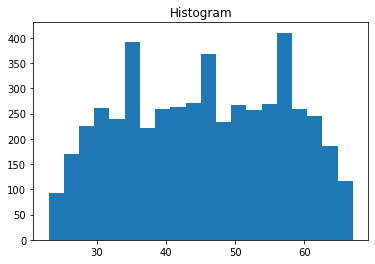

'Age'

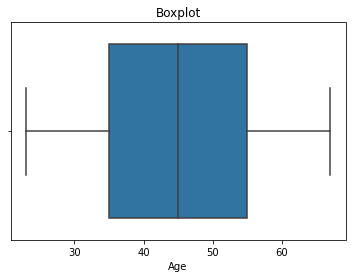

'Experience'

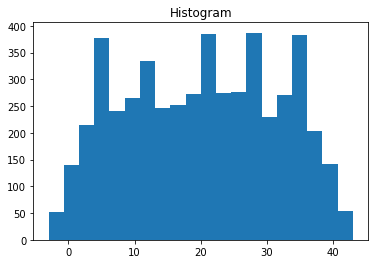

'Experience'

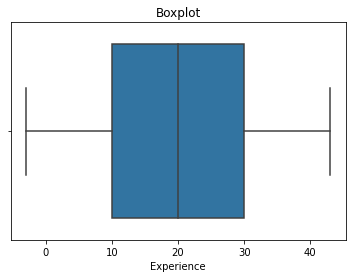

'Income'

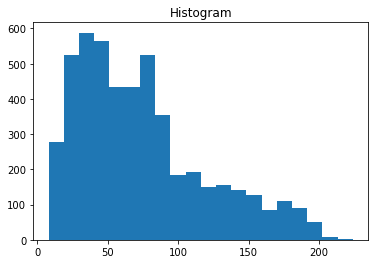

'Income'

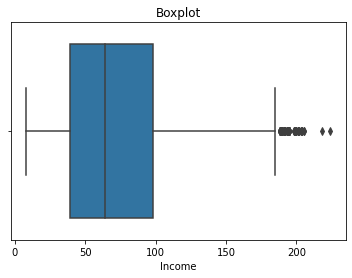

'ZIPCode'

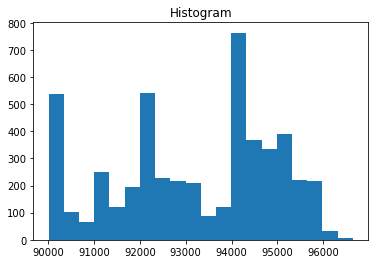

'ZIPCode'

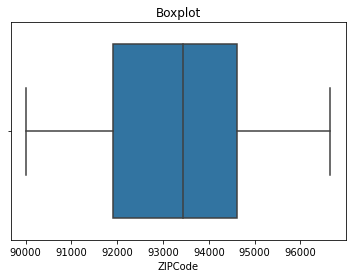

'Family'

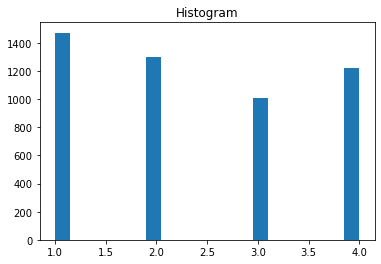

'Family'

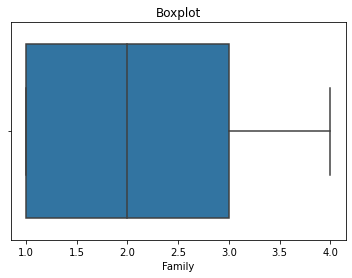

'CCAvg'

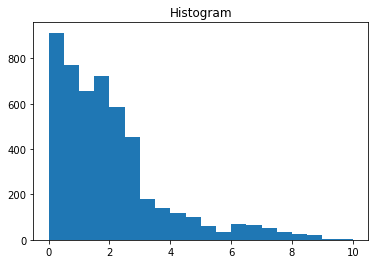

'CCAvg'

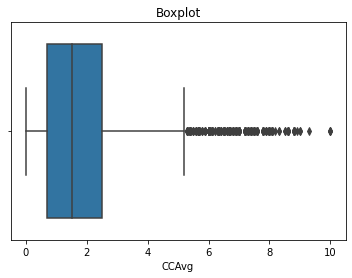

'Education'

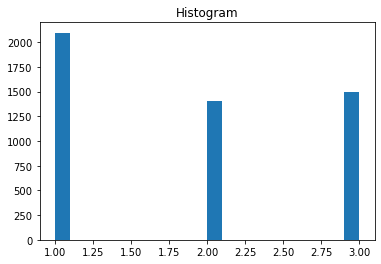

'Education'

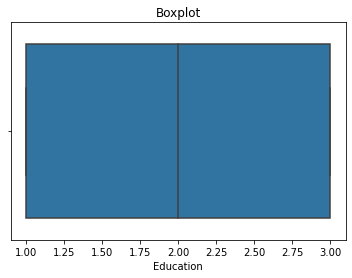

'Mortgage'

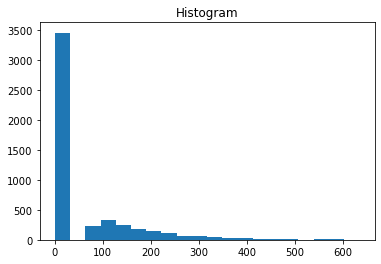

'Mortgage'

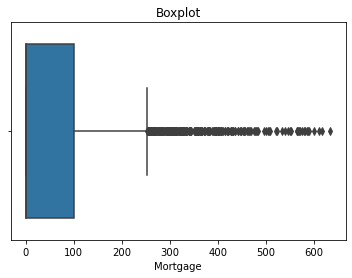

'Personal_Loan'

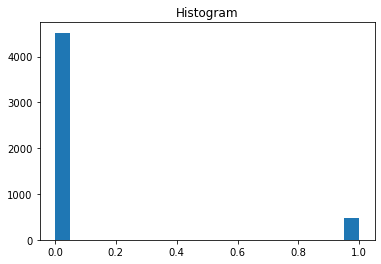

'Personal_Loan'

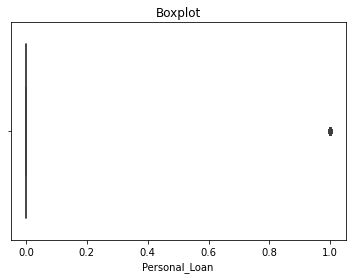

'Securities_Account'

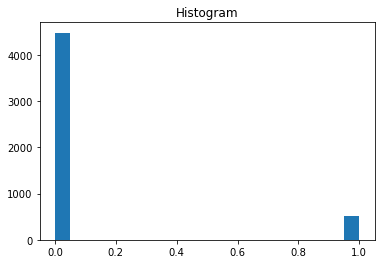

'Securities_Account'

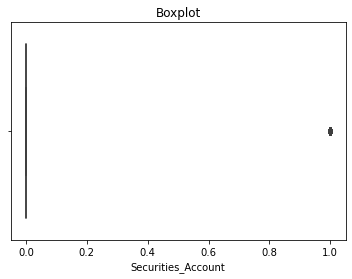

'CD_Account'

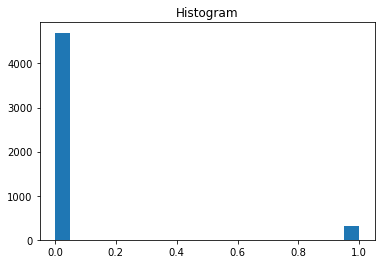

'CD_Account'

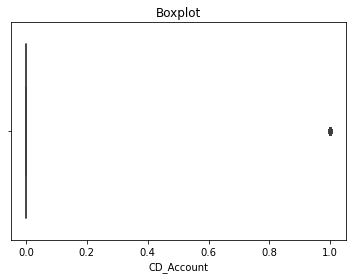

'Online'

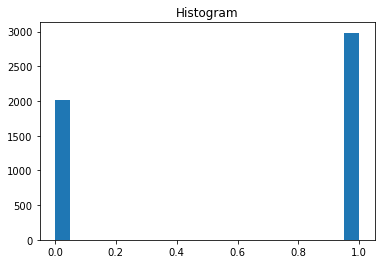

'Online'

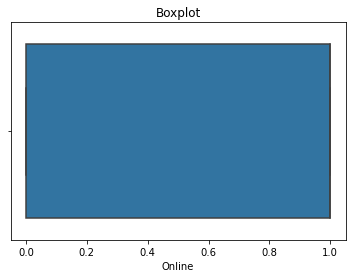

'CreditCard'

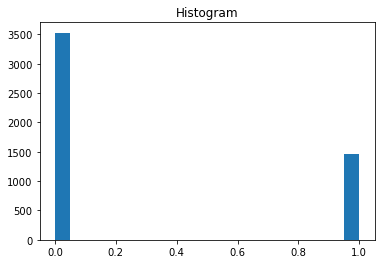

'CreditCard'

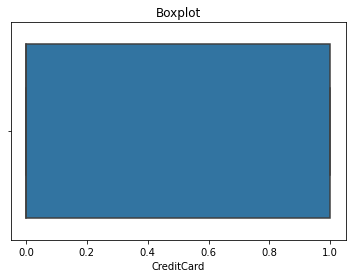

<IPython.core.display.Javascript object>

In [18]:
# for every column in dataframe make a histogram and boxplot
for (column_name, column_data) in df.iteritems():
    plt.hist(column_data, 20)
    plt.title("Histogram")
    display(column_name)
    plt.show()

    sns.boxplot(column_data)
    plt.title("Boxplot")
    display(column_name)
    plt.show()

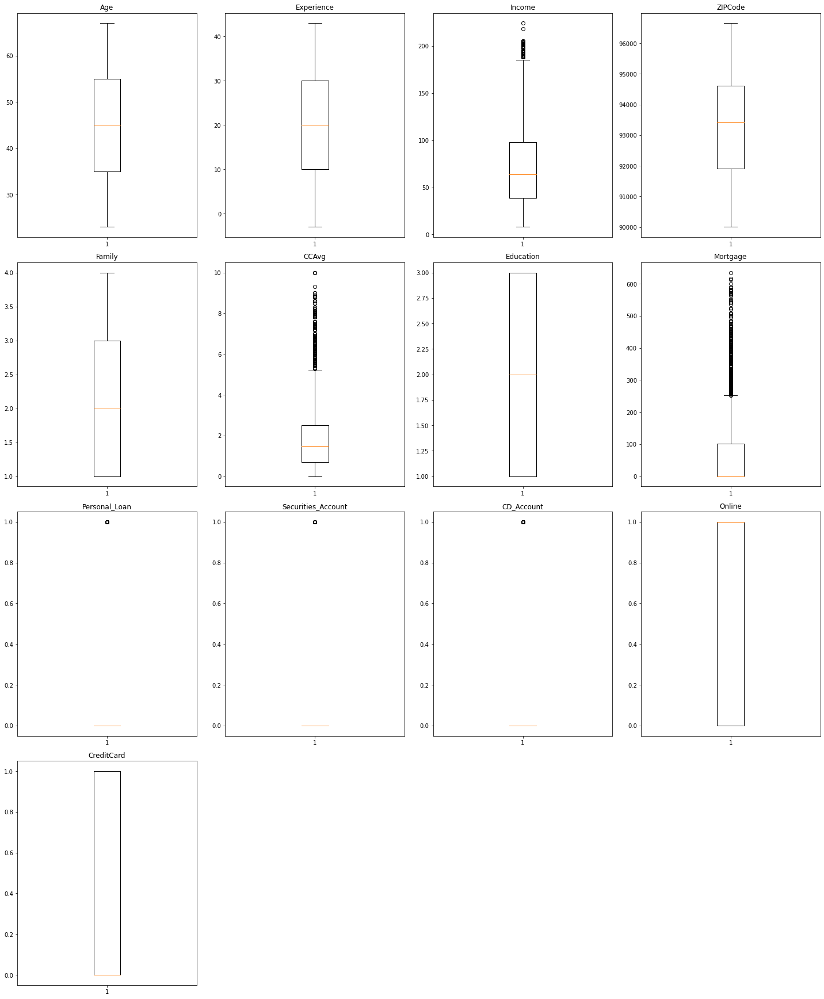

<IPython.core.display.Javascript object>

In [19]:
# let's plot the boxplots of all columns to check for outliers
plt.figure(figsize=(20, 30))

for i, variable in enumerate(df):
    plt.subplot(5, 4, i + 1)
    plt.boxplot(df[variable], whis=1.5)
    plt.tight_layout()
    plt.title(variable)

plt.show()

`Income`, `CCAvg` (strong), `Mortgage` (heavy), `CD Account`, `Securities_Account`, and `Personal_Loan` show outliers.

#### Outlier Treatment

`Experience` has negative values that need to be cleaned. I will replace them with the median value.

In [20]:
# view a subset
exp = df[df["Experience"] < 0]
display(exp)

,Age,Experience,Income,ZIPCode,Family,CCAvg,Education,Mortgage,Personal_Loan,Securities_Account,CD_Account,Online,CreditCard
89,25,-1,113,94303,4,2.30,3,0,0,0,0,0,1
226,24,-1,39,94085,2,1.70,2,0,0,0,0,0,0
315,24,-2,51,90630,3,0.30,3,0,0,0,0,1,0
451,28,-2,48,94132,2,1.75,3,89,0,0,0,1,0
524,24,-1,75,93014,4,0.20,1,0,0,0,0,1,0
536,25,-1,43,92173,3,2.40,2,176,0,0,0,1,0
540,25,-1,109,94010,4,2.30,3,314,0,0,0,1,0
576,25,-1,48,92870,3,0.30,3,0,0,0,0,0,1
583,24,-1,38,95045,2,1.70,2,0,0,0,0,1,0
597,24,-2,125,92835,2,7.20,1,0,0,1,0,0,1


<IPython.core.display.Javascript object>

In [21]:
# check type
type(exp)

pandas.core.frame.DataFrame

<IPython.core.display.Javascript object>

In [22]:
# count of a subset
df[df["Experience"] < 0].count()

Age                   52
Experience            52
Income                52
ZIPCode               52
Family                52
CCAvg                 52
Education             52
Mortgage              52
Personal_Loan         52
Securities_Account    52
CD_Account            52
Online                52
CreditCard            52
dtype: int64

<IPython.core.display.Javascript object>

In [23]:
# get value counts
df[df["Experience"] < 0]["Experience"].value_counts()

-1    33
-2    15
-3     4
Name: Experience, dtype: int64

<IPython.core.display.Javascript object>

In [24]:
# check median
med = df.Experience.median()
display(med)

20.0

<IPython.core.display.Javascript object>

In [25]:
m = df.Experience.mean()
print(m)

20.1046


<IPython.core.display.Javascript object>

In [26]:
display(exp)

,Age,Experience,Income,ZIPCode,Family,CCAvg,Education,Mortgage,Personal_Loan,Securities_Account,CD_Account,Online,CreditCard
89,25,-1,113,94303,4,2.30,3,0,0,0,0,0,1
226,24,-1,39,94085,2,1.70,2,0,0,0,0,0,0
315,24,-2,51,90630,3,0.30,3,0,0,0,0,1,0
451,28,-2,48,94132,2,1.75,3,89,0,0,0,1,0
524,24,-1,75,93014,4,0.20,1,0,0,0,0,1,0
536,25,-1,43,92173,3,2.40,2,176,0,0,0,1,0
540,25,-1,109,94010,4,2.30,3,314,0,0,0,1,0
576,25,-1,48,92870,3,0.30,3,0,0,0,0,0,1
583,24,-1,38,95045,2,1.70,2,0,0,0,0,1,0
597,24,-2,125,92835,2,7.20,1,0,0,1,0,0,1


<IPython.core.display.Javascript object>

In [27]:
# function for median filling

print("Mean before filling in medians", m)  # print mean

# replace values in subset by median of column
df["Experience"].replace([-1, -2, -3], 20, inplace=True)

print("Mean after filling in medians", m)  # print mean

Mean before filling in medians 20.1046
Mean after filling in medians 20.1046


<IPython.core.display.Javascript object>

In [28]:
# get value counts
df[df["Experience"] < 0]["Experience"].value_counts()

Series([], Name: Experience, dtype: int64)

<IPython.core.display.Javascript object>

Checked that the median filling worked and it appears to have removed negative values.

## Feature Engineering

In [29]:
df.skew()

Age                  -0.03
Experience           -0.01
Income                0.84
ZIPCode              -0.30
Family                0.16
CCAvg                 1.60
Education             0.23
Mortgage              2.10
Personal_Loan         2.74
Securities_Account    2.59
CD_Account            3.69
Online               -0.39
CreditCard            0.90
dtype: float64

<IPython.core.display.Javascript object>

In [30]:
df.std()

Age                    11.46
Experience             11.25
Income                 46.03
ZIPCode              1759.46
Family                  1.15
CCAvg                   1.75
Education               0.84
Mortgage              101.71
Personal_Loan           0.29
Securities_Account      0.31
CD_Account              0.24
Online                  0.49
CreditCard              0.46
dtype: float64

<IPython.core.display.Javascript object>

Age


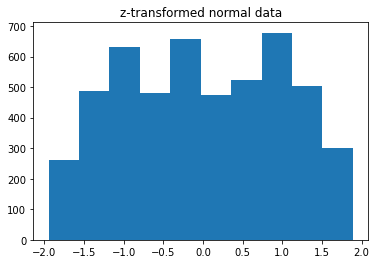

Experience


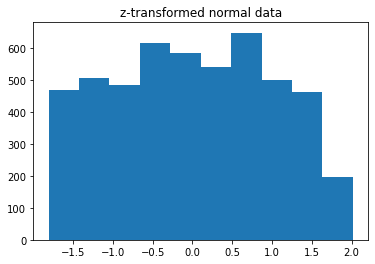

Income


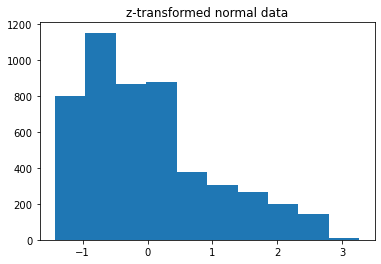

ZIPCode


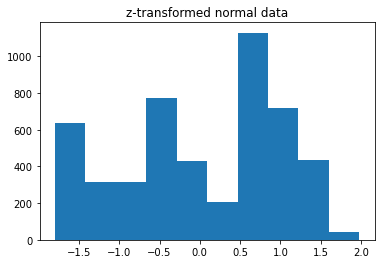

Family


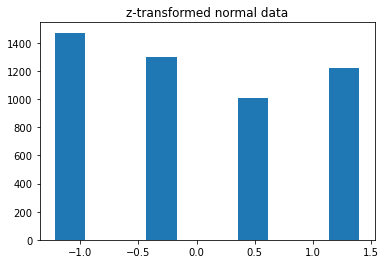

CCAvg


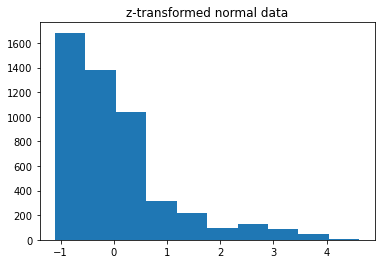

Education


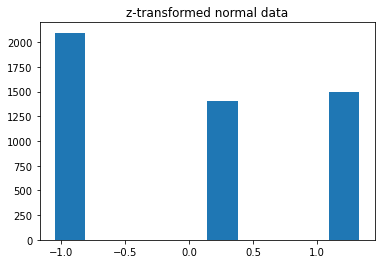

Mortgage


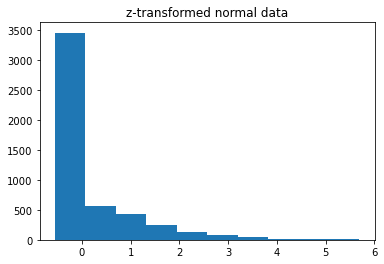

Personal_Loan


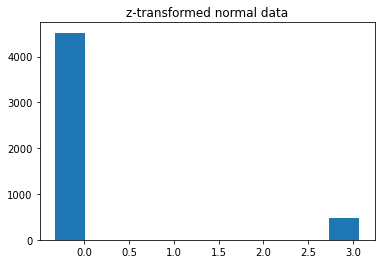

Securities_Account


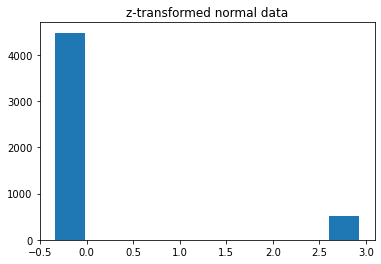

CD_Account


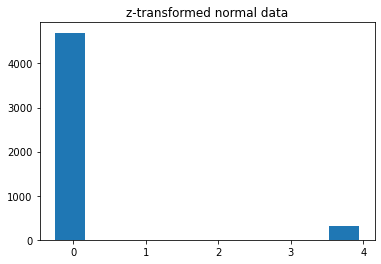

Online


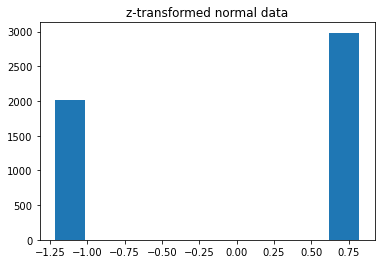

CreditCard


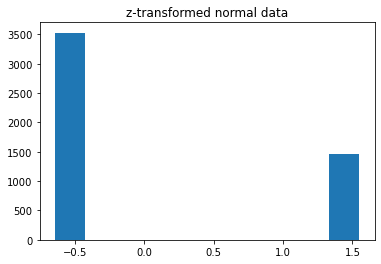

<IPython.core.display.Javascript object>

In [31]:
def z_transform(x):
    return (x - np.mean(x)) / np.std(x)


"""
for i in list(numerical_features):
    plt.hist(z_transform(df[i].values))
    plt.title('z-transformed normal data')
    plt.show()
"""


for (column_name, column_data) in df.iteritems():
    plt.hist(z_transform(column_data))
    plt.title("z-transformed normal data")
    print(column_name)
    plt.show()

There is no apparent change after transformations so they will be skipped and there is no assumption about normality on independent variable (https://www.statisticssolutions.com/free-resources/directory-of-statistical-analyses/assumptions-of-logistic-regression/).

## Insights

- Most of the data-types are either **int64** or **float64**.
- `Mortgage` is the only column that reasonably has a strong skew.
- We know that `ID` is a customer so there is no need to change it.
- `Zip Code` is a discrete type so each one is unique and there is no need to change it's values.

In [32]:
# get info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Age                 5000 non-null   int64  
 1   Experience          5000 non-null   int64  
 2   Income              5000 non-null   int64  
 3   ZIPCode             5000 non-null   int64  
 4   Family              5000 non-null   int64  
 5   CCAvg               5000 non-null   float64
 6   Education           5000 non-null   int64  
 7   Mortgage            5000 non-null   int64  
 8   Personal_Loan       5000 non-null   int64  
 9   Securities_Account  5000 non-null   int64  
 10  CD_Account          5000 non-null   int64  
 11  Online              5000 non-null   int64  
 12  CreditCard          5000 non-null   int64  
dtypes: float64(1), int64(12)
memory usage: 507.9 KB


<IPython.core.display.Javascript object>

1. The `Experience` variable is now balanced at the median and mean levels.
2. All variables are ready for analysis.
3. Later feature engineering should not be needed.

# Exploratory Data Analysis

### Set-up for visualization

In [33]:
# Subset the dataframe based on numeric and categorical types
numerical_features = df.select_dtypes(include=["int64", "float64"])
global numerical_features
# [numerical_features]

<IPython.core.display.Javascript object>

In [34]:
# Function from GreatLearning on %'s for bar graphs
def per_on_bar(plot, feature):
    total = len(feature)
    for p in ax.patches:
        perc = "{:1.f}%".format(100 * p.get_height() / total)
        x = p.get_x() + p.get_width() / 2 - 0.05
        y = p.get_y() + g.get_height()
        ax.annotate(perc, (x, y), size=12)
    plt.show()  # Subset the dataframe based on numeric and categorical types

<IPython.core.display.Javascript object>

### Statistical Summary

In [35]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,5000.00,45.34,11.46,23.00,35.00,45.00,55.00,67.00
Experience,5000.00,20.33,11.25,0.00,11.00,20.00,30.00,43.00
Income,5000.00,73.77,46.03,8.00,39.00,64.00,98.00,224.00
ZIPCode,5000.00,93169.26,1759.46,90005.00,91911.00,93437.00,94608.00,96651.00
Family,5000.00,2.40,1.15,1.00,1.00,2.00,3.00,4.00
CCAvg,5000.00,1.94,1.75,0.00,0.70,1.50,2.50,10.00
Education,5000.00,1.88,0.84,1.00,1.00,2.00,3.00,3.00
Mortgage,5000.00,56.50,101.71,0.00,0.00,0.00,101.00,635.00
Personal_Loan,5000.00,0.10,0.29,0.00,0.00,0.00,0.00,1.00
Securities_Account,5000.00,0.10,0.31,0.00,0.00,0.00,0.00,1.00


<IPython.core.display.Javascript object>

### Univariate analysis

In [36]:
# Function to perform statistical analysis on every numeric and categorical variable in the dataframe
pd.set_option("display.max_colwidth", 5000)


def univar_num(dataframe):  # argument is the whole dataframe

    # Print statistics for numeric variables
    # Mode (or most popular)
    print("\n Mode Analysis \n", df.mode("index")[0:2])
    print("\n Sum Analysis \n", numerical_features.sum())  # Sum analysis
    # Variance analysis
    print("\n Variance analysis \n", numerical_features.var())
    print(
        "\n Absolute Deviation or Mean Absolute Deviation \n", numerical_features.mad()
    )  # Absolute Deviation or Mean Absolute Deviation
    print("\n  Skew analysis \n ", numerical_features.skew())  # Skew analysis

    return

<IPython.core.display.Javascript object>

In [37]:
# Run dataframe through function
univar_num(numerical_features)


 Mode Analysis 
    Age  Experience  Income  ZIPCode  Family  CCAvg  Education  Mortgage  \
0   35          20      44    94720       1   0.30          1         0   

   Personal_Loan  Securities_Account  CD_Account  Online  CreditCard  
0              0                   0           0       1           0  

 Sum Analysis 
 Age                     226692.00
Experience              101638.00
Income                  368871.00
ZIPCode              465846285.00
Family                   11982.00
CCAvg                     9689.69
Education                 9405.00
Mortgage                282494.00
Personal_Loan              480.00
Securities_Account         522.00
CD_Account                 302.00
Online                    2984.00
CreditCard                1470.00
dtype: float64

 Variance analysis 
 Age                      131.40
Experience               126.63
Income                  2119.10
ZIPCode              3095682.20
Family                     1.32
CCAvg                      3.05
E

<IPython.core.display.Javascript object>

In [38]:
# Frequency tables for every feature
for (
    column_name,
    column_data,
) in (
    df.iteritems()
):  # for every column in the dataframe return the column name and Series of data
    display((column_name, column_data.value_counts()))

('Age',
 35    151
 43    149
 52    145
 58    143
 54    143
 50    138
 41    136
 30    136
 56    135
 34    134
 39    133
 57    132
 59    132
 51    129
 60    127
 45    127
 46    127
 42    126
 31    125
 40    125
 55    125
 29    123
 62    123
 61    122
 44    121
 33    120
 32    120
 48    118
 49    115
 38    115
 47    113
 53    112
 63    108
 36    107
 37    106
 28    103
 27     91
 65     80
 64     78
 26     78
 25     53
 24     28
 66     24
 23     12
 67     12
 Name: Age, dtype: int64)

('Experience',
 20    200
 32    154
 9     147
 5     146
 23    144
 35    143
 25    142
 28    138
 18    137
 19    135
 26    134
 24    131
 3     129
 16    127
 14    127
 30    126
 34    125
 27    125
 17    125
 29    124
 22    124
 7     121
 8     119
 15    119
 6     119
 10    118
 33    117
 13    117
 37    116
 11    116
 36    114
 4     113
 21    113
 31    104
 12    102
 38     88
 39     85
 2      85
 1      74
 0      66
 40     57
 41     43
 42      8
 43      3
 Name: Experience, dtype: int64)

('Income',
 44     85
 38     84
 81     83
 41     82
 39     81
 40     78
 42     77
 83     74
 43     70
 45     69
 29     67
 21     65
 85     65
 35     65
 22     65
 25     64
 84     63
 28     63
 30     63
 82     61
 78     61
 55     61
 65     60
 64     60
 32     58
 61     57
 53     57
 80     56
 62     55
 31     55
 58     55
 23     54
 18     53
 59     53
 79     53
 34     53
 54     52
 49     52
 19     52
 60     52
 33     51
 24     47
 20     47
 75     47
 70     47
 52     47
 63     46
 69     46
 74     45
 50     45
 48     44
 73     44
 71     43
 51     41
 72     41
 90     38
 91     37
 93     37
 68     35
 89     34
 113    34
 15     33
 13     32
 14     31
 114    30
 12     30
 92     29
 98     28
 115    27
 11     27
 94     26
 88     26
 112    26
 9      26
 95     25
 122    24
 141    24
 101    24
 128    24
 99     24
 8      23
 10     23
 129    23
 145    23
 125    23
 111    22
 154    21
 104    20
 134    20
 105    20

('ZIPCode',
 94720    169
 94305    127
 95616    116
 90095     71
 93106     57
         ... 
 94087      1
 96145      1
 90068      1
 92694      1
 94404      1
 Name: ZIPCode, Length: 467, dtype: int64)

('Family',
 1    1472
 2    1296
 4    1222
 3    1010
 Name: Family, dtype: int64)

('CCAvg',
 0.30     241
 1.00     231
 0.20     204
 2.00     188
 0.80     187
 0.10     183
 0.40     179
 1.50     178
 0.70     169
 0.50     163
 1.70     158
 1.80     152
 1.40     136
 2.20     130
 1.30     128
 0.60     118
 2.80     110
 2.50     107
 0.00     106
 1.90     106
 0.90     106
 1.60     101
 2.10     100
 2.40      92
 2.60      87
 1.10      84
 1.20      66
 2.30      58
 2.70      58
 2.90      54
 3.00      53
 3.30      45
 3.80      43
 3.40      39
 2.67      36
 4.00      33
 4.50      29
 3.60      27
 3.90      27
 4.30      26
 6.00      26
 3.70      25
 4.70      24
 3.20      22
 4.10      22
 4.90      22
 3.10      20
 0.67      18
 1.67      18
 5.00      18
 2.33      18
 5.40      18
 6.50      18
 4.40      17
 5.20      16
 3.50      15
 4.60      14
 6.10      14
 6.90      14
 7.00      14
 7.20      13
 7.40      13
 5.70      13
 6.30      13
 8.00      12
 7.50      12
 4.20      11
 6.33      10
 8.10      10
 7.30      10
 6.80     

('Education',
 1    2096
 3    1501
 2    1403
 Name: Education, dtype: int64)

('Mortgage',
 0      3462
 98       17
 89       16
 91       16
 83       16
        ... 
 206       1
 210       1
 258       1
 278       1
 635       1
 Name: Mortgage, Length: 347, dtype: int64)

('Personal_Loan',
 0    4520
 1     480
 Name: Personal_Loan, dtype: int64)

('Securities_Account',
 0    4478
 1     522
 Name: Securities_Account, dtype: int64)

('CD_Account',
 0    4698
 1     302
 Name: CD_Account, dtype: int64)

('Online',
 1    2984
 0    2016
 Name: Online, dtype: int64)

('CreditCard',
 0    3530
 1    1470
 Name: CreditCard, dtype: int64)

<IPython.core.display.Javascript object>

**Observations**

- More customers have credit cards with other banks than don't.
- More customers use online banking than don't.
- Way more customers have a Certificate of Deposit account than don't.


#### Zipcode data

Use zip codes to find closest county and get a count.

In [39]:
# import module for zipcode search
from uszipcode import SearchEngine, SimpleZipcode, Zipcode

# https://uszipcode.readthedocs.io/01-Tutorial/index.html?highlight=SimpleZipcode

search = SearchEngine(simple_zipcode=True)  # set simple_zipcode=False

<IPython.core.display.Javascript object>

In [40]:
# import module for list counter
from collections import Counter

zips = []

# pull zipcode geo-data and get a list in ascending order
for i in df["ZIPCode"]:
    zipcode = search.by_zipcode(i)
    zips.append(zipcode.county)

# show top zips
display(Counter(zips).most_common)

<bound method Counter.most_common of Counter({'Los Angeles County': 1095, 'San Diego County': 568, 'Santa Clara County': 563, 'Alameda County': 500, 'Orange County': 339, 'San Francisco County': 257, 'San Mateo County': 204, 'Sacramento County': 184, 'Santa Barbara County': 154, 'Yolo County': 130, 'Monterey County': 128, 'Ventura County': 114, 'San Bernardino County': 101, 'Contra Costa County': 85, 'Santa Cruz County': 68, 'Riverside County': 56, 'Marin County': 54, 'Kern County': 54, None: 34, 'San Luis Obispo County': 33, 'Solano County': 33, 'Humboldt County': 32, 'Sonoma County': 28, 'Fresno County': 26, 'Placer County': 24, 'Butte County': 19, 'Shasta County': 18, 'El Dorado County': 17, 'Stanislaus County': 15, 'San Benito County': 14, 'San Joaquin County': 13, 'Mendocino County': 8, 'Siskiyou County': 7, 'Tuolumne County': 7, 'Merced County': 4, 'Trinity County': 4, 'Lake County': 4, 'Imperial County': 3, 'Napa County': 3})>

<IPython.core.display.Javascript object>

**Observations**
- Los Angeles holds the most amount of customers by far.
- Napa, Imperial, and Lake counties are very much underrepresented.
- San Francisco and Santa Barbara are not as represented as one might guess.

### Distributions

In [41]:
# Function to create distribution and statistical plots for each numerical feature in the dataframe
def univar_vis(dataframe):

    sns.set(style="ticks")
    sns.set_style("darkgrid")

    # Univariate visualization of numeric variables
    for (column_name, column_data) in numerical_features.iteritems():

        print(column_name, "Histogram")
        sns.histplot(df[column_name], kde=True)  # histogram
        plt.figure(figsize=(20, 10))
        plt.show()

        """
        print(column_name, "Distribution Plot")
        plt.figure(figsize=(20, 10))
        sns.displot(data=column_data)  # distribution plot
        plt.show()
        """

        print(column_name, "Density Plot")
        sns.kdeplot(
            data=column_data, x=numerical_features[column_name]
        )  # Kernel distribution
        plt.figure(figsize=(20, 10))
        plt.show()

        print(column_name, "Box Plot")
        sns.boxplot(data=column_data, y=df[column_name])  # Box plot
        plt.figure(figsize=(20, 10))
        plt.show()

        # raise Exception("End to kill infinite loop")

    return

<IPython.core.display.Javascript object>

Age Histogram


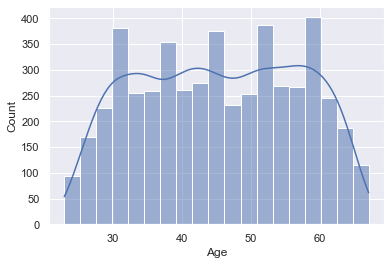

<Figure size 1440x720 with 0 Axes>

Age Density Plot


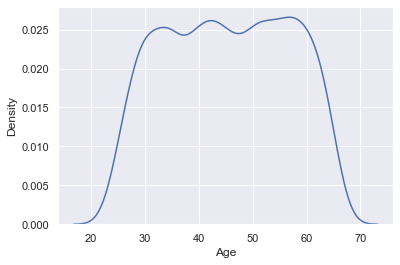

<Figure size 1440x720 with 0 Axes>

Age Box Plot


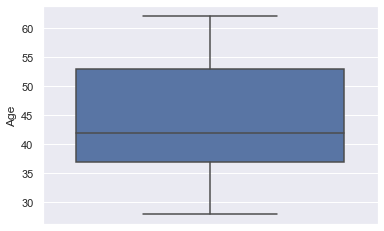

<Figure size 1440x720 with 0 Axes>

Experience Histogram


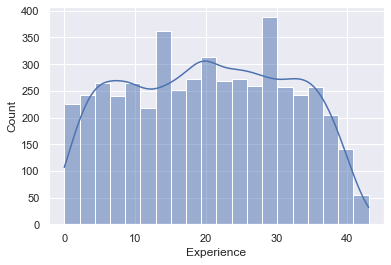

<Figure size 1440x720 with 0 Axes>

Experience Density Plot


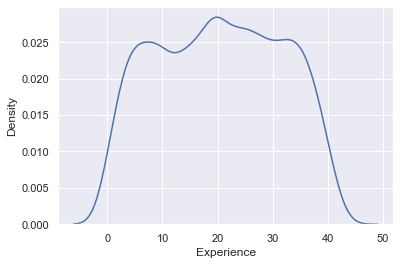

<Figure size 1440x720 with 0 Axes>

Experience Box Plot


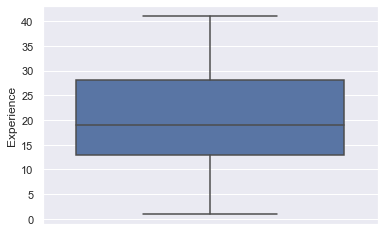

<Figure size 1440x720 with 0 Axes>

Income Histogram


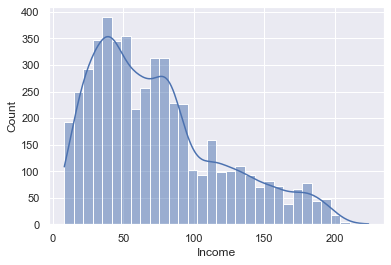

<Figure size 1440x720 with 0 Axes>

Income Density Plot


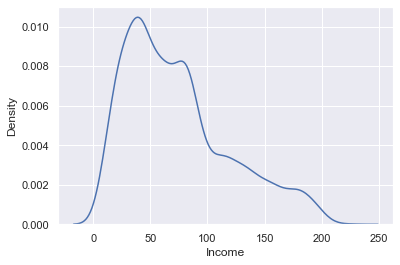

<Figure size 1440x720 with 0 Axes>

Income Box Plot


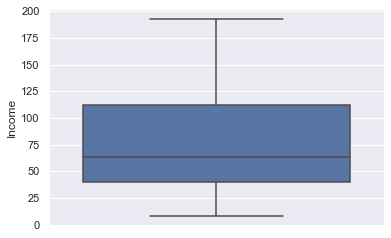

<Figure size 1440x720 with 0 Axes>

ZIPCode Histogram


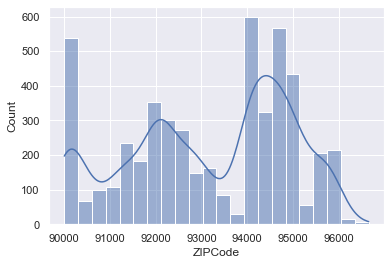

<Figure size 1440x720 with 0 Axes>

ZIPCode Density Plot


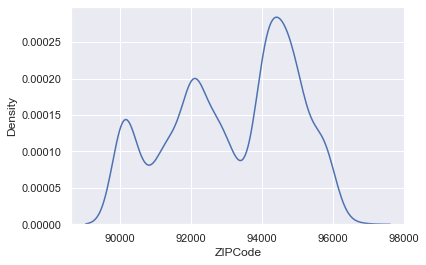

<Figure size 1440x720 with 0 Axes>

ZIPCode Box Plot


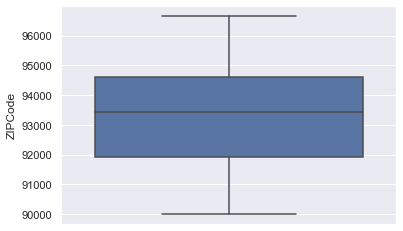

<Figure size 1440x720 with 0 Axes>

Family Histogram


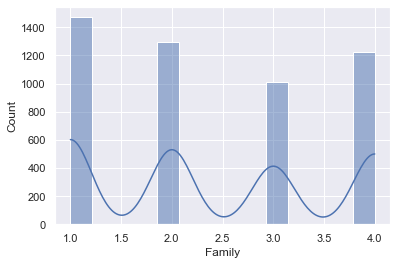

<Figure size 1440x720 with 0 Axes>

Family Density Plot


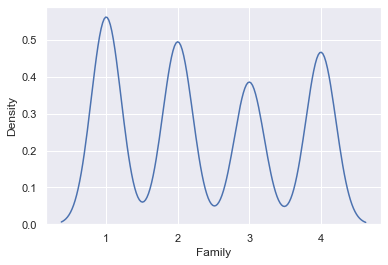

<Figure size 1440x720 with 0 Axes>

Family Box Plot


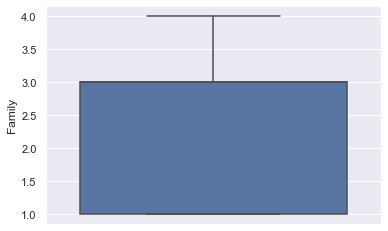

<Figure size 1440x720 with 0 Axes>

CCAvg Histogram


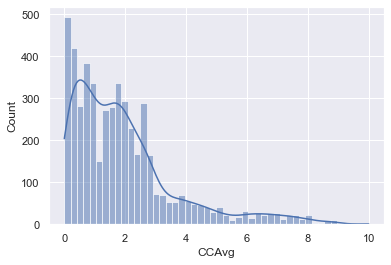

<Figure size 1440x720 with 0 Axes>

CCAvg Density Plot


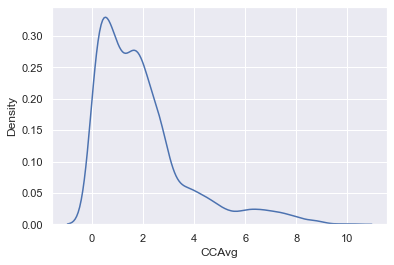

<Figure size 1440x720 with 0 Axes>

CCAvg Box Plot


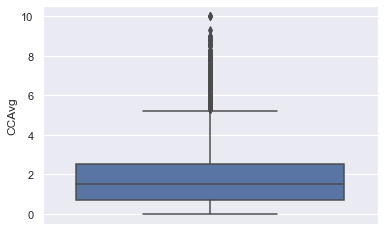

<Figure size 1440x720 with 0 Axes>

Education Histogram


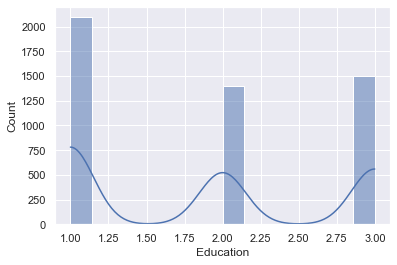

<Figure size 1440x720 with 0 Axes>

Education Density Plot


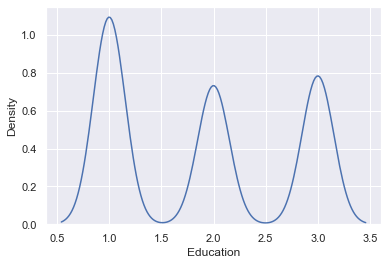

<Figure size 1440x720 with 0 Axes>

Education Box Plot


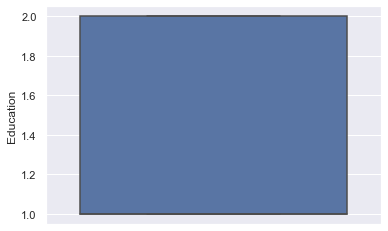

<Figure size 1440x720 with 0 Axes>

Mortgage Histogram


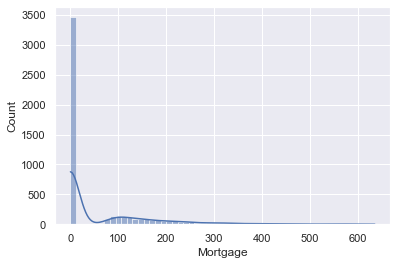

<Figure size 1440x720 with 0 Axes>

Mortgage Density Plot


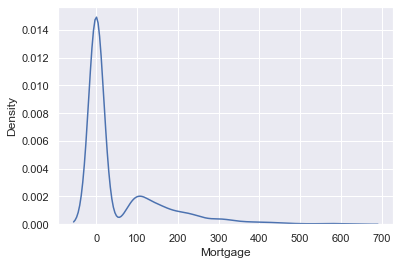

<Figure size 1440x720 with 0 Axes>

Mortgage Box Plot


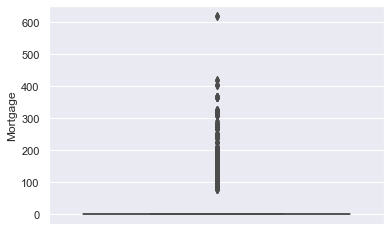

<Figure size 1440x720 with 0 Axes>

Personal_Loan Histogram


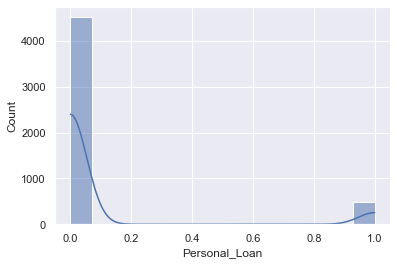

<Figure size 1440x720 with 0 Axes>

Personal_Loan Density Plot


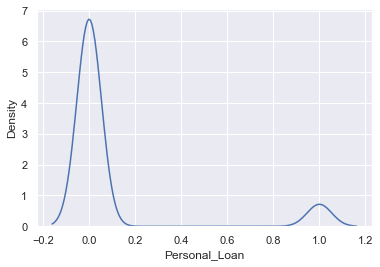

<Figure size 1440x720 with 0 Axes>

Personal_Loan Box Plot


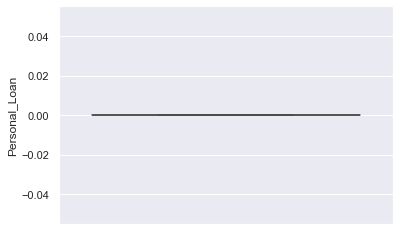

<Figure size 1440x720 with 0 Axes>

Securities_Account Histogram


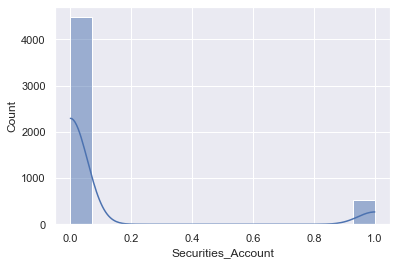

<Figure size 1440x720 with 0 Axes>

Securities_Account Density Plot


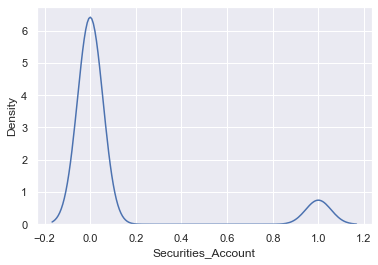

<Figure size 1440x720 with 0 Axes>

Securities_Account Box Plot


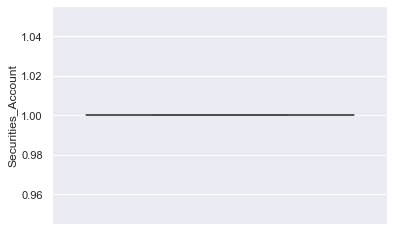

<Figure size 1440x720 with 0 Axes>

CD_Account Histogram


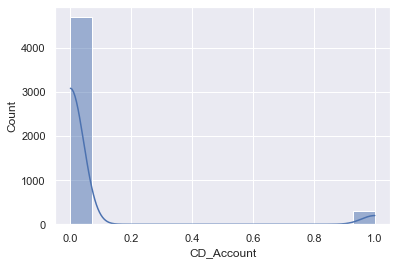

<Figure size 1440x720 with 0 Axes>

CD_Account Density Plot


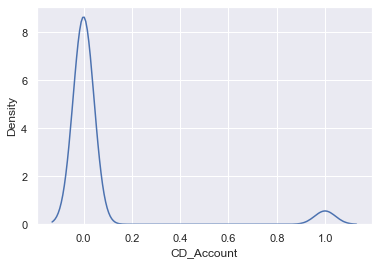

<Figure size 1440x720 with 0 Axes>

CD_Account Box Plot


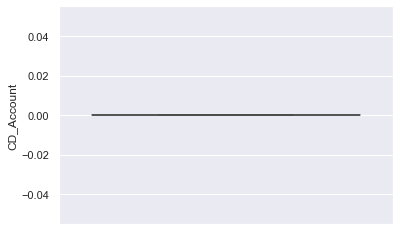

<Figure size 1440x720 with 0 Axes>

Online Histogram


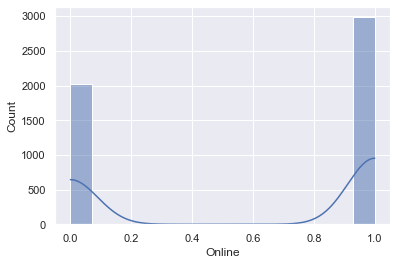

<Figure size 1440x720 with 0 Axes>

Online Density Plot


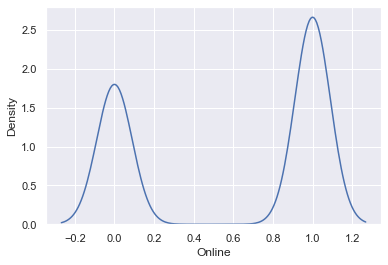

<Figure size 1440x720 with 0 Axes>

Online Box Plot


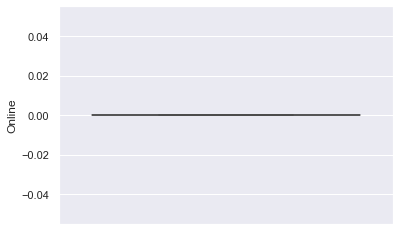

<Figure size 1440x720 with 0 Axes>

CreditCard Histogram


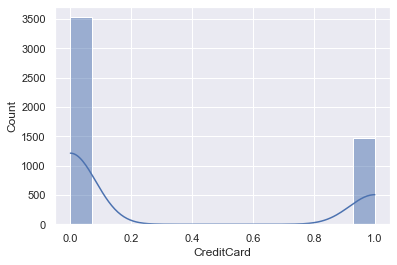

<Figure size 1440x720 with 0 Axes>

CreditCard Density Plot


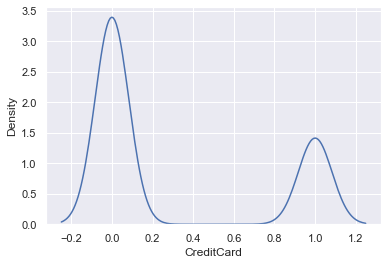

<Figure size 1440x720 with 0 Axes>

CreditCard Box Plot


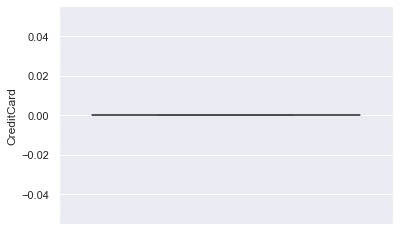

<Figure size 1440x720 with 0 Axes>

<IPython.core.display.Javascript object>

In [42]:
# Run dataframe through function
univar_vis(df)

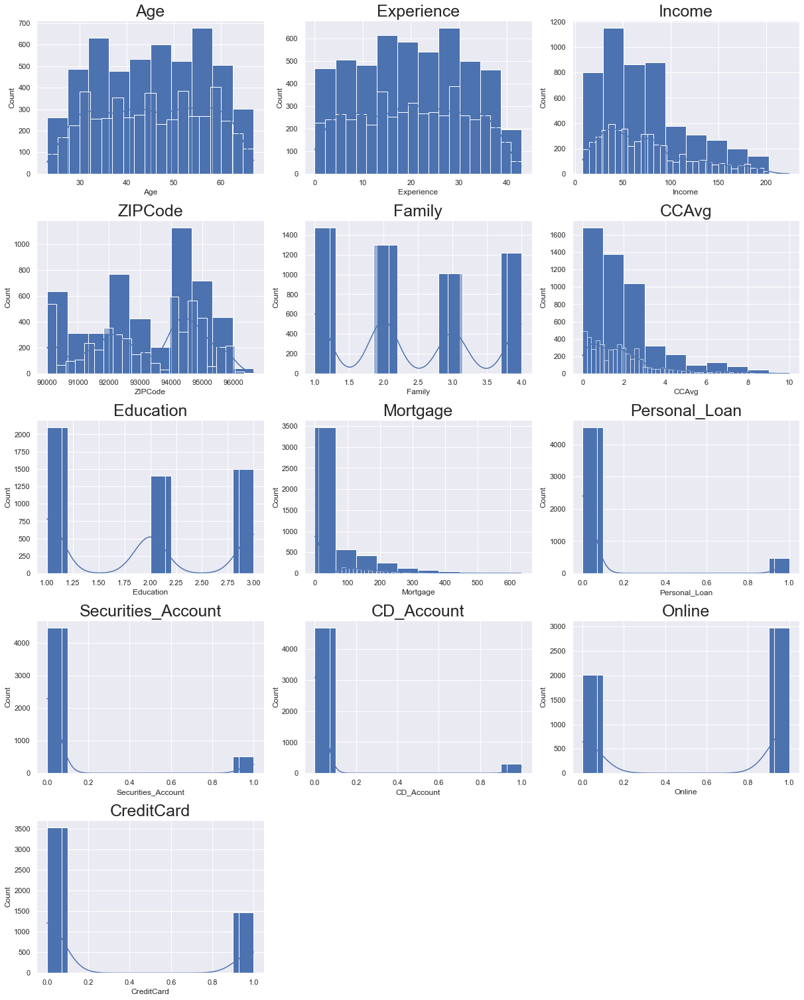

<IPython.core.display.Javascript object>

In [43]:
# From DSBA_SLF_MLS1_LifeExpectancyCaseStudy
all_col = df.select_dtypes(include=["float64", "int64"]).columns.tolist()

plt.figure(figsize=(17, 75))

for i in range(len(all_col)):
    plt.subplot(18, 3, i + 1)
    plt.hist(df[all_col[i]])
    sns.histplot(
        df[all_col[i]], kde=True
    )  # you can comment the previous line and run this one to get distribution curves
    plt.tight_layout()
    plt.title(all_col[i], fontsize=25)

plt.show()

**Observations**
- Income is skewed to the left and leaking to the right. More customers are lower income earner than not.
- The majority of customers only have 1 or 2 family members.
- Age is almost uniformly distributed with the highest groups in the mid-30's and late-50's.

In [44]:
### Code from Mounika of GreatLearning as given in the Uber Case study ###

# While doing uni-variate analysis of numerical variables we want to study their central tendency
# and dispersion.
# Let us write a function that will help us create boxplot and histogram for any input numerical
# variable.
# This function takes the numerical column as the input and returns the boxplots
# and histograms for the variable.
# Let us see if this help us write faster and cleaner code.
def histogram_boxplot(feature, figsize=(15, 10), bins=None):
    """Boxplot and histogram combined
    feature: 1-d feature array
    figsize: size of fig (default (9,8))
    bins: number of bins (default None / auto)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    sns.boxplot(
        feature, ax=ax_box2, showmeans=True, color="red"
    )  # boxplot will be created and a star will indicate the mean value of the column
    sns.distplot(feature, kde=F, ax=ax_hist2, bins=bins) if bins else sns.distplot(
        feature, kde=False, ax=ax_hist2
    )  # For histogram
    ax_hist2.axvline(
        np.mean(feature), color="g", linestyle="--"
    )  # Add mean to the histogram
    ax_hist2.axvline(
        np.median(feature), color="black", linestyle="-"
    )  # Add median to the histogram

<IPython.core.display.Javascript object>

Age                   None
Experience            None
Income                None
ZIPCode               None
Family                None
CCAvg                 None
Education             None
Mortgage              None
Personal_Loan         None
Securities_Account    None
CD_Account            None
Online                None
CreditCard            None
dtype: object

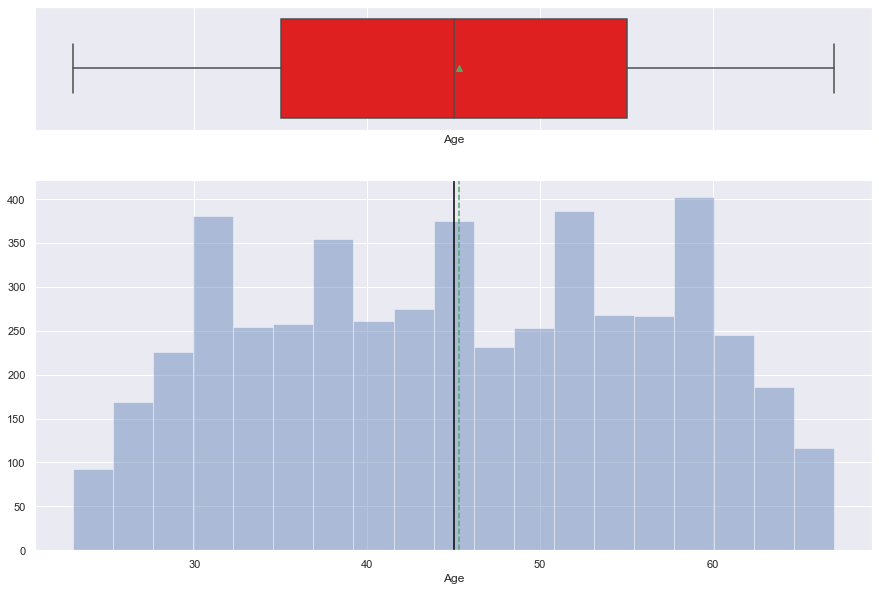

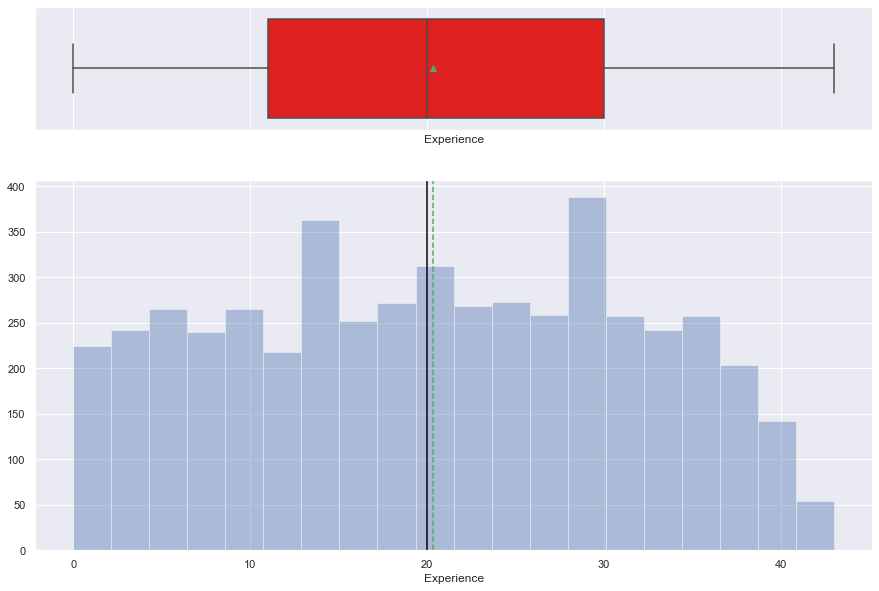

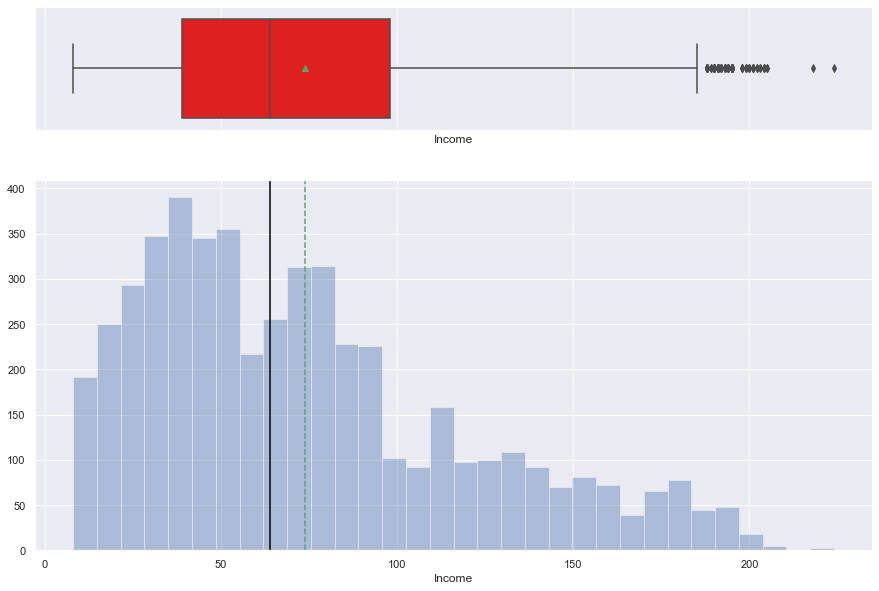

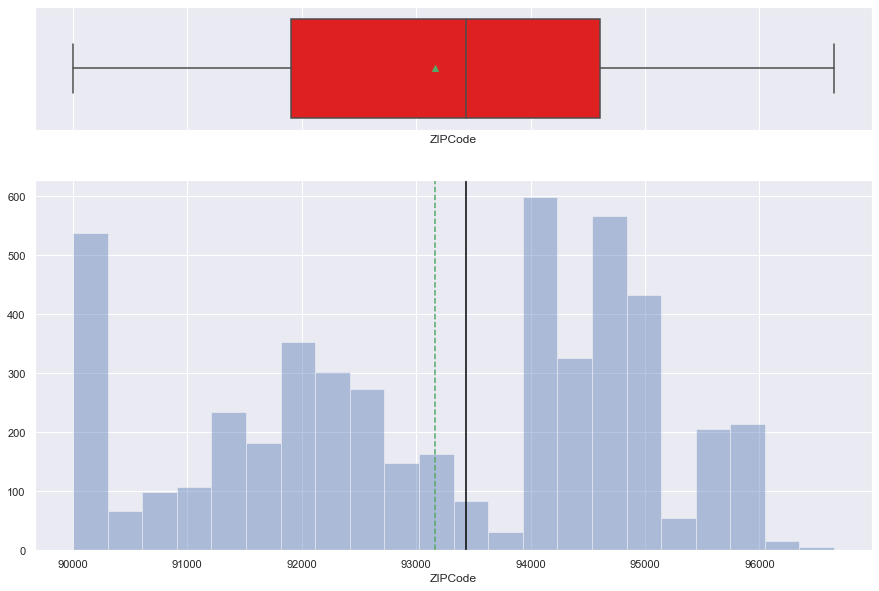

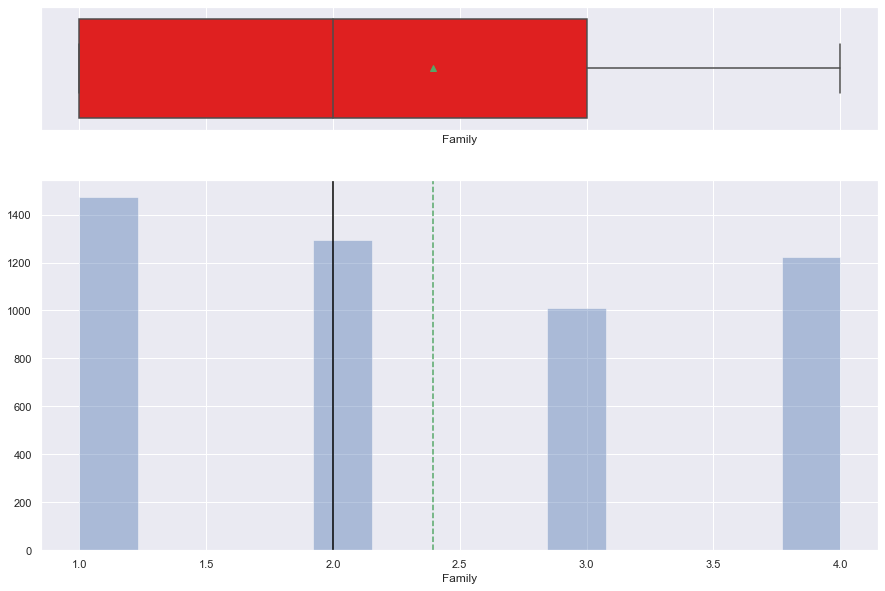

...

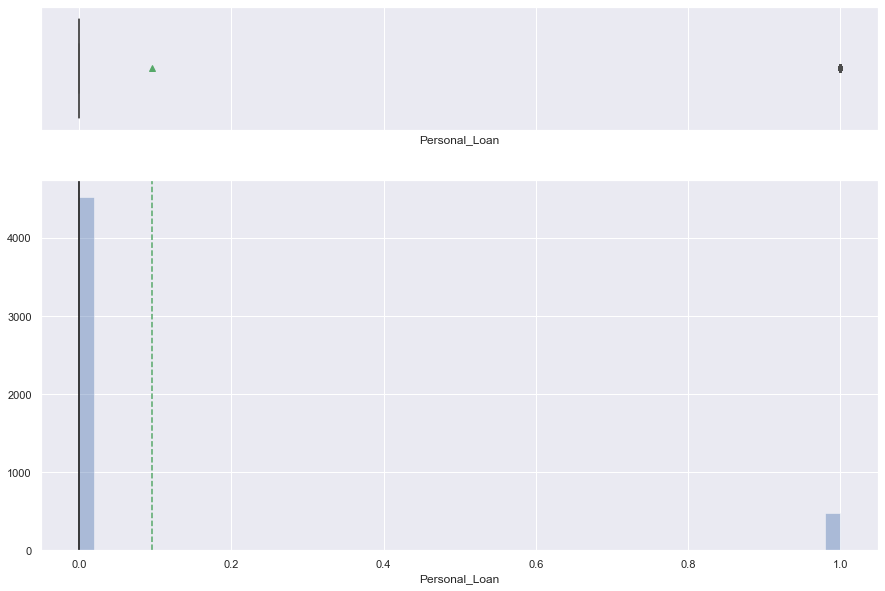

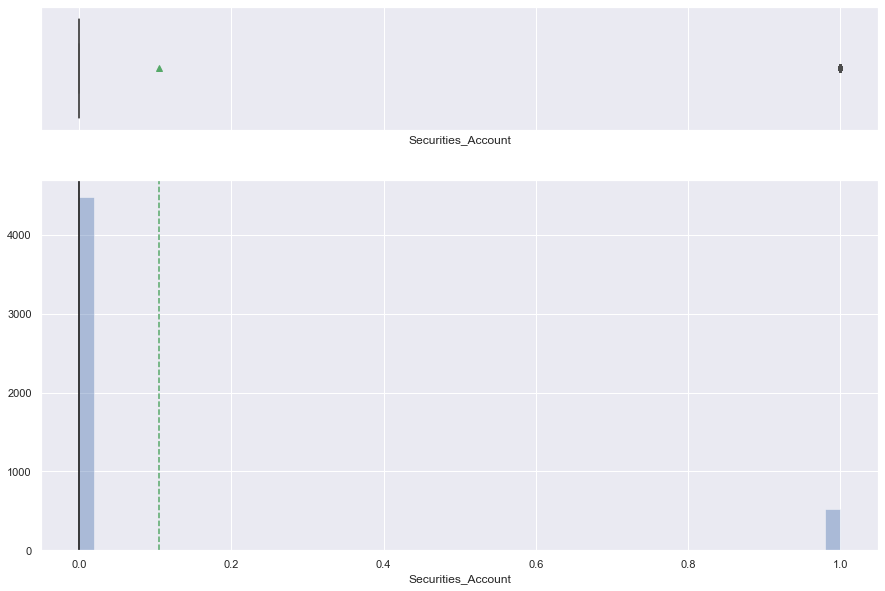

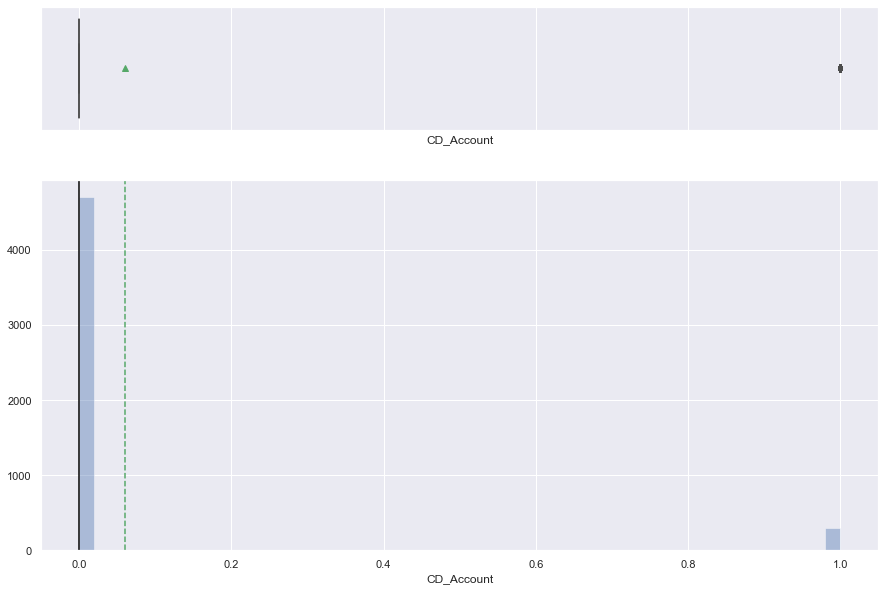

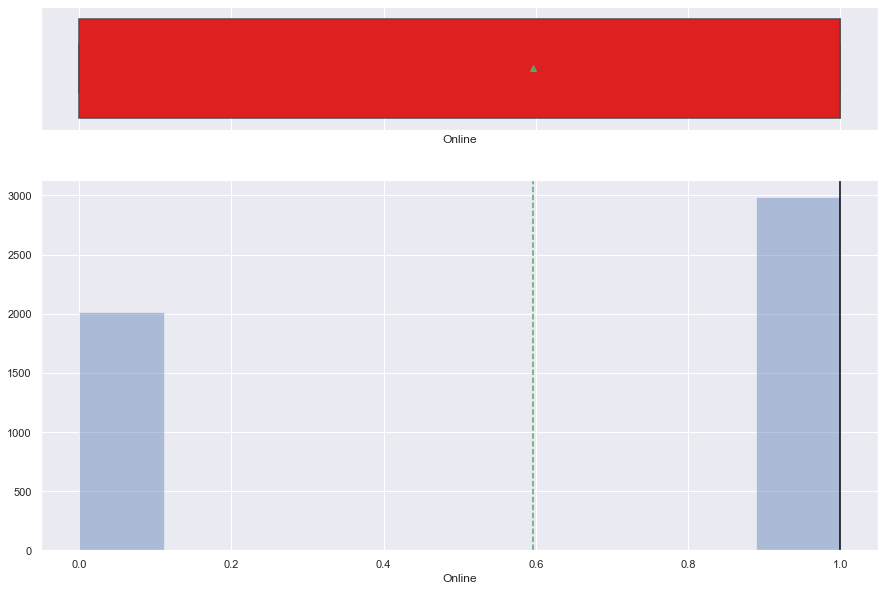

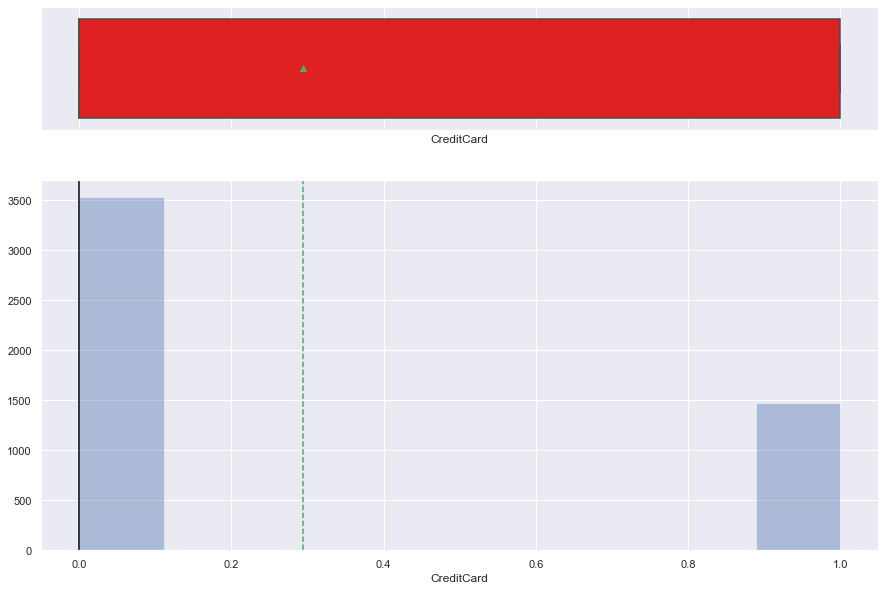

<IPython.core.display.Javascript object>

In [45]:
display(numerical_features.apply(lambda x: histogram_boxplot(x)))

**Observations**
- `Mortgage` is skewed to the right with many outliers.
- `Education` has a close median and mean. The majority of customers have an Undergraduate degree.
- `CC_Avg` average amount is close to 2 and tells us that the mean of customers have $2k in average debt from credit cards.

### Bivariate Distributions

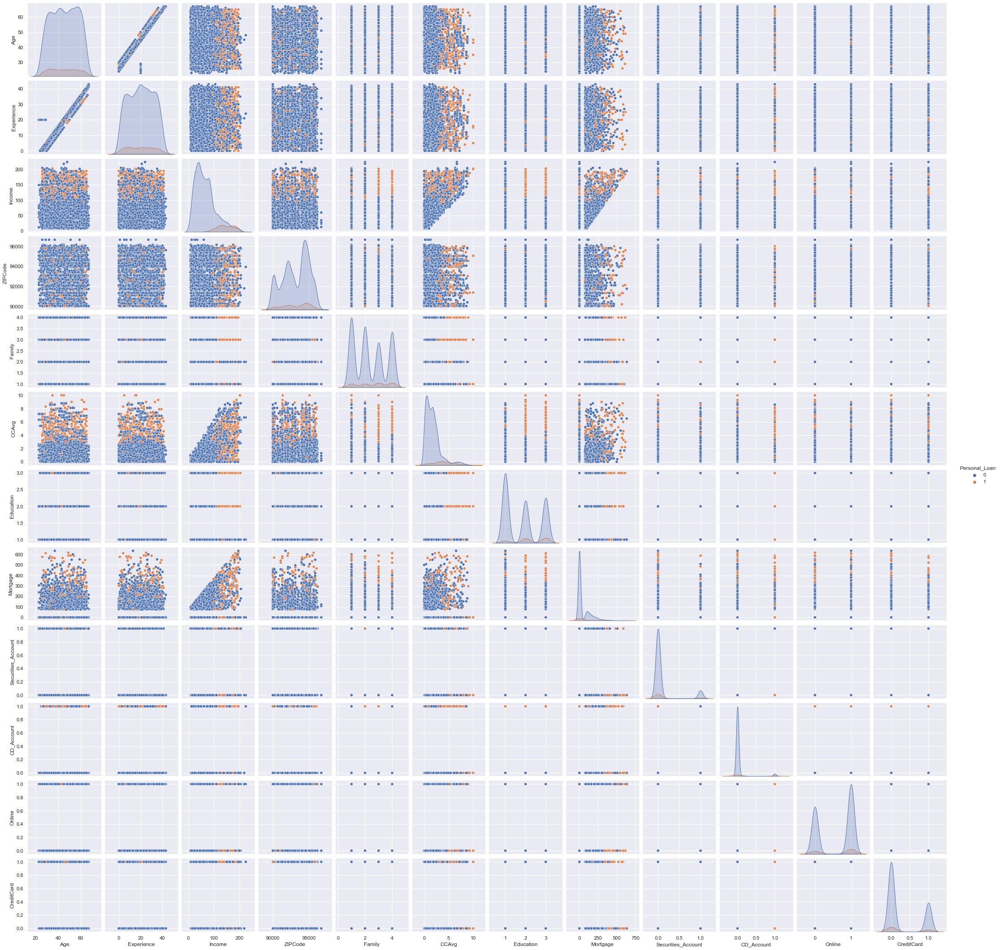

<IPython.core.display.Javascript object>

In [46]:
# Covariance analysis
sns.pairplot(
    data=df, hue="Personal_Loan",
)
plt.show()

#### Categoricals

Age by Securities_Account Bar Plot


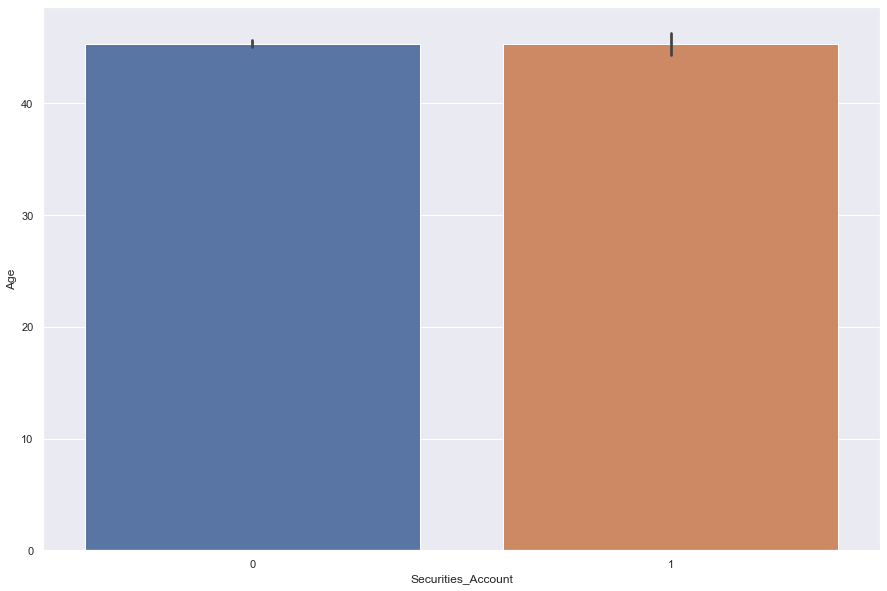

Age by Securities_Account Box Plot


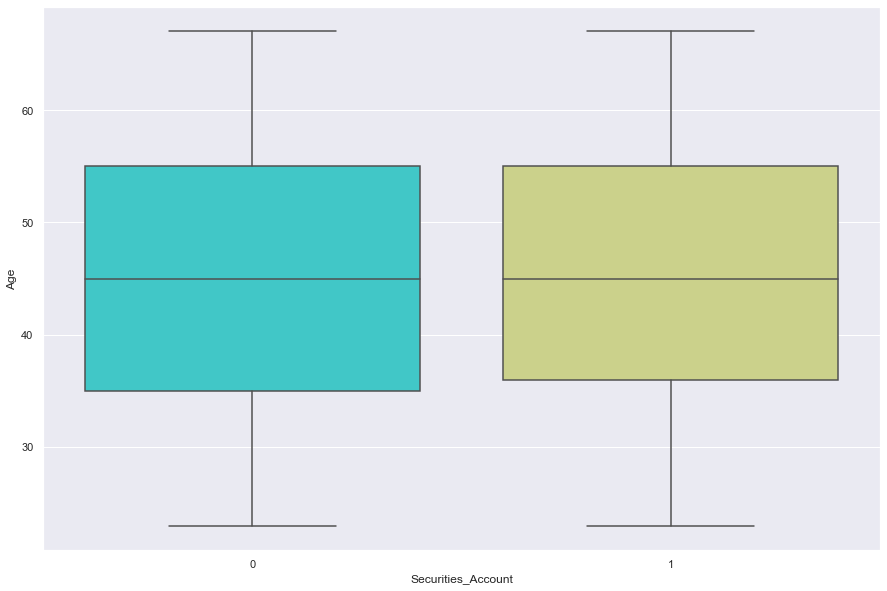

Age by Securities_Account Strip Plot


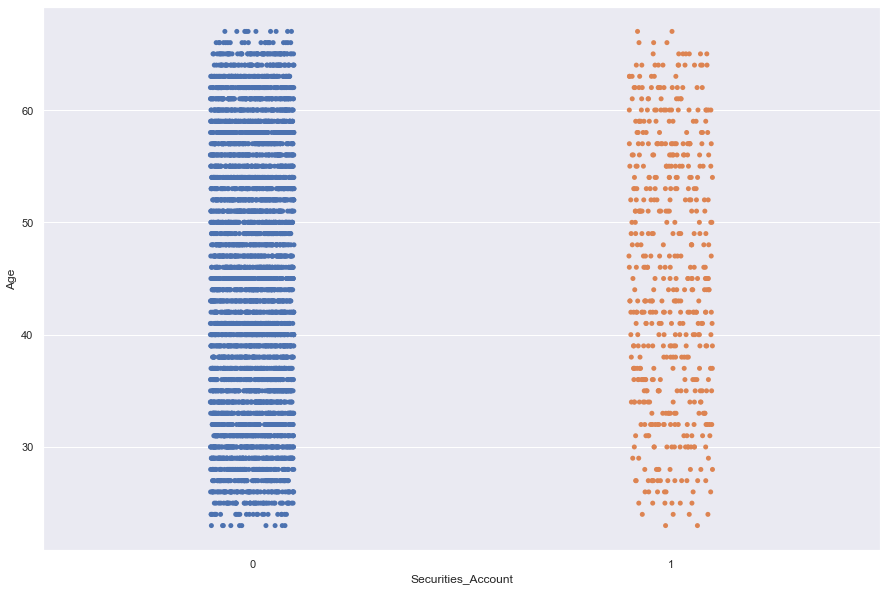

Age by CD_Account Bar Plot


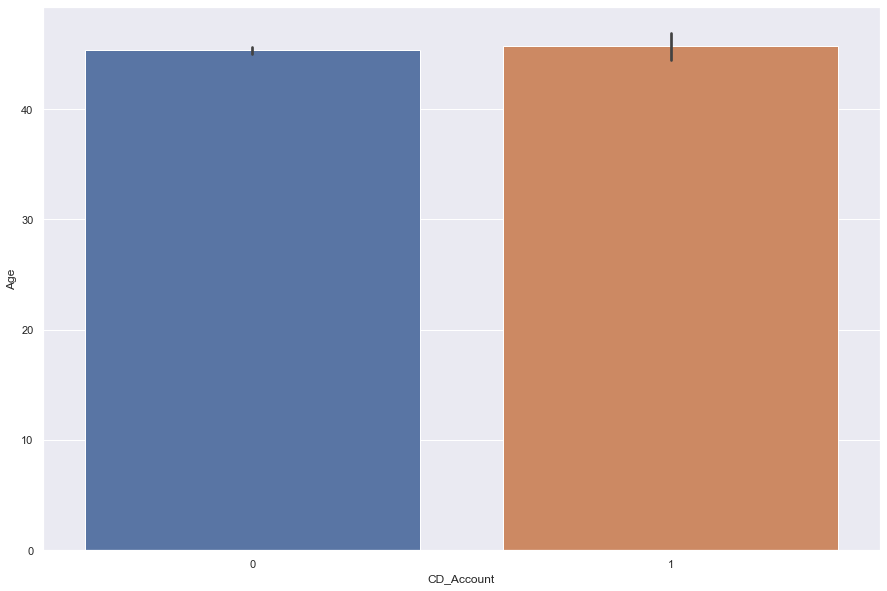

Age by CD_Account Box Plot


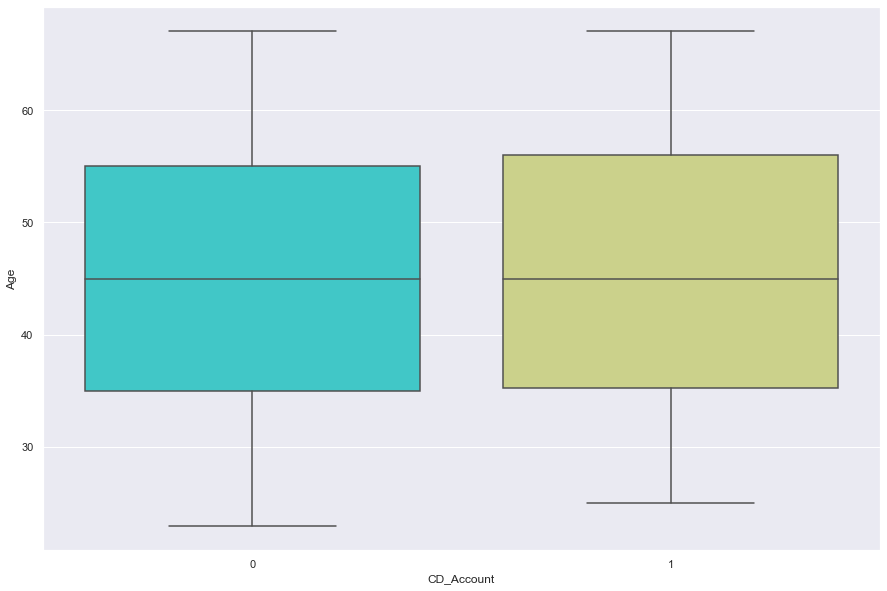

Age by CD_Account Strip Plot


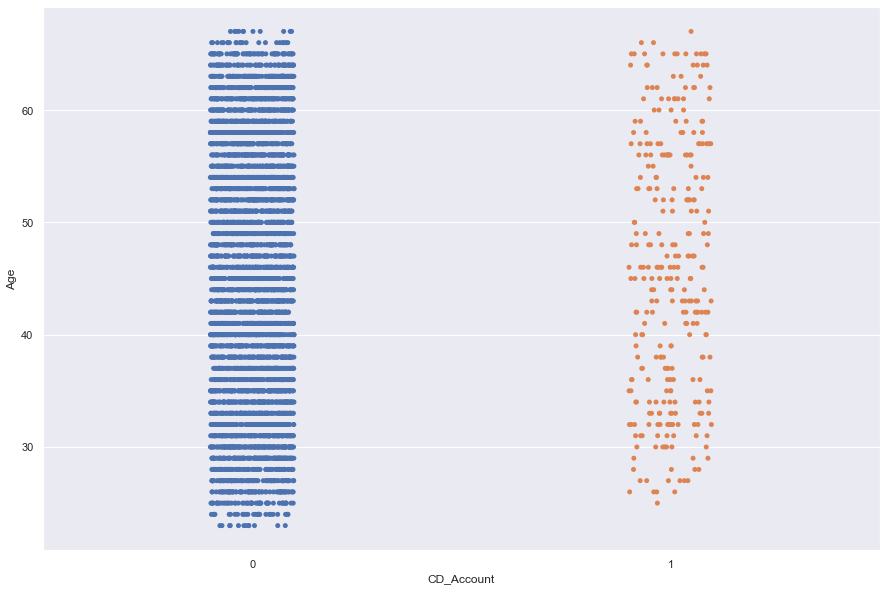

Age by Online Bar Plot


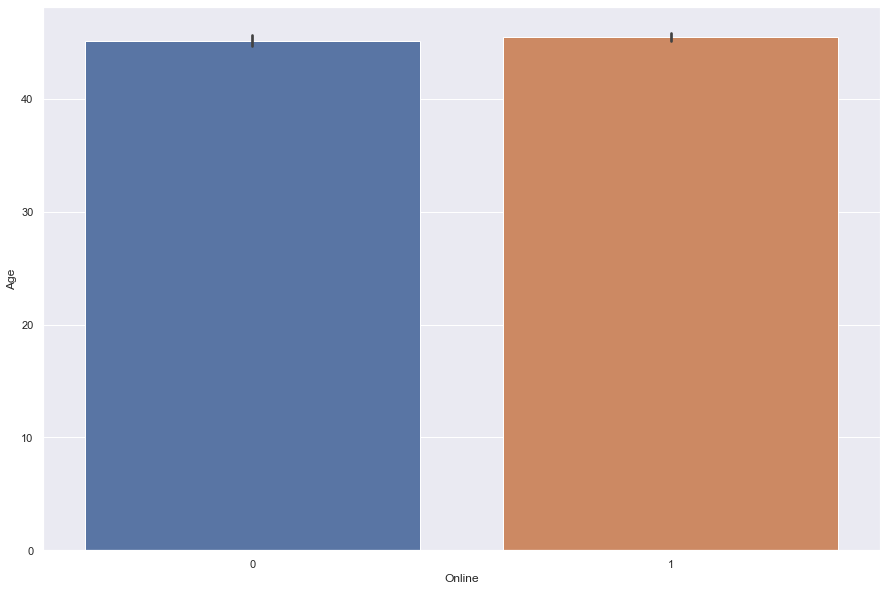

Age by Online Box Plot


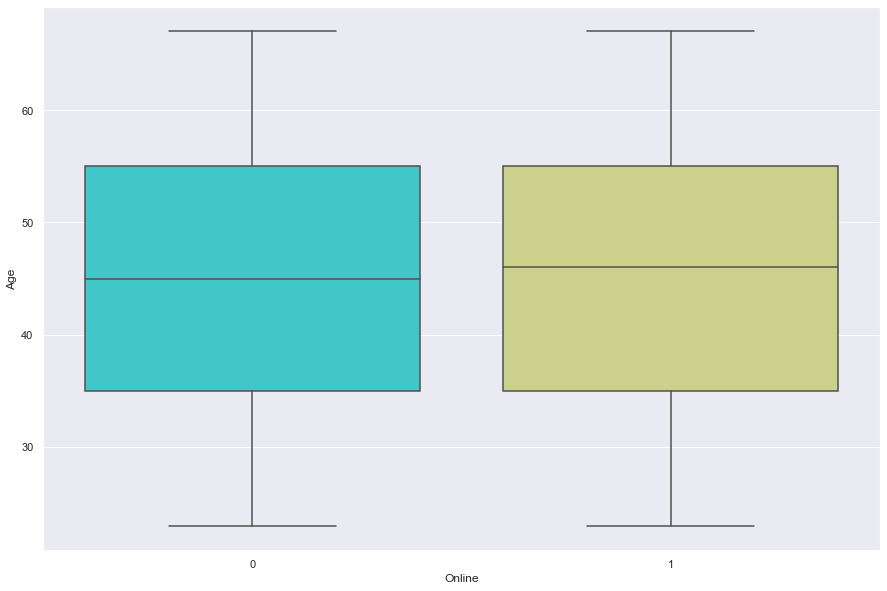

Age by Online Strip Plot


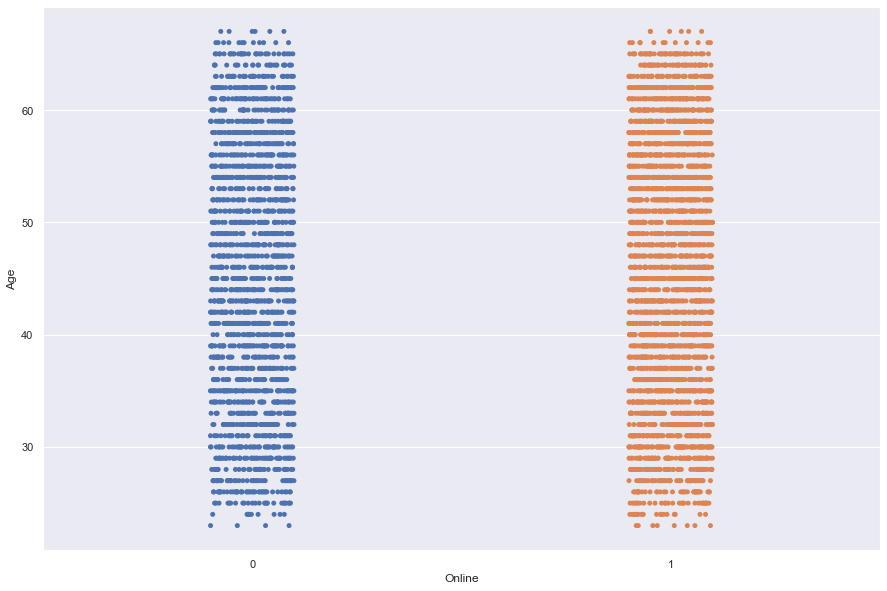

Age by CreditCard Bar Plot


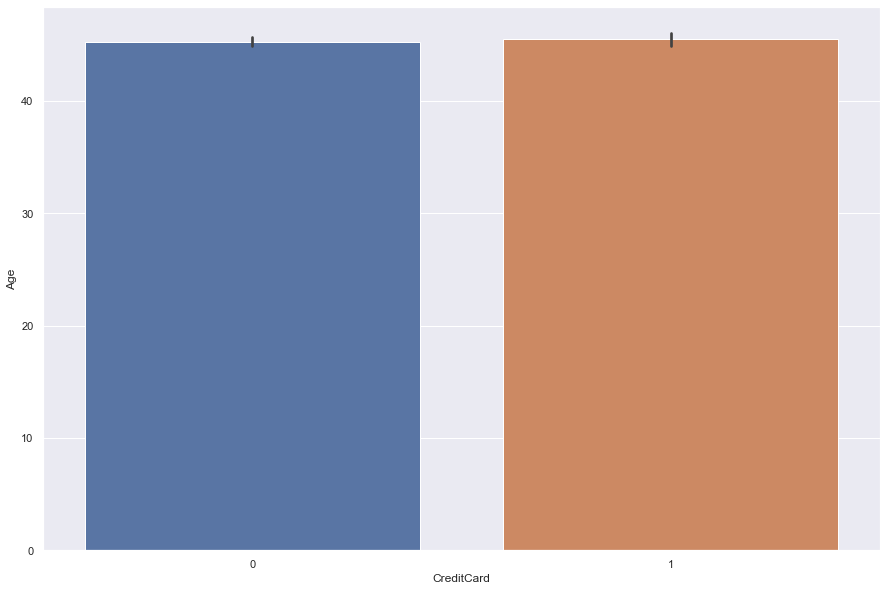

Age by CreditCard Box Plot


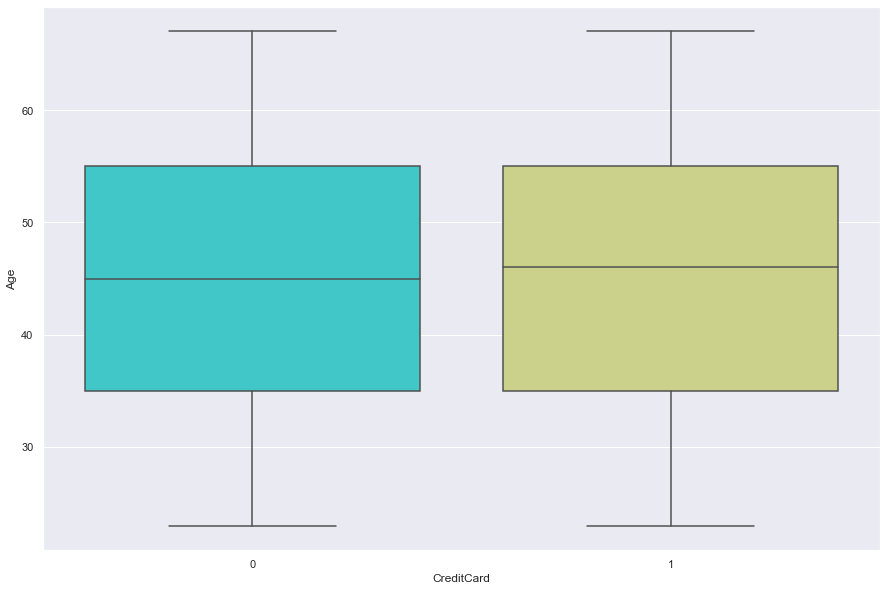

Age by CreditCard Strip Plot


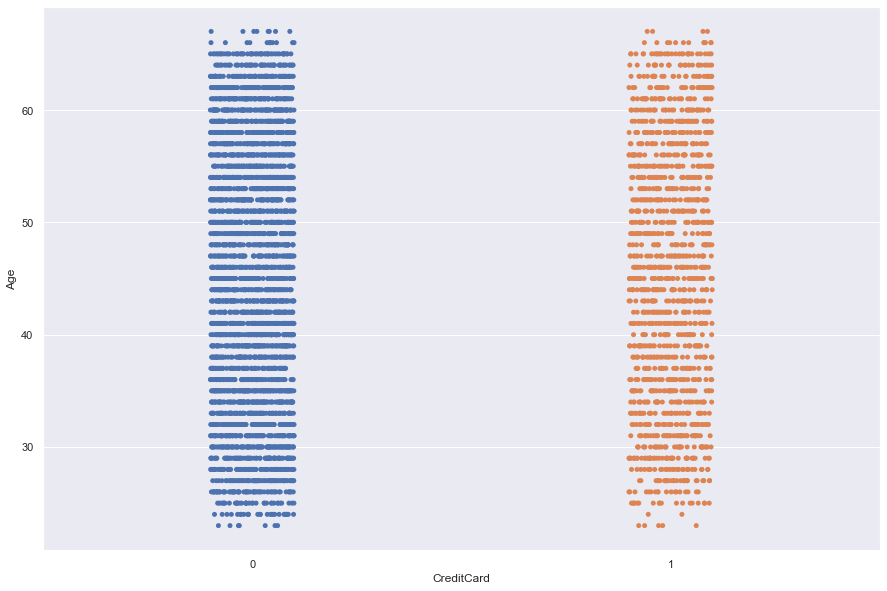

Experience by Securities_Account Bar Plot


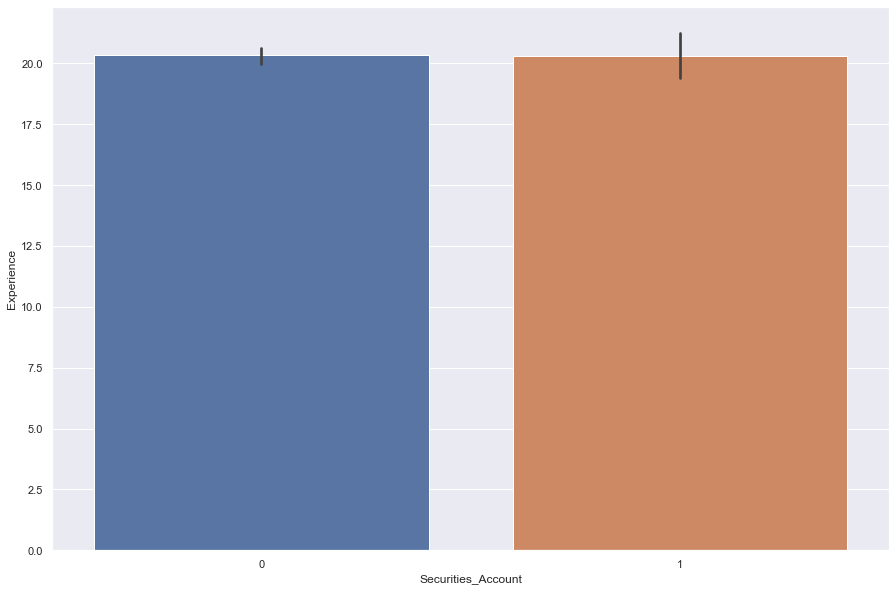

Experience by Securities_Account Box Plot


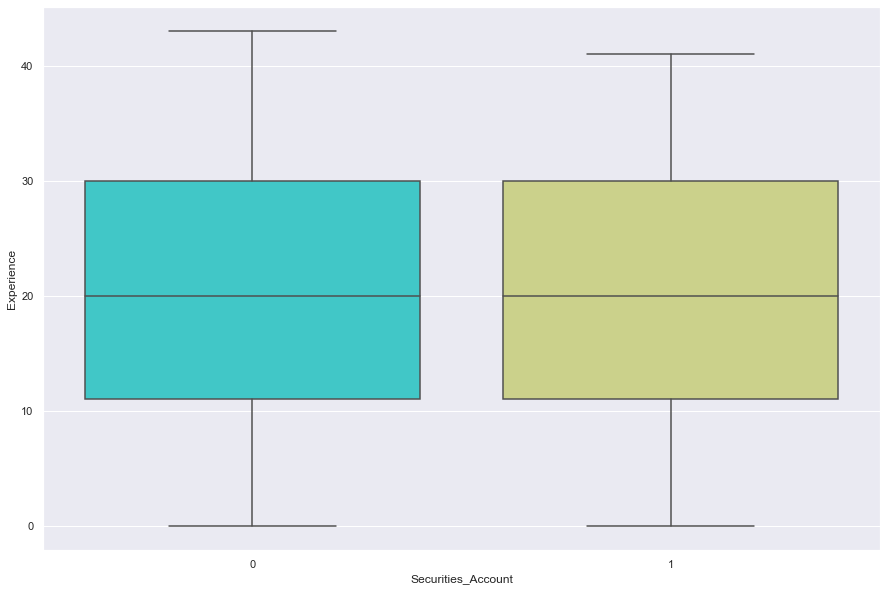

Experience by Securities_Account Strip Plot


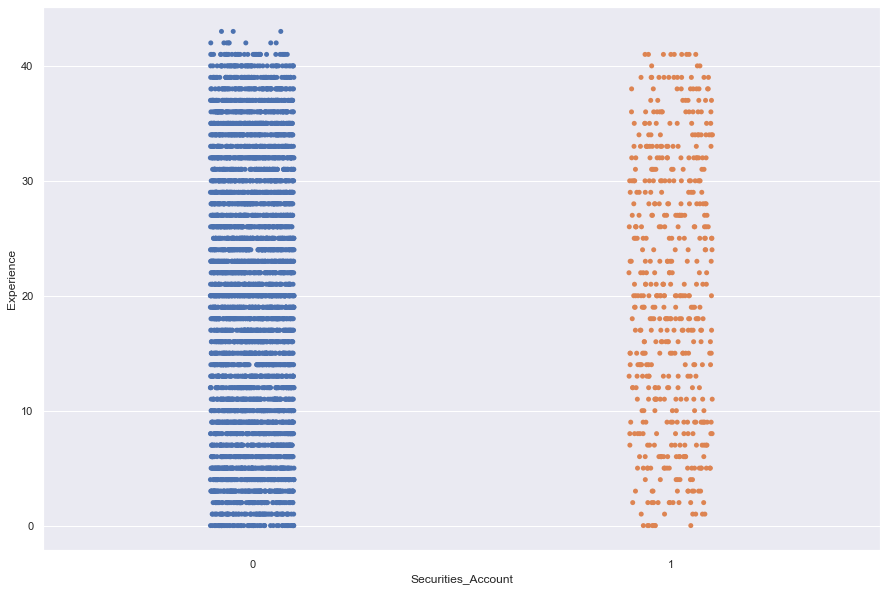

Experience by CD_Account Bar Plot


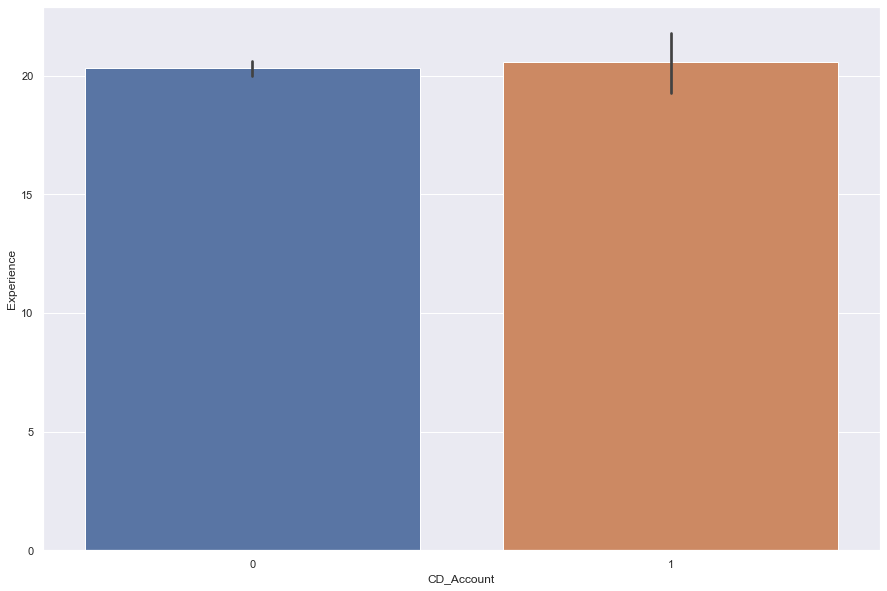

Experience by CD_Account Box Plot


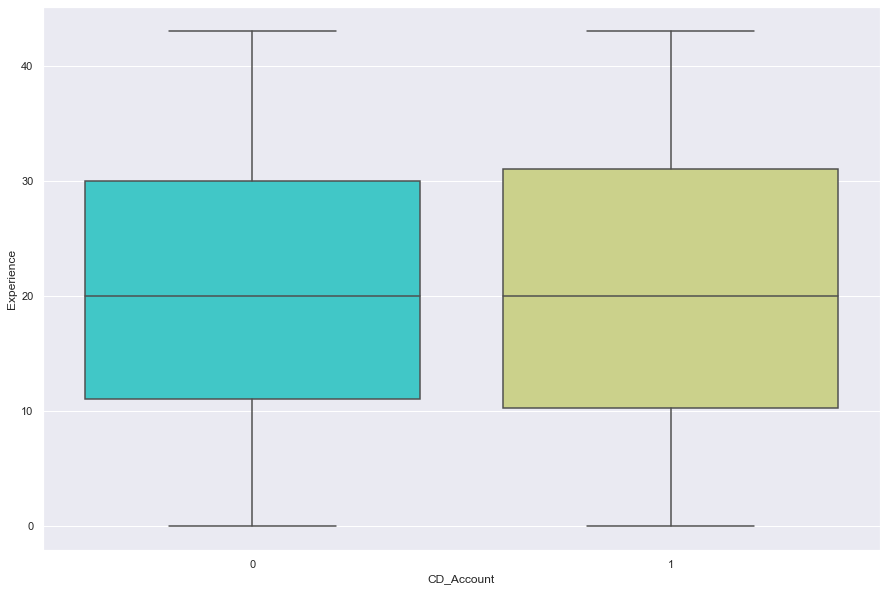

Experience by CD_Account Strip Plot


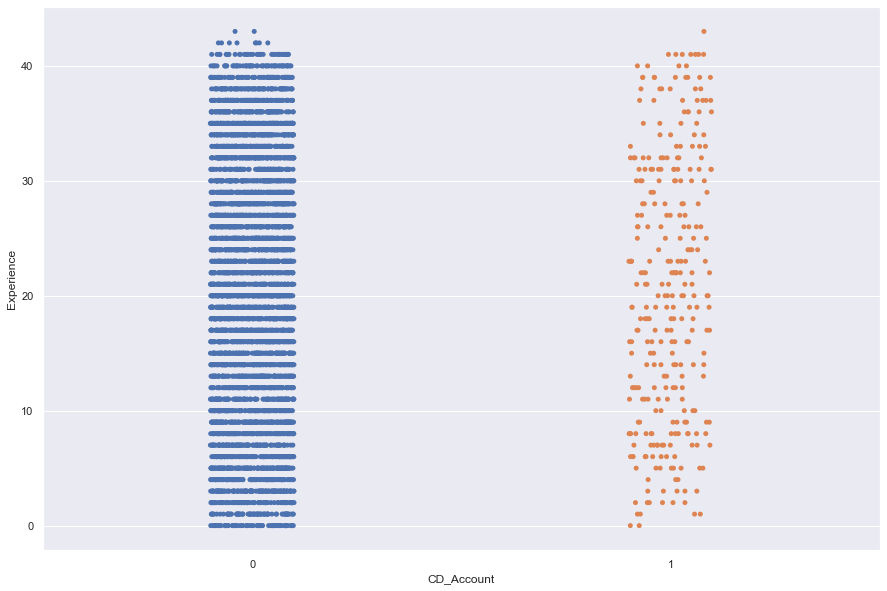

Experience by Online Bar Plot


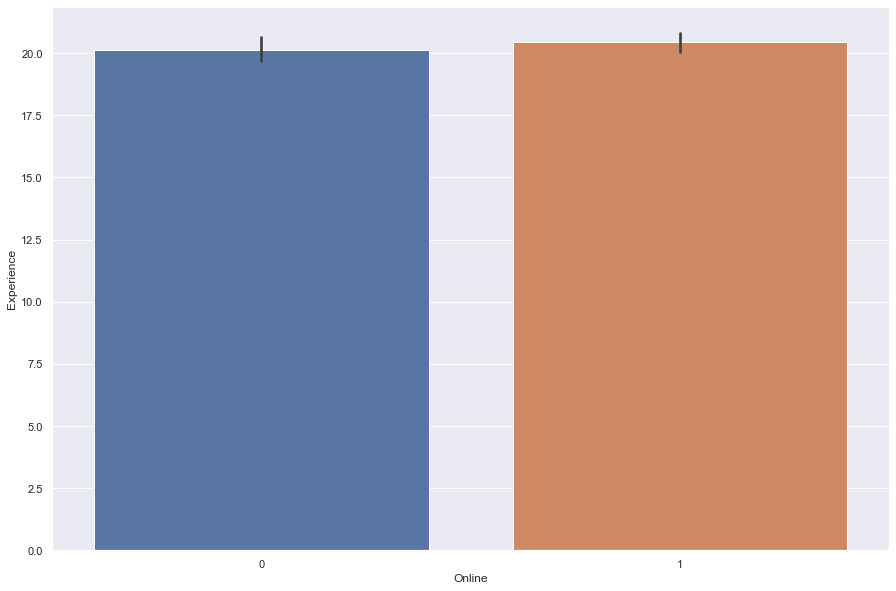

Experience by Online Box Plot


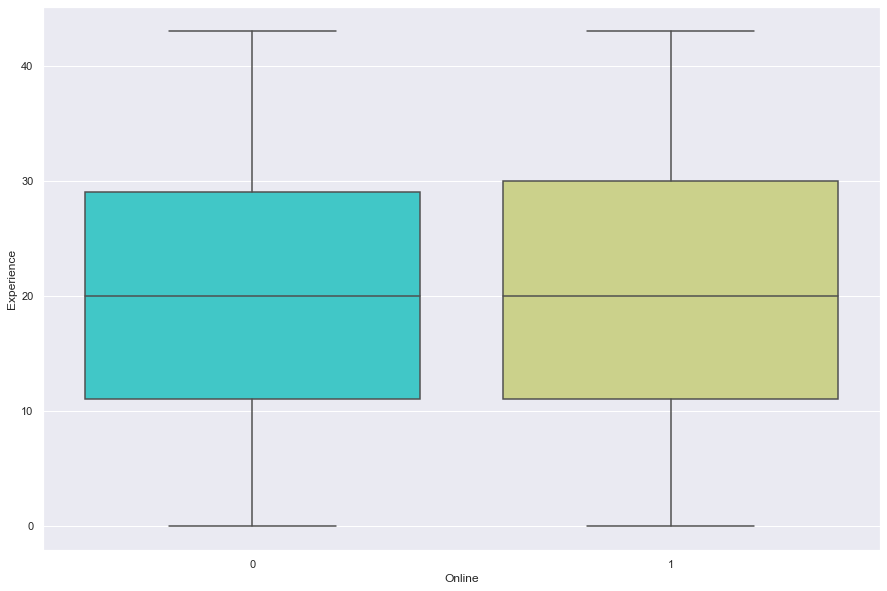

Experience by Online Strip Plot


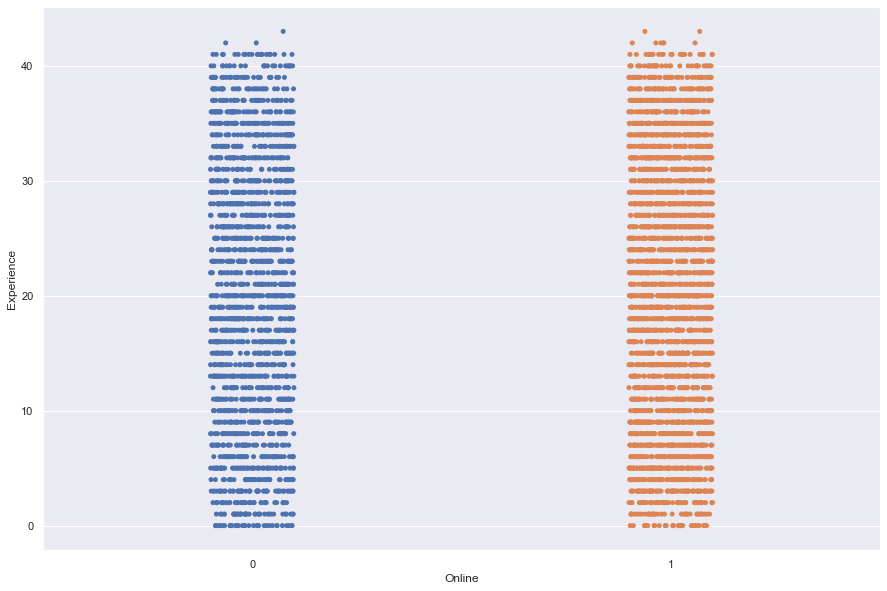

Experience by CreditCard Bar Plot


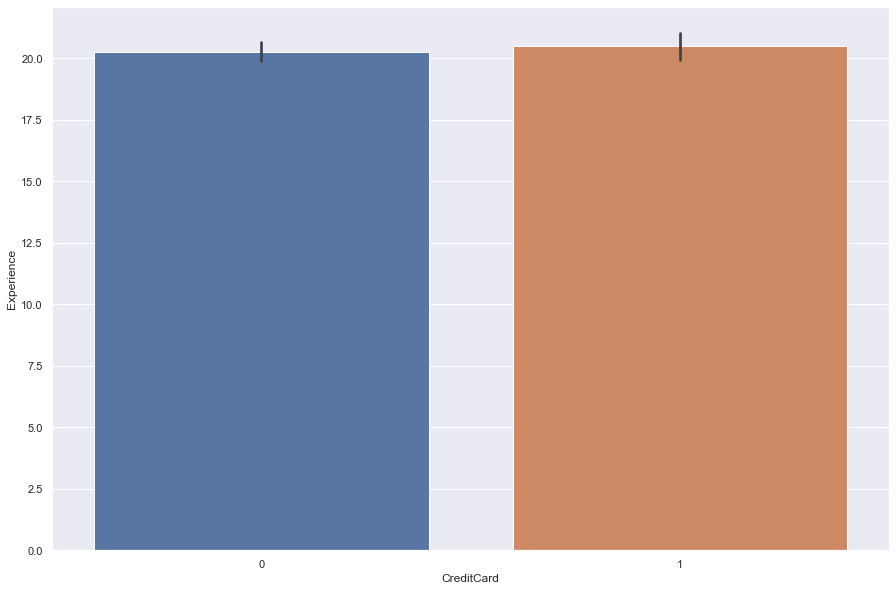

Experience by CreditCard Box Plot


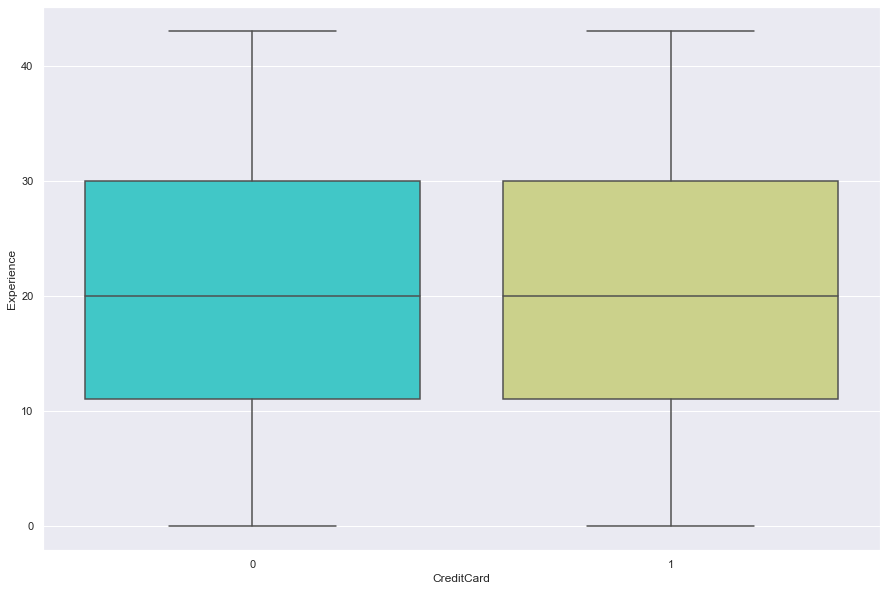

Experience by CreditCard Strip Plot


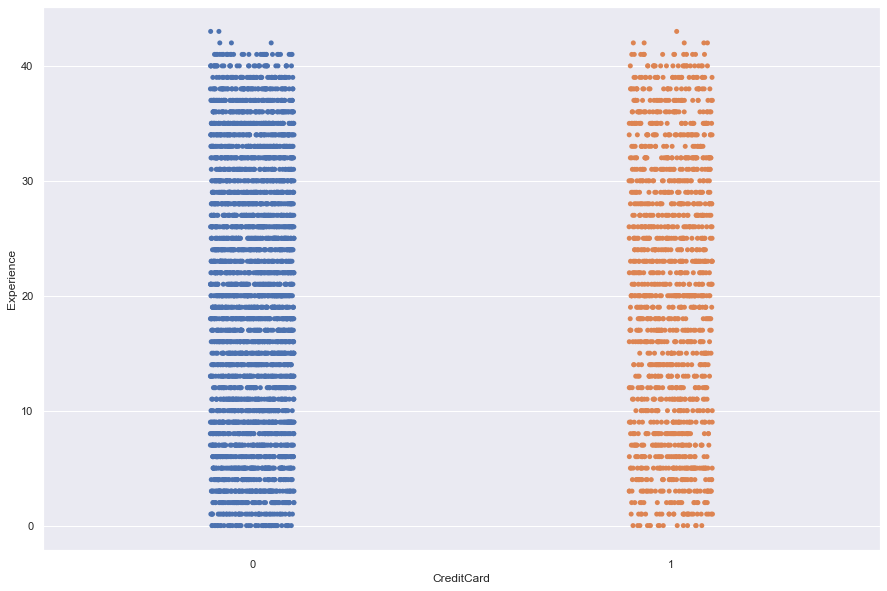

Income by Securities_Account Bar Plot


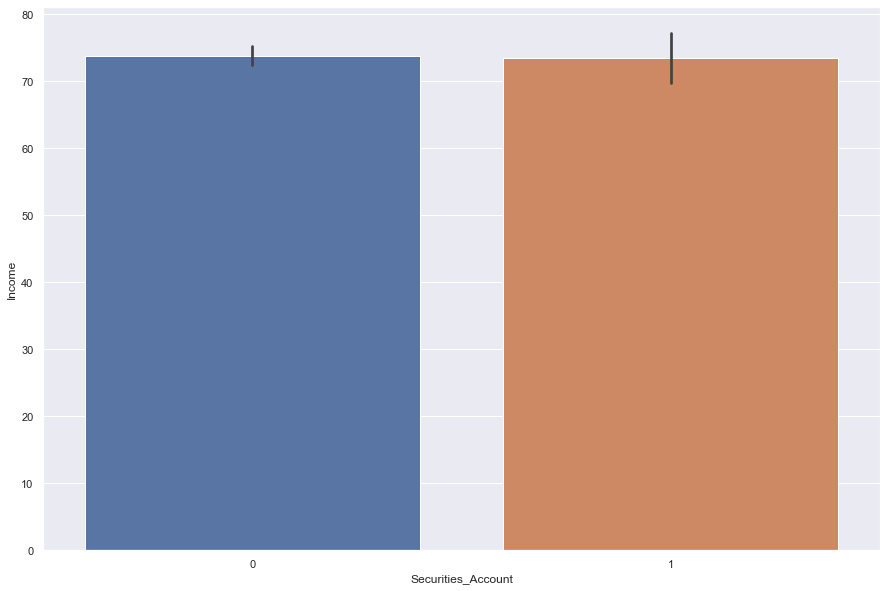

Income by Securities_Account Box Plot


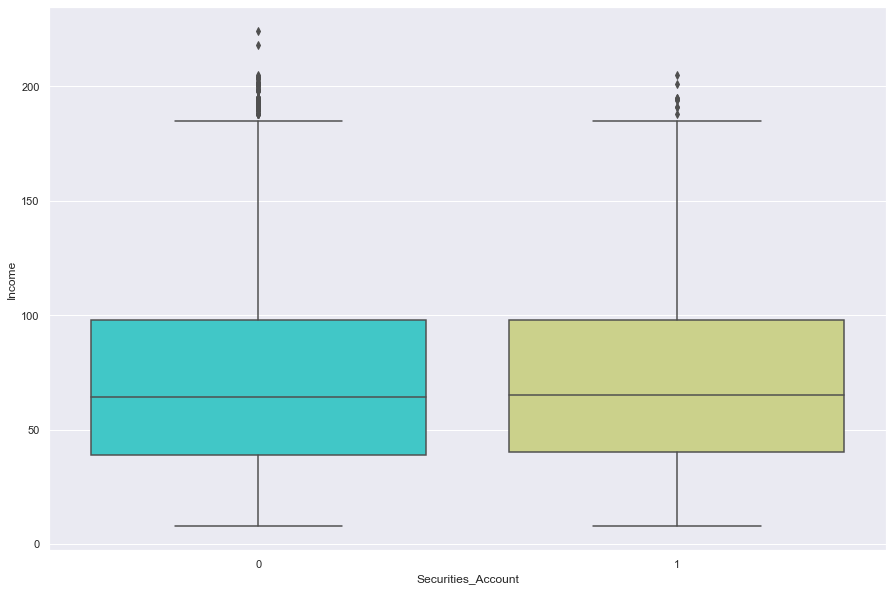

Income by Securities_Account Strip Plot


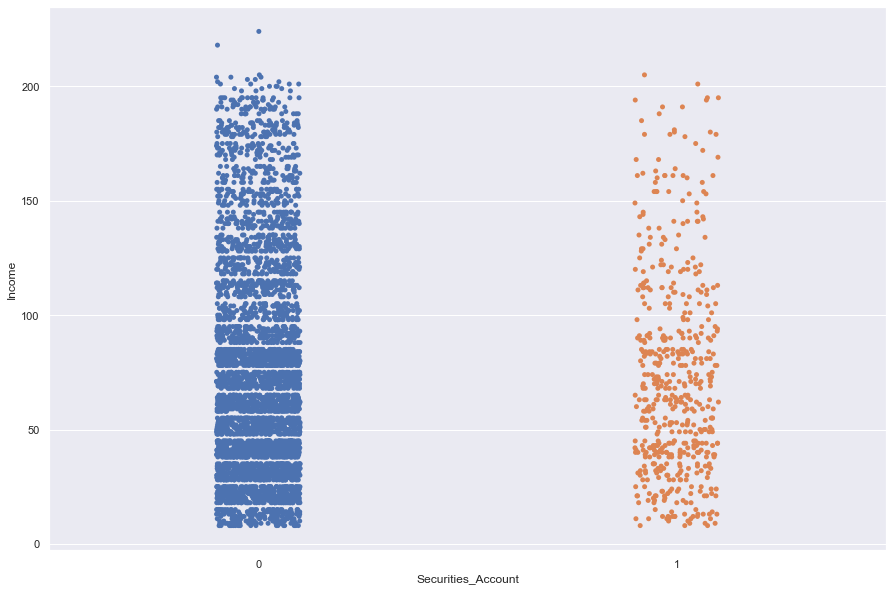

Income by CD_Account Bar Plot


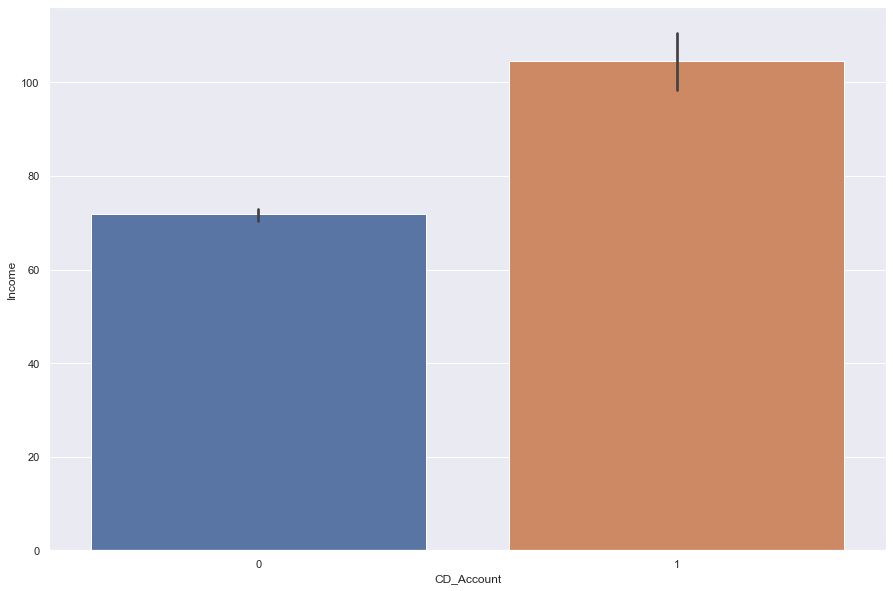

Income by CD_Account Box Plot


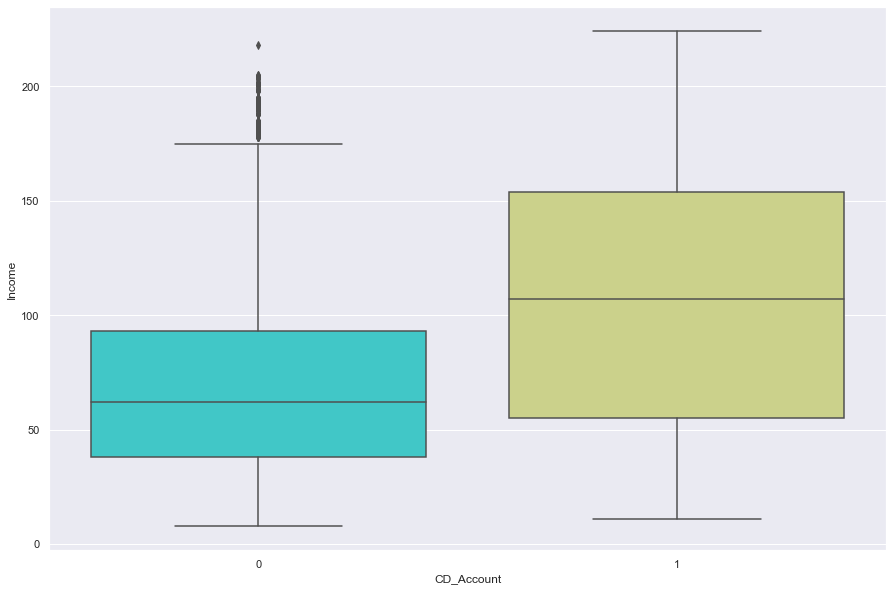

Income by CD_Account Strip Plot


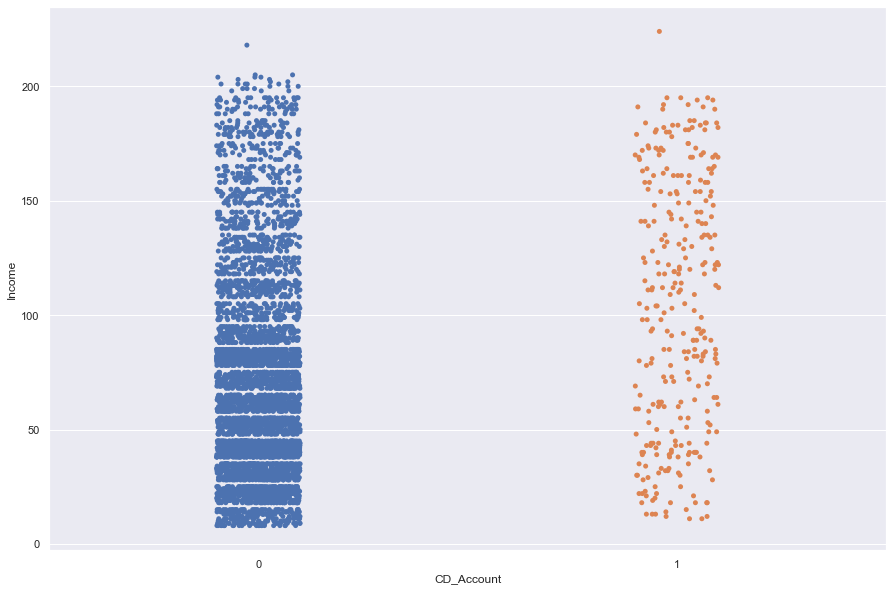

Income by Online Bar Plot


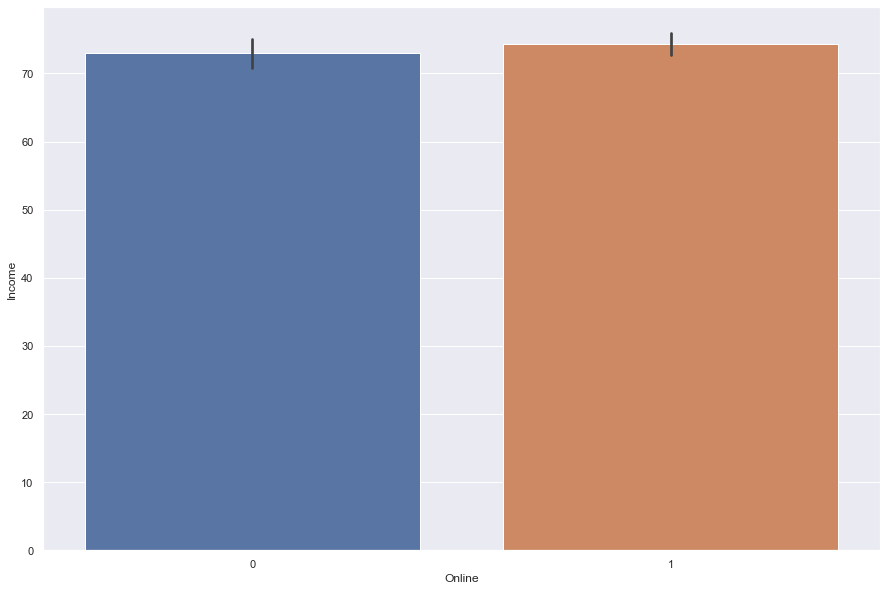

Income by Online Box Plot


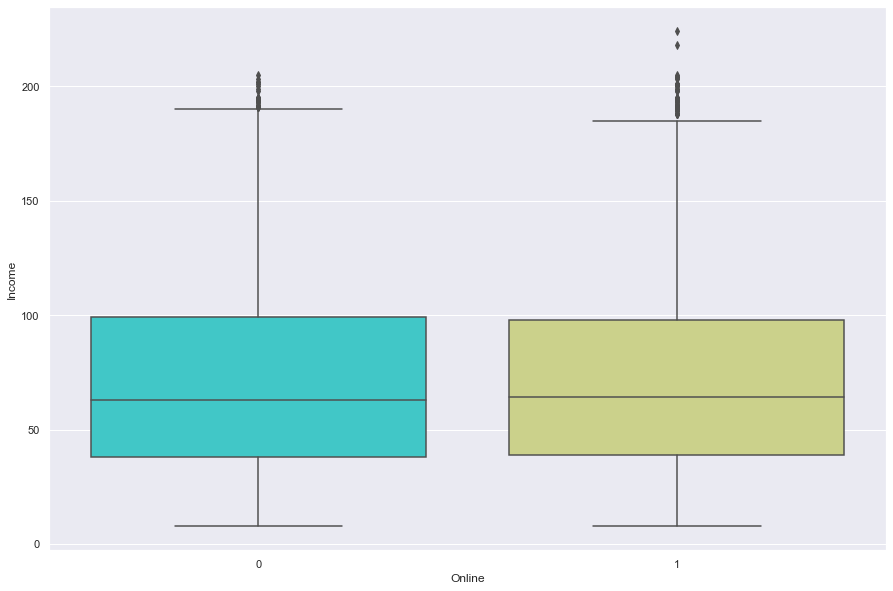

Income by Online Strip Plot


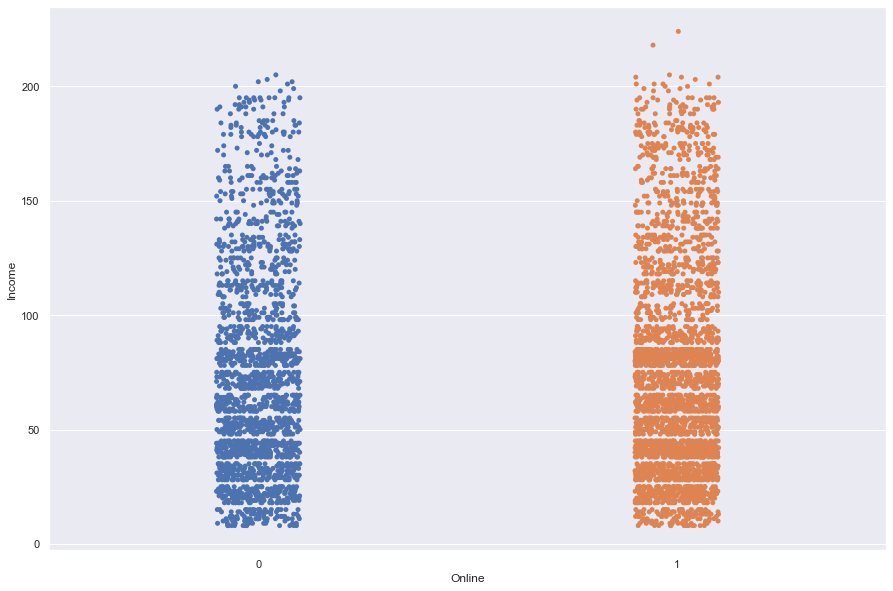

Income by CreditCard Bar Plot


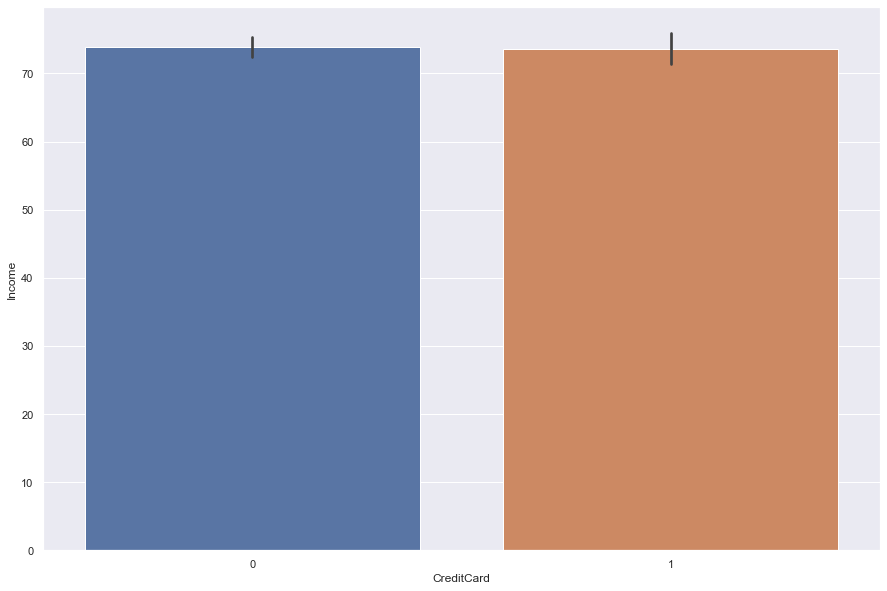

Income by CreditCard Box Plot


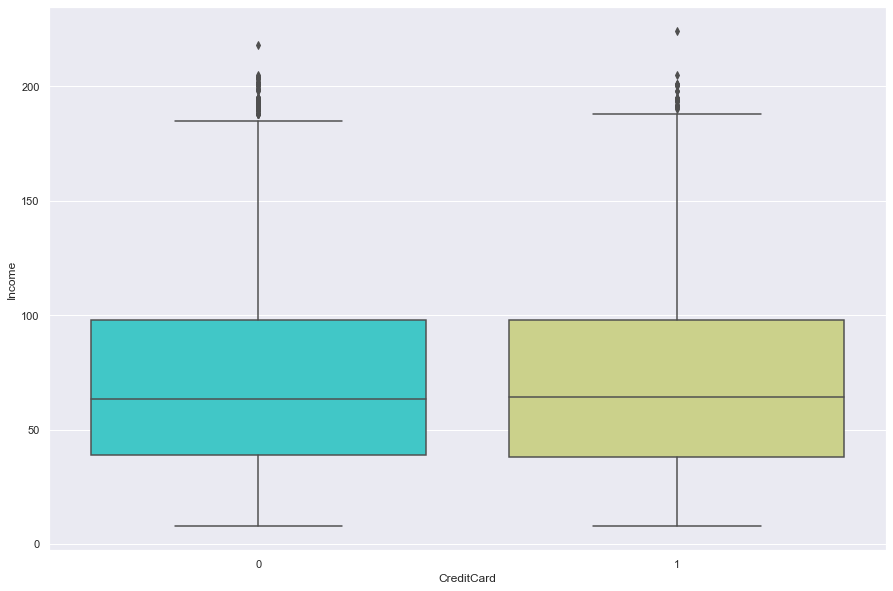

Income by CreditCard Strip Plot


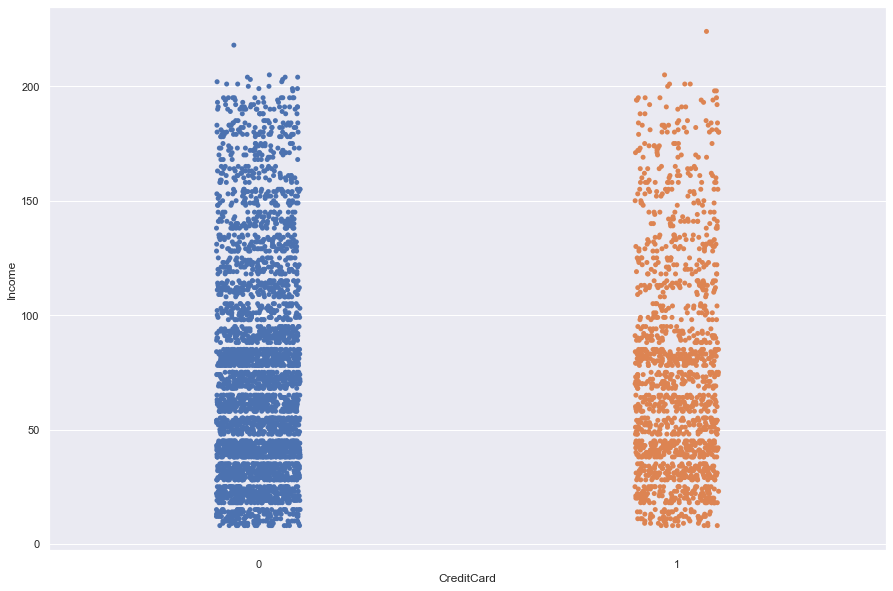

ZIPCode by Securities_Account Bar Plot


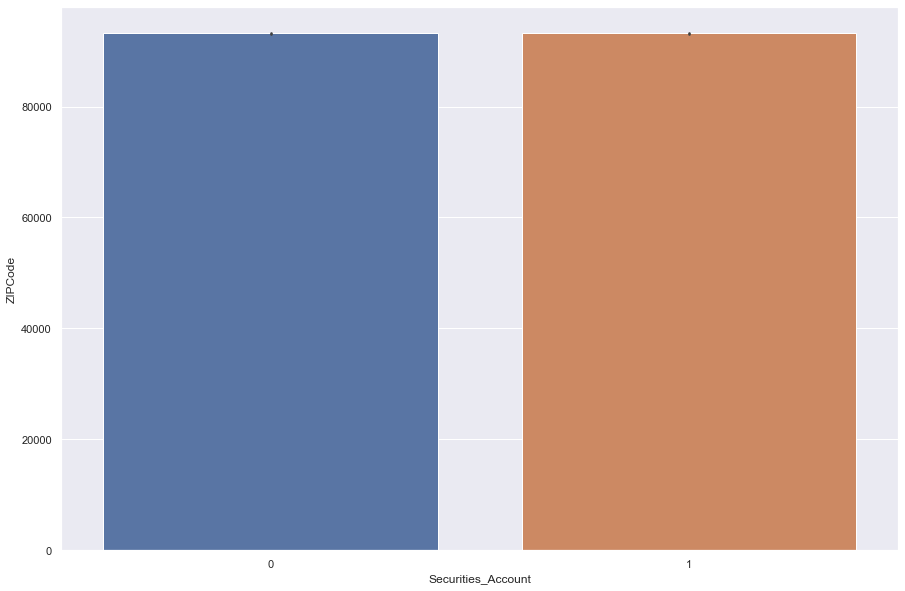

ZIPCode by Securities_Account Box Plot


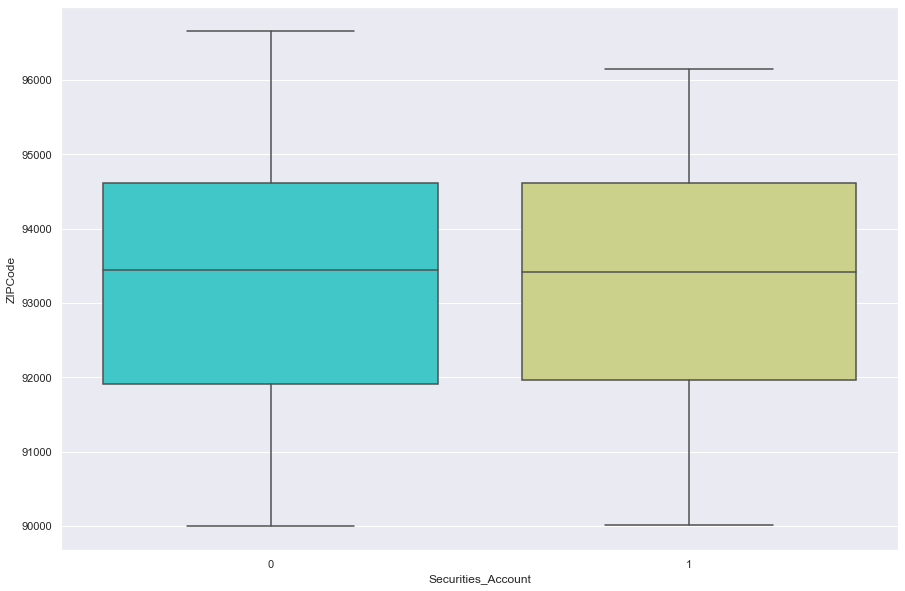

ZIPCode by Securities_Account Strip Plot


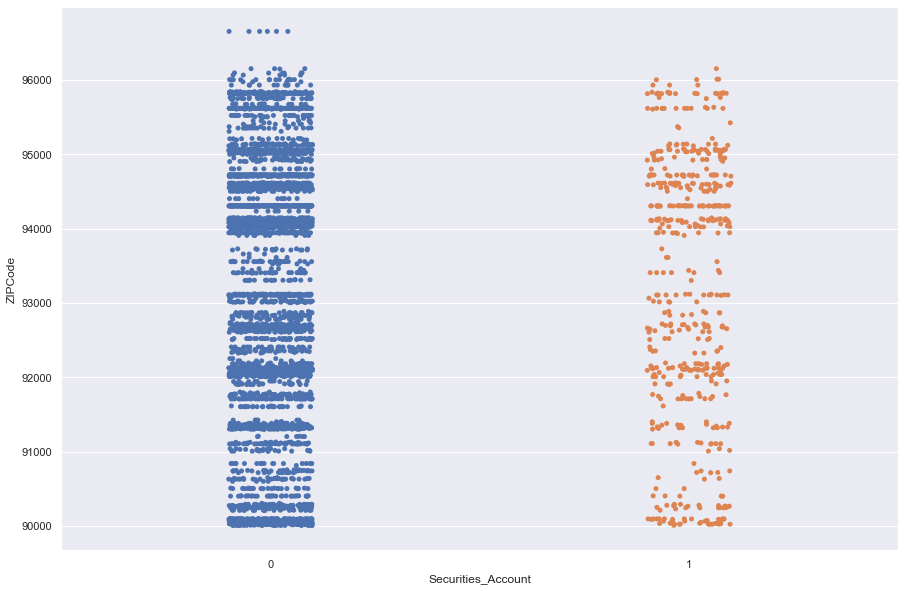

ZIPCode by CD_Account Bar Plot


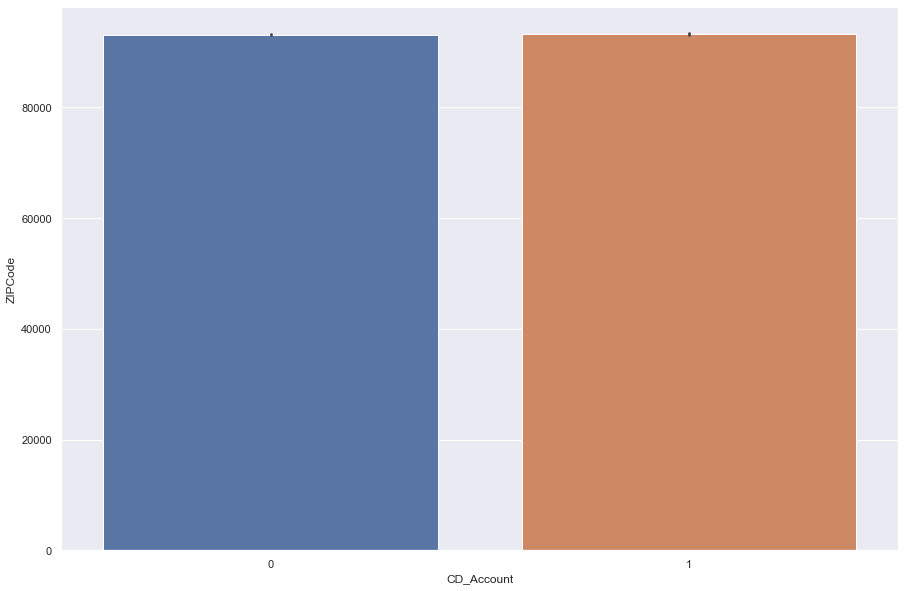

ZIPCode by CD_Account Box Plot


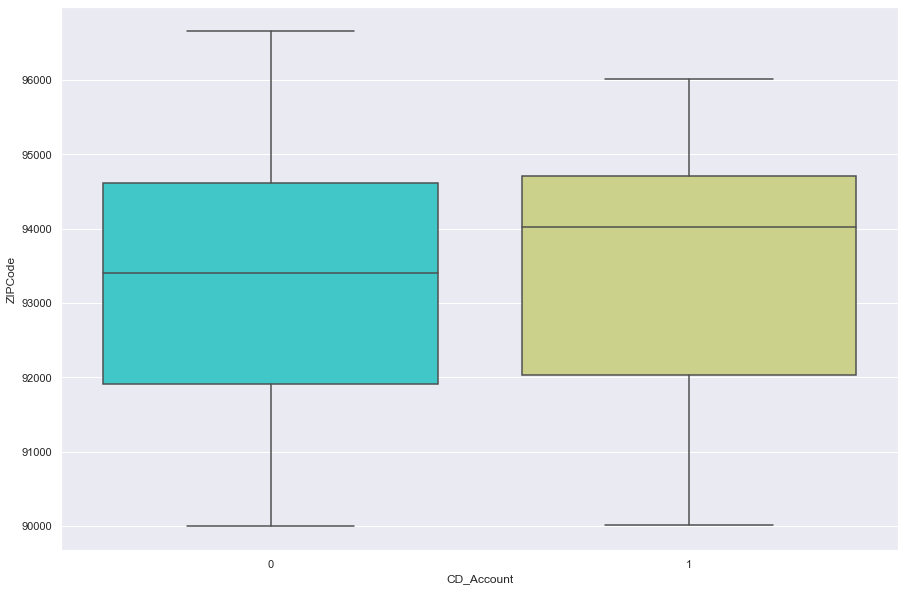

ZIPCode by CD_Account Strip Plot


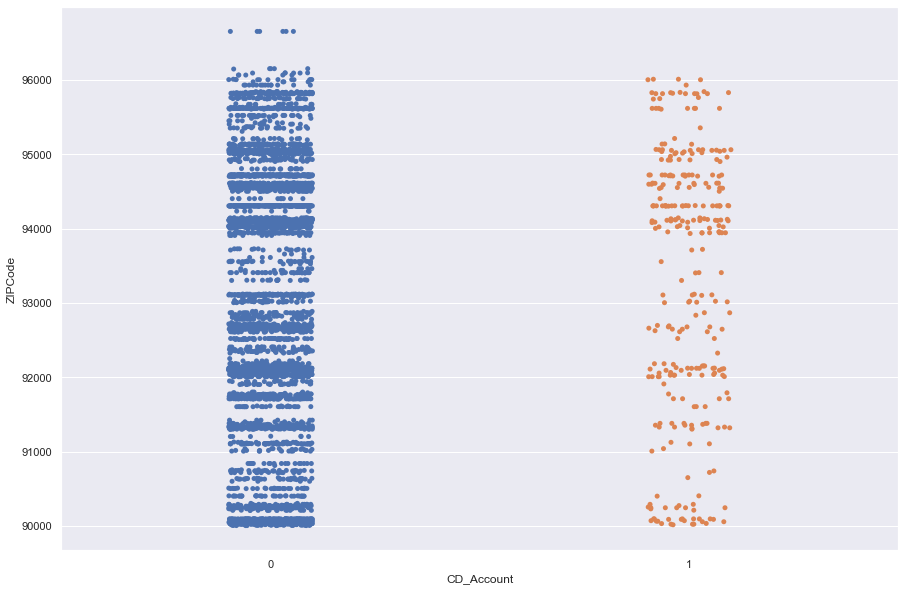

ZIPCode by Online Bar Plot


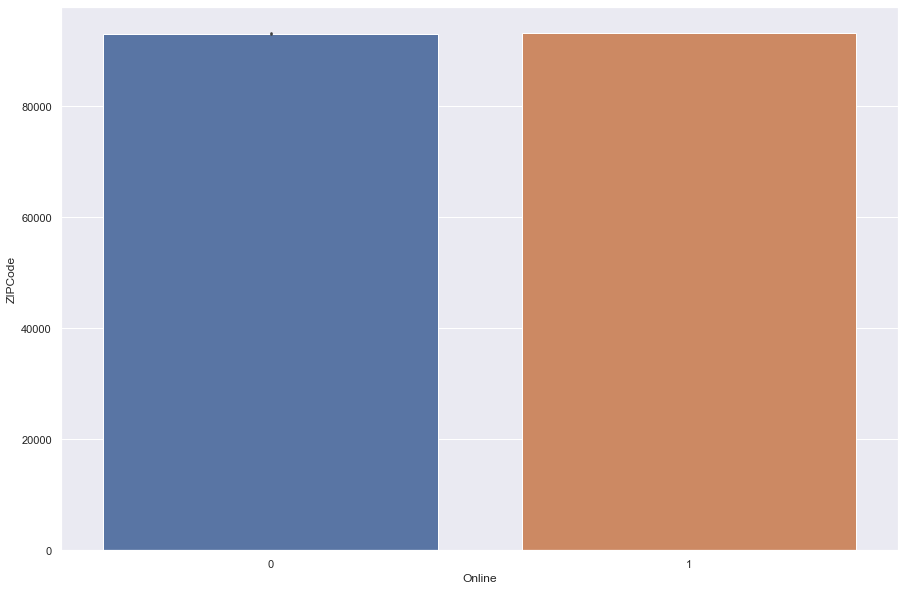

ZIPCode by Online Box Plot


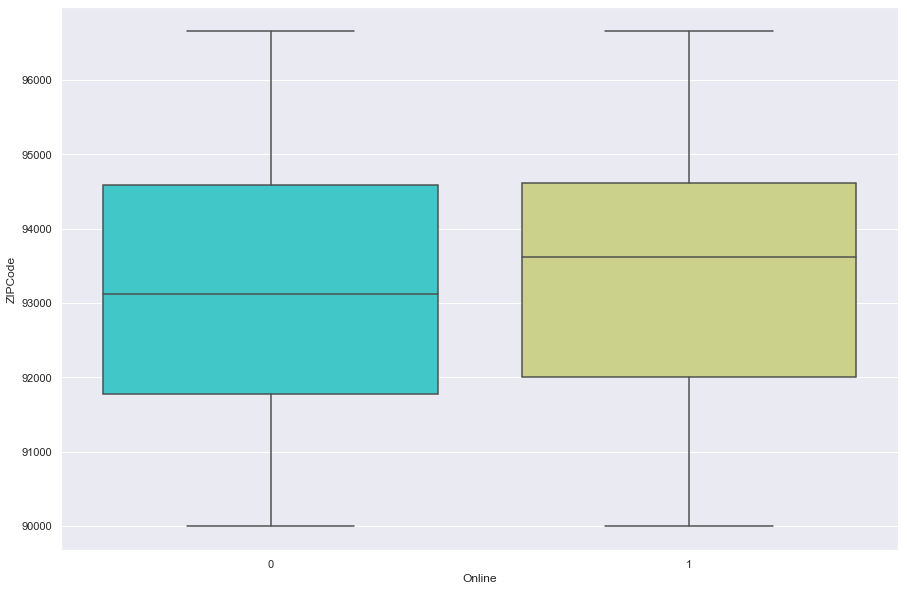

ZIPCode by Online Strip Plot


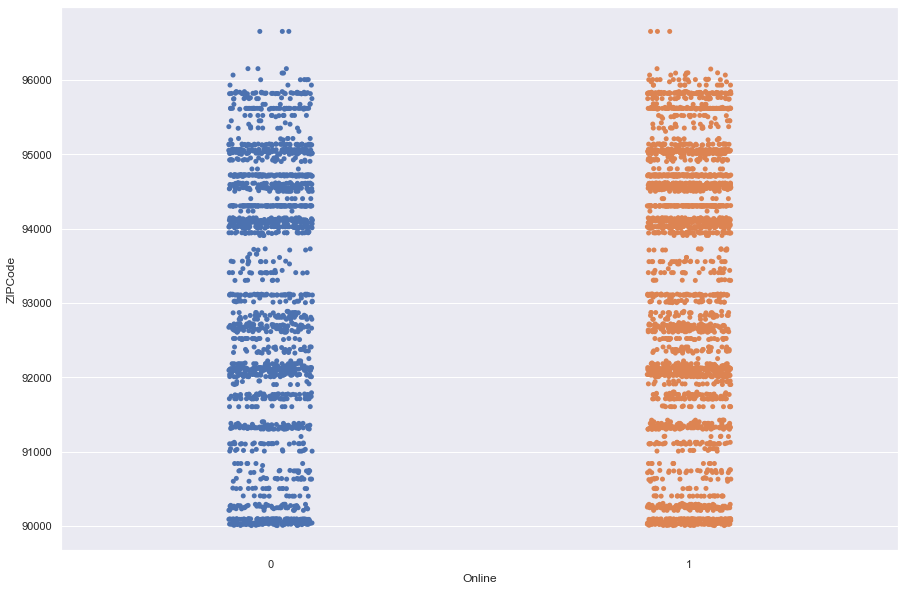

ZIPCode by CreditCard Bar Plot


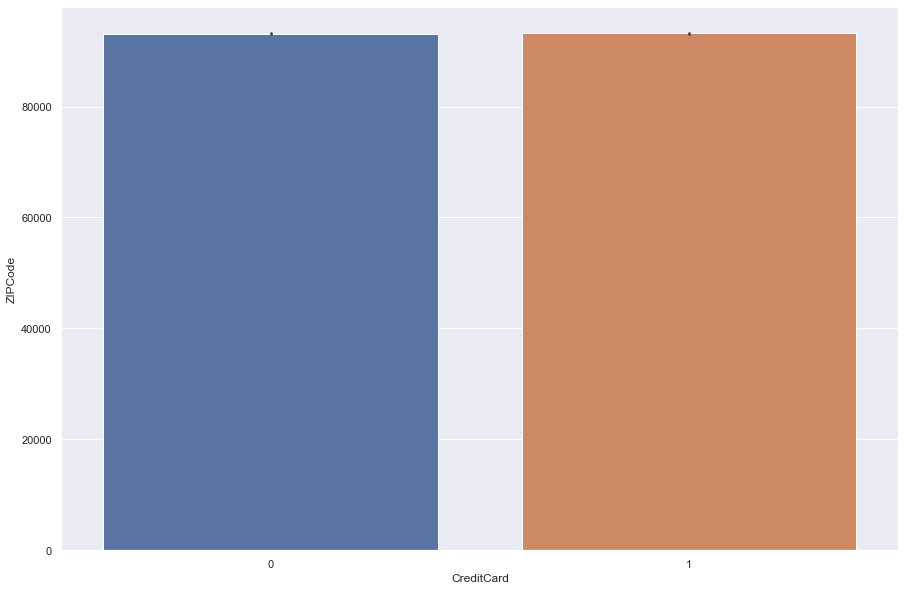

ZIPCode by CreditCard Box Plot


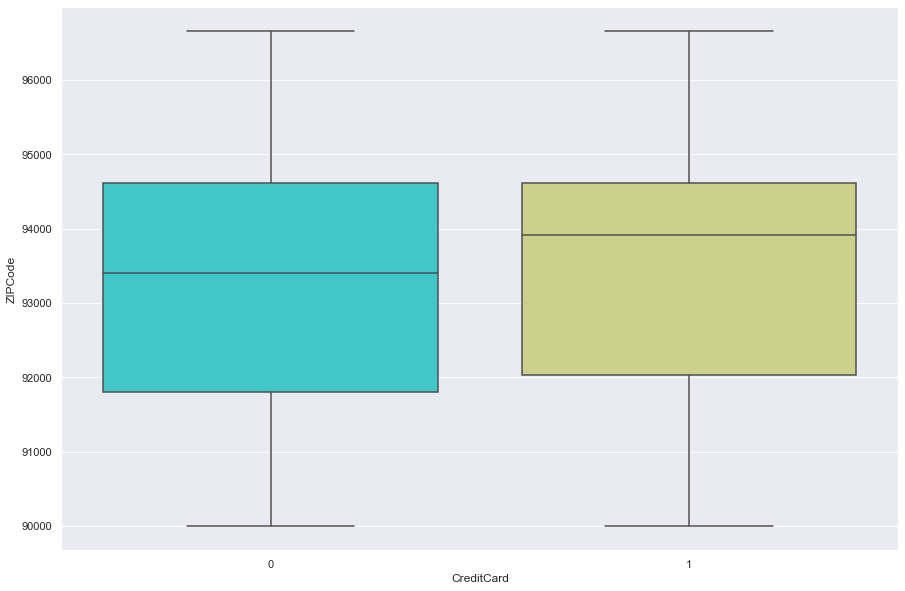

ZIPCode by CreditCard Strip Plot


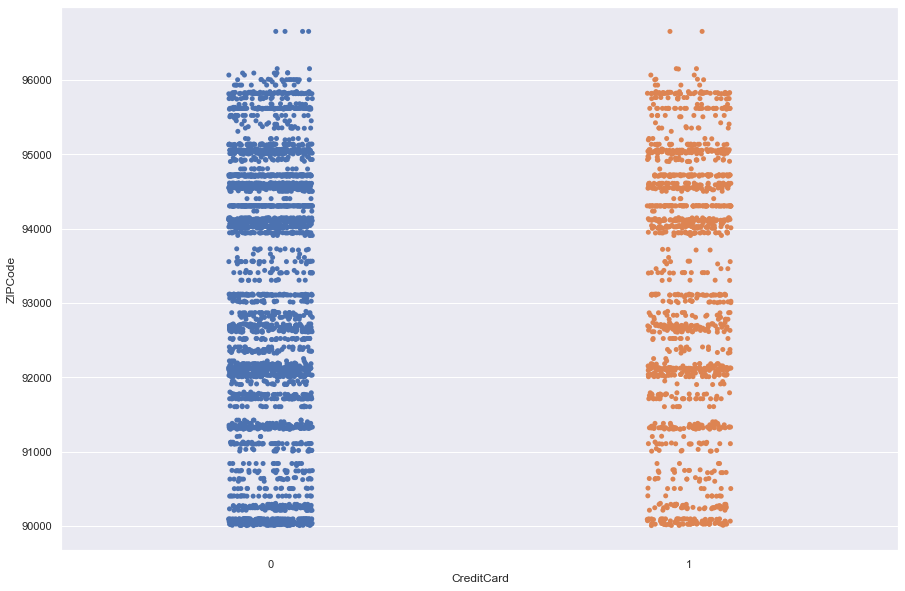

Family by Securities_Account Bar Plot


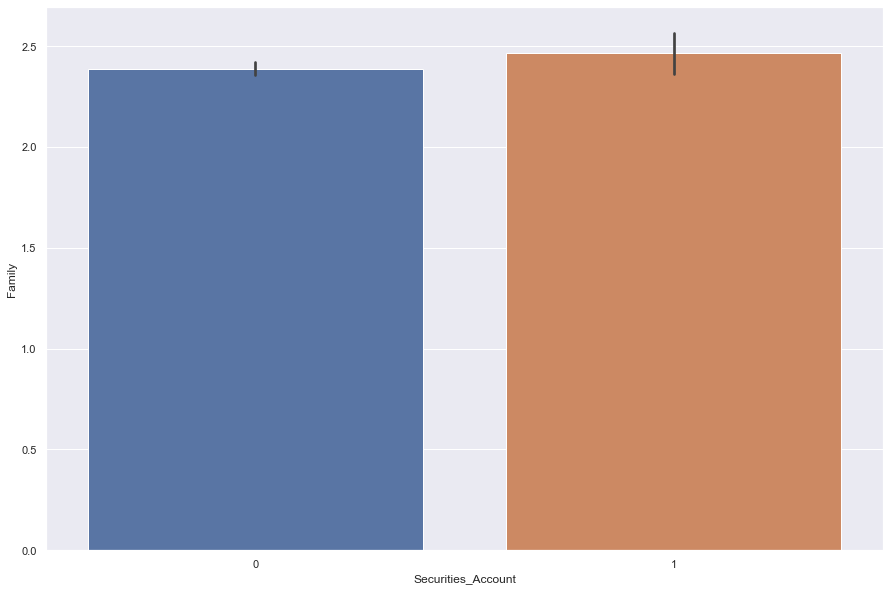

Family by Securities_Account Box Plot


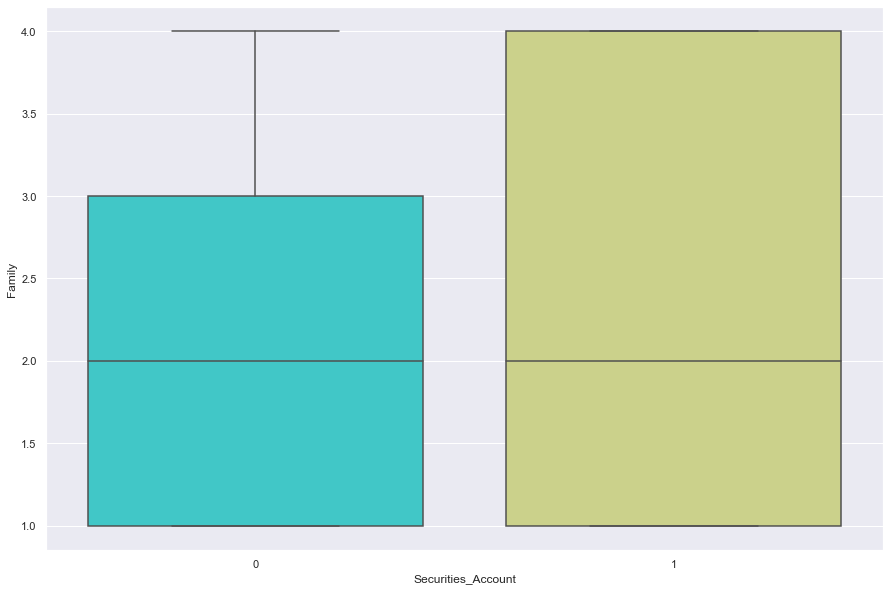

Family by Securities_Account Strip Plot


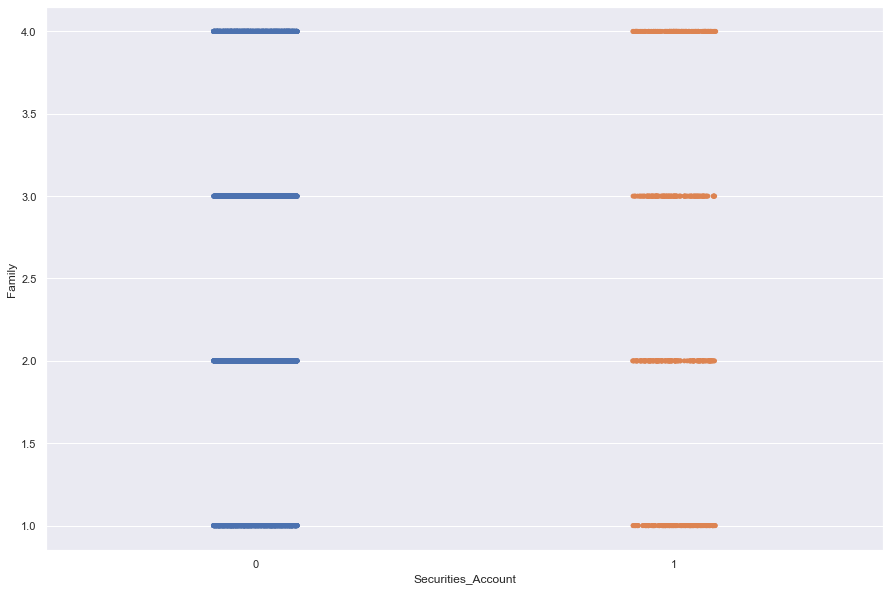

Family by CD_Account Bar Plot


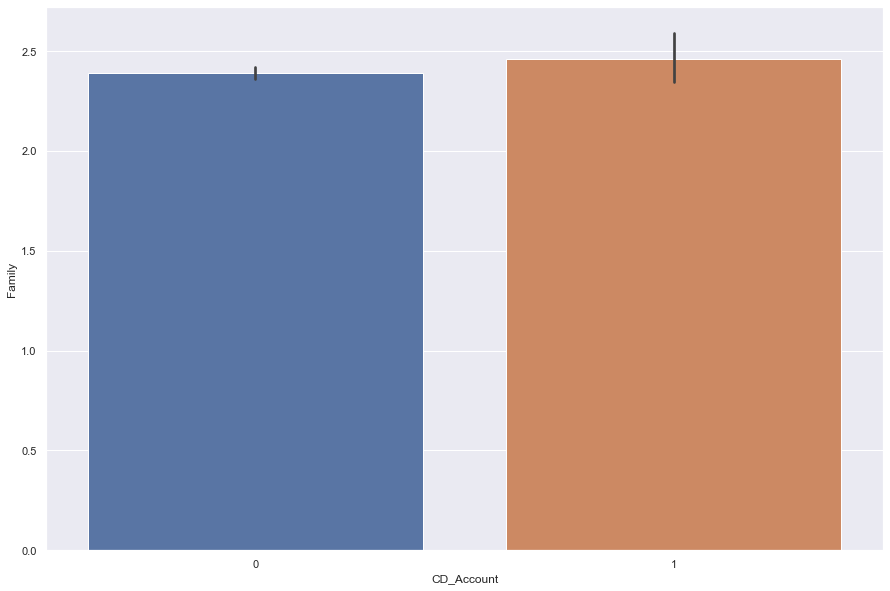

Family by CD_Account Box Plot


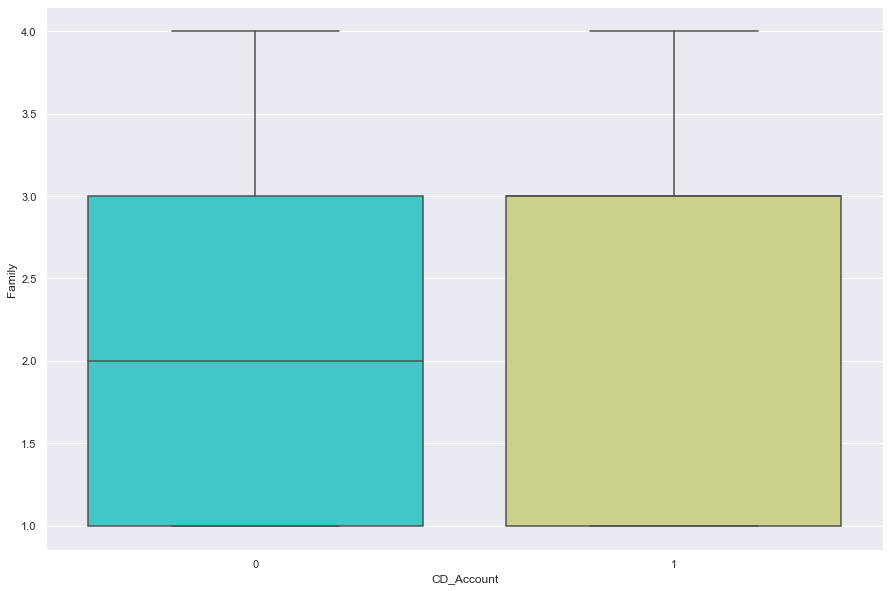

Family by CD_Account Strip Plot


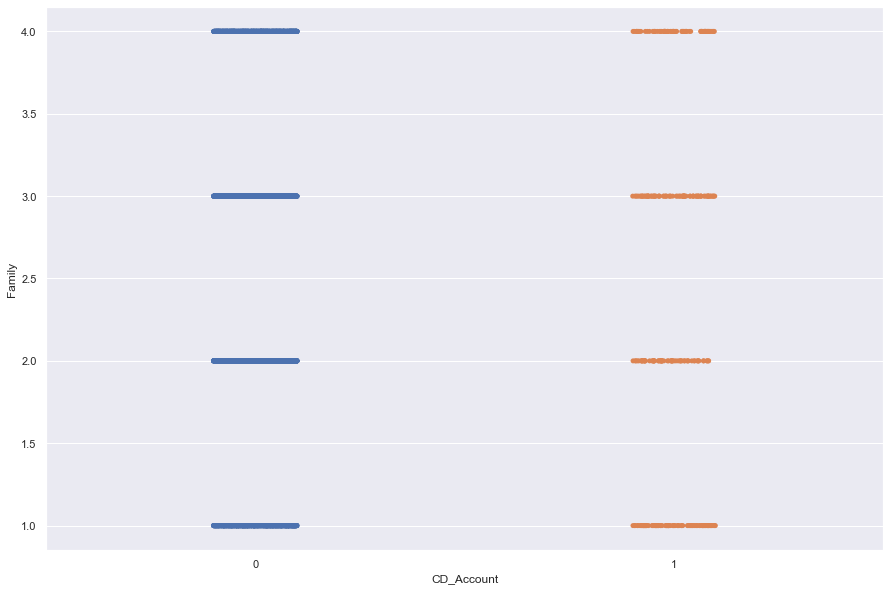

Family by Online Bar Plot


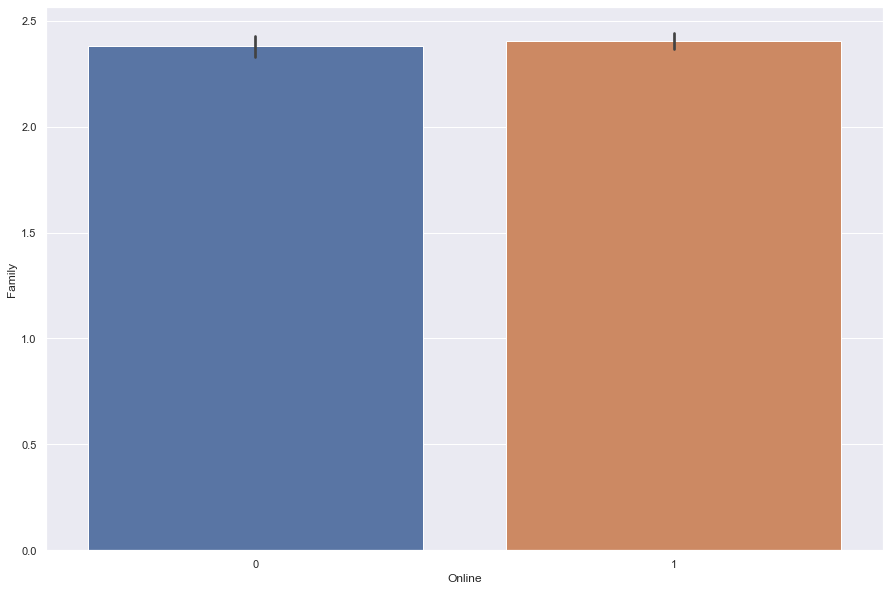

Family by Online Box Plot


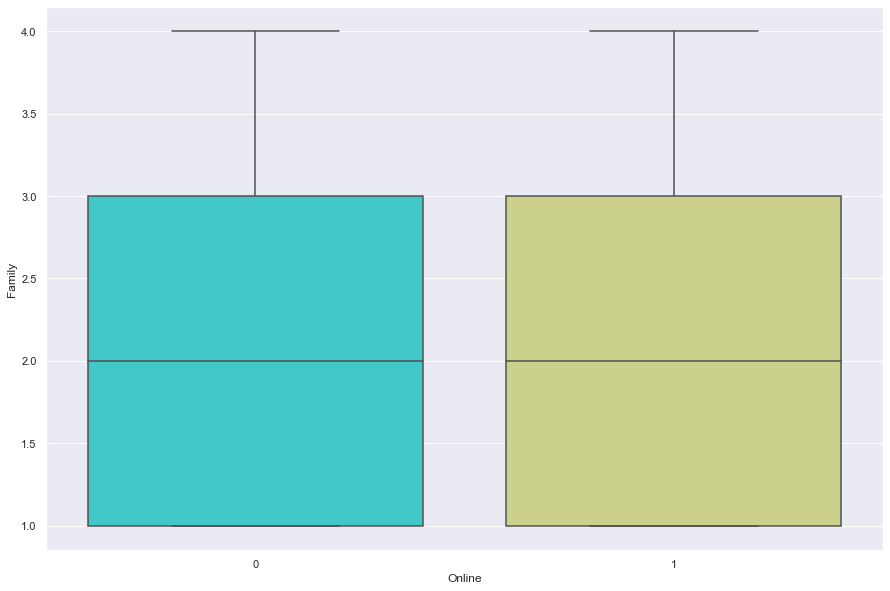

Family by Online Strip Plot


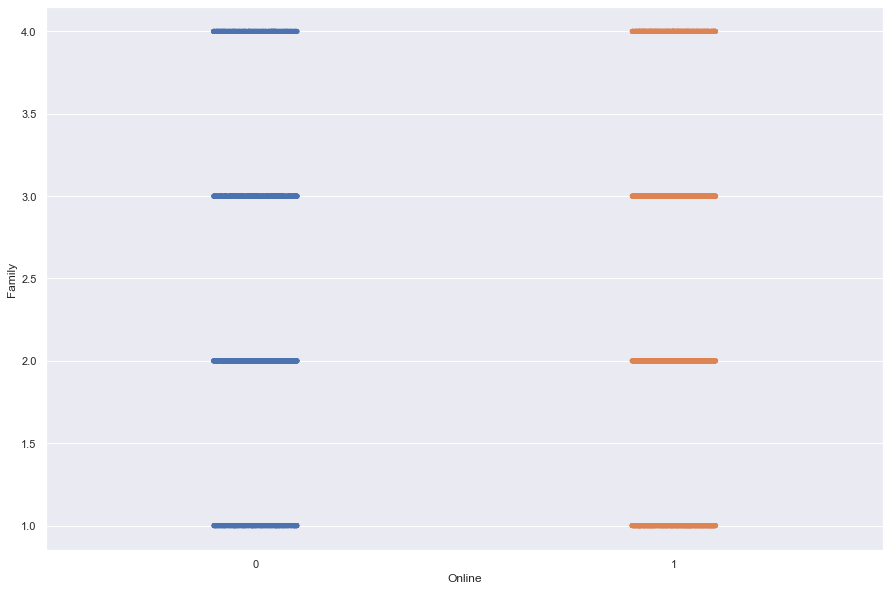

Family by CreditCard Bar Plot


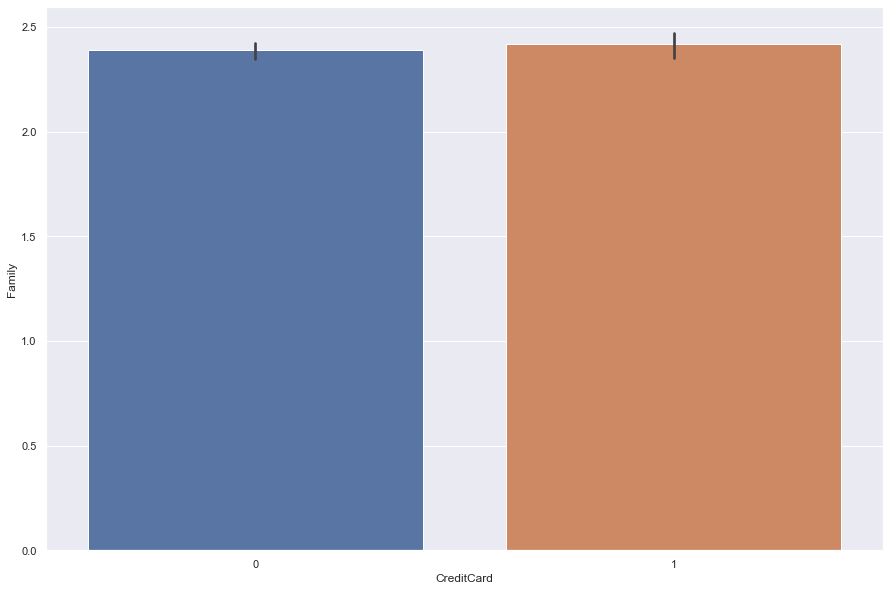

Family by CreditCard Box Plot


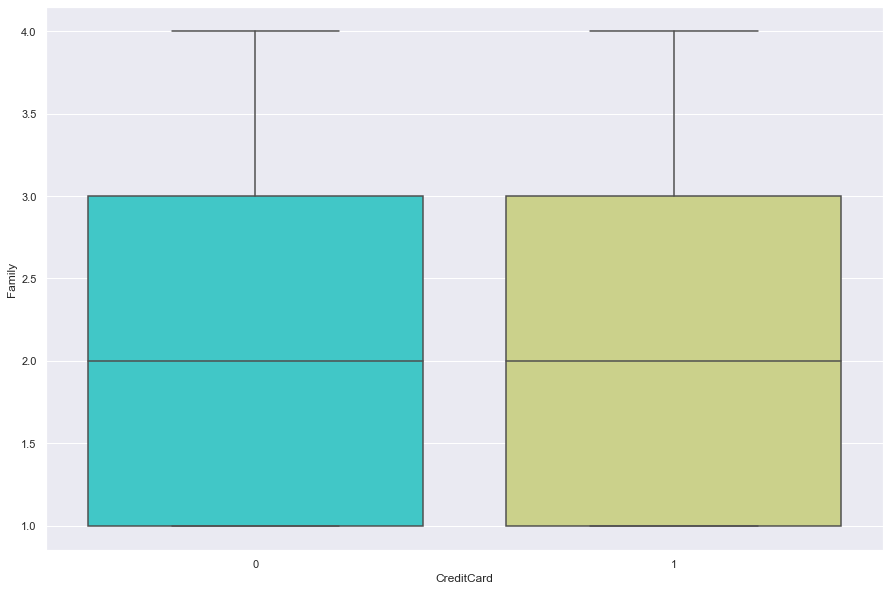

Family by CreditCard Strip Plot


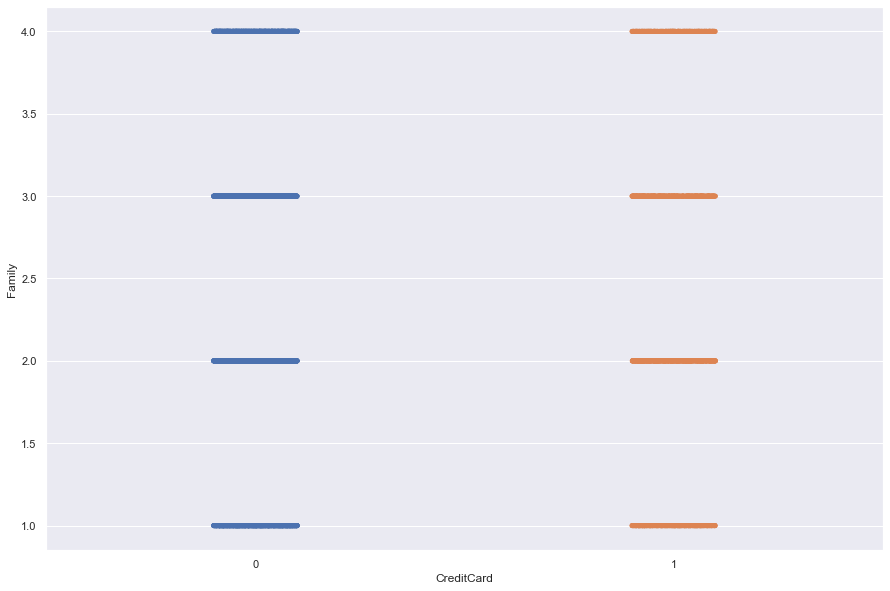

CCAvg by Securities_Account Bar Plot


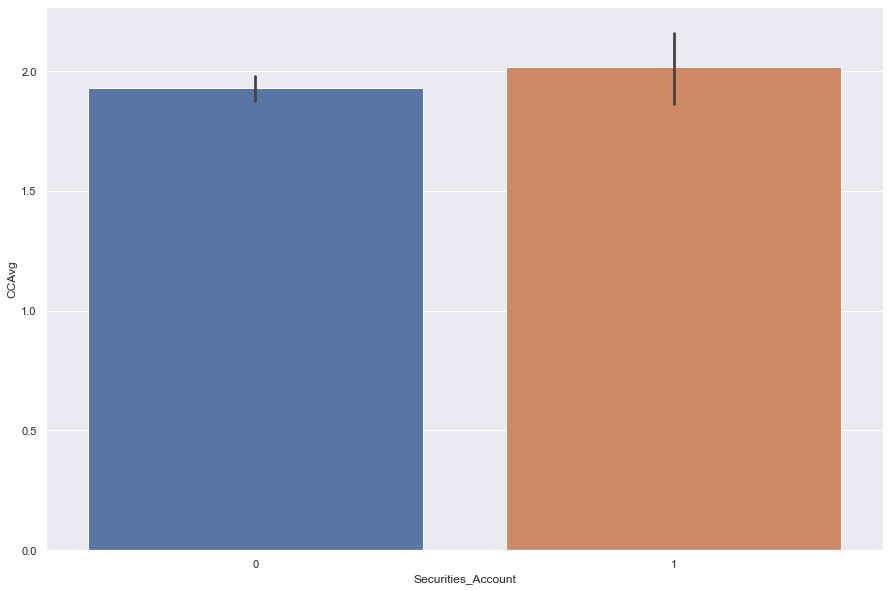

CCAvg by Securities_Account Box Plot


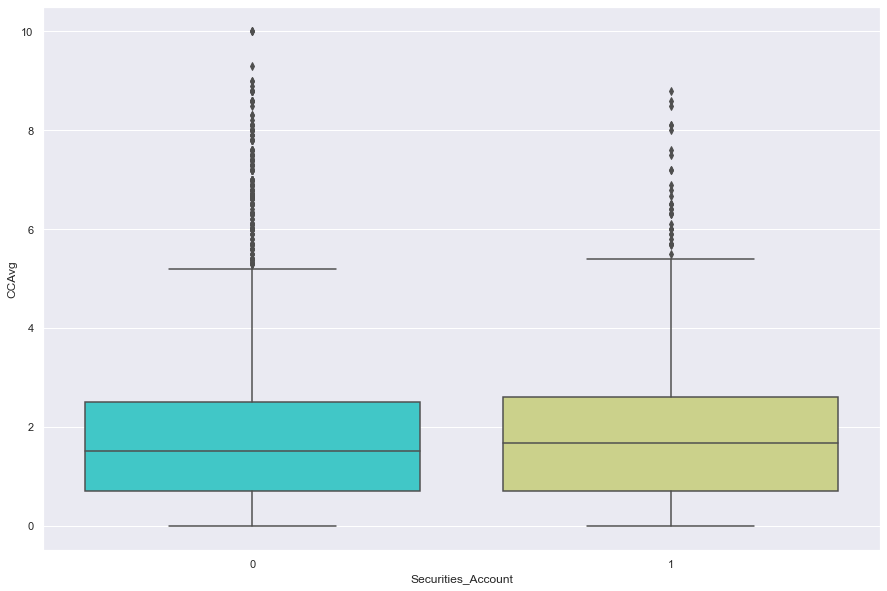

CCAvg by Securities_Account Strip Plot


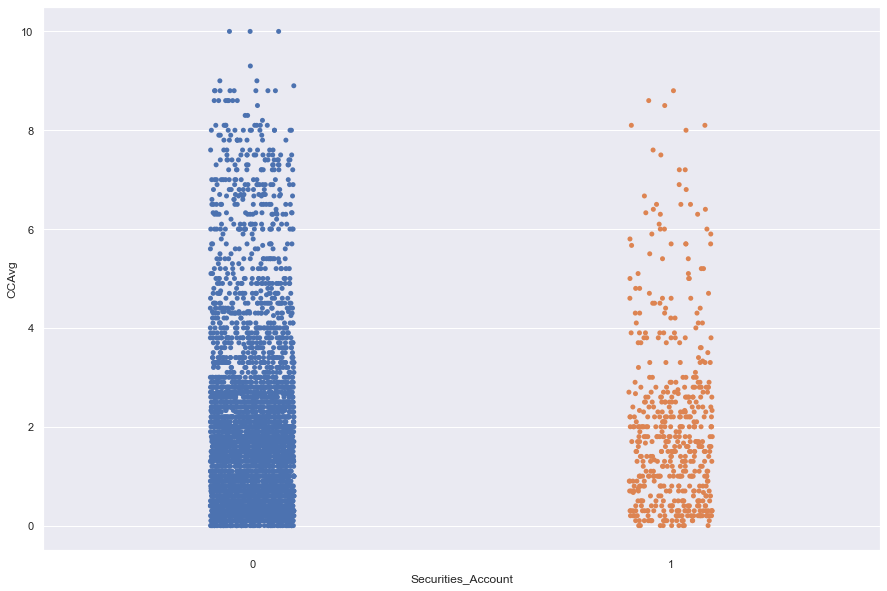

CCAvg by CD_Account Bar Plot


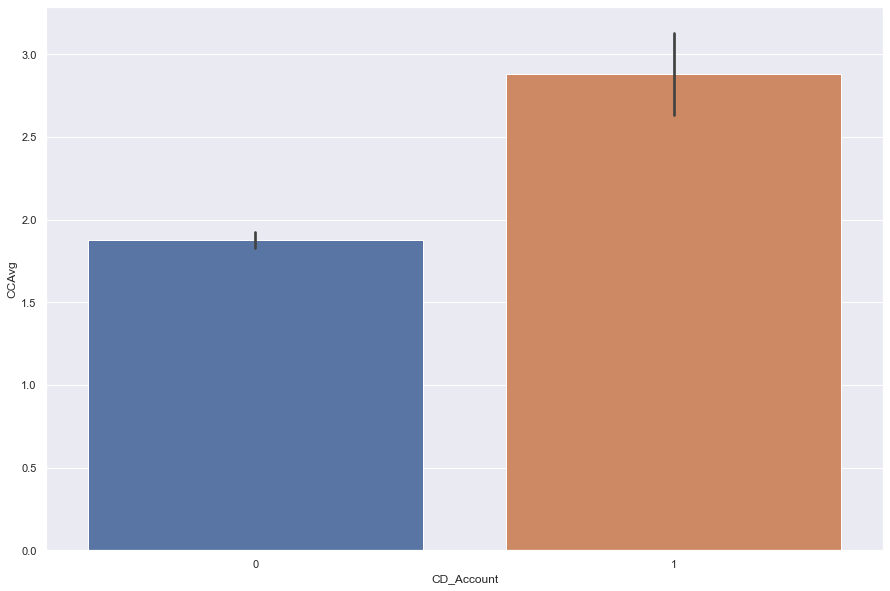

CCAvg by CD_Account Box Plot


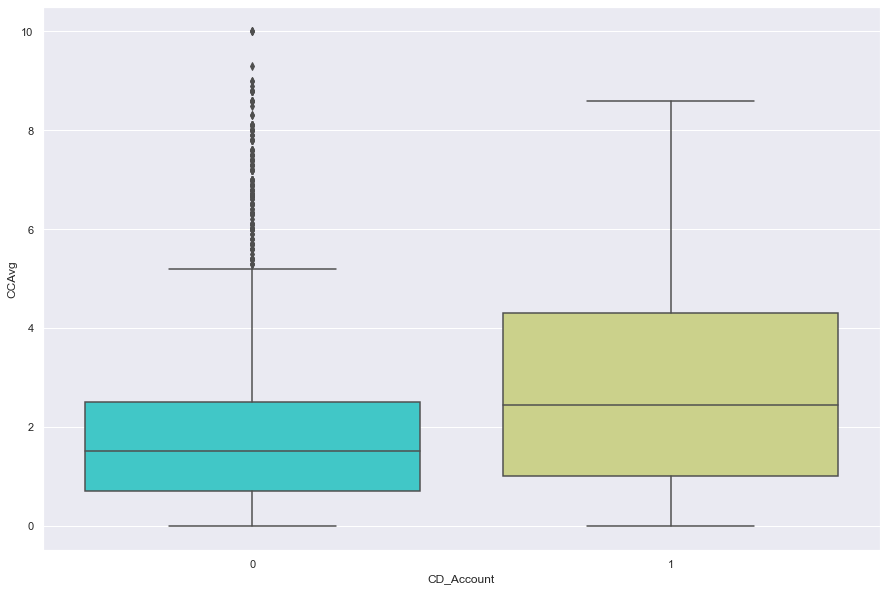

CCAvg by CD_Account Strip Plot


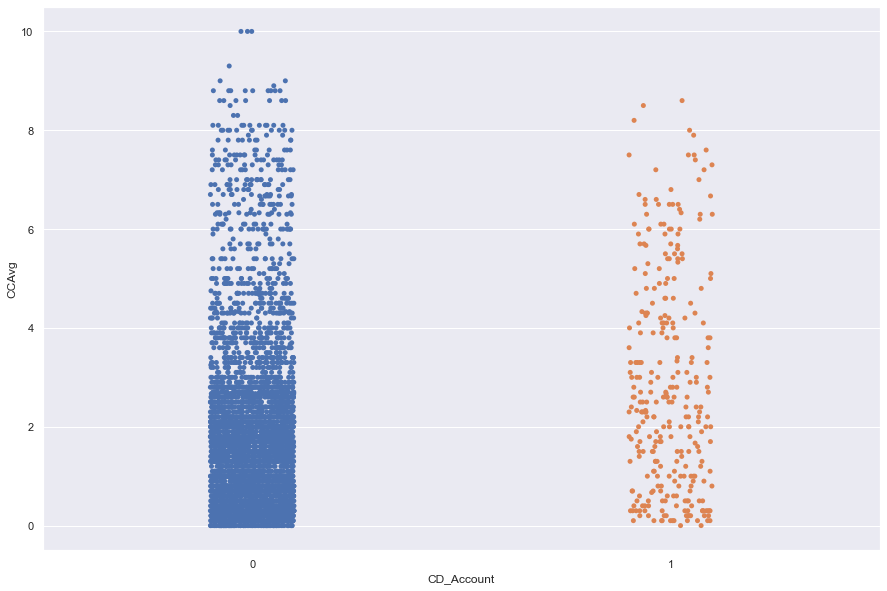

CCAvg by Online Bar Plot


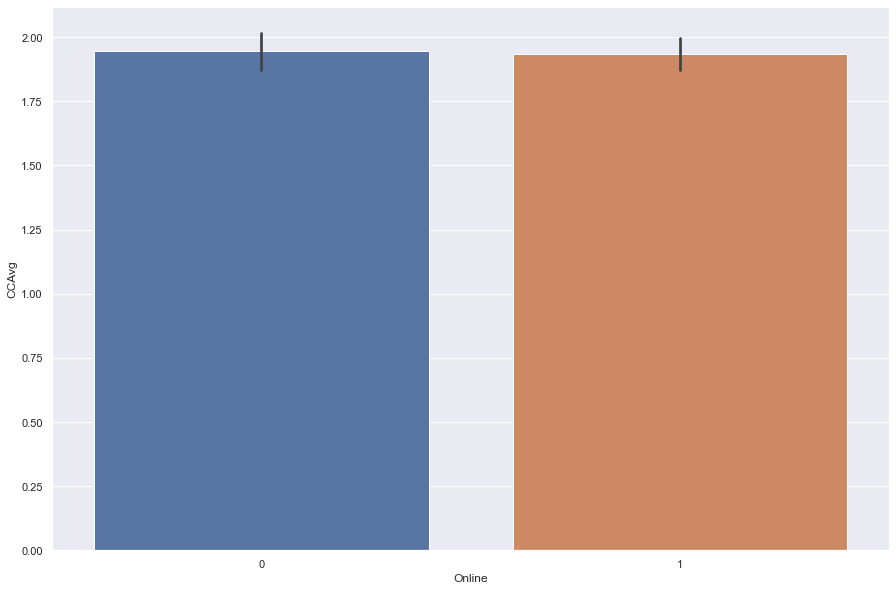

CCAvg by Online Box Plot


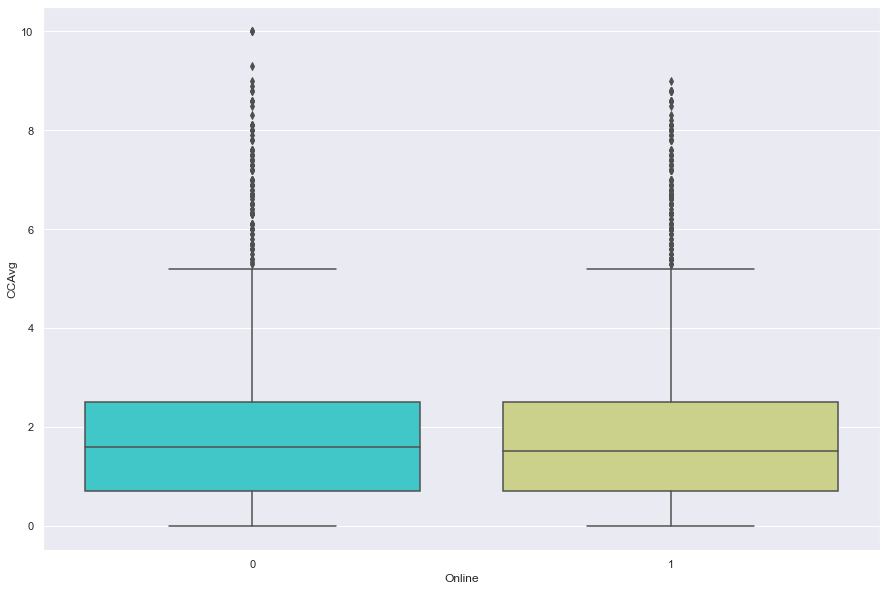

CCAvg by Online Strip Plot


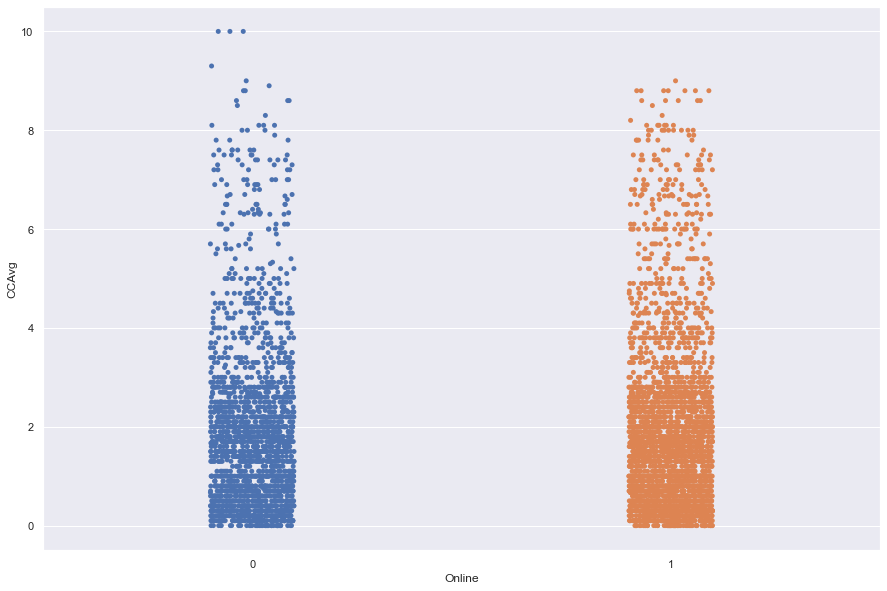

CCAvg by CreditCard Bar Plot


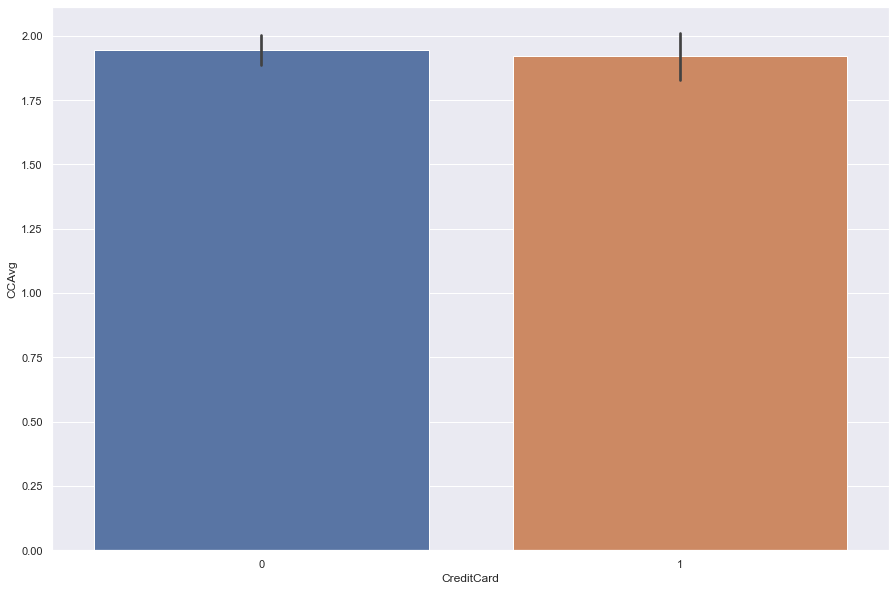

CCAvg by CreditCard Box Plot


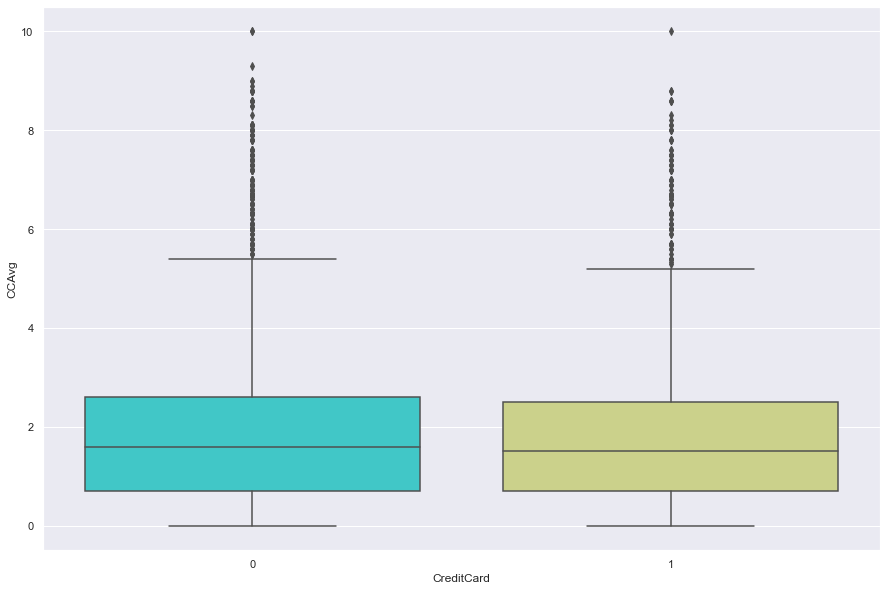

CCAvg by CreditCard Strip Plot


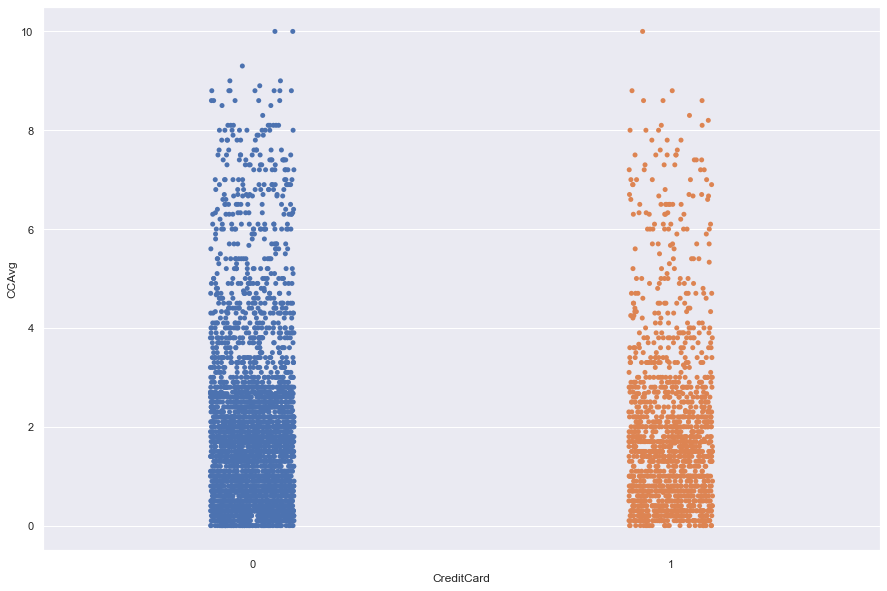

Education by Securities_Account Bar Plot


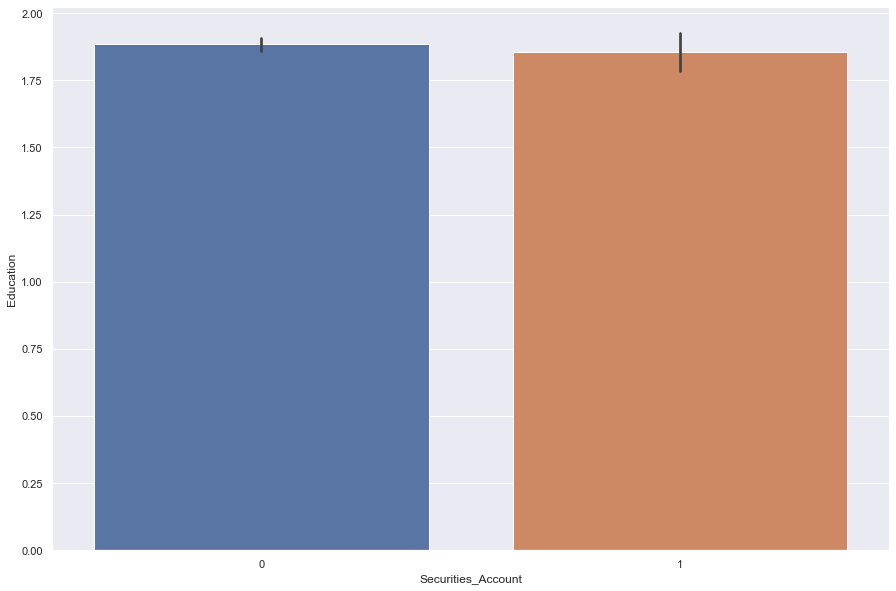

Education by Securities_Account Box Plot


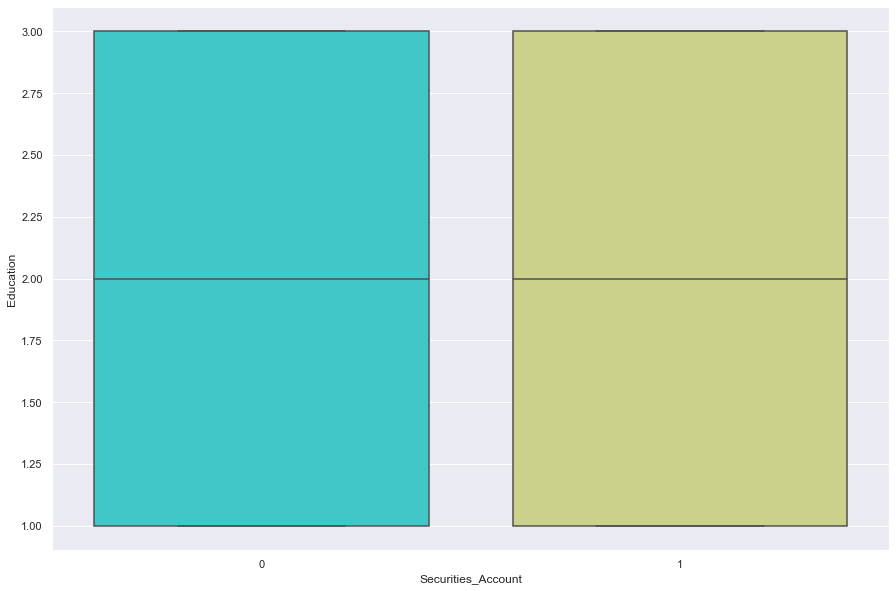

Education by Securities_Account Strip Plot


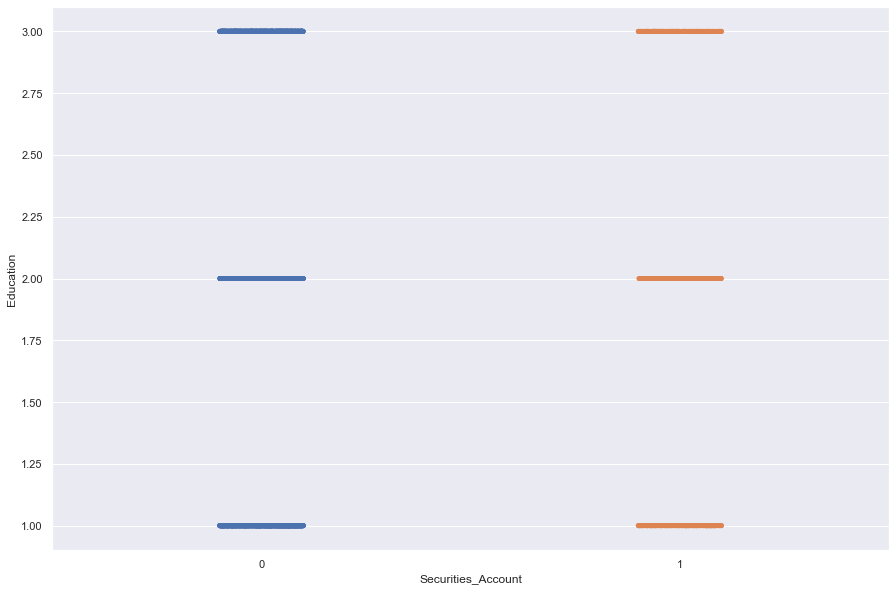

Education by CD_Account Bar Plot


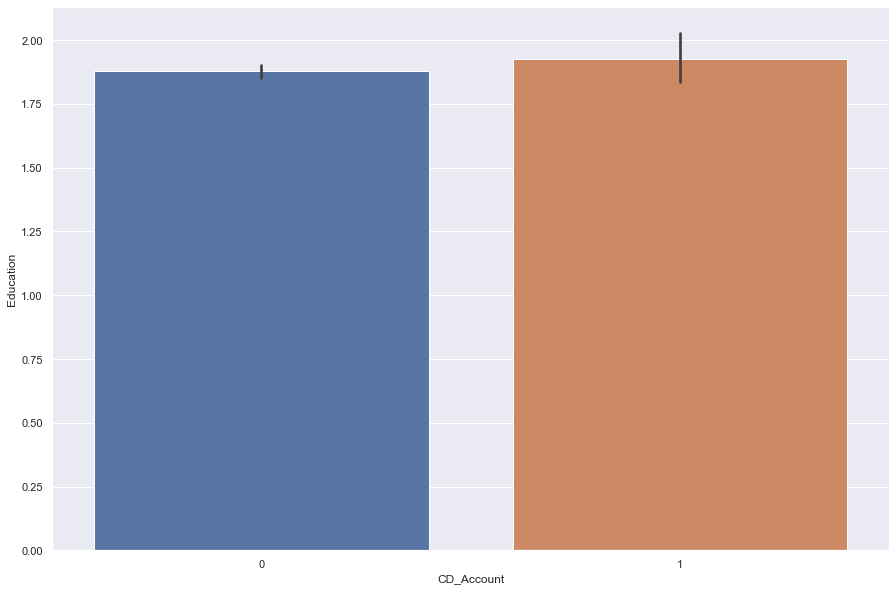

Education by CD_Account Box Plot


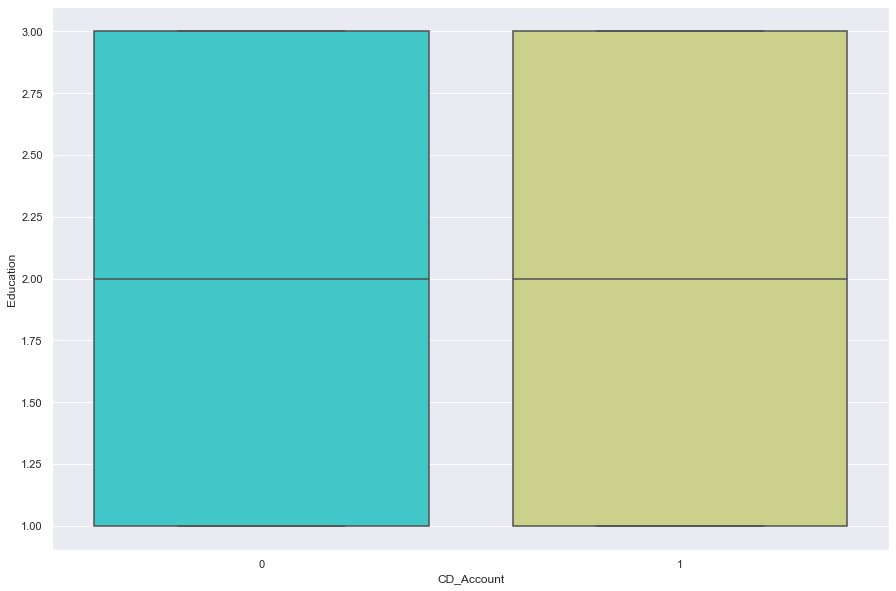

Education by CD_Account Strip Plot


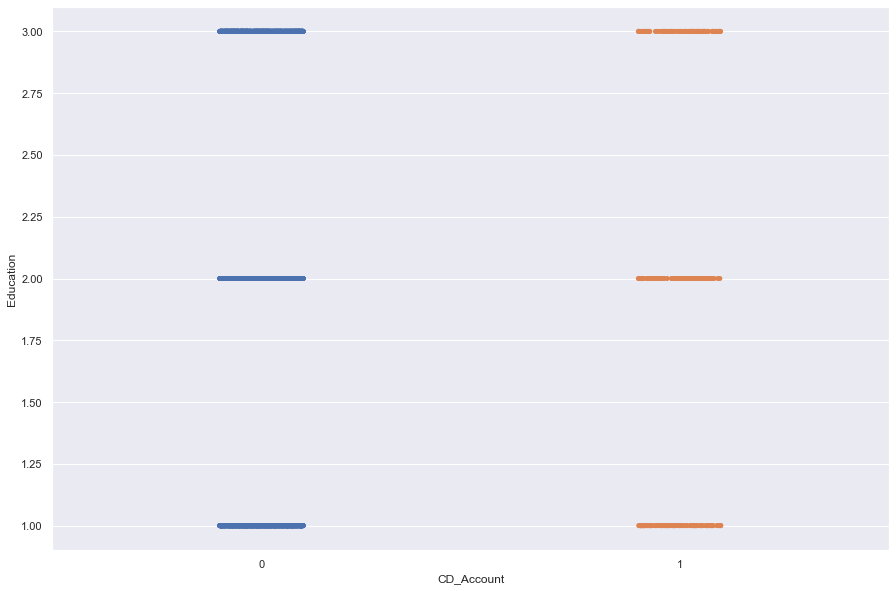

Education by Online Bar Plot


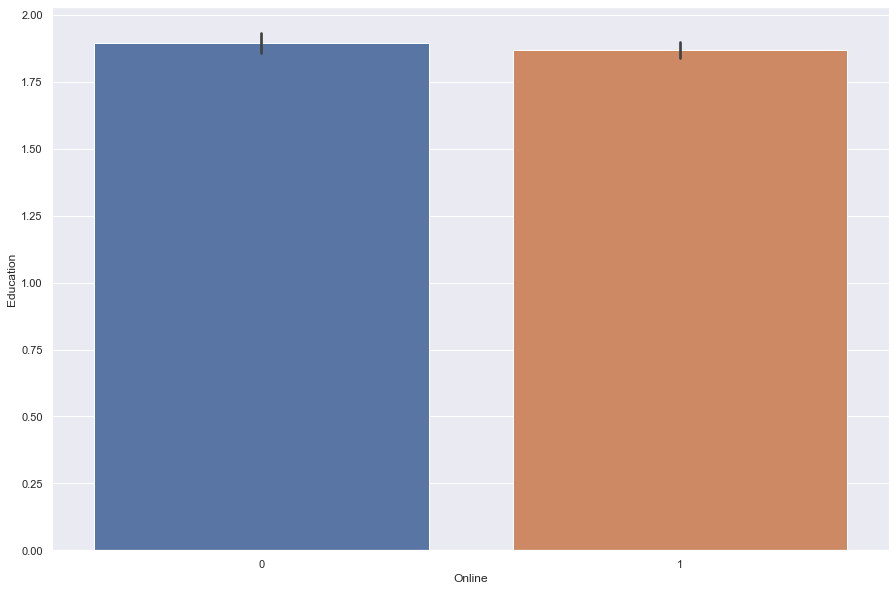

Education by Online Box Plot


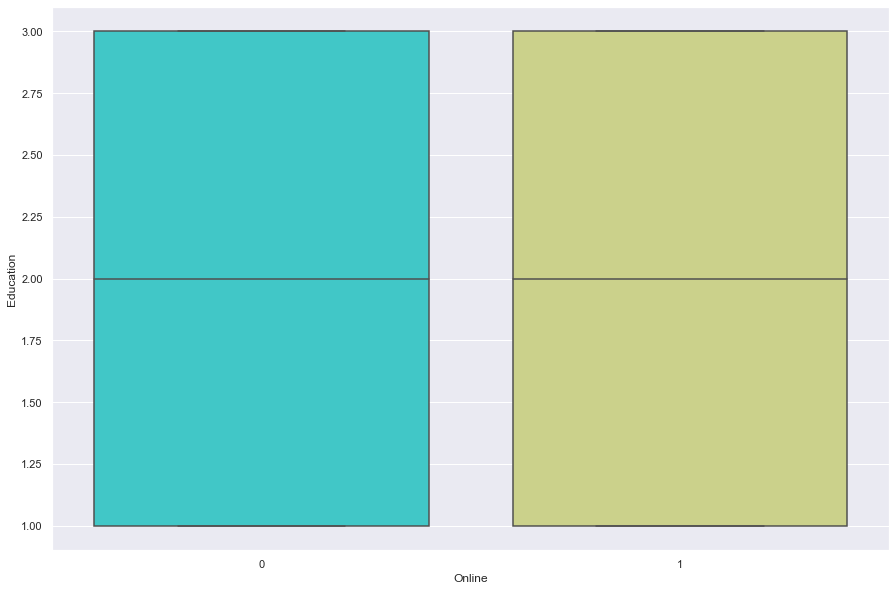

Education by Online Strip Plot


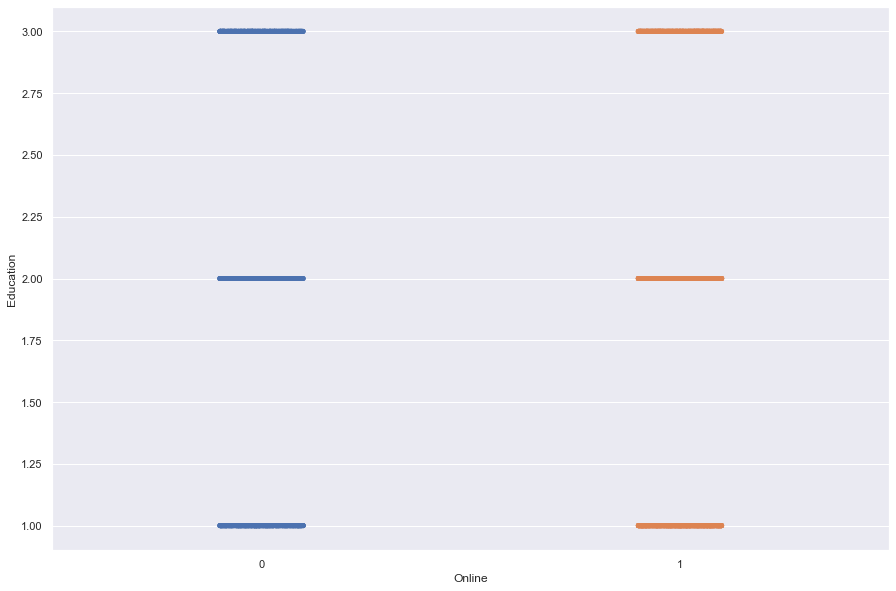

Education by CreditCard Bar Plot


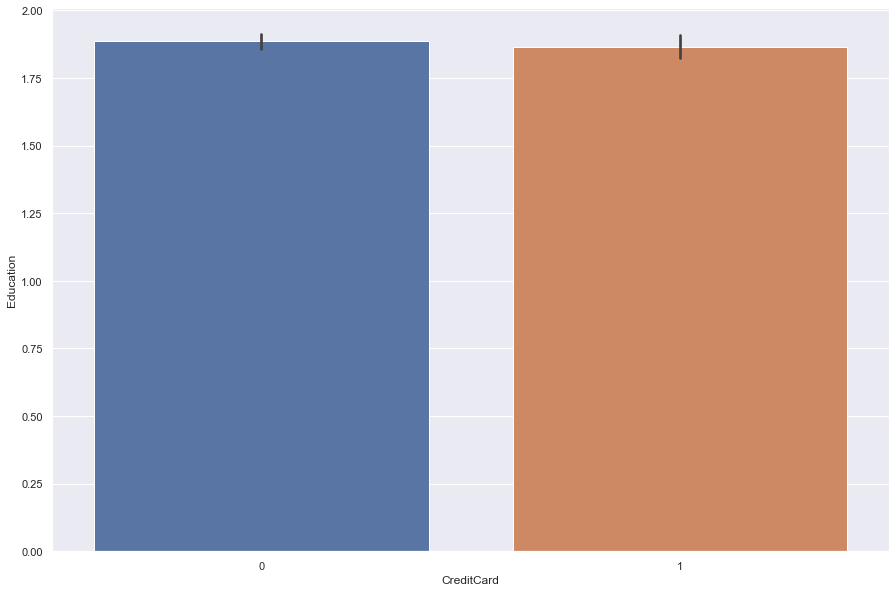

Education by CreditCard Box Plot


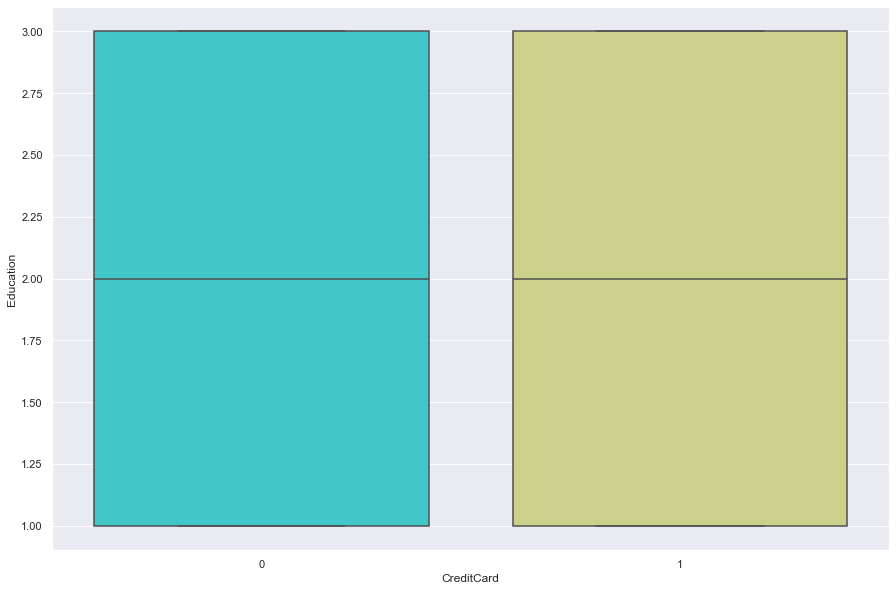

Education by CreditCard Strip Plot


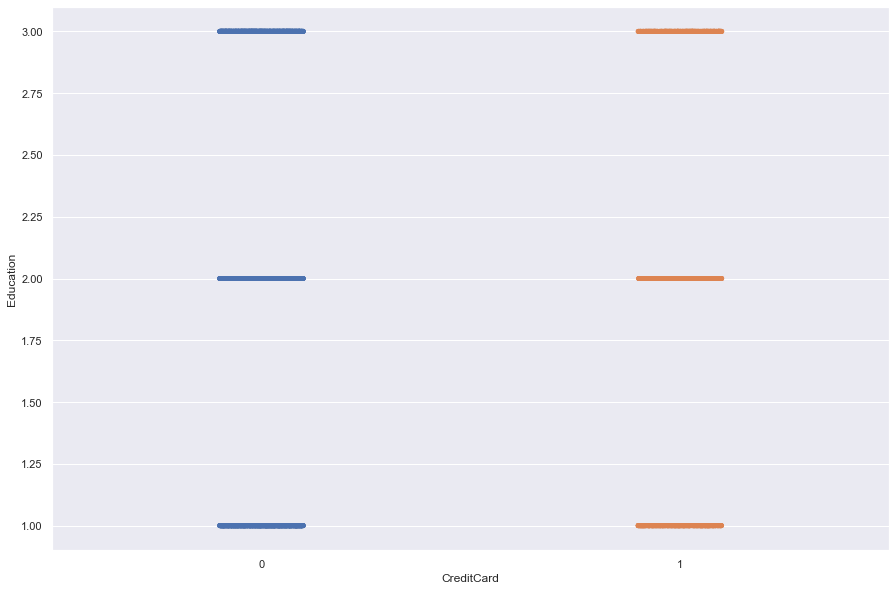

Mortgage by Securities_Account Bar Plot


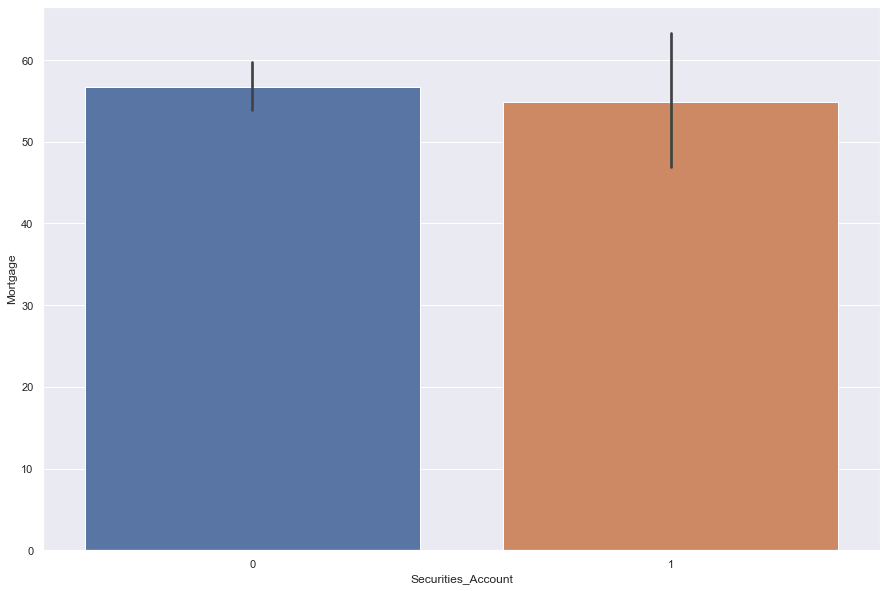

Mortgage by Securities_Account Box Plot


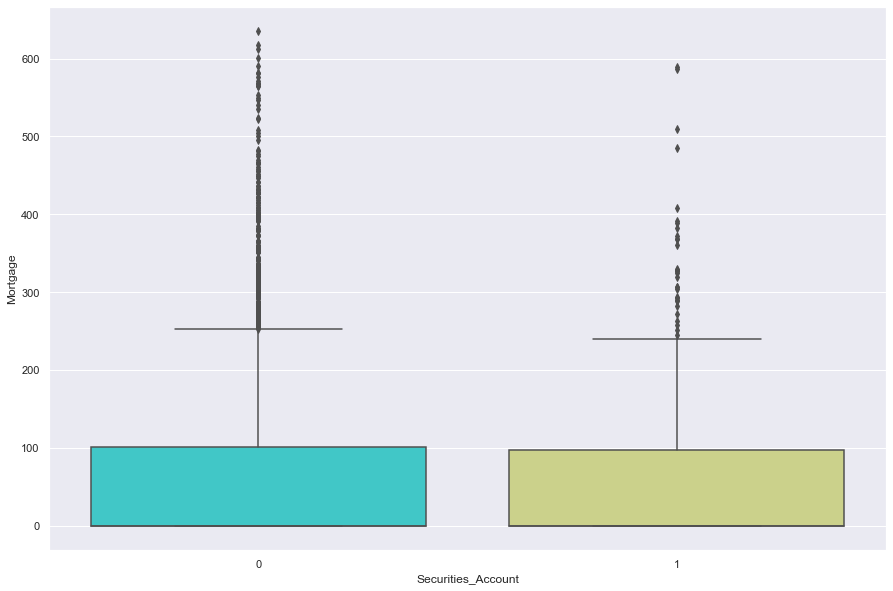

Mortgage by Securities_Account Strip Plot


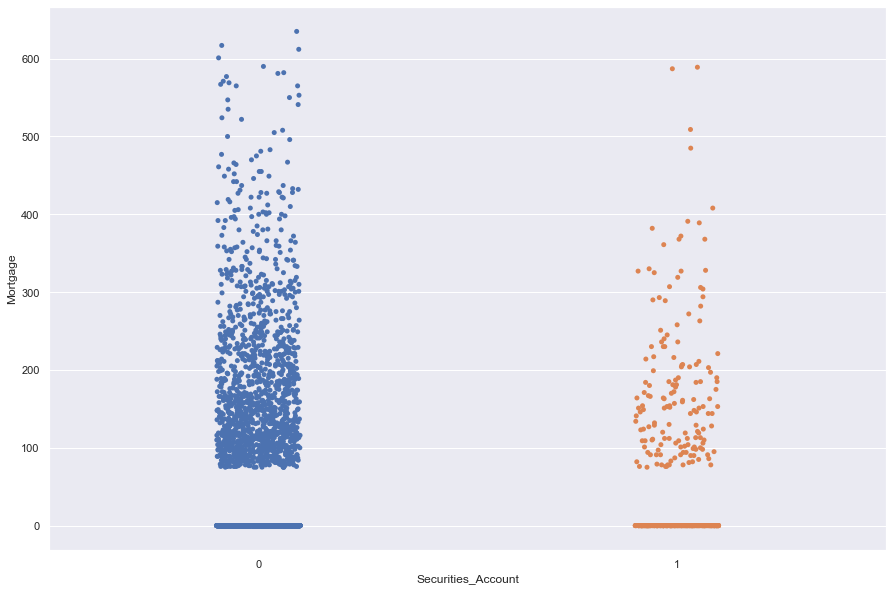

Mortgage by CD_Account Bar Plot


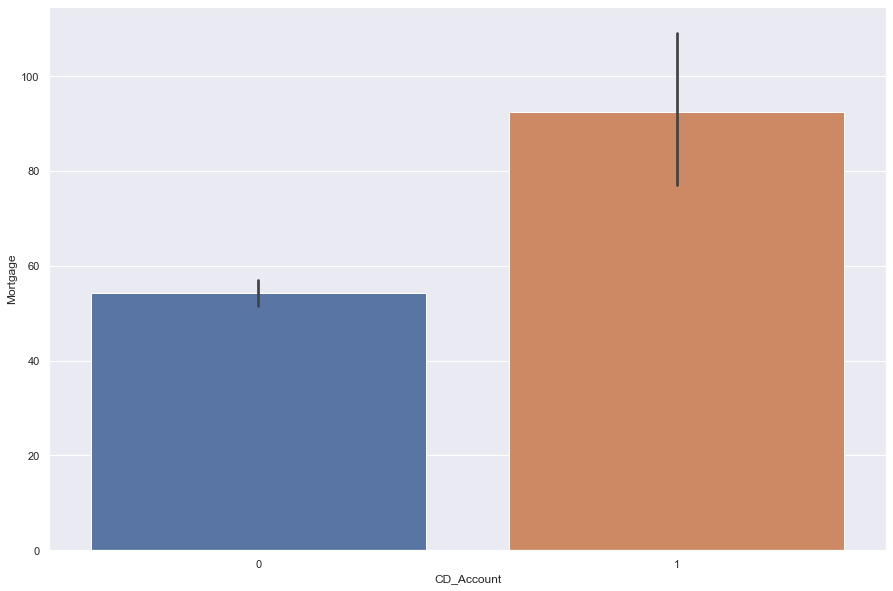

Mortgage by CD_Account Box Plot


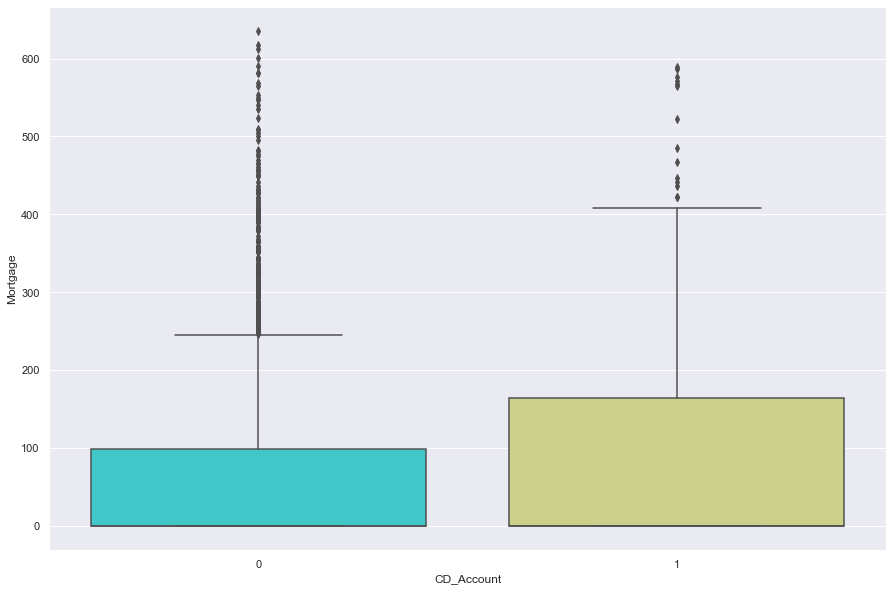

Mortgage by CD_Account Strip Plot


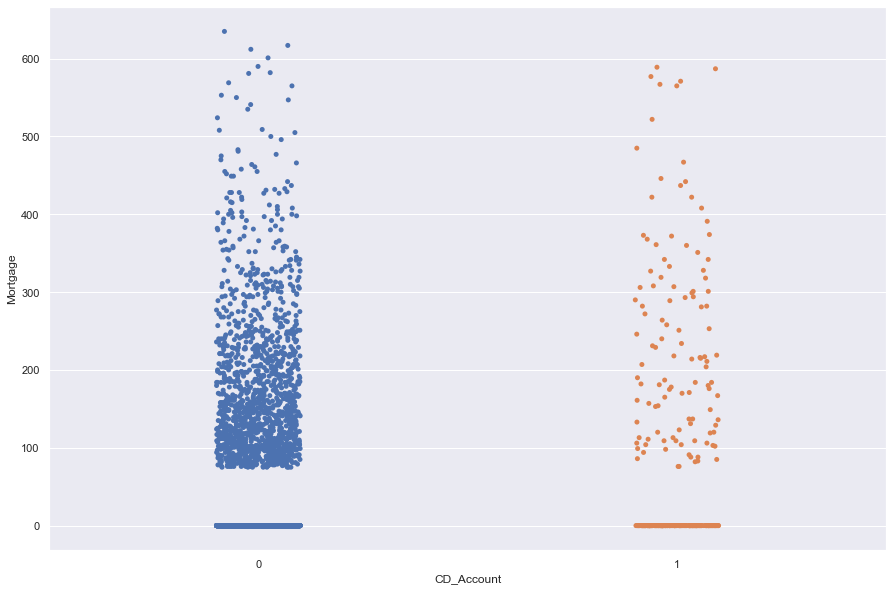

Mortgage by Online Bar Plot


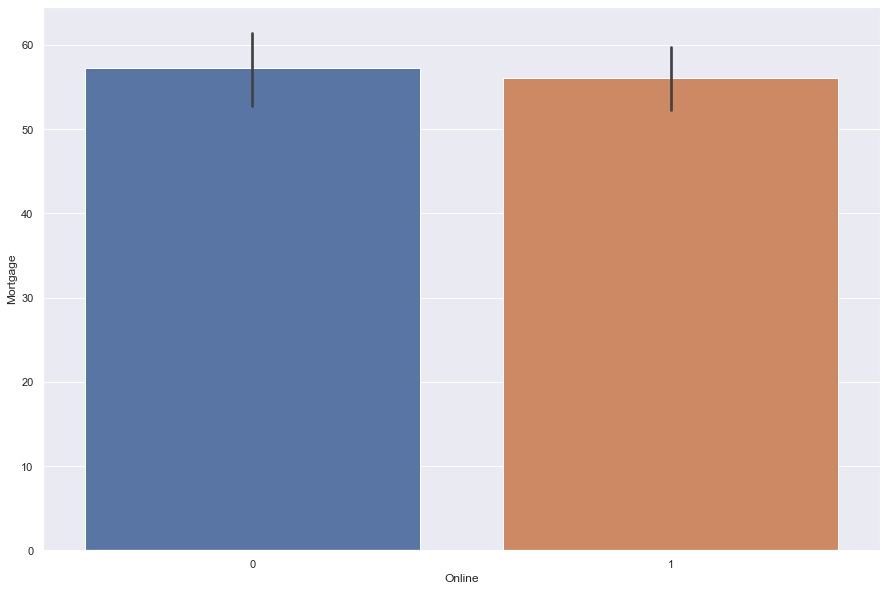

Mortgage by Online Box Plot


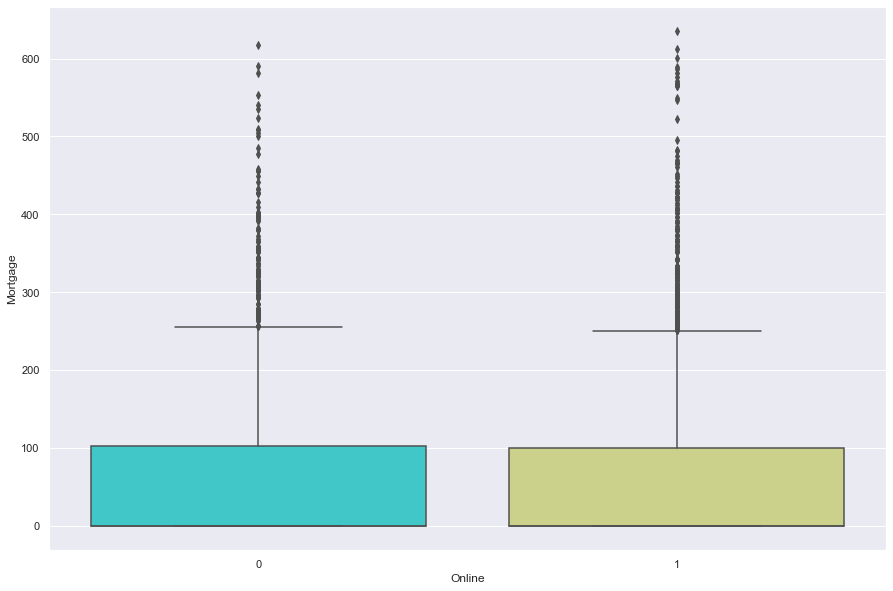

Mortgage by Online Strip Plot


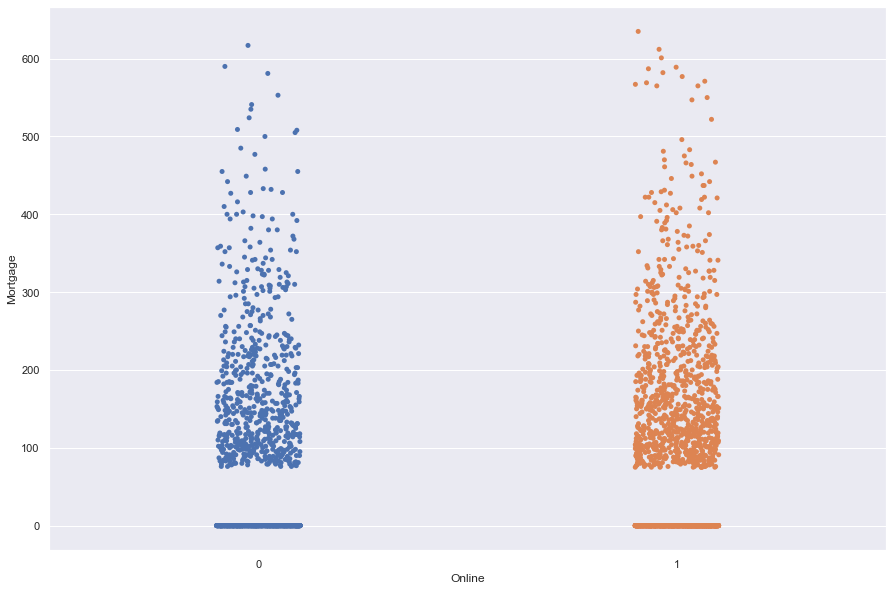

Mortgage by CreditCard Bar Plot


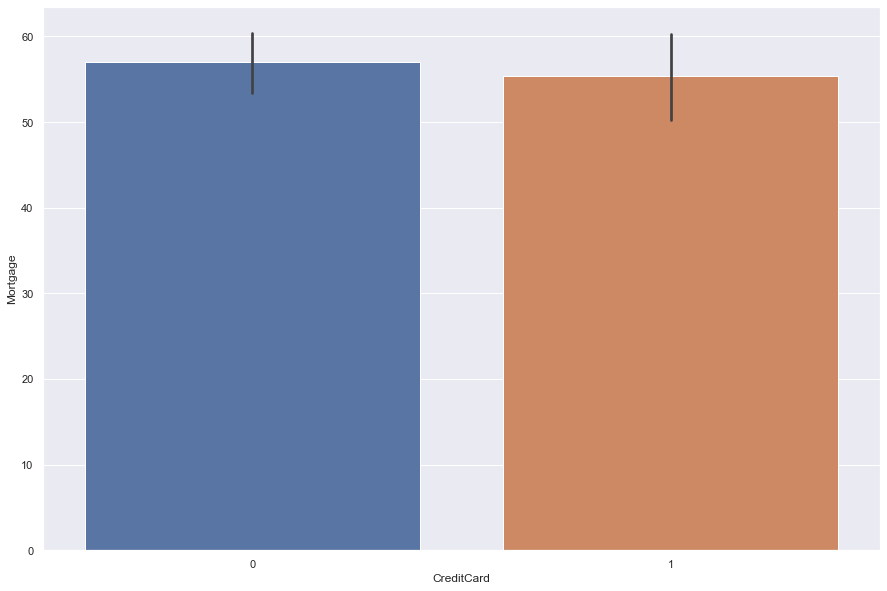

Mortgage by CreditCard Box Plot


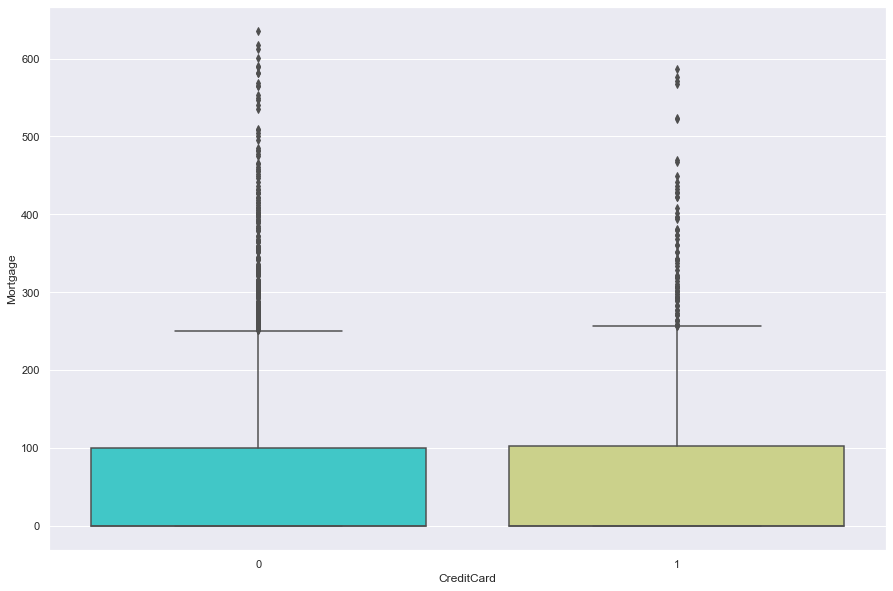

Mortgage by CreditCard Strip Plot


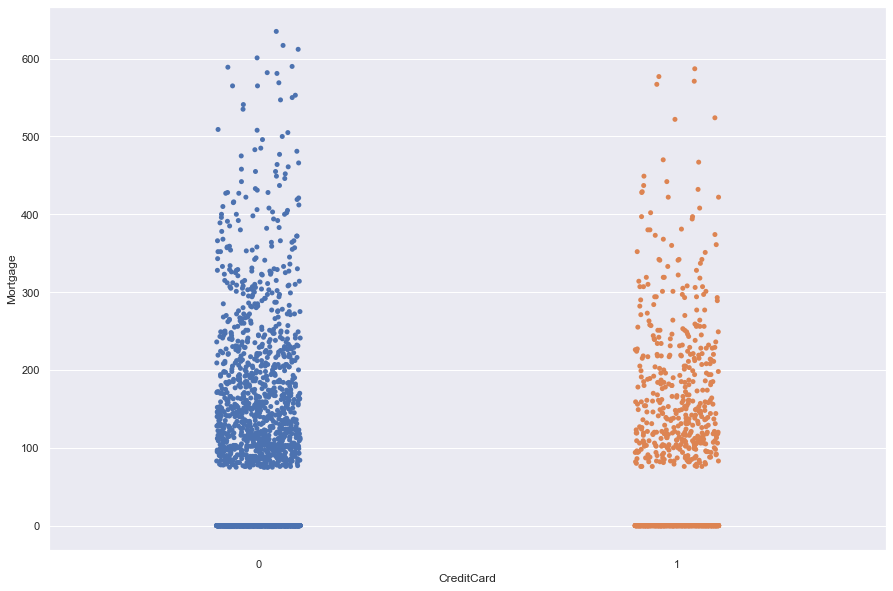

Personal_Loan by Securities_Account Bar Plot


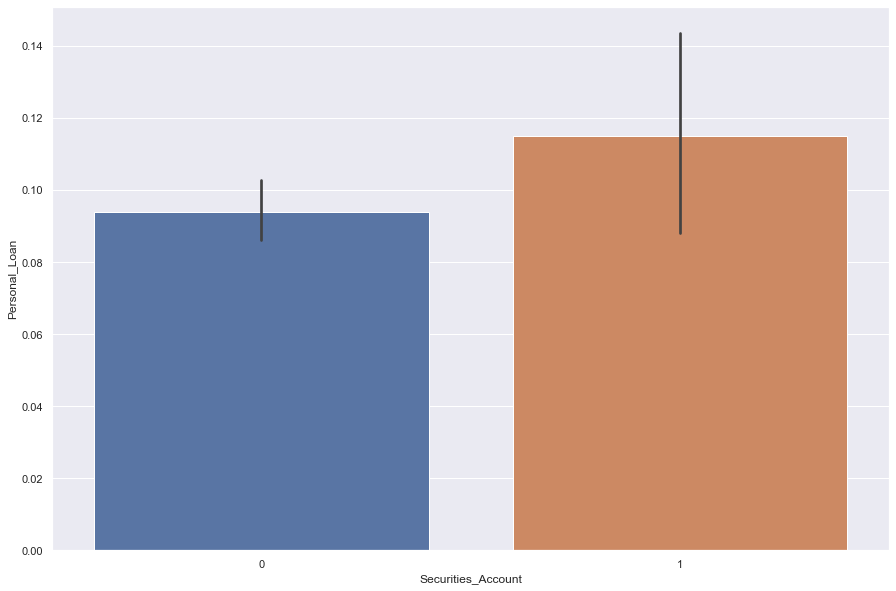

Personal_Loan by Securities_Account Box Plot


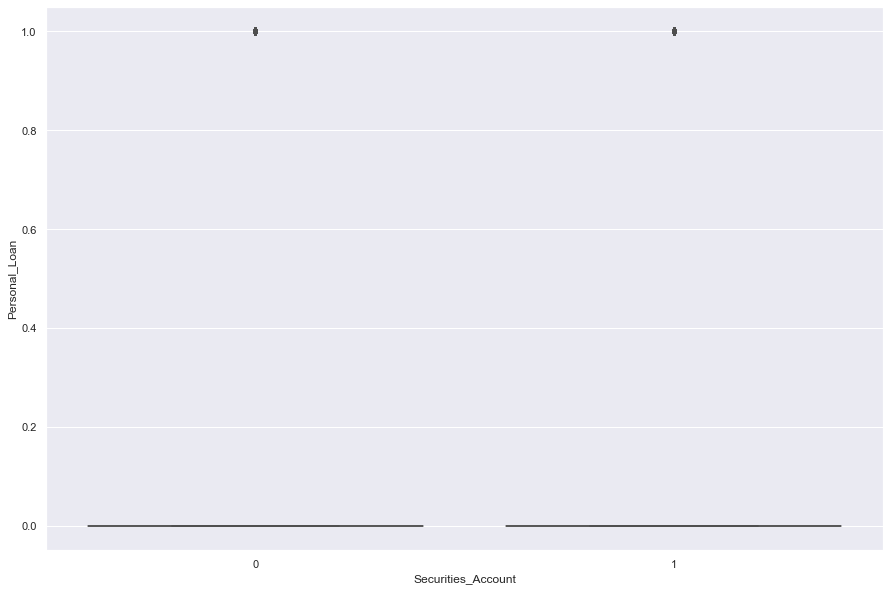

Personal_Loan by Securities_Account Strip Plot


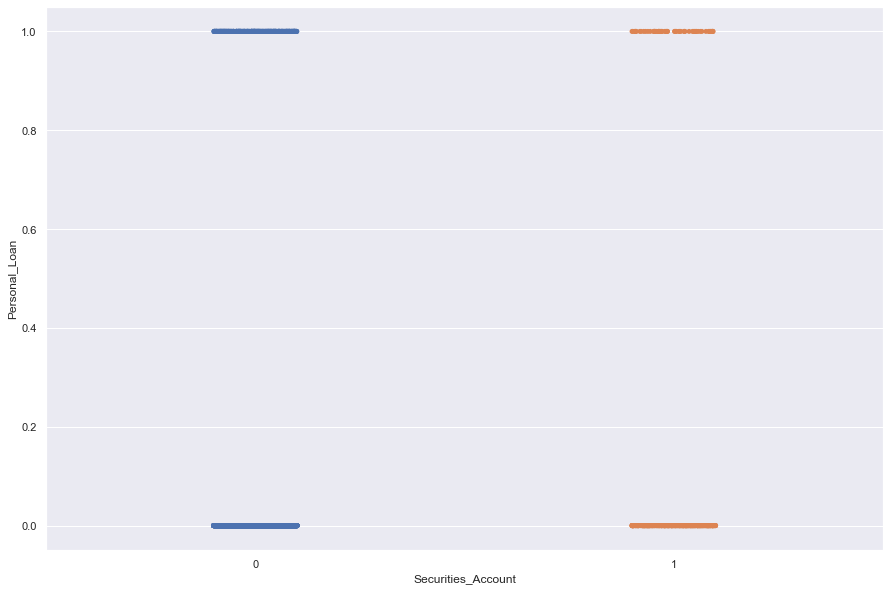

Personal_Loan by CD_Account Bar Plot


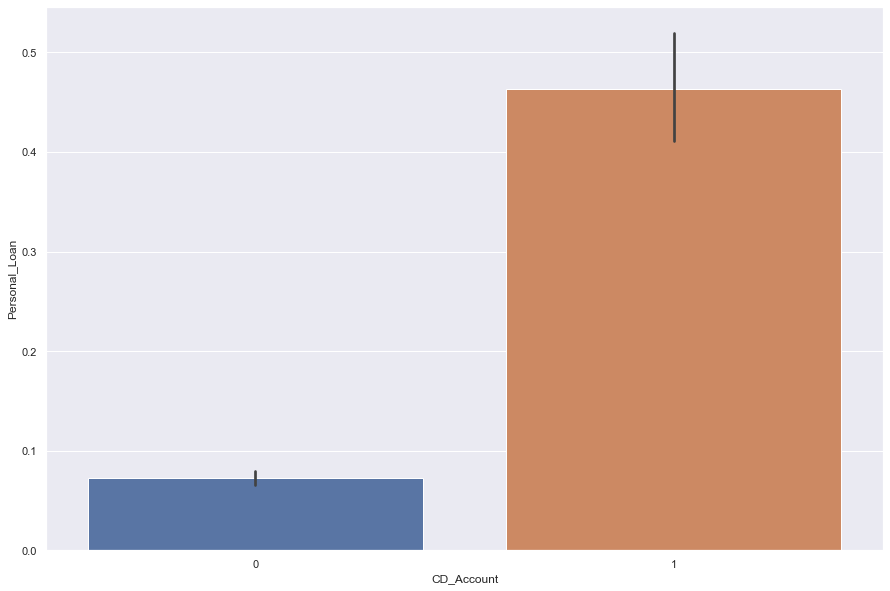

Personal_Loan by CD_Account Box Plot


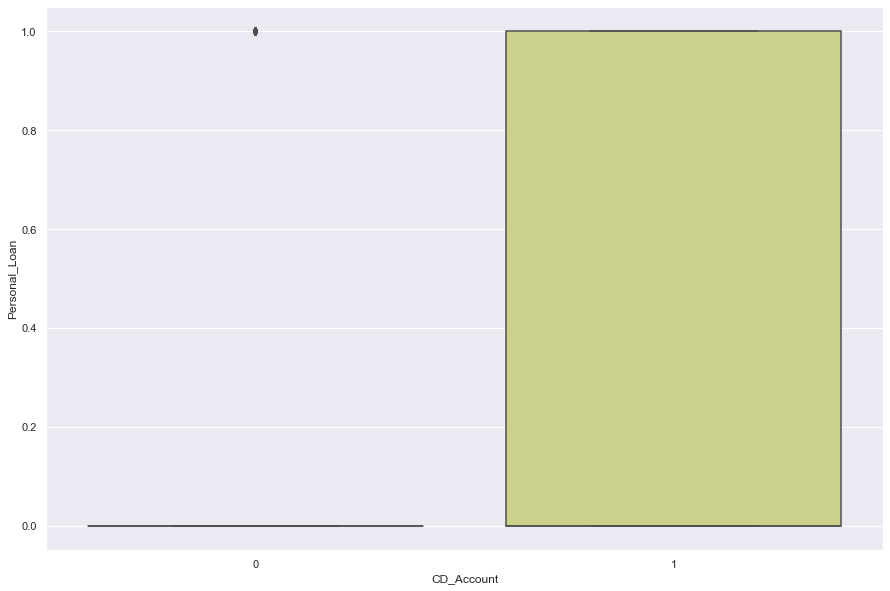

Personal_Loan by CD_Account Strip Plot


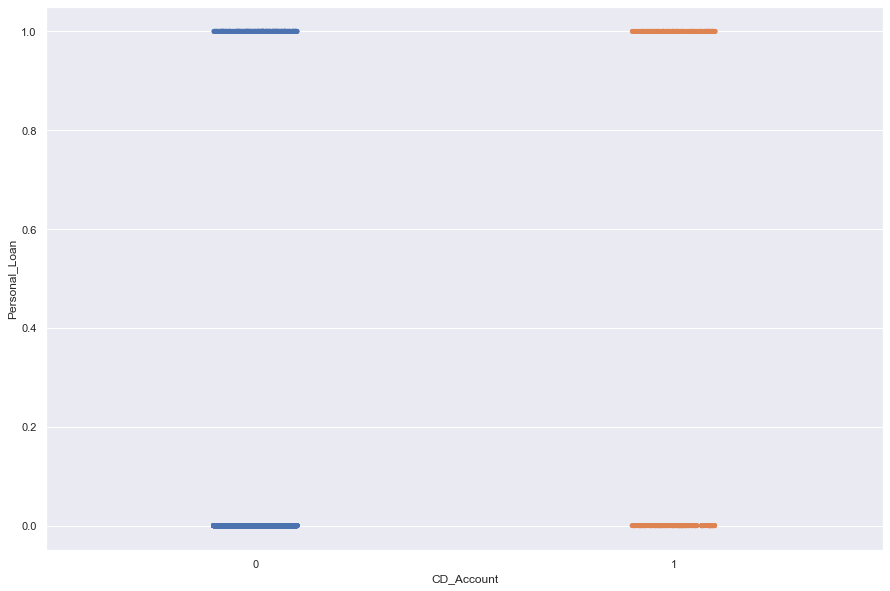

Personal_Loan by Online Bar Plot


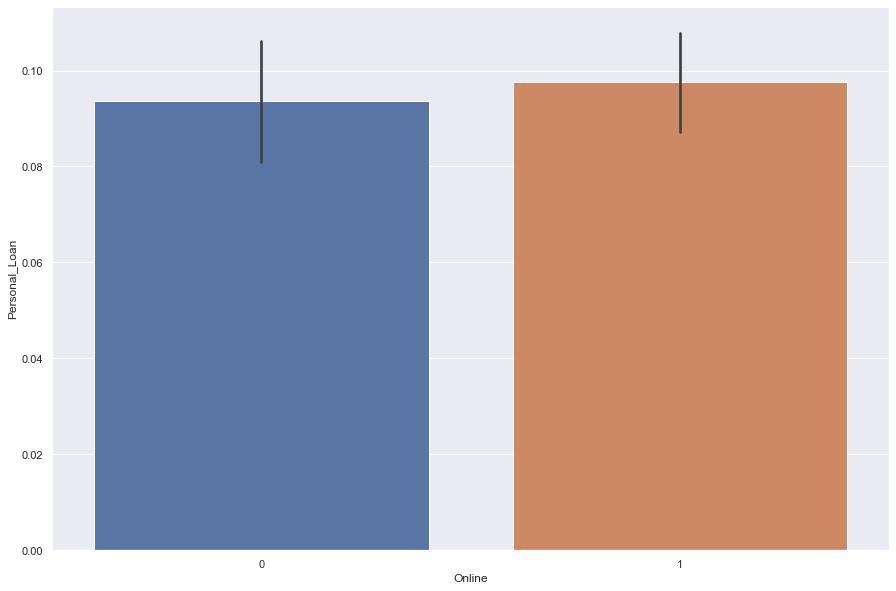

Personal_Loan by Online Box Plot


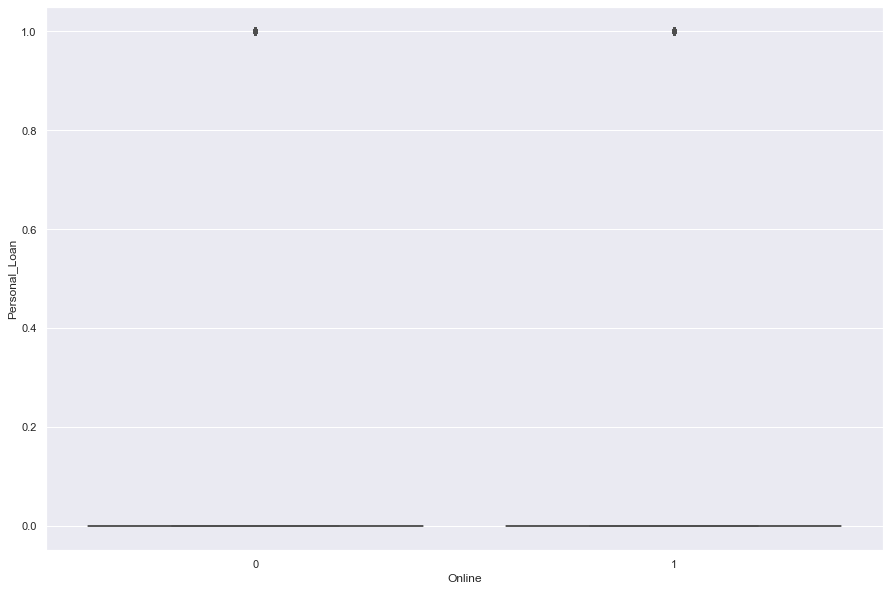

Personal_Loan by Online Strip Plot


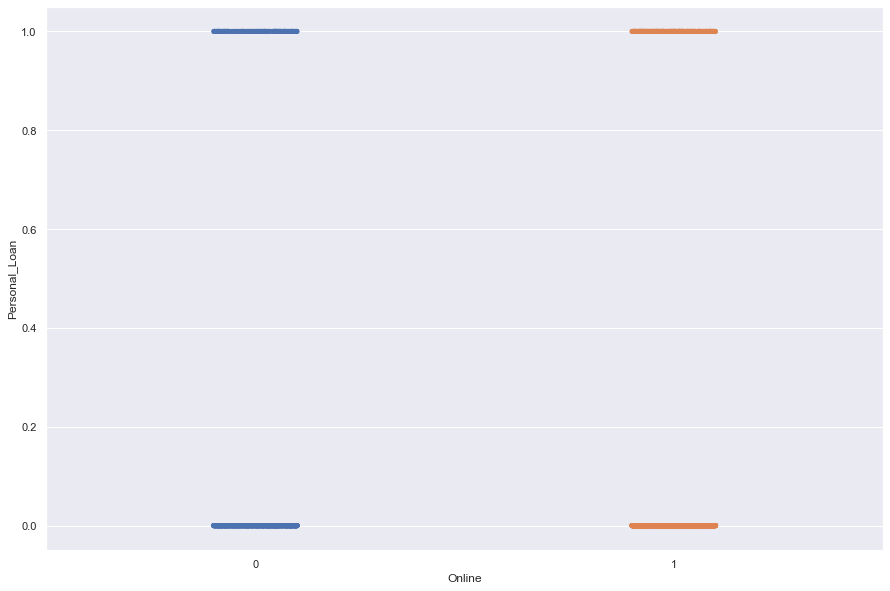

Personal_Loan by CreditCard Bar Plot


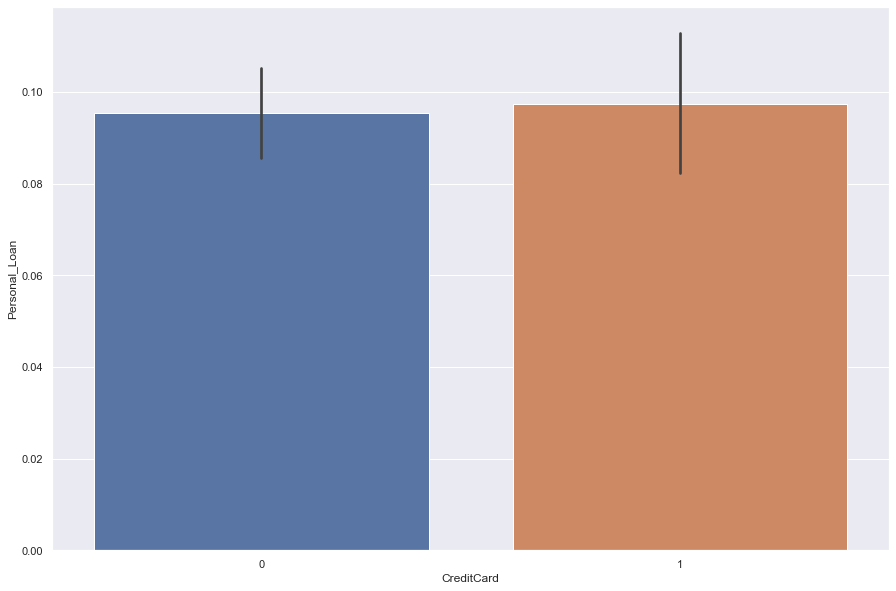

Personal_Loan by CreditCard Box Plot


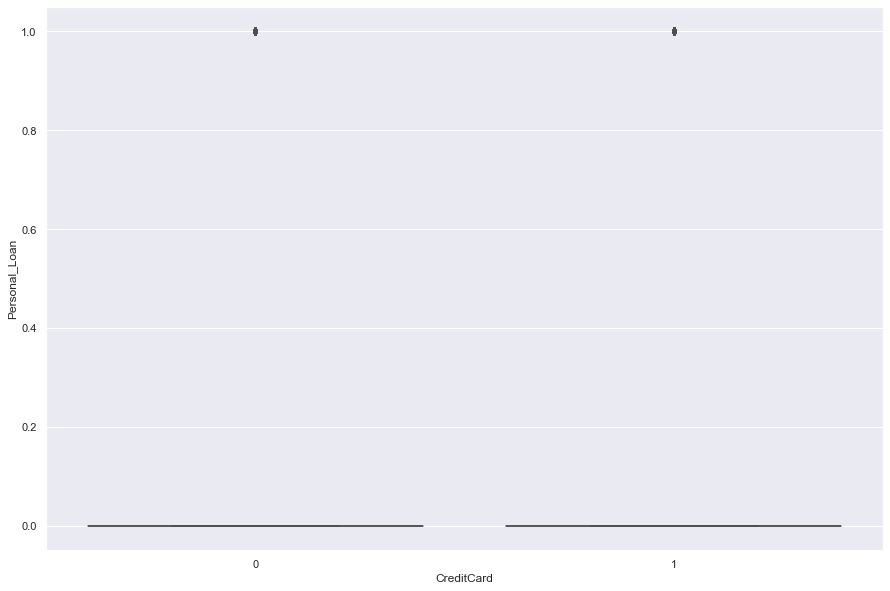

Personal_Loan by CreditCard Strip Plot


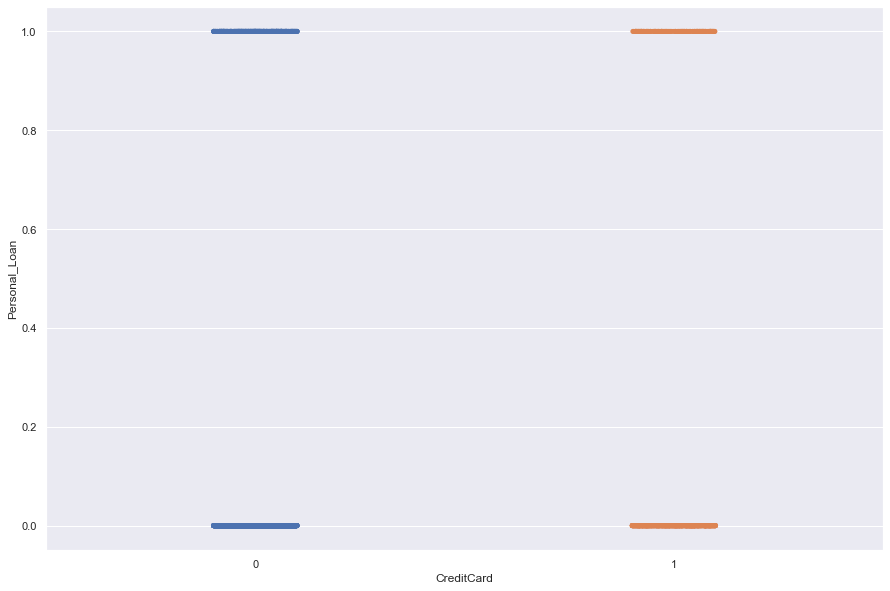

<IPython.core.display.Javascript object>

In [47]:
# Bivariate visualization of categorical against numerical variables
cats = df.loc[:, "Securities_Account":"CreditCard"]

num = df.loc[:, "Age":"Personal_Loan":1]

for a in num:  # for every categorical column

    for b in cats:  # pair it with a numeric variable

        # Bar plot against a numeric variable
        print(a, "by", b, "Bar Plot")
        plt.figure(figsize=(15, 10))
        sns.barplot(x=df[b], y=df[a])
        plt.show()

        # Box plot against a numeric variable
        print(a, "by", b, "Box Plot")
        plt.figure(figsize=(15, 10))
        sns.boxplot(data=df, x=df[b], y=df[a], palette="rainbow")
        plt.show()

        # Scatter plot against a numeric variable
        print(a, "by", b, "Strip Plot")
        plt.figure(figsize=(15, 10))
        sns.stripplot(x=df[b], y=df[a])
        plt.show()

#### Numerics

In [48]:
df.head()

,Age,Experience,Income,ZIPCode,Family,CCAvg,Education,Mortgage,Personal_Loan,Securities_Account,CD_Account,Online,CreditCard
0,25,1,49,91107,4,1.60,1,0,0,1,0,0,0
1,45,19,34,90089,3,1.50,1,0,0,1,0,0,0
2,39,15,11,94720,1,1.00,1,0,0,0,0,0,0
3,35,9,100,94112,1,2.70,2,0,0,0,0,0,0
4,35,8,45,91330,4,1.00,2,0,0,0,0,0,1


<IPython.core.display.Javascript object>

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Age by Education Strip Plot


<Figure size 1080x720 with 0 Axes>

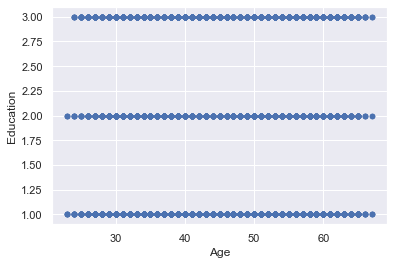

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Age by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

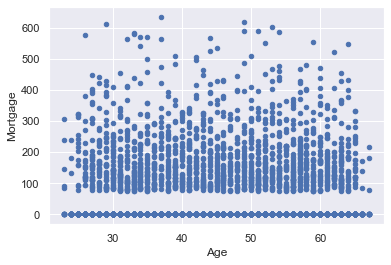

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Age by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

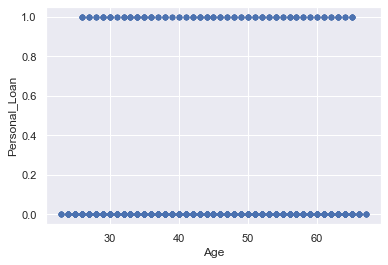

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Experience by Education Strip Plot


<Figure size 1080x720 with 0 Axes>

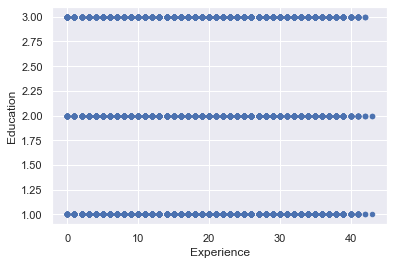

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Experience by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

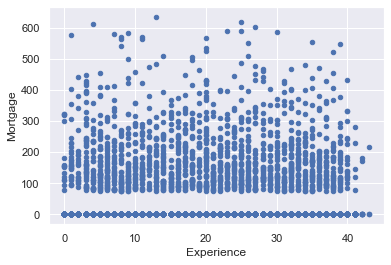

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Experience by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

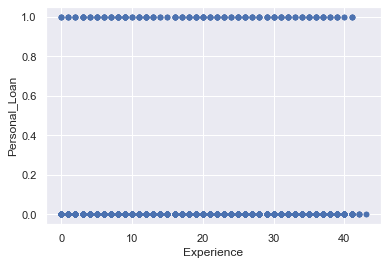

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Income by Education Strip Plot


<Figure size 1080x720 with 0 Axes>

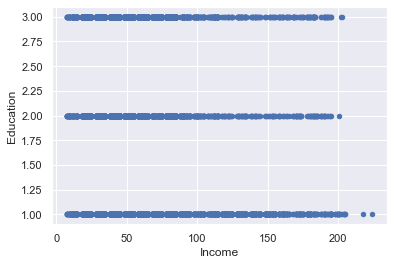

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Income by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

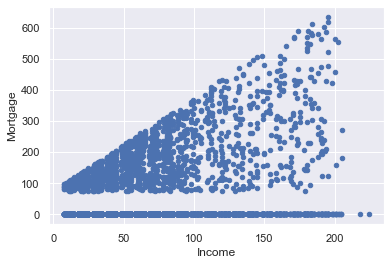

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Income by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

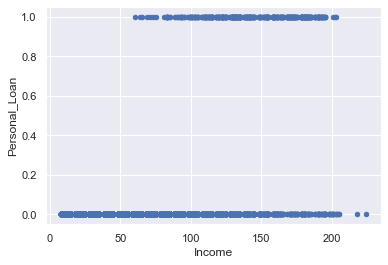

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


ZIPCode by Education Strip Plot


<Figure size 1080x720 with 0 Axes>

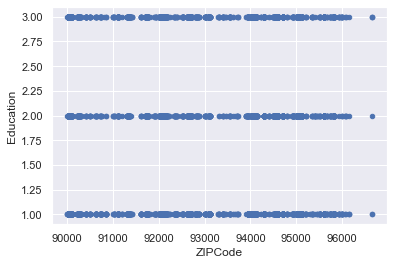

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


ZIPCode by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

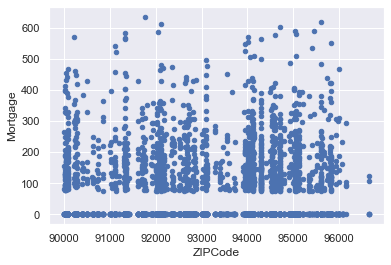

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


ZIPCode by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

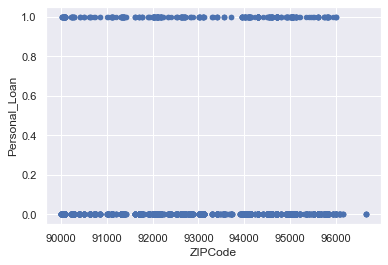

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Family by Education Strip Plot


<Figure size 1080x720 with 0 Axes>

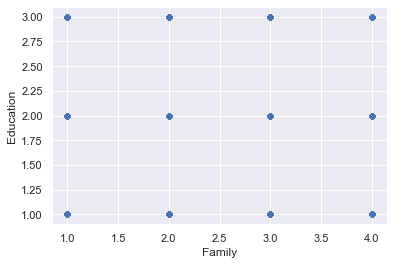

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Family by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

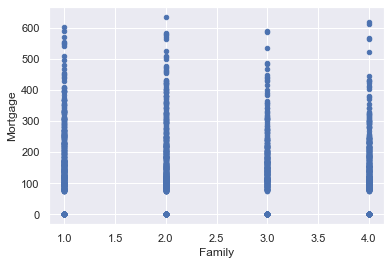

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Family by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

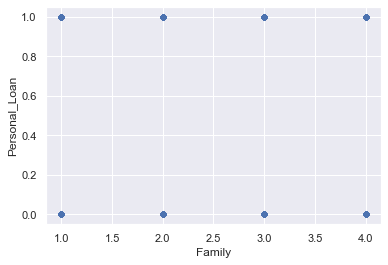

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


CCAvg by Education Strip Plot


<Figure size 1080x720 with 0 Axes>

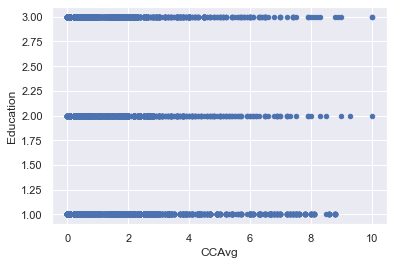

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


CCAvg by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

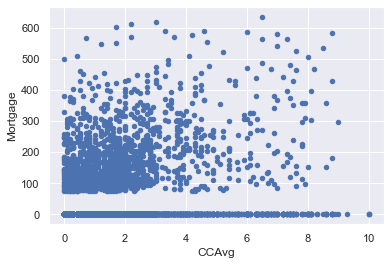

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


CCAvg by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

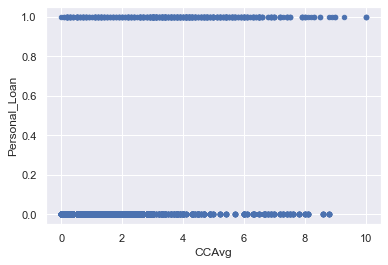

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Education by Education Strip Plot


<Figure size 1080x720 with 0 Axes>

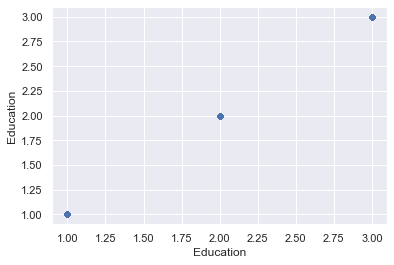

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Education by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

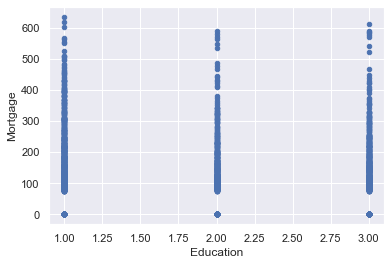

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Education by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

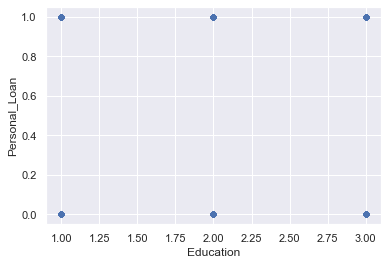

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Mortgage by Education Strip Plot


<Figure size 1080x720 with 0 Axes>

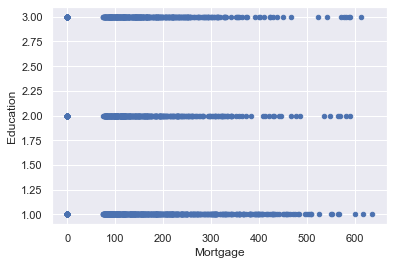

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Mortgage by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

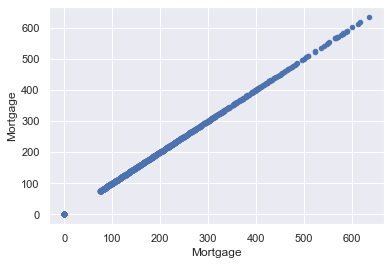

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Mortgage by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

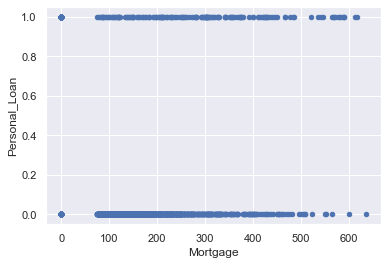

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Personal_Loan by Education Strip Plot


<Figure size 1080x720 with 0 Axes>

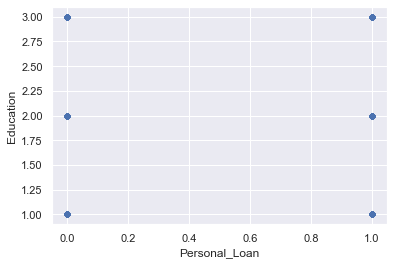

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Personal_Loan by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

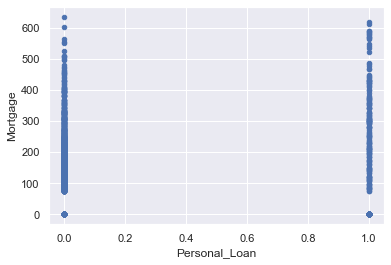

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Personal_Loan by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

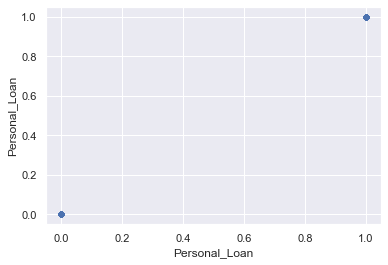

<IPython.core.display.Javascript object>

In [49]:
# lock subsets
nums = df.loc[:, "Age":"Personal_Loan":1]
num = df.loc[:, "Education":"Personal_Loan":1]

# call column names for plotting
for a in nums.columns:
    for b in num.columns:  # for every numeric
        # Scatter plot against a numeric variable
        print(a, "by", b, "Strip Plot")
        plt.figure(figsize=(15, 10))
        df.plot.scatter(x=a, y=b)
        plt.show()

### Correlation

In [50]:
# Correlation Analysis
corr = df.corr()
display(corr)

,Age,Experience,Income,ZIPCode,Family,CCAvg,Education,Mortgage,Personal_Loan,Securities_Account,CD_Account,Online,CreditCard
Age,1.00,0.98,-0.06,-0.03,-0.05,-0.05,0.04,-0.01,-0.01,-0.00,0.01,0.01,0.01
Experience,0.98,1.00,-0.05,-0.03,-0.05,-0.05,0.02,-0.01,-0.01,-0.00,0.01,0.01,0.01
Income,-0.06,-0.05,1.00,-0.03,-0.16,0.65,-0.19,0.21,0.50,-0.00,0.17,0.01,-0.00
ZIPCode,-0.03,-0.03,-0.03,1.00,0.03,-0.01,-0.01,0.00,-0.00,0.00,0.02,0.03,0.02
Family,-0.05,-0.05,-0.16,0.03,1.00,-0.11,0.06,-0.02,0.06,0.02,0.01,0.01,0.01
CCAvg,-0.05,-0.05,0.65,-0.01,-0.11,1.00,-0.14,0.11,0.37,0.02,0.14,-0.00,-0.01
Education,0.04,0.02,-0.19,-0.01,0.06,-0.14,1.00,-0.03,0.14,-0.01,0.01,-0.02,-0.01
Mortgage,-0.01,-0.01,0.21,0.00,-0.02,0.11,-0.03,1.00,0.14,-0.01,0.09,-0.01,-0.01
Personal_Loan,-0.01,-0.01,0.50,-0.00,0.06,0.37,0.14,0.14,1.00,0.02,0.32,0.01,0.00
Securities_Account,-0.00,-0.00,-0.00,0.00,0.02,0.02,-0.01,-0.01,0.02,1.00,0.32,0.01,-0.02


<IPython.core.display.Javascript object>

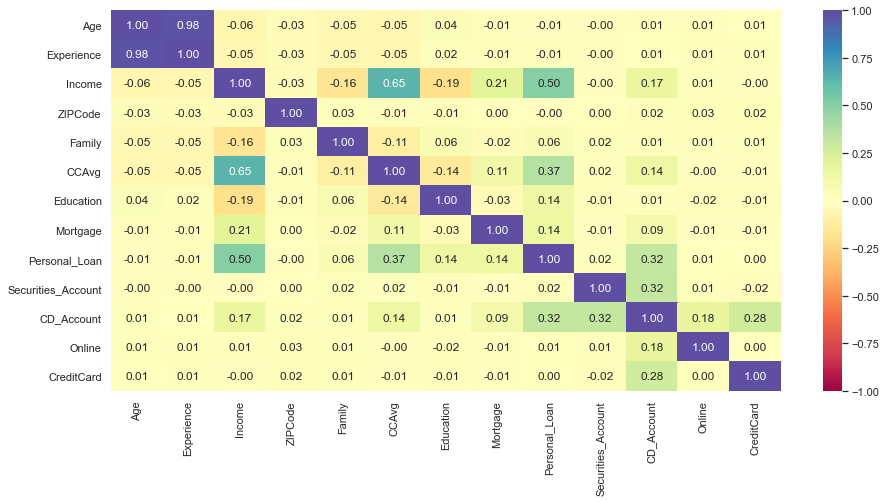

<IPython.core.display.Javascript object>

In [51]:
plt.figure(figsize=(15, 7))
sns.heatmap(df.corr(), annot=True, vmin=-1, vmax=1, fmt=".2f", cmap="Spectral")
plt.show()

* `Family` and `Income` might be single-source of income so worth looking at outside of this project
* `Education` and `Income` being negatively correlated is strange.
* `Education` and `Personal_Loan` acceptance is low in number but makes some sense that educated people might understand the concept of liquidity.

### Feature of Interest

`Personal_Loan` as the dependent variable against every numeric variable.

In [52]:
df[df.Personal_Loan == 1].describe().T

,count,mean,std,min,25%,50%,75%,max
Age,480.00,45.07,11.59,26.00,35.00,45.00,55.00,65.00
Experience,480.00,19.84,11.58,0.00,9.00,20.00,30.00,41.00
Income,480.00,144.75,31.58,60.00,122.00,142.50,172.00,203.00
ZIPCode,480.00,93153.20,1759.22,90016.00,91908.75,93407.00,94705.50,96008.00
Family,480.00,2.61,1.12,1.00,2.00,3.00,4.00,4.00
CCAvg,480.00,3.91,2.10,0.00,2.60,3.80,5.35,10.00
Education,480.00,2.23,0.75,1.00,2.00,2.00,3.00,3.00
Mortgage,480.00,100.85,160.85,0.00,0.00,0.00,192.50,617.00
Personal_Loan,480.00,1.00,0.00,1.00,1.00,1.00,1.00,1.00
Securities_Account,480.00,0.12,0.33,0.00,0.00,0.00,0.00,1.00


<IPython.core.display.Javascript object>

In [53]:
df[df.Personal_Loan == 0].describe().T

,count,mean,std,min,25%,50%,75%,max
Age,4520.00,45.37,11.45,23.00,35.00,45.00,55.00,67.00
Experience,4520.00,20.38,11.22,0.00,11.00,20.00,30.00,43.00
Income,4520.00,66.24,40.58,8.00,35.00,59.00,84.00,224.00
ZIPCode,4520.00,93170.96,1759.67,90005.00,91911.00,93437.00,94608.00,96651.00
Family,4520.00,2.37,1.15,1.00,1.00,2.00,3.00,4.00
CCAvg,4520.00,1.73,1.57,0.00,0.60,1.40,2.30,8.80
Education,4520.00,1.84,0.84,1.00,1.00,2.00,3.00,3.00
Mortgage,4520.00,51.79,92.04,0.00,0.00,0.00,98.00,635.00
Personal_Loan,4520.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Securities_Account,4520.00,0.10,0.30,0.00,0.00,0.00,0.00,1.00


<IPython.core.display.Javascript object>

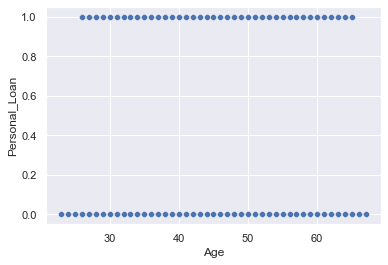

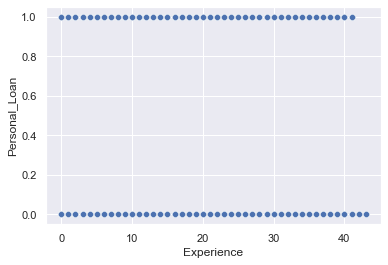

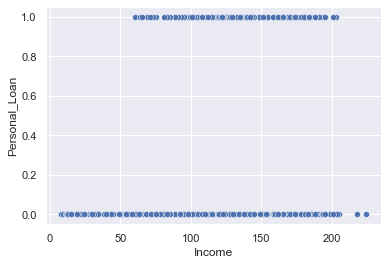

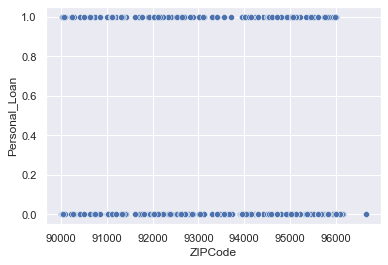

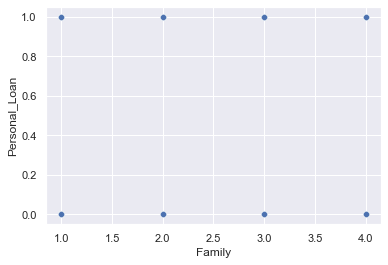

...

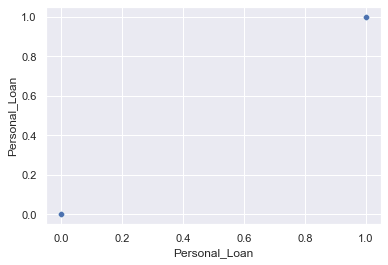

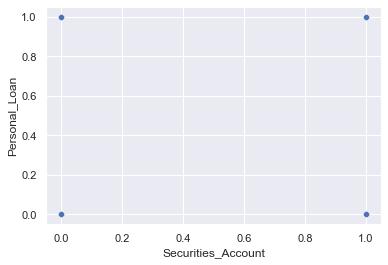

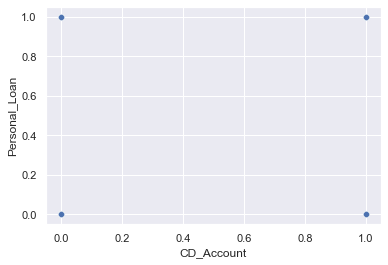

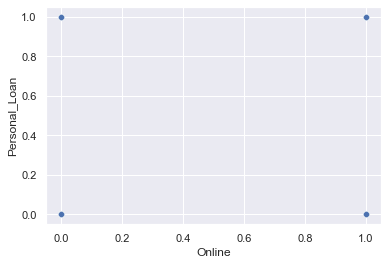

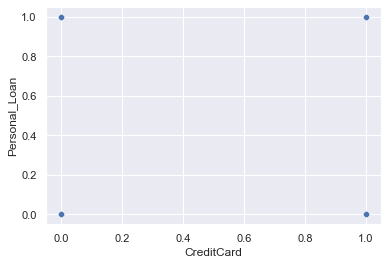

<IPython.core.display.Javascript object>

In [54]:
# plot indepdents against dependent
for i, variable in enumerate(df):
    sns.scatterplot(x=df[variable], y=df.Personal_Loan)
    plt.show()

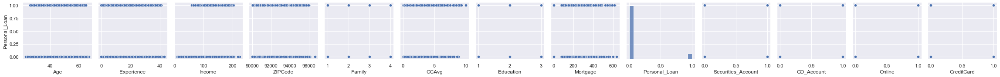

<IPython.core.display.Javascript object>

In [55]:
# create pairplot
sns.pairplot(data=df, y_vars=["Personal_Loan"], x_vars=df.columns)

#### Stack plots
Good for finding features of interest relative to target variable

In [56]:
## Function to plot stacked bar chart
def stacked_plot(x):
    sns.set(palette="nipy_spectral")
    tab1 = pd.crosstab(x, df["Personal_Loan"], margins=True)
    print(tab1)
    print("-" * 120)
    tab = pd.crosstab(x, df["Personal_Loan"], normalize="index")
    tab.plot(kind="bar", stacked=True, figsize=(10, 5))
    # plt.legend(loc='lower left', frameon=False)
    # plt.legend(loc="upper left", bbox_to_anchor=(0,1))
    plt.show()

<IPython.core.display.Javascript object>

Personal_Loan          0    1   All
Securities_Account                 
0                   4058  420  4478
1                    462   60   522
All                 4520  480  5000
------------------------------------------------------------------------------------------------------------------------


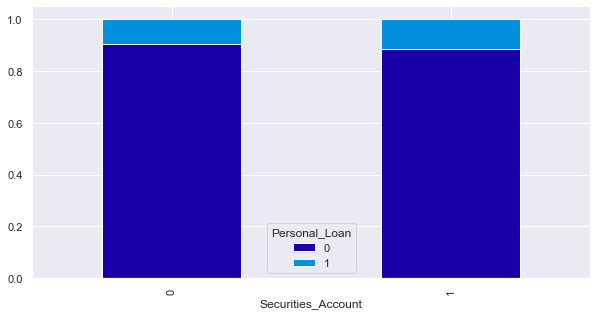

Personal_Loan     0    1   All
CD_Account                    
0              4358  340  4698
1               162  140   302
All            4520  480  5000
------------------------------------------------------------------------------------------------------------------------


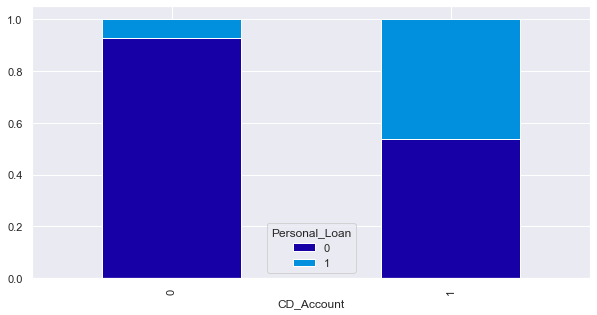

Personal_Loan     0    1   All
Online                        
0              1827  189  2016
1              2693  291  2984
All            4520  480  5000
------------------------------------------------------------------------------------------------------------------------


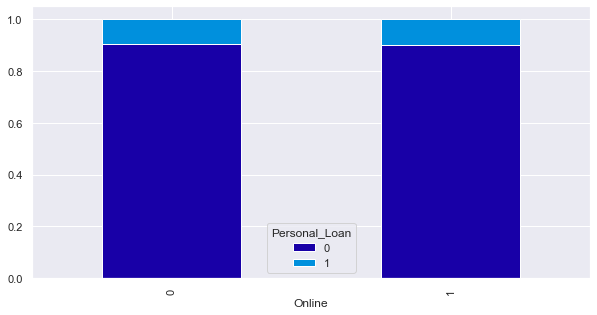

Personal_Loan     0    1   All
CreditCard                    
0              3193  337  3530
1              1327  143  1470
All            4520  480  5000
------------------------------------------------------------------------------------------------------------------------


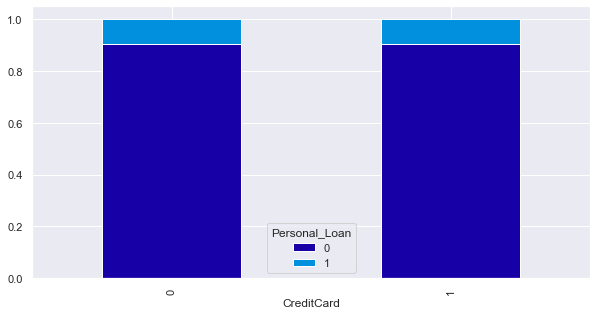

<IPython.core.display.Javascript object>

In [57]:
import warnings

warnings.filterwarnings("ignore")

# stack plots against categoricals
cats = df.loc[:, "Securities_Account":"CreditCard"]

for i in cats:
    stacked_plot(df[i])

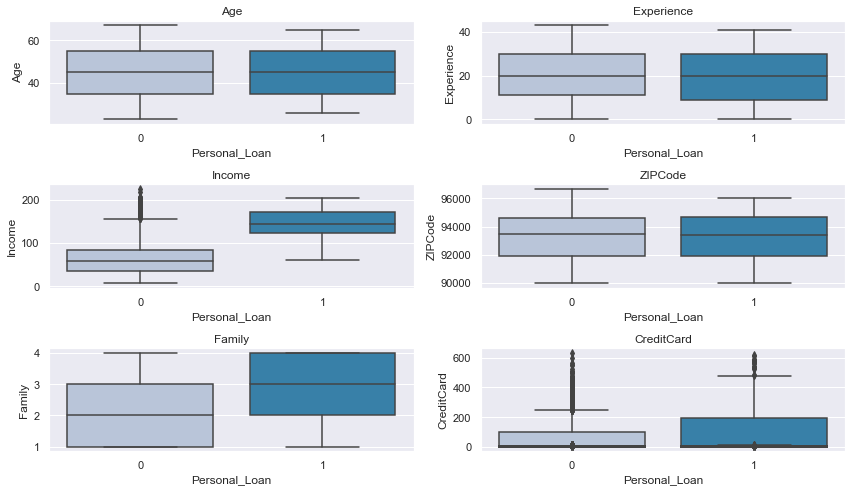

<IPython.core.display.Javascript object>

In [58]:
# create subplots against target variable
cols = df.columns
plt.figure(figsize=(12, 7))

for i, variable in enumerate(cols):
    try:
        plt.subplot(3, 2, i + 1)
    except ValueError:
        pass  # do nothing!

    sns.boxplot(df["Personal_Loan"], df[variable], palette="PuBu")

    plt.tight_layout()

    plt.title(variable)
plt.show()

### Key Observations

`ID.` : 
 - 5000 customers from a bank is not a large sample size to begin with.
 - This column could be used a relational database as a table key to pull additional data points (features).

`Age` :
- Ranges from 23 to 67 years old.
- The distribution is nearly normal with a strange uniformity in the middle.
- Has a strong correlation with `Experience`.

`Experience` : 
- The mean years of experience is 20.33.
- There is a jump in # of customers in years around 12 and 30  years.

`Income` : 
- The median is 64.00 (thousands) of dollars.
- Higher incomes are in the category of loan accepters.
- Those who did accept a loan offer tend to have higher income.

` ZIP Code` : 
 - Cover different areas of California.
 - The majority of customers are in the 9400-9500 codes which is around Los Angeles, San Diego, and San Clara counties.

`Family` : 
 - The range of family members is 1 - 4.
 - The majority of customers only have 1 member in the family. 
 - Those who accepted a loan offer tend to have more than 2 members in the family.

`CCAvg` : 
 - There is atleast one customer who has 10.00 (thousands) in average credit card spending.
 - The data leaks to the left and has good implications as the majority do not have high credit debt.


`Education` : 
 - 75% of the customers lie below Advanced Professional status.
 - Levels 2 and 3 are close in count in the dataset.


`Mortgage` : 
 - The skew is very large with data leaking to the right.
 - Has a number of outliers in the higher values.


`Personal_Loan` : 
 - Not accepting a loan from the last campaign is the most popular choice.
 - Only 480 customers got a loan after the last campaign.


`Securities_Account` : 
 - The number of customers with an account already is 522.
 - The vast majority do not have an account (89%).


`CD_Account` : 
 - 4698 do not have CD accounts , only 6% of these customers have an account.
 - Most Personal Loan accepters did not have CD accounts.
 

`Online` : 
 - The use of online features is roughly split in half with the stronger side being online users.
 - Of the customers who accepted loan offers, 4520 use online features.


`CreditCard` : 
 - The majority of customers have cards with another bank.
 - Only 1470 customers do not have cards with another bank.

### Insight

We can conclude that liability customers targeted in the last campaign include folks who are 35 - 43, have 9-32 years of professional experience, make around 38-44k (dollars) a year, live near Palo Alto or Berkeley, have 1 -2 children, have credit debt of 300-1000 (dollars)/month, have an undergraduate degree, no mortgage, non-investors, non-CD holders, online feature-users, and credit card holders with other banks.


# Classification Models

Assumptions come with Logistic Regression as in Linear Regression. We will need to handle those.

## Model Building Approach
1. Data preparation
2. Partition the data into train and test set.
3. Build a Logistic Regression model on the train data.
4. Tune the model and drop features for multicolinearity.
5. Test the data on test set.

### Functions

In [59]:
def get_metrics_score(
    model, library, train, test, train_y, test_y, threshold=0.5, flag=True, roc=False
):
    """
    Function to calculate different metric scores of the model - Accuracy, Recall, Precision, and F1 score
    library: Takes two arguments stats for statsmodels and sklearn for sklearn library 
    model: classifier to predict values of X
    train, test: Independent features
    train_y,test_y: Dependent variable
    threshold: thresold for classifiying the observation as 1
    flag: If the flag is set to True then only the print statements showing different will be displayed. The default value is set to True.
    roc: If the roc is set to True then only roc score will be displayed. The default value is set to False.
    """
    # defining an empty list to store train and test results
    if library == "stats":
        score_list = []

        pred_train = model.predict(train) > threshold
        pred_test = model.predict(test) > threshold

        pred_train = np.round(pred_train)
        pred_test = np.round(pred_test)

        train_acc = accuracy_score(pred_train, train_y)
        test_acc = accuracy_score(pred_test, test_y)

        train_recall = recall_score(train_y, pred_train)
        test_recall = recall_score(test_y, pred_test)

        train_precision = precision_score(train_y, pred_train)
        test_precision = precision_score(test_y, pred_test)

        train_f1 = f1_score(train_y, pred_train)
        test_f1 = f1_score(test_y, pred_test)

        score_list.extend(
            (
                train_acc,
                test_acc,
                train_recall,
                test_recall,
                train_precision,
                test_precision,
                train_f1,
                test_f1,
            )
        )

    elif library == "sklearn":
        score_list = []

        pred_train = model.predict(train)
        pred_test = model.predict(test)

        train_acc = accuracy_score(pred_train, train_y)
        test_acc = accuracy_score(pred_test, test_y)

        train_recall = recall_score(train_y, pred_train)
        test_recall = recall_score(test_y, pred_test)

        train_precision = precision_score(train_y, pred_train)
        test_precision = precision_score(test_y, pred_test)

        train_f1 = f1_score(train_y, pred_train)
        test_f1 = f1_score(test_y, pred_test)

        score_list.extend(
            (
                train_acc,
                test_acc,
                train_recall,
                test_recall,
                train_precision,
                test_precision,
                train_f1,
                test_f1,
            )
        )

    if flag == True:
        print("Accuracy on training set : ", accuracy_score(pred_train, train_y))
        print("Accuracy on test set : ", accuracy_score(pred_test, test_y))
        print("Recall on training set : ", recall_score(train_y, pred_train))
        print("Recall on test set : ", recall_score(test_y, pred_test))
        print("Precision on training set : ", precision_score(train_y, pred_train))
        print("Precision on test set : ", precision_score(test_y, pred_test))
        print("F1 on training set : ", f1_score(train_y, pred_train))
        print("F1 on test set : ", f1_score(test_y, pred_test))

    if roc == True and library == "sklearn":
        pred_train_prob = model.predict_proba(train)[:, 1]
        pred_test_prob = model.predict_proba(test)[:, 1]
        print(
            "ROC-AUC Score on training set : ", roc_auc_score(train_y, pred_train_prob)
        )
        print("ROC-AUC Score on test set : ", roc_auc_score(test_y, pred_test_prob))

    elif roc == True and library == "stats":
        print("ROC-AUC Score on training set : ", roc_auc_score(train_y, pred_train))
        print("ROC-AUC Score on test set : ", roc_auc_score(test_y, pred_test))

    return score_list  # returning the list with train and test scores

<IPython.core.display.Javascript object>

In [140]:
def make_confusion_matrix(
    model, library, test_X, y_actual, threshold=0.5, labels=[1, 0]
):
    """
    model : classifier to predict values of X
    library: Takes two arguments stats for statsmodels and sklearn for sklearn library 
    test_X: test set
    y_actual : ground truth  
    threshold: thresold for classifiying the observation as 1
    
    """

    if library == "sklearn":
        y_predict = model.predict(test_X)
        cm = metrics.confusion_matrix(y_actual, y_predict, labels=[0, 1])

        df_cm = pd.DataFrame(
            cm,
            index=[i for i in ["Actual - No", "Actual - Yes"]],
            columns=[i for i in ["Predicted - No", "Predicted - Yes"]],
        )
        group_counts = ["{0:0.0f}".format(value) for value in cm.flatten()]
        group_percentages = [
            "{0:.2%}".format(value) for value in cm.flatten() / np.sum(cm)
        ]
        labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts, group_percentages)]
        labels = np.asarray(labels).reshape(2, 2)
        plt.figure(figsize=(10, 7))
        sns.heatmap(df_cm, annot=labels, fmt="")
        plt.ylabel("True label")
        plt.xlabel("Predicted label")

    elif library == "stats":
        y_predict = model.predict(test_X) > threshold
        cm = metrics.confusion_matrix(y_actual, y_predict, labels=[1, 0])
        cm = metrics.confusion_matrix(y_actual, y_predict, labels=[0, 1])

        df_cm = pd.DataFrame(
            cm,
            index=[i for i in ["Actual - No", "Actual - Yes"]],
            columns=[i for i in ["Predicted - No", "Predicted - Yes"]],
        )
        group_counts = ["{0:0.0f}".format(value) for value in cm.flatten()]
        group_percentages = [
            "{0:.2%}".format(value) for value in cm.flatten() / np.sum(cm)
        ]
        labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts, group_percentages)]
        labels = np.asarray(labels).reshape(2, 2)
        plt.figure(figsize=(10, 7))
        sns.heatmap(df_cm, annot=labels, fmt="")
        plt.ylabel("True label")
        plt.xlabel("Predicted label")

<IPython.core.display.Javascript object>

In [141]:
# function to build a matrix of predicted and actual values
def make_confusion_matrix_small(y_actual, y_predict, labels=[1, 0]):
    """
    y_predict: prediction of class
    y_actual : ground truth  
    """
    cm = confusion_matrix(y_predict, y_actual, labels=[1, 0])
    df_cm = pd.DataFrame(
        cm, index=[i for i in ["1", "0"]], columns=[i for i in ["1", "0"]]
    )
    group_counts = ["{0:0.0f}".format(value) for value in cm.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in cm.flatten() / np.sum(cm)]
    labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts, group_percentages)]
    labels = np.asarray(labels).reshape(2, 2)
    plt.figure(figsize=(7, 5))
    sns.heatmap(df_cm, annot=labels, fmt="")
    plt.ylabel("True label")
    plt.xlabel("Predicted label")

<IPython.core.display.Javascript object>

In [175]:
# Function to calculate recall score
def get_recall_score(model):
    """
    model : classifier to predict values of X

    """
    pred_train = dtmodel.predict(X_train)
    pred_test = dtmodel.predict(X_test)
    print("Recall on training set : ", metrics.recall_score(y_train, pred_train))
    print("Recall on test set : ", metrics.recall_score(y_test, pred_test))

<IPython.core.display.Javascript object>

In [176]:
# Function to create confusion matrix
def make_confusion_matrix_dt(model, y_actual, labels=[1, 0]):
    """
    model : classifier to predict values of X
    y_actual : ground truth  

    """
    y_predict = model.predict(X_test)
    cm = metrics.confusion_matrix(
        y_actual, y_predict, labels=[0, 1]
    )  # At least one label specified must be in y_true
    df_cm = pd.DataFrame(
        cm,
        index=[i for i in ["Actual - No", "Actual - Yes"]],
        columns=[i for i in ["Predicted - No", "Predicted - Yes"]],
    )
    group_counts = ["{0:0.0f}".format(value) for value in cm.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in cm.flatten() / np.sum(cm)]
    labels = [f"{v1}\n{v2}" for v1, v2 in zip(group_counts, group_percentages)]
    labels = np.asarray(labels).reshape(2, 2)
    plt.figure(figsize=(10, 7))
    sns.heatmap(df_cm, annot=labels, fmt="")
    plt.ylabel("True label")
    plt.xlabel("Predicted label")

<IPython.core.display.Javascript object>

## Prepare Data

Set up the dataframe by creating a list of features to build a model on. We will drop `ID` as it has no value for analysis.

In [61]:
# get a list of column names
column_names = list(df.columns)

# remove unwanted columns from list
column_names.remove("Personal_Loan")

# set column names as feature names
feature_names = column_names

# print feature names
print(feature_names)

['Age', 'Experience', 'Income', 'ZIPCode', 'Family', 'CCAvg', 'Education', 'Mortgage', 'Securities_Account', 'CD_Account', 'Online', 'CreditCard']


<IPython.core.display.Javascript object>

In [62]:
df.head()

,Age,Experience,Income,ZIPCode,Family,CCAvg,Education,Mortgage,Personal_Loan,Securities_Account,CD_Account,Online,CreditCard
0,25,1,49,91107,4,1.60,1,0,0,1,0,0,0
1,45,19,34,90089,3,1.50,1,0,0,1,0,0,0
2,39,15,11,94720,1,1.00,1,0,0,0,0,0,0
3,35,9,100,94112,1,2.70,2,0,0,0,0,0,0
4,35,8,45,91330,4,1.00,2,0,0,0,0,0,1


<IPython.core.display.Javascript object>

In [63]:
# convert Zip to broader geographical range
df.ZIPCode = df["ZIPCode"].astype(str).str[0:2]
df["ZIPCode"] = df["ZIPCode"].astype("category")
df.ZIPCode.head()

0    91
1    90
2    94
3    94
4    91
Name: ZIPCode, dtype: category
Categories (7, object): ['90', '91', '92', '93', '94', '95', '96']

<IPython.core.display.Javascript object>

### Label Encoding

In [64]:
df["Education"].replace(1, "Undergraduate", inplace=True)
df["Education"].replace(2, "Graduate", inplace=True)
df["Education"].replace(3, "Professional", inplace=True)

<IPython.core.display.Javascript object>

In [65]:
df.Education.head()

0    Undergraduate
1    Undergraduate
2    Undergraduate
3         Graduate
4         Graduate
Name: Education, dtype: object

<IPython.core.display.Javascript object>

### One-HotEncoding

In [66]:
df = pd.get_dummies(data=df, columns=["ZIPCode", "Education"], drop_first=True)
df.head()

,Age,Experience,Income,Family,CCAvg,Mortgage,Personal_Loan,Securities_Account,CD_Account,Online,CreditCard,ZIPCode_91,ZIPCode_92,ZIPCode_93,ZIPCode_94,ZIPCode_95,ZIPCode_96,Education_Professional,Education_Undergraduate
0,25,1,49,4,1.60,0,0,1,0,0,0,1,0,0,0,0,0,0,1
1,45,19,34,3,1.50,0,0,1,0,0,0,0,0,0,0,0,0,0,1
2,39,15,11,1,1.00,0,0,0,0,0,0,0,0,0,1,0,0,0,1
3,35,9,100,1,2.70,0,0,0,0,0,0,0,0,0,1,0,0,0,0
4,35,8,45,4,1.00,0,0,0,0,0,1,1,0,0,0,0,0,0,0


<IPython.core.display.Javascript object>

### Partition Data

In [67]:
# split the df
X = df.drop(["Personal_Loan"], axis=1)  # Predictor feature columns (13 X m)
Y = df[["Personal_Loan"]]  # Predicted class (1=True, 0=False) (1 X m)


x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=1)
# 1 is just any random seed number

# check dataframe
x_train.head()

,Age,Experience,Income,Family,CCAvg,Mortgage,Securities_Account,CD_Account,Online,CreditCard,ZIPCode_91,ZIPCode_92,ZIPCode_93,ZIPCode_94,ZIPCode_95,ZIPCode_96,Education_Professional,Education_Undergraduate
1334,47,22,35,2,1.30,0,0,0,1,0,0,0,0,1,0,0,0,1
4768,38,14,39,1,2.00,0,0,0,1,0,0,0,1,0,0,0,0,0
65,59,35,131,1,3.80,0,0,0,1,1,1,0,0,0,0,0,0,1
177,29,3,65,4,1.80,244,0,0,0,0,0,0,0,1,0,0,0,0
4489,39,13,21,3,0.20,0,0,0,1,0,0,0,0,0,1,0,0,0


<IPython.core.display.Javascript object>

Lets check split of data

In [68]:
print("{0:0.2f}% data is in training set".format((len(x_train) / len(df.index)) * 100))
print("{0:0.2f}% data is in test set".format((len(x_test) / len(df.index)) * 100))

70.00% data is in training set
30.00% data is in test set


<IPython.core.display.Javascript object>

## Model Scoring

##### Criterion

The goal: identify the potential asset customers, *current liability customers*,  who have a higher probability of purchasing the loan after the next ad campaign.

We know who these people are by their `ID`, or customer ID. This helps us identify their unique characteristics. We can target them specifically based on this dataset. Ultimately, we want to know, of all the Customer ID's who will purchase a loan?  We can also generalize about the types of people these are. We can then target a larger set of liability customers, all liability customers, with segementation. How do we know? We look at who did in the last campaign and try to predict who will in the next by mapping their feautures into a customer profile. This is called "targeted marketing" and using each segement of the market to identify who will respond positively to the campaign ad.

The question, will the next ad campaign target only remaining liability customers or both liability and asset customers? 

What we want to do now is measure the effectiveness of our model. We do this by measuring it's performance. What are we measuring? Loan offer acceptance (i.e,. borrow a loan from AllBank). 

Law or norm: the liability customer does not accept a loan offer and remains a liability customer until they are converted by accepting a loan offer in an ad campaign and become an asset customer thus increasing interest returns for the bank.

What's the evidence that a liability customer will convert? the features of those customers that converted from the last campaign. Some did. So, who are they?

Null-hypothesis: the current liability customer will not convert to an asset customer after an ad-campaign.
reject: the customer will convert (success ratio increases).
accept: the customer will not convert (success ratio decreases).

This validity of accepting the null-hypothesis is seen in the dataset. Only 9% converted as a result of the last campaign. 

To increase that ratio we have to target those people who did in the last one and predict the liklihood that they will again so that we can extract their features and create a customer profile, i.e., "asset customer profile". 
These are the people who will purchase loans as a result of our campaigns. Of course, it's more complicated than that as the content of the ad's matters as well but we will change the content based on the features we extract about the people who accepted loans in the last campaign. 
This will give us that profile.

We will use a confusion matrix to help us. This will tell us whether:

What the bank wants to correctly predict and thus make obvious choices about ad-spending on target marketing:

- **True Positives:** How many loan accepters are correctly predicted as accepting of loan offers? The model predicted a liability customer to accept to convert to an asset customer based on a targeted ad loan acceptance (conversion) and there was one (they were loan accepters, asset customers). (Sensitivity test)
    - Reality: A liability customer accepted the loan offer and is an asset customer. (1)
    - Model predicted: The liability customer will accept the loan offer and convert to an asset customer (0 to 1).
    - Outcome: The model is good. Increase in success ratio. Put money towards targeting these liability customers. 

A customer who does have a loan is predicted to have a loan.

- **True Negatives:** How many non-offer accepters are predicted as not accepting of loan offers?
    - Reality: A liability customer did NOT accepted the loan offer in the last campaign. (0)
    - Model predicted: The liability customer will NOT accept the loan offer of the future campaign and not convert to an asset customer (0 to 0) 
    - Outcome: The business is unaffected. No change in success rate. Do not bother targeting these liability customers.
    
A customer who does not have a loan is predicted not to have a loan.

**What we need to watch out for are:**

- **False Positives:** model reject a true null hypothesis
    - Reality: A liability customer did NOT accepted the loan offer. (0)
    - Model predicted: The liability customer will accepted the loan offer and convert to an asset customer. (0 to 1).
    - Outcome: The money spent in ad-dollars went to a liability customer who has the potential or is predicted to be an asset customer given another campaign targeted toward their profile but they are not asset customers but liability customers. As the result, the bank's targeting of these customers needs to loss in money (ad-spend revenue). = decreased success ratio:
    
A customer who does NOT have a loan is predicted to have a loan.

- **False Negatives:** model accepts a false null hypothesis
    - Reality: A liability customer did accepted the loan offer and is an asset customer (success). (1)
    - Model predicted: The asset customer will NOT accept the loan offer (become a second-time borrower). (1 to 0).
    - Outcome: Loss of interest earnings, success ratio, and conversion. The marketing team is targeting the asset customers who already purchased a loan after the last campaign's loan offer and are current asset customers who are likely to become (predicted to become) further borrowers. They are potentially liability customers who will stay as asset customers. = second-time borrower
    
A customer who does have a loan is predicted to NOT have a loan.

    
**What does a bank want?**
A bank wants to target the segment of liability customers who are most likely to accept a loan offer through an ad. More than that, they want to minimize the financial loss from ad-spending (target marketing) by targeting the wrong people. The wrong people are the ones who will not accept loan offers. We know who those people are based on who accepted them in the last campaign. But we are predicting here who of those people will accept a loan offer in a future campaign. So, we can have the results mentioned above. The worse case scenario is what we are looking for.

It does not want to (it wants to reduce) spend money on targeting ads that will not purchase a loan in the next campaign - it can face 2 types of *losses* here: 

Target this segment of people (loan or non loan)

1. Could target loan offers to non-loan accepters - Loss of money
   * Loss of ad-spend money by targeting the right people: predicting a non-loan-accepter (0 to 1) when they are in fact a loan-accepter. Here we are missing out on targeting he right people.

2. Target loan offers to loan accepters - Loss of opportunity
   * Loss of opportunity by targeting the people who are customers but only depositors and will not convert to borrowers after another ad. These people are predicted as non-loan accepters (0's) but are loan accepters in fact (1's from the last campaign).  We did not gain any **new** asset customers.
   

**Which loss is greater ?**
* Customer not returning the ad-money back by purchasing a loan. 

**Since we don't want people to not have loans we should use Recall as a metric of model evaluation instead of accuracy.**

* Recall - It gives the ratio of True positives to Actual positives, so high Recall implies low false negatives, i.e. low chances of predicting a 1 as 0.

Also worth noting are:
* Precision tells us "from all the classes we have predicted as positive, how many are actually positive."
* Accuracy tells us from all the classes (positive and negative), how many of them we have predicted correctly. Accuracy should be high as possible.

**Which loss is greater?**
* Since we want to convert 0's to 1's we need to measure the False (0's in `Personal_Loan`) to the Positive (predicted to be a 1 in next `Personal_Loan` (accept the loan offer) dataset post the campaign.) These are the False Positives. The gaining of a new asset customer from the base of liability customers (the remaining 0's in the current data set) is the better gain over wasting ad-dollars targeting people who already purchased a loan after the last one and are current asset customers (1's in the dataset). We are trying to measure success as a matter of conversion and as a ratio so we need a good percentage of False Positives.

But on the negative side we do not want to spend time and money on targeting people who are not going to purchase a loan. These are people who are predicted to purchase a loan but in fact are historically non-loan accepters. If we target these people our success ratio will decrease as our conversion will go down and we might even lose some existing asset customers if we target them again. The greatest loss is one where we have customers who do not have loans.

**How to reduce not having a loan i.e need to reduce False Negatives ?**
* Company wants Recall to be maximized, greater the recall lesser the chances of false positives. 

* Recall - It gives the ratio of True positives to Actual positives, so high Recall implies low false negatives, i.e. low chances of predicting a loan accepter (1) as non-loan accepter (0)

**RealWorld**
Ask the marketing team what their appetite for risk is. They could be spending money targeting people who will or will not accept the loan so we want to know how loose to be in our performance measure: accuracy. 


## Logistic Model (Sklearn)

In [146]:
# There are different solvers available in Sklearn logistic regression
# The newton-cg solver is faster for high-dimensional data
model = LogisticRegression(
    solver="newton-cg", random_state=1, fit_intercept=False
)  # no bias

# Fit the model on train
lr = model.fit(X_train, y_train)

# predict on test
y_predict = model.predict(X_test)

# place an intercept
coef_df = pd.DataFrame(model.coef_)
coef_df["intercept"] = model.intercept_
print(coef_df)

      0     1    2    3    4    5    6     7    8     9    10    11   12   13  \
0 -5.66 -0.07 0.07 0.05 0.45 0.18 0.00 -0.87 3.20 -0.62 -0.92 -0.33 0.01 0.03   

     14    15    16   17    18  intercept  
0 -0.24 -0.23 -0.39 0.00 -3.46       0.00  


<IPython.core.display.Javascript object>

In [148]:
# Let's check model performances for this model
scores_LR = get_metrics_score(model, "sklearn", X_train, X_test, y_train, y_test)

Accuracy on training set :  0.9582857142857143
Accuracy on test set :  0.9566666666666667
Recall on training set :  0.649546827794562
Recall on test set :  0.6308724832214765
Precision on training set :  0.8775510204081632
Precision on test set :  0.9038461538461539
F1 on training set :  0.7465277777777778
F1 on test set :  0.7430830039525691


<IPython.core.display.Javascript object>

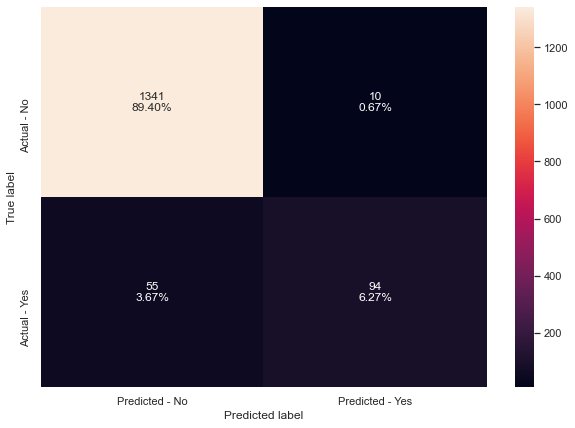

<IPython.core.display.Javascript object>

In [149]:
# confusion matrix
make_confusion_matrix(lr, "sklearn", X_test, y_test)

**Observations**

* Recall: is ok at ~61% on test data.

* Fit is very good and not diverging much on train to test.

* Accuracy is very high and good Precision as well.

**Matrix**

TP: 6%

TN: 89%

FP: ~1%

FN: 4% - Our False Negative rate is very low.

## Logistic Regression Model  (statsmodel) 

In [69]:
# adding constant to training and test set
X_train = sm.add_constant(x_train)
X_test = sm.add_constant(x_test)

logit = sm.Logit(y_train, x_train.astype(float))

lg = logit.fit(
    warn_convergence=True
)  # can flag convergence, terminate iterations much earlier

print(lg.summary2())

Optimization terminated successfully.
         Current function value: 0.135000
         Iterations 10
                             Results: Logit
Model:                 Logit              Pseudo R-squared:   0.569      
Dependent Variable:    Personal_Loan      AIC:                980.9996   
Date:                  2021-08-20 08:05   BIC:                1091.8889  
No. Observations:      3500               Log-Likelihood:     -472.50    
Df Model:              17                 LL-Null:            -1095.5    
Df Residuals:          3482               LLR p-value:        1.8537e-254
Converged:             1.0000             Scale:              1.0000     
No. Iterations:        10.0000                                           
-------------------------------------------------------------------------
                         Coef.  Std.Err.    z     P>|z|   [0.025   0.975]
-------------------------------------------------------------------------
Age                     -0.1998   0.013

<IPython.core.display.Javascript object>

In [70]:
# Let's Look at Model Performance
y_pred = lg.predict(x_train)
pred_train = list(map(round, y_pred))

y_pred1 = lg.predict(x_test)
pred_test = list(map(round, y_pred1))

print("predicted recall on train data:", recall_score(y_train, pred_train))
print("predicted recall on test data:", recall_score(y_test, pred_test))

predicted recall on train data: 0.6465256797583081
predicted recall on test data: 0.6308724832214765


<IPython.core.display.Javascript object>

In [71]:
# use function for scoring
get_metrics_score(lg, "stats", x_train, x_test, y_train, y_test)

Accuracy on training set :  0.9511428571428572
Accuracy on test set :  0.952
Recall on training set :  0.6465256797583081
Recall on test set :  0.6308724832214765
Precision on training set :  0.7985074626865671
Precision on test set :  0.8468468468468469
F1 on training set :  0.7145242070116861
F1 on test set :  0.7230769230769231


[0.9511428571428572,
 0.952,
 0.6465256797583081,
 0.6308724832214765,
 0.7985074626865671,
 0.8468468468468469,
 0.7145242070116861,
 0.7230769230769231]

<IPython.core.display.Javascript object>

**Statsmodel**
* `Education_Undergraduate`, `CD_Account`, `ZIPCode_96` have the higher influence on loan acquiring.
*  Most Zip codes have a p value of more than 0.05 and are thus insignificant.
*  Extremely low p-value

**Performance Measures**
* Target metric: Recall: The recall on the training and test is 1 points off and both are good as they are above 50% for correctly predicted positive observations to the all observations in actual class - (1) approved a loan offer.

* Fit: The metrics are closer to eachother in scoring and so the model is not overfitting.

* We have a good accuracy at ~95%.

#### Multicolinearity

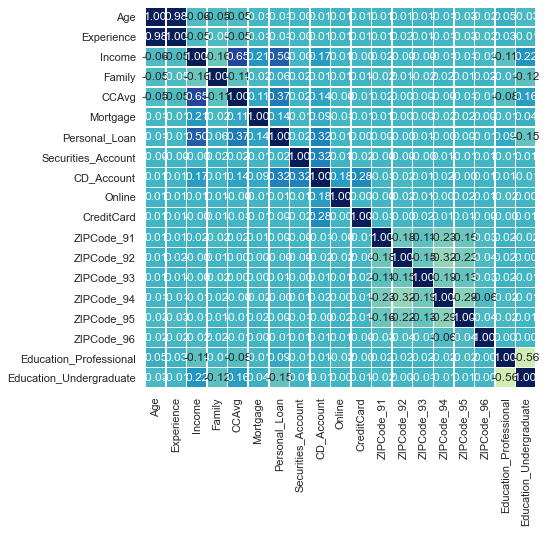

<IPython.core.display.Javascript object>

In [72]:
# make correlation heatmap
sns.set(rc={"figure.figsize": (7, 7)})
sns.heatmap(
    df.corr(),
    annot=True,
    linewidths=0.5,
    center=0,
    cbar=False,
    cmap="YlGnBu",
    fmt="0.2f",
)
plt.show()

We can see that `Age` & `Experience` and  `CCAvg` & `Income` have high correlation and "explain" the variance within the data. We will need to drop one of these pairs and view the model results.

##### Variance Inflation

In [73]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif_series1 = pd.Series(
    [variance_inflation_factor(X_train.values, i) for i in range(X_train.shape[1])],
    index=X_train.columns,
)
print("Series before feature selection: \n\n{}\n".format(vif_series1))

Series before feature selection: 

const                     124.60
Age                        20.50
Experience                 20.46
Income                      1.88
Family                      1.05
CCAvg                       1.74
Mortgage                    1.05
Securities_Account          1.14
CD_Account                  1.36
Online                      1.04
CreditCard                  1.11
ZIPCode_91                  1.62
ZIPCode_92                  1.93
ZIPCode_93                  1.45
ZIPCode_94                  2.23
ZIPCode_95                  1.82
ZIPCode_96                  1.04
Education_Professional      1.47
Education_Undergraduate     1.54
dtype: float64



<IPython.core.display.Javascript object>

Again we see the same with `Age` and `Experience`. But `Income` and `CCAvg` are in an acceptable range (<15).

We will reduce the dataframe by one feature at a time and check results.

##### Dropping features: `Age`

In [74]:
# job has highest p values among those with vif-value greater than 10
import statsmodels.api as sm

# adding constant to training and test set
X_train1 = X_train.drop("Age", axis=1)
X_test1 = X_test.drop("Age", axis=1)

logit = sm.Logit(y_train, X_train1)

lg1 = logit.fit()

print(lg1.summary2())

# Let's Look at Model Performance
y_pred = lg1.predict(X_train1)
pred_train = list(map(round, y_pred))

y_pred1 = lg1.predict(X_test1)
pred_test = list(map(round, y_pred1))

print("recall on train data:", recall_score(y_train, pred_train))
print("recall on test data:", recall_score(y_test, pred_test))

Optimization terminated successfully.
         Current function value: 0.113705
         Iterations 10
                             Results: Logit
Model:                 Logit              Pseudo R-squared:   0.637      
Dependent Variable:    Personal_Loan      AIC:                831.9373   
Date:                  2021-08-20 08:05   BIC:                942.8266   
No. Observations:      3500               Log-Likelihood:     -397.97    
Df Model:              17                 LL-Null:            -1095.5    
Df Residuals:          3482               LLR p-value:        1.8497e-286
Converged:             1.0000             Scale:              1.0000     
No. Iterations:        10.0000                                           
-------------------------------------------------------------------------
                         Coef.  Std.Err.    z     P>|z|   [0.025   0.975]
-------------------------------------------------------------------------
const                   -9.3414   0.622

<IPython.core.display.Javascript object>

* A little to no change in recall.
* Looking at the p-values we see that `Experience` and `Mortgage` are still above .05 and thus insignificant predictors.

Let's check the variance inflation again.

In [75]:
vif_series1 = pd.Series(
    [variance_inflation_factor(X_train1.values, i) for i in range(X_train1.shape[1])],
    index=X_train1.columns,
)
print("Series before feature selection: \n\n{}\n".format(vif_series1))

Series before feature selection: 

const                     25.02
Experience                 1.01
Income                     1.88
Family                     1.05
CCAvg                      1.74
Mortgage                   1.05
Securities_Account         1.14
CD_Account                 1.36
Online                     1.04
CreditCard                 1.11
ZIPCode_91                 1.62
ZIPCode_92                 1.93
ZIPCode_93                 1.45
ZIPCode_94                 2.23
ZIPCode_95                 1.82
ZIPCode_96                 1.04
Education_Professional     1.46
Education_Undergraduate    1.53
dtype: float64



<IPython.core.display.Javascript object>

#### Dropping Insignificant Features

No features are above 15 points so we can continue to dropping insignificant variables so that all the variables left have a significantP-value<0.5.

Dropping `Experience`

In [76]:
# adding constant to training and test set
X_train2 = X_train1.drop("Experience", axis=1)
X_test2 = X_test1.drop("Experience", axis=1)

logit = sm.Logit(y_train, X_train2)

lg2 = logit.fit()

print(lg2.summary2())

# Let's Look at Model Performance
y_pred = lg2.predict(X_train2)
pred_train = list(map(round, y_pred))

y_pred1 = lg2.predict(X_test2)
pred_test = list(map(round, y_pred1))

print("recall on train data:", recall_score(y_train, pred_train))
print("recall on test data:", recall_score(y_test, pred_test))

Optimization terminated successfully.
         Current function value: 0.113713
         Iterations 10
                             Results: Logit
Model:                 Logit              Pseudo R-squared:   0.637      
Dependent Variable:    Personal_Loan      AIC:                829.9941   
Date:                  2021-08-20 08:05   BIC:                934.7229   
No. Observations:      3500               Log-Likelihood:     -398.00    
Df Model:              16                 LL-Null:            -1095.5    
Df Residuals:          3483               LLR p-value:        2.0045e-287
Converged:             1.0000             Scale:              1.0000     
No. Iterations:        10.0000                                           
-------------------------------------------------------------------------
                         Coef.  Std.Err.    z     P>|z|   [0.025   0.975]
-------------------------------------------------------------------------
const                   -9.2935   0.588

<IPython.core.display.Javascript object>

In [77]:
X_train2.columns

Index(['const', 'Income', 'Family', 'CCAvg', 'Mortgage', 'Securities_Account',
       'CD_Account', 'Online', 'CreditCard', 'ZIPCode_91', 'ZIPCode_92',
       'ZIPCode_93', 'ZIPCode_94', 'ZIPCode_95', 'ZIPCode_96',
       'Education_Professional', 'Education_Undergraduate'],
      dtype='object')

<IPython.core.display.Javascript object>

The Zip Codes, `Education_Professional`, and `Mortgage` remain insiginificant.

In [157]:
# adding constant to training and test set
X_train3 = X_train2.drop(
    columns=[
        "Mortgage",
        "ZIPCode_91",
        "ZIPCode_92",
        "ZIPCode_93",
        "ZIPCode_94",
        "ZIPCode_95",
        "ZIPCode_96",
        "Education_Professional",
    ],
    axis=1,
)
X_test3 = X_test2.drop(
    columns=[
        "Mortgage",
        "ZIPCode_91",
        "ZIPCode_92",
        "ZIPCode_93",
        "ZIPCode_94",
        "ZIPCode_95",
        "ZIPCode_96",
        "Education_Professional",
    ],
    axis=1,
)

logit = sm.Logit(y_train, X_train3)

lg3 = logit.fit()

print(lg3.summary2())

# Let's Look at Model Performance
y_pred = lg3.predict(X_train3)
pred_train = list(map(round, y_pred))

y_pred1 = lg3.predict(X_test3)
pred_test = list(map(round, y_pred1))

print("Accuracy on train data:", accuracy_score(y_train, pred_train))
print("Accuracy on test data:", accuracy_score(y_test, pred_test))

print("Recall on train data:", recall_score(y_train, pred_train))
print("Recall on test data:", recall_score(y_test, pred_test))

print("Precision on train data:", precision_score(y_train, pred_train))
print("Precision on test data:", precision_score(y_test, pred_test))

print("f1 score on train data:", f1_score(y_train, pred_train))
print("f1 score on test data:", f1_score(y_test, pred_test))

Optimization terminated successfully.
         Current function value: 0.114466
         Iterations 9
                             Results: Logit
Model:                 Logit              Pseudo R-squared:   0.634      
Dependent Variable:    Personal_Loan      AIC:                819.2632   
Date:                  2021-08-20 09:27   BIC:                874.7078   
No. Observations:      3500               Log-Likelihood:     -400.63    
Df Model:              8                  LL-Null:            -1095.5    
Df Residuals:          3491               LLR p-value:        9.7483e-295
Converged:             1.0000             Scale:              1.0000     
No. Iterations:        9.0000                                            
-------------------------------------------------------------------------
                         Coef.  Std.Err.    z     P>|z|   [0.025   0.975]
-------------------------------------------------------------------------
const                   -9.1713   0.5266

<IPython.core.display.Javascript object>

* Recall: remains good around 64%

* There are no p-values above 0.05.

* The Psuedo-R-squared is good around 63%.

#### Confusion Matrix

Accuracy on training set :  0.9591428571428572
Accuracy on test set :  0.958
Recall on training set :  0.676737160120846
Recall on test set :  0.6442953020134228
Precision on training set :  0.8615384615384616
Precision on test set :  0.9056603773584906
F1 on training set :  0.7580372250423012
F1 on test set :  0.7529411764705881


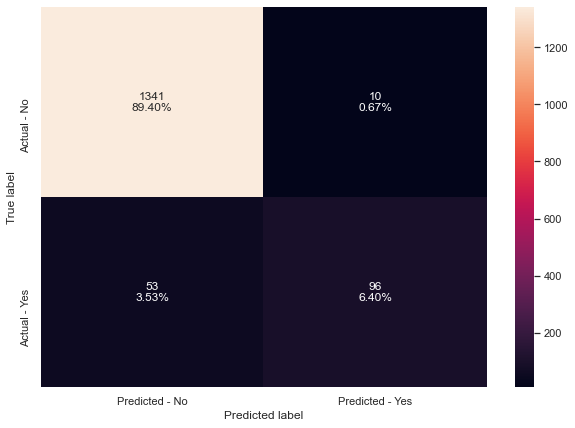

<IPython.core.display.Javascript object>

In [142]:
# Let's check model performances for this model
scores_LR = get_metrics_score(lg3, "stats", X_train3, X_test3, y_train, y_test)

# confusion matrix
make_confusion_matrix(lg3, "stats", X_test3, y_test)

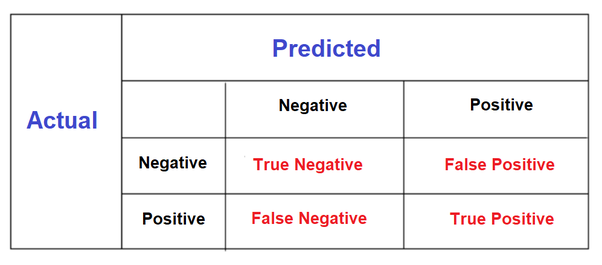

**Observations**

* Recall: is good at ~64% on test data.

* Fit is very good and not diverging much on train to test.

* Accuracy is very high and good Precision as well.

**Matrix**

TP: 6%

TN: 89%

FP: 0.67%

FN: 3.5% - Our False Negatives are very low. We could adjust to offset some to the False Positives with more tuning.

#### Model Performance Improvement

Accuracy, Precision and f1 score look reasonably good. Let's check what the scores would be after tuning the threshold.

#### AUC-ROC Threshold Tuning

 Improving recall using this curve calculation which gives a new threshold on the statsmodel version.

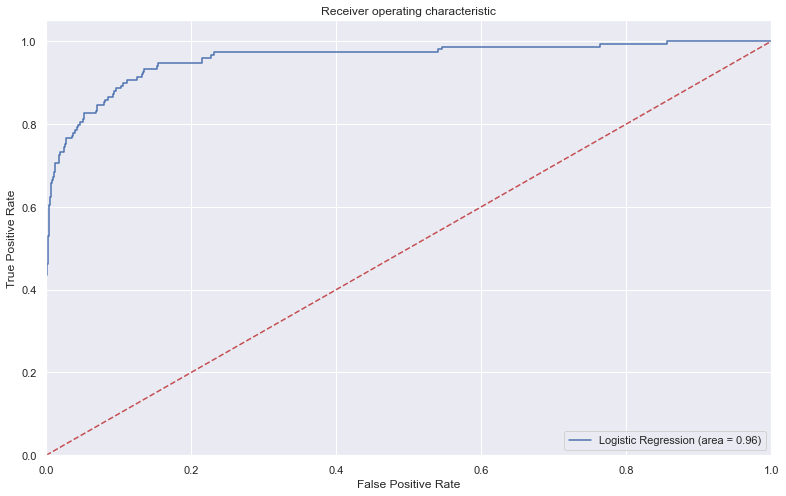

<IPython.core.display.Javascript object>

In [145]:
# AUC ROC curve plot
logit_roc_auc = roc_auc_score(y_test, lg3.predict(X_test3))
fpr, tpr, thresholds = roc_curve(y_test, lg3.predict(X_test3))
plt.figure(figsize=(13, 8))
plt.plot(fpr, tpr, label="Logistic Regression (area = %0.2f)" % logit_roc_auc)
plt.plot([0, 1], [0, 1], "r--")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Receiver operating characteristic")
plt.legend(loc="lower right")
plt.savefig("Log_ROC")
plt.show()

In [123]:
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve

# Optimal threshold as per AUC-ROC curve
# The optimal cut off would be where tpr is high and fpr is low
fpr, tpr, thresholds = roc_curve(y_test, lg3.predict(X_test3))

optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]
print(optimal_threshold)

0.0529578647447472


<IPython.core.display.Javascript object>

Optimal threshold is .053.

##### Model prediction with optimal threshold

In [124]:
# Model prediction
pred_train_opt = (lg3.predict(X_train3) > optimal_threshold).astype(int)
pred_test_opt = (lg3.predict(X_test3) > optimal_threshold).astype(int)

<IPython.core.display.Javascript object>

In [125]:
# print the train and test scores

print("Accuracy on train data:", accuracy_score(y_train, pred_train_opt))
print("Accuracy on test data:", accuracy_score(y_test, pred_test_opt))

print("Recall on train data:", recall_score(y_train, pred_train_opt))
print("Recall on test data:", recall_score(y_test, pred_test_opt))

print("Precision on train data:", precision_score(y_train, pred_train_opt))
print("Precision on test data:", precision_score(y_test, pred_test_opt))

print("f1 score on train data:", f1_score(y_train, pred_train_opt))
print("f1 score on test data:", f1_score(y_test, pred_test_opt))

Accuracy on train data: 0.8634285714285714
Accuracy on test data: 0.8713333333333333
Recall on train data: 0.9214501510574018
Recall on test data: 0.9261744966442953
Precision on train data: 0.40290620871862615
Precision on test data: 0.43125
f1 score on train data: 0.5606617647058824
f1 score on test data: 0.5884861407249466


<IPython.core.display.Javascript object>

##### Model performance with optimal threhold

Recall improved dramatically with .56 threshold. 

####  Precision-Recall curve

Precision tells us "from all the classes we have predicted as positive, how many are actually positive." Use this to find better threshold.

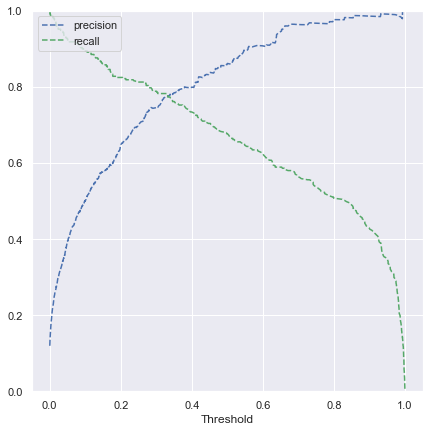

<IPython.core.display.Javascript object>

In [126]:
from sklearn.metrics import precision_recall_curve

y_scores = lg3.predict(X_train3)
prec, rec, tre = precision_recall_curve(y_train, y_scores,)


def plot_prec_recall_vs_tresh(precisions, recalls, thresholds):
    plt.plot(thresholds, precisions[:-1], "b--", label="precision")
    plt.plot(thresholds, recalls[:-1], "g--", label="recall")
    plt.xlabel("Threshold")
    plt.legend(loc="upper left")
    plt.ylim([0, 1])


plot_prec_recall_vs_tresh(prec, rec, tre)
plt.show()

Decreasing threshold beyond ~0.35 will lead to fast decrease in Precision, which will lead to great loss of opportunity, so let's consider threshold of 0.35.

In [154]:
optimal_threshold_pr = 0.35

# Model prediction with optimal threshold
pred_train_opt_pr = (lg3.predict(X_train3) > optimal_threshold_pr).astype(int)
pred_test_opt_pr = (lg3.predict(X_test3) > optimal_threshold_pr).astype(int)

# Model performance with optimal threhold

print("Accuracy on train data:", accuracy_score(y_train, pred_train_opt_pr))
print("Accuracy on test data:", accuracy_score(y_test, pred_test_opt_pr))

print("Recall on train data:", recall_score(y_train, pred_train_opt_pr))
print("Recall on test data:", recall_score(y_test, pred_test_opt_pr))

print("Precision on train data:", precision_score(y_train, pred_train_opt_pr))
print("Precision on test data:", precision_score(y_test, pred_test_opt_pr))

print("f1 score on train data:", f1_score(y_train, pred_train_opt_pr))
print("f1 score on test data:", f1_score(y_test, pred_test_opt_pr))

Accuracy on train data: 0.9577142857142857
Accuracy on test data: 0.9553333333333334
Recall on train data: 0.7613293051359517
Recall on test data: 0.7114093959731543
Precision on train data: 0.7850467289719626
Precision on test data: 0.8153846153846154
f1 score on train data: 0.773006134969325
f1 score on test data: 0.7598566308243728


<IPython.core.display.Javascript object>

 The previous model was better in terms of recall metrics although precision and accurrary increased using Precision-Recall curve. Let's chose the optimal threshold to best suit Recall using AUC-ROC curve.

#### Confusion Matrix

**Matrix using AUC-ROC tuned model**

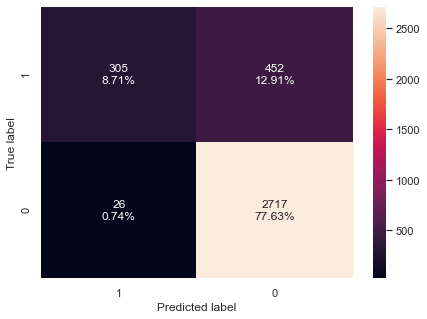

<IPython.core.display.Javascript object>

In [151]:
# let us make confusion matrix on train set
make_confusion_matrix_small(y_train, pred_train_opt)

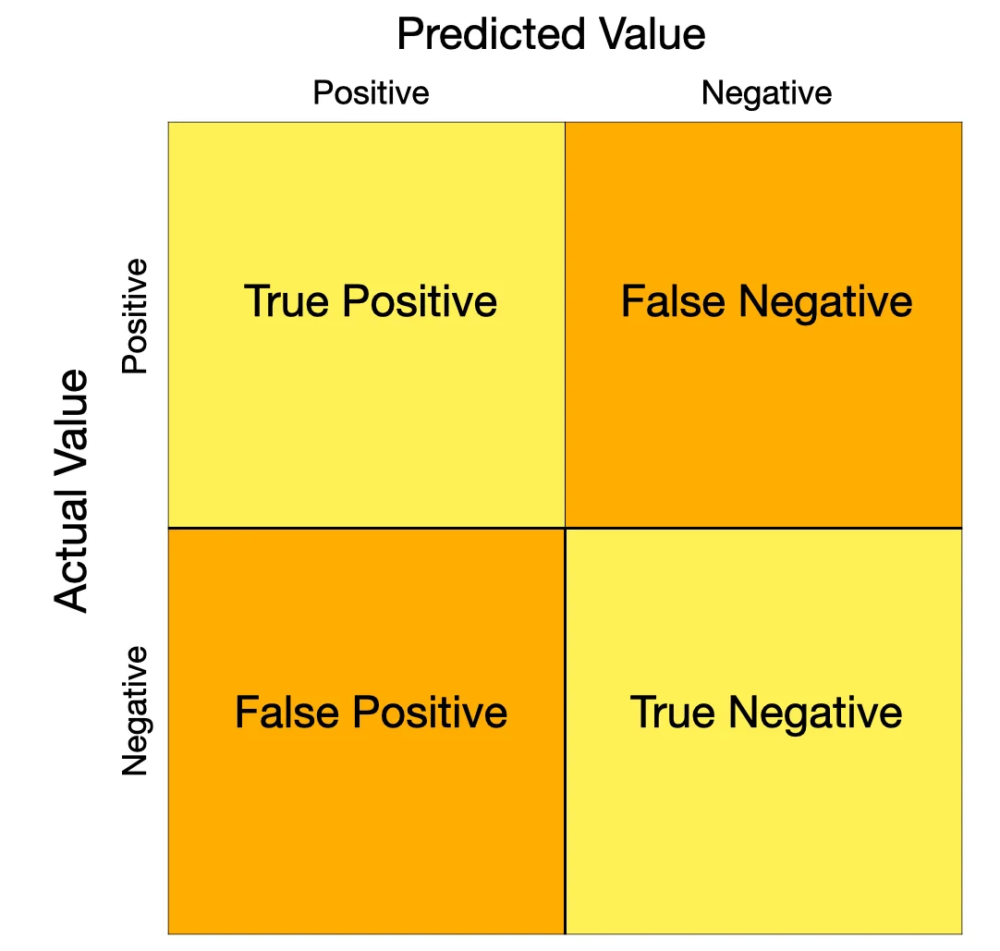

Don't optimize Recall at the price of Precision (too many False Positives). Our False Negatives rate has increased from before.

##### Confusion Matrix observations:

- **True Positives:** A customer who does have a loan is predicted to have a loan.
    - Reality: A liability customer accepted the loan offer and is an asset customer. (1)
    - Model predicted: The liability customer will accept the loan offer and convert to an asset customer (0 to 1).
    - Outcome: The model is good. Put money towards targeting these liability customers. 305 or ~8%.

- **True Negatives:** A customer who does NOT have a loan is predicted NOT to have a loan.
    - Reality: A liability customer did NOT accepted the loan offer. (0)
    - Model predicted: The liability customer will NOT accept the loan offer of the future campaign and not convert to an asset customer (0 to 0).
    - Outcome: The business is unaffected. 2717 or ~77%.

- **False Positives:**  A customer who does NOT have a loan is predicted to have a loan.
    - Reality: A liability customer did NOT accepted the loan offer. (0)
    - Model predicted: The liability customer will accepted the loan offer and convert to an asset customer. (0 to 1).
    - Outcome: The money spent in ad-dollars went to a liability customer who has the potential to be an asset customer given another campaign targeted toward their profile (feature set). As the result, the bank gained a new asset customer and increased the interest returns. = increased success ratio: 26 or .7%.

- **False Negatives:** A customer who does have a loan is predicted to NOT have a loan.
    - Reality: A liability customer did accepted the loan offer and is an asset customer (success). (1)
    - Model predicted: The asset customer will NOT accept the loan offer (become a second-time borrower). (1 to 0).
    - Outcome: The marketing team is targeting the asset customers who already purchased a loan after the last campaign (loan offer) and will be waste valuable time, money, and resources in doing so because doing so does not gain a new customer (success as measured in conversion) but create a new class of customer. = second-time borrower: 452 or ~12%.

#### Coefficient Interpretation

A look at our lg4 model to get performance measures.

In [155]:
print(lg3.summary2())

                             Results: Logit
Model:                 Logit              Pseudo R-squared:   0.634      
Dependent Variable:    Personal_Loan      AIC:                819.2632   
Date:                  2021-08-20 08:47   BIC:                874.7078   
No. Observations:      3500               Log-Likelihood:     -400.63    
Df Model:              8                  LL-Null:            -1095.5    
Df Residuals:          3491               LLR p-value:        9.7483e-295
Converged:             1.0000             Scale:              1.0000     
No. Iterations:        9.0000                                            
-------------------------------------------------------------------------
                         Coef.  Std.Err.    z     P>|z|   [0.025   0.975]
-------------------------------------------------------------------------
const                   -9.1713   0.5266 -17.4144 0.0000 -10.2035 -8.1391
Income                   0.0593   0.0035  16.7407 0.0000   0.0523  0

<IPython.core.display.Javascript object>

"The estimated coefficients are the log odds. By exponentiating these values, we can calculate the odds, which are easier to interpret."<a href="https://www.juanshishido.com/logisticcoefficients.html">link</a>

Positive impact on loan acceptance (2 largest):

 * `Family` and `CD_Account`: for every 1 unit increase in `CD_Account`, so openning a CD account, the likelihood of converting to an asset customer increases the log odds of loan purchases by 3.84% or almost 4x. Having another family member increases the log odds of loan purchase by .64% or nearly 1x.
 
 * Said in different way, the log-odds of a customer purchasing a loan increases by 3.8 for each unit of `CD_Account`, .64 for each unit of `Family`.
    
Negative impact on loan acceptance (2 largest): 

* Increase in these will lead to decrease in chances of not having a loan. `Education_Undergraduate`, `Securities_Account`: for every increase in `Education_Undergraduate`, the chance of purchasing a personal loan will decrease by 3.94 times, holding all else constant.

* Said in a different way, the log-odds of a customer purchasing a loan decreases by 3.9, or almost 4x, if the customer has an undergraduate degree, and by 1.14 times if they have a `Securities Account`.

### Logistic Model Conclusion

In [160]:
log_reg_metrics = pd.read_csv("log_reg_metrics.csv")
log_reg_metrics

,Metrics,Logitic Regression (sklearn),Logitic Regression (statsmodel),Logitic Regression (statsmodel - AUC/ROC tuned),Logitic Regression (statsmodel - Pre/Rec tuned)
0,Accuracy on training set,0.96,0.96,0.86,0.96
1,Accuracy on test set,0.96,0.96,0.87,0.96
2,Recall on training set,0.65,0.68,0.92,0.76
3,Recall on test set,0.63,0.64,0.93,0.71
4,Precision on training set,0.88,0.86,0.40,0.79
5,Precision on test set,0.90,0.91,0.43,0.82
6,F1 on training set,0.75,0.76,0.56,0.77
7,F1 on test set,0.74,0.75,0.59,0.76


<IPython.core.display.Javascript object>

- The best test recall is 92% but the test precision is quite low at ~43%. This means that the model is not good at identifying loan offer accepters, therefore, bank can lose many opportunities of targeting ads to non-loan accepters.

- The statsmodel pre-tuned model did produced the desired risk-avoidance threshold: reducing the number of False Negatives (targeting non-loan accepters from the last campaign) to a very low degree, 3.5%. It is the most balanced model even while it is overfitting the data.

- The model performance can be improved, especially in terms of precision and the bank can use use the model for new customers once desired level of model performance is achieved.

- The goodness of the fit of the model using McFadden's R-squared is 0.63.. Higher would be better but this is acceptable. (https://investigate.ai/regression/evaluating-logistic-regressions/)

## Decision Tree Model

Splits are chosen at random so we can find a new tree for every iteration. They are immune to correlation problems.

In [161]:
# Features
X = df.drop("Personal_Loan", axis=1)
# Labels (Target Variable)
y = df["Personal_Loan"]
# df['Personal_Loan'].astype('int64')
# converting target to integers - since some functions might not work with bool type

<IPython.core.display.Javascript object>

In [162]:
# Splitting data into training and test set using 70/30:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)
print(X_train.shape, X_test.shape)

(3500, 18) (1500, 18)


<IPython.core.display.Javascript object>

In [163]:
print("{0:0.2f}% data is in training set".format((len(X_train) / len(df.index)) * 100))
print("{0:0.2f}% data is in test set".format((len(X_test) / len(df.index)) * 100))

70.00% data is in training set
30.00% data is in test set


<IPython.core.display.Javascript object>

Let's view counts of the `Personal_Loan` dependent variable.

In [164]:
# counts as percentage
y_train.value_counts() / len(y_train) * 100

0   90.54
1    9.46
Name: Personal_Loan, dtype: float64

<IPython.core.display.Javascript object>

### CART Model Decision Tree

We will build our model using the DecisionTreeClassifier function. Using default 'gini' criteria to split. 


In [165]:
# counts
y.value_counts()

0    4520
1     480
Name: Personal_Loan, dtype: int64

<IPython.core.display.Javascript object>

In [169]:
# build a decision tree classifier object
dtmodel = DecisionTreeClassifier(criterion="gini", random_state=1)
dtmodel.fit(X_train, y_train)

DecisionTreeClassifier(random_state=1)

<IPython.core.display.Javascript object>

In [170]:
# get the range of the len of the array 1 - 9
range(len(np.arange(1, 14)))

range(0, 13)

<IPython.core.display.Javascript object>

#### Scoring our Decision Tree

In [265]:
get_metrics_score(model, "sklearn", X_train, X_test, y_train, y_test)

Accuracy on training set :  1.0
Accuracy on test set :  0.9813333333333333
Recall on training set :  1.0
Recall on test set :  0.8926174496644296
Precision on training set :  1.0
Precision on test set :  0.9172413793103448
F1 on training set :  1.0
F1 on test set :  0.9047619047619048


[1.0,
 0.9813333333333333,
 1.0,
 0.8926174496644296,
 1.0,
 0.9172413793103448,
 1.0,
 0.9047619047619048]

<IPython.core.display.Javascript object>

- Accuracy: From all the classes (positive and negative), how many of them we have predicted correctly. Accuracy should be high as possible. Accuracy on the test set is nearly 100%.

- Recall or Sensitivity is very high on the test set which is good but could be from over-fitting. There is a 11% disparity in performance of model on training set and test set, which suggests that the model is not especially overfiiting.

Let's look at the confusion matrix to get a sense of the False Negatives.

##### Confusion Matrix

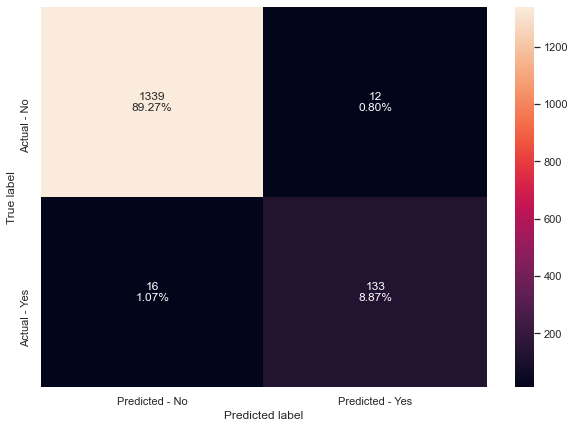

<IPython.core.display.Javascript object>

In [177]:
make_confusion_matrix_dt(model, y_test)

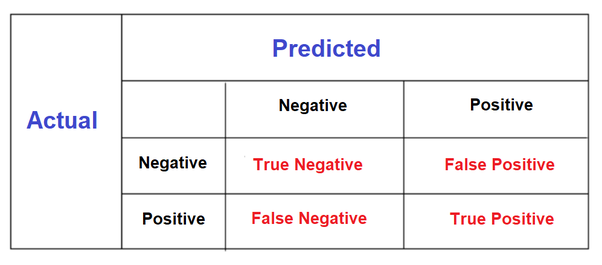

The confusion matrix:

True Positives (TP): we correctly predicted that they do accept the offered loan: 133.

True Negatives (TN): we correctly predicted that they don't accept the offered 1339.

False Positives (FP): we incorrectly predicted that they do accept the offered (a "Type I error") 12. Falsely predict positive Type I error

False Negatives (FN): we incorrectly predicted that they don't accept the offered (a "Type II error") 16. Falsely predict negative Type II error

This model has a low score of False Negatives which is a good sign.

In [178]:
y_train.value_counts(1)

0   0.91
1   0.09
Name: Personal_Loan, dtype: float64

<IPython.core.display.Javascript object>

We only have 9% of positive classes, so if our model marks each sample as negative, then also we'll get 91% accuracy.

<AxesSubplot:>

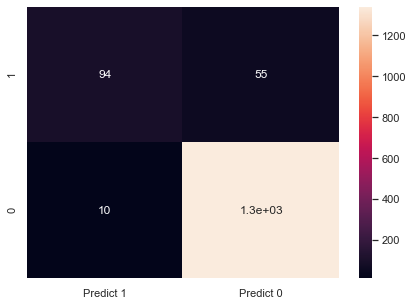

<IPython.core.display.Javascript object>

In [179]:
cm = metrics.confusion_matrix(y_test, y_predict, labels=[1, 0])

df_cm = pd.DataFrame(
    cm, index=[i for i in ["1", "0"]], columns=[i for i in ["Predict 1", "Predict 0"]]
)
plt.figure(figsize=(7, 5))
sns.heatmap(df_cm, annot=True)

The confusion matrix

True Positives (TP): we correctly predicted that they do accept the offered loan: 94.

True Negatives (TN): we correctly predicted that they don't accept the offered 1300.

False Positives (FP): we incorrectly predicted that they do accept the offered (a "Type I error") 55. Falsely predict positive Type I error

False Negatives (FN): we incorrectly predicted that they don't accept the offered (a "Type II error") 10. Falsely predict negative Type II error

This model has a low score of False Negatives which is a good sign.

#### Visualizing the Decision Tree

In [180]:
column_names = list(df.columns)
feature_names = column_names
print(feature_names)

['Age', 'Experience', 'Income', 'Family', 'CCAvg', 'Mortgage', 'Personal_Loan', 'Securities_Account', 'CD_Account', 'Online', 'CreditCard', 'ZIPCode_91', 'ZIPCode_92', 'ZIPCode_93', 'ZIPCode_94', 'ZIPCode_95', 'ZIPCode_96', 'Education_Professional', 'Education_Undergraduate']


<IPython.core.display.Javascript object>

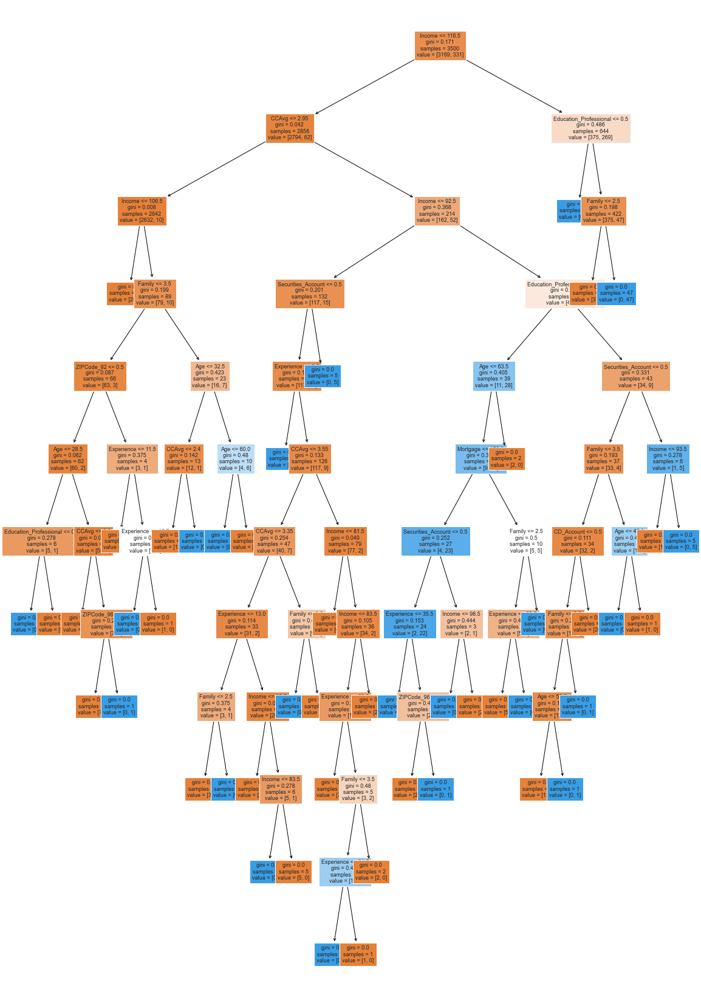

<IPython.core.display.Javascript object>

In [181]:
plt.figure(figsize=(20, 30))
out = tree.plot_tree(
    dtmodel,
    feature_names=feature_names,
    filled=True,
    fontsize=9,
    node_ids=False,
    class_names=None,
)
# below code will add arrows to the decision tree split if they are missing
for o in out:
    arrow = o.arrow_patch
    if arrow is not None:
        arrow.set_edgecolor("black")
        arrow.set_linewidth(1)
plt.show()

Our decision tree model is nested 10+ levels deep which is too deep for business interpretation.

#### Gini Importance

Multicolinearity is not important here. So `Age` and `Experience` relationship isn't important but what is the purity of each node.

In [186]:
# importance of features in the tree building ( The importance of a feature is computed as the
# (normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance )

print(
    pd.DataFrame(
        dtmodel.feature_importances_, columns=["Imp"], index=X_train.columns
    ).sort_values(by="Imp", ascending=False)
)

                         Imp
Education_Undergraduate 0.40
Income                  0.31
Family                  0.17
CCAvg                   0.05
CD_Account              0.03
Age                     0.02
Experience              0.02
Education_Professional  0.01
Mortgage                0.00
ZIPCode_93              0.00
Online                  0.00
Securities_Account      0.00
ZIPCode_91              0.00
ZIPCode_92              0.00
ZIPCode_94              0.00
ZIPCode_95              0.00
ZIPCode_96              0.00
CreditCard              0.00


<IPython.core.display.Javascript object>

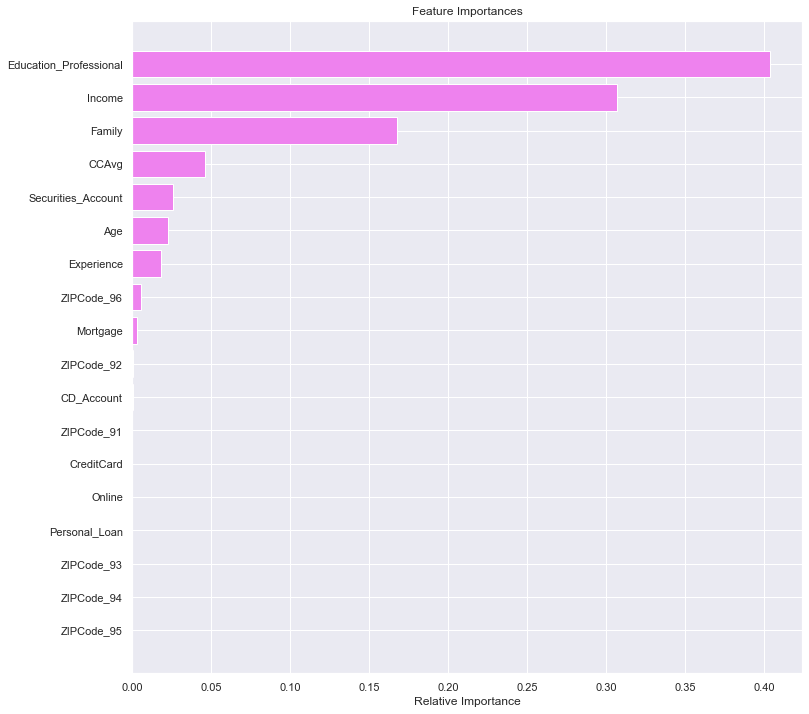

<IPython.core.display.Javascript object>

In [189]:
# visualize importance feautures
importances = dtmodel.feature_importances_
indices = np.argsort(importances)

# plot the important features
plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

* According to the decision tree model, `Education_Professional` is the most important variable for predicting the `Personal_Loan` target variable.

### Regularization: Pre-Pruned Decision Tree

##### GreatLearning notes:
* In general, the deeper you allow your tree to grow, the more complex your model will become because you will have more splits and it captures more information about the data and this is one of the root causes of overfitting.
* The tree above is very complex and difficult to interpret. We need to reduce it's size and complexity. Let's try another method listed below.

#### Max Depth Pruning

We will pre-prune the Decision Tree using the max_depth attribute of the Classifier object.

In [190]:
# create a for-loop that builds a tree with a max_depth for every unit in the range
count = 0

for i in np.arange(1, 25):
    Tree_i = DecisionTreeClassifier(max_depth=i, criterion="gini", random_state=1)

    # display the Tree object
    display(Tree_i.fit(X_train, y_train))

    # display the recall score for that Tree oject
    display(get_recall_score(Tree_i))

    count = count + 1

DecisionTreeClassifier(max_depth=1, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=2, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=3, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=4, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=5, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=6, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=7, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=8, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=9, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=10, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=11, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=12, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=13, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=14, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=15, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=16, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=17, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=18, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=19, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=20, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=21, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=22, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=23, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

DecisionTreeClassifier(max_depth=24, random_state=1)

Recall on training set :  1.0
Recall on test set :  0.8926174496644296


None

<IPython.core.display.Javascript object>

The Decision Tree recall is highest at a max depth of 1 levels. Let's use that to score our Tree.

In [191]:
# build a decision tree classifier object with max_depth
Tree10 = DecisionTreeClassifier(max_depth=1, criterion="gini", random_state=1)
Tree10.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=1, random_state=1)

<IPython.core.display.Javascript object>

##### Confusion Matrix

Accuracy on training set :  0.9054285714285715
Accuracy on test set :  0.9006666666666666
Recall on training set :  0.0
Recall on test set :  0.0
Precision on training set :  0.0
Precision on test set :  0.0
F1 on training set :  0.0
F1 on test set :  0.0


[0.9054285714285715, 0.9006666666666666, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

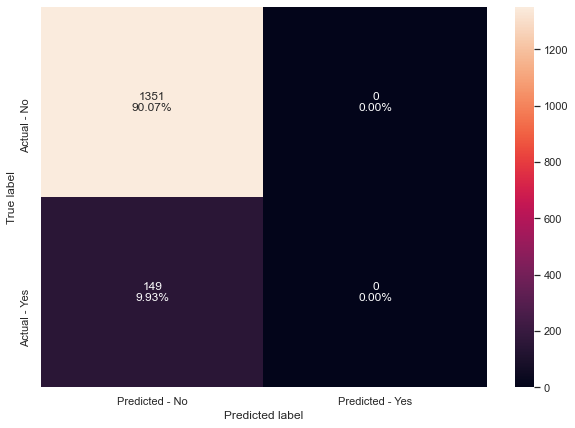

<IPython.core.display.Javascript object>

In [268]:
# print matrix function
make_confusion_matrix_dt(Tree10, y_test)

# metrics on train and test
get_metrics_score(Tree10, "sklearn", X_train, X_test, y_train, y_test)

##### Visualizing the Decision Tree

In [196]:
# create list of columns names from tree
feature_names = list(X.columns)
print(feature_names)

['Age', 'Experience', 'Income', 'Family', 'CCAvg', 'Mortgage', 'Securities_Account', 'CD_Account', 'Online', 'CreditCard', 'ZIPCode_91', 'ZIPCode_92', 'ZIPCode_93', 'ZIPCode_94', 'ZIPCode_95', 'ZIPCode_96', 'Education_Professional', 'Education_Undergraduate']


<IPython.core.display.Javascript object>

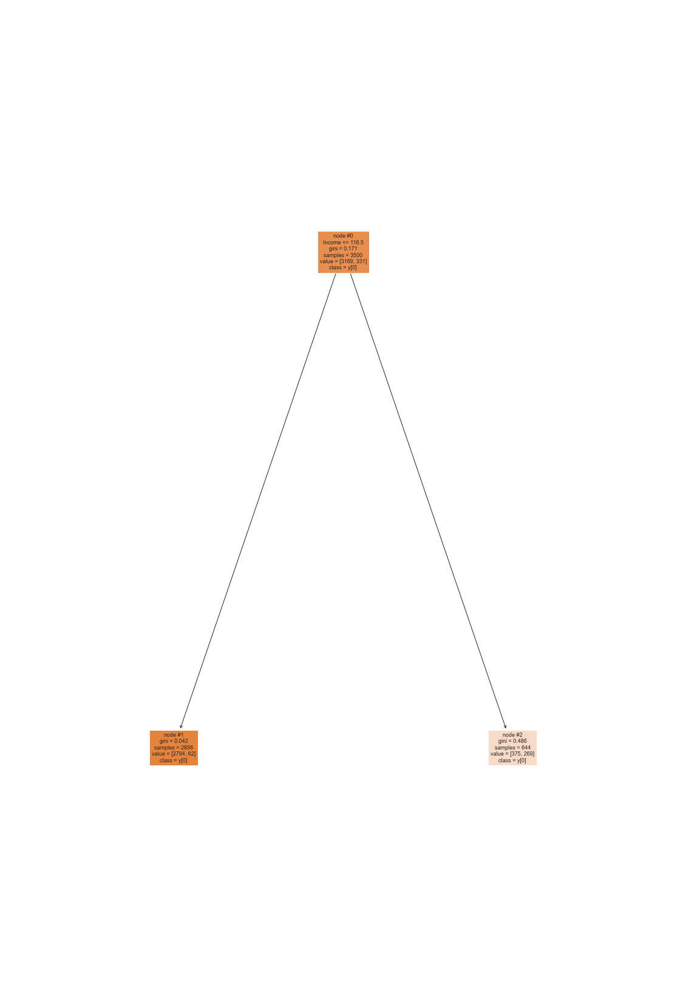

<IPython.core.display.Javascript object>

In [197]:
# plot tree
plt.figure(figsize=(20, 30))
tree.plot_tree(
    Tree10,
    feature_names=feature_names,
    filled=True,
    fontsize=9,
    node_ids=True,
    class_names=True,
)
plt.show()

##### Gini Importance

In [198]:
# importance of features in the tree building ( The importance of a feature is computed as the
# (normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance )

print(
    pd.DataFrame(
        Tree10.feature_importances_, columns=["Imp"], index=X_train.columns
    ).sort_values(by="Imp", ascending=False)
)

                         Imp
Income                  1.00
Age                     0.00
ZIPCode_91              0.00
Education_Professional  0.00
ZIPCode_96              0.00
ZIPCode_95              0.00
ZIPCode_94              0.00
ZIPCode_93              0.00
ZIPCode_92              0.00
CreditCard              0.00
Experience              0.00
Online                  0.00
CD_Account              0.00
Securities_Account      0.00
Mortgage                0.00
CCAvg                   0.00
Family                  0.00
Education_Undergraduate 0.00


<IPython.core.display.Javascript object>

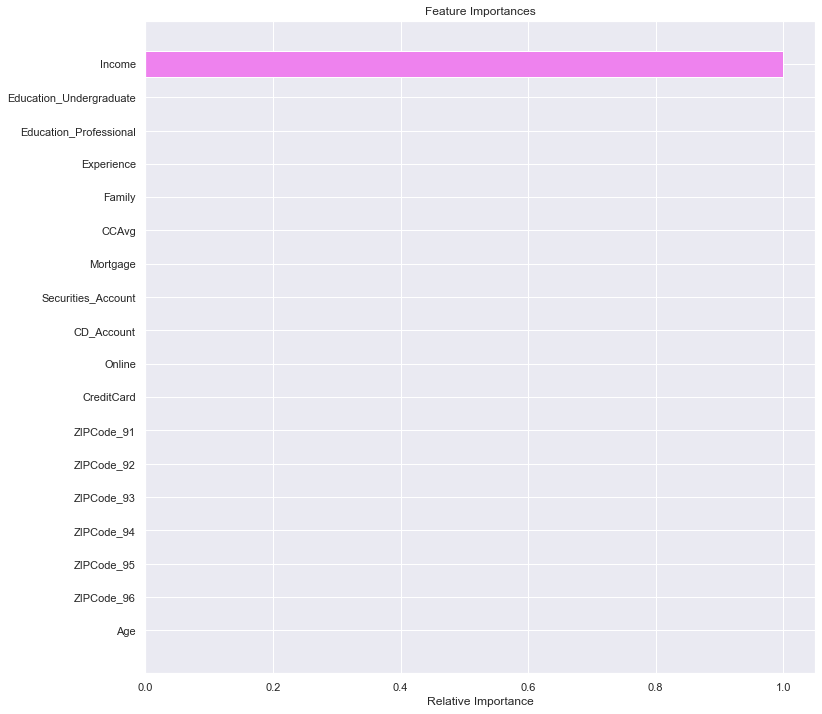

<IPython.core.display.Javascript object>

In [199]:
# list importance and plot
importances = Tree10.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

* Looking at this model we see that `Income` has the greatest relative importance for predicting whether or not a liability customer has a loan and convert to an asset customer.

* This model is too simplistic and suffers from under-fitting which makes it not usable for business purposes either.

Let's try another method.

#### Hyperparameter Tuning (GridSearchCV)

To increase accuracy. Complexity is ok if we have good accuracy.

##### GreatLearning notes:
* Hyperparameter tuning is also tricky in the sense that there is no direct way to calculate how a change in the
  hyperparameter value will reduce the loss of your model, so we usually resort to experimentation. i.e we'll use Grid search
* Grid search is a tuning technique that attempts to compute the optimum values of hyperparameters. 
* It is an exhaustive search that is performed on a the specific parameter values of a model.
* The parameters of the estimator/model used to apply these methods are optimized by cross-validated grid-search over a parameter grid.

* If the frequency of class A is 10% and the frequency of class B is 90%, then class B will become the dominant class and the decision tree will become biased toward the dominant classes.

* In this case, we can pass a dictionary {0:0.15,1:0.85} to the model to specify the weight of each class and the decision tree will give more weightage to class 1.

* class_weight is a hyperparameter for the decision tree classifier.

In [204]:
# Choose the type of classifier wtih class_weight
estimator = DecisionTreeClassifier(
    random_state=1, class_weight={0: 0.10, 1: 0.90}
)  # weight heavy on 1s as it is opposite in the original

# Grid of parameters to choose from
parameters = {
    "max_depth": np.arange(1, 13),
    "criterion": ["entropy", "gini"],
    "splitter": ["best", "random"],
    "min_impurity_decrease": [0.000001, 0.00001, 0.0001],
    "max_features": ["log2", "sqrt"],
    "max_leaf_nodes": [2, 4, 6, 8],  # alternative to do min. samples in  a leaf
}

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(estimator, parameters, scoring=scorer, cv=5, n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
estimator = grid_obj.best_estimator_

# Fit the best algorithm to the data.
estimator.fit(X_train, y_train)

DecisionTreeClassifier(class_weight={0: 0.1, 1: 0.9}, criterion='entropy',
                       max_depth=2, max_features='log2', max_leaf_nodes=4,
                       min_impurity_decrease=1e-06, random_state=1)

<IPython.core.display.Javascript object>

##### Confusion Matrix

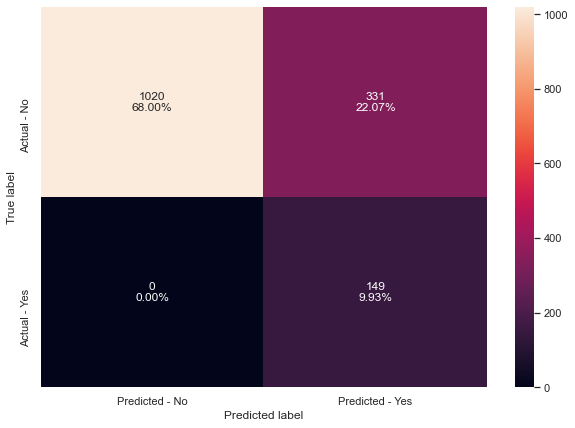

<IPython.core.display.Javascript object>

In [206]:
# show confusion matrix
make_confusion_matrix_dt(estimator, y_test)

Here we see:

    * A customer who does have a loan is predicted to have a loan. 149
    * A customer who does NOT have a loan is predicted NOT to have a loan. 1020
    * A customer who does NOT have a loan is predicted to have a loan. 331 FPs
    * A customer who does have a loan is predicted to NOT have a loan. 0 FNs

Targeting the existing asset customers by aiming at non-loan holders is reduced to <1% (False Negatives) which is good.

In [269]:
# metrics on train and test
get_metrics_score(estimator, "sklearn", X_train, X_test, y_train, y_test)

Accuracy on training set :  0.7902857142857143
Accuracy on test set :  0.7793333333333333
Recall on training set :  1.0
Recall on test set :  1.0
Precision on training set :  0.3107981220657277
Precision on test set :  0.3104166666666667
F1 on training set :  0.4742120343839542
F1 on test set :  0.47376788553259136


[0.7902857142857143,
 0.7793333333333333,
 1.0,
 1.0,
 0.3107981220657277,
 0.3104166666666667,
 0.4742120343839542,
 0.47376788553259136]

<IPython.core.display.Javascript object>

Recall is very high at 89% on the test. This is a good and is not really overfitting.

**Recall has improved for both train and test set after hyperparameter tuning and we have a generalized model.**

##### Visualizing the Decision Tree

In [208]:
column_names = list(df.columns)
feature_names = column_names
print(feature_names)

['Age', 'Experience', 'Income', 'Family', 'CCAvg', 'Mortgage', 'Personal_Loan', 'Securities_Account', 'CD_Account', 'Online', 'CreditCard', 'ZIPCode_91', 'ZIPCode_92', 'ZIPCode_93', 'ZIPCode_94', 'ZIPCode_95', 'ZIPCode_96', 'Education_Professional', 'Education_Undergraduate']


<IPython.core.display.Javascript object>

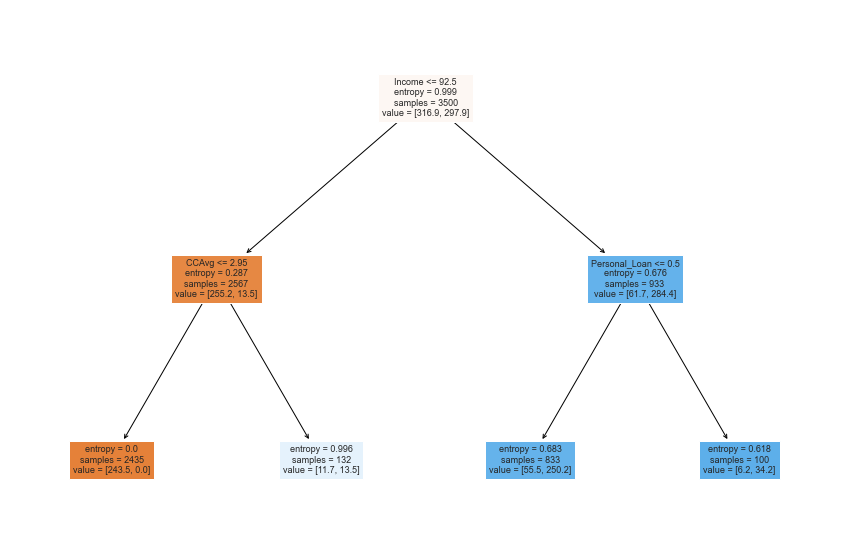

<IPython.core.display.Javascript object>

In [209]:
plt.figure(figsize=(15, 10))
out = tree.plot_tree(
    estimator,
    feature_names=feature_names,
    filled=True,
    fontsize=9,
    node_ids=False,
    class_names=None,
)
for o in out:
    arrow = o.arrow_patch
    if arrow is not None:
        arrow.set_edgecolor("black")
        arrow.set_linewidth(1)
plt.show()

* We are only getting a root node and two decision nodes which is to generalized, hyperparameter tuning didn't help our model.

##### Gini Importance

In [210]:
# importance of features in the tree building ( The importance of a feature is computed as the
# (normalized) total reduction of the 'criterion' brought by that feature. It is also known as the Gini importance )

print(
    pd.DataFrame(
        estimator.feature_importances_, columns=["Imp"], index=X_train.columns
    ).sort_values(by="Imp", ascending=False)
)

# Here we will see that importance of features has increased

                         Imp
Income                  0.85
CCAvg                   0.15
Securities_Account      0.00
Age                     0.00
ZIPCode_92              0.00
Education_Professional  0.00
ZIPCode_96              0.00
ZIPCode_95              0.00
ZIPCode_94              0.00
ZIPCode_93              0.00
CreditCard              0.00
ZIPCode_91              0.00
Experience              0.00
Online                  0.00
CD_Account              0.00
Mortgage                0.00
Family                  0.00
Education_Undergraduate 0.00


<IPython.core.display.Javascript object>

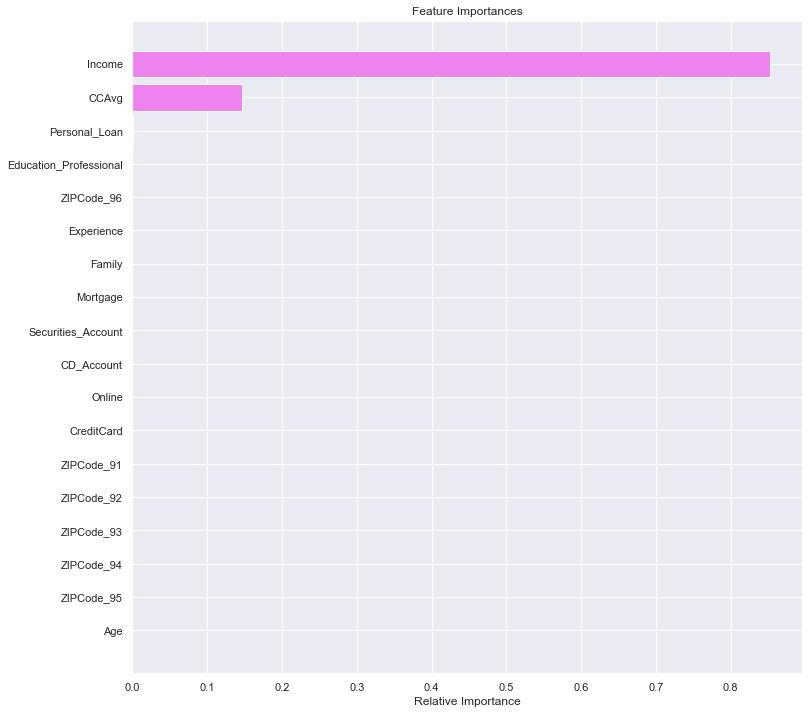

<IPython.core.display.Javascript object>

In [211]:
# visualize the features of importance
importances = estimator.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

### Post-Pruning Decision Trees

#### Cost Complexity Pruning

To punish complexity but sometimes at the cost of accuracy. We will have to sensitive to comparing the models in this way.


The `DecisionTreeClassifier` provides parameters such as
``min_samples_leaf`` and ``max_depth`` to prevent a tree from overfiting. Cost
complexity pruning provides another option to control the size of a tree. In
`DecisionTreeClassifier`, this pruning technique is parameterized by the
cost complexity parameter, ``ccp_alpha``. Greater values of ``ccp_alpha``
increase the number of nodes pruned. Here we only show the effect of
``ccp_alpha`` on regularizing the trees and how to choose a ``ccp_alpha``
based on validation scores.

##### GreatLearning Notes:
Total impurity of leaves vs effective alphas of pruned tree

Minimal cost complexity pruning recursively finds the node with the "weakest
link". The weakest link is characterized by an effective alpha, where the
nodes with the smallest effective alpha are pruned first. To get an idea of
what values of ``ccp_alpha`` could be appropriate, scikit-learn provides
`DecisionTreeClassifier.cost_complexity_pruning_path` that returns the
effective alphas and the corresponding total leaf impurities at each step of
the pruning process. As alpha increases, more of the tree is pruned, which
increases the total impurity of its leaves.

In [212]:
# create a decision tree object with weighted classes
clf = DecisionTreeClassifier(random_state=1, class_weight={0: 0.10, 1: 0.90})

# run scikit learn pruning method
path = clf.cost_complexity_pruning_path(X_train, y_train)

# set alphas and impurities
ccp_alphas, impurities = path.ccp_alphas, path.impurities

<IPython.core.display.Javascript object>

In [213]:
# create a dataframe of the alphas and impurities
pd.DataFrame(path)

,ccp_alphas,impurities
0,0.00,-0.00
1,0.00,-0.00
2,0.00,-0.00
3,0.00,-0.00
4,0.00,-0.00
5,0.00,-0.00
6,0.00,-0.00
7,0.00,-0.00
8,0.00,-0.00
9,0.00,-0.00


<IPython.core.display.Javascript object>

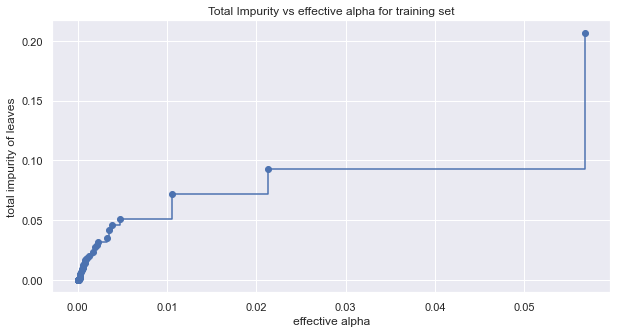

<IPython.core.display.Javascript object>

In [214]:
# plot the alphas and impurities path
fig, ax = plt.subplots(figsize=(10, 5))
ax.plot(ccp_alphas[:-1], impurities[:-1], marker="o", drawstyle="steps-post")
ax.set_xlabel("effective alpha")
ax.set_ylabel("total impurity of leaves")
ax.set_title("Total Impurity vs effective alpha for training set")
plt.show()

Next, we train a decision tree using the effective alphas. The last value
in ``ccp_alphas`` is the alpha value that prunes the whole tree,
leaving the tree, ``clfs[-1]``, with one node.

In [225]:
# make an empty list
clfs = []

# for all the alphas create a decision tree object and fit the model
for ccp_alpha in ccp_alphas:
    clf = DecisionTreeClassifier(
        random_state=1, ccp_alpha=ccp_alpha, class_weight={0: 0.10, 1: 0.90}
    )
    clf.fit(X_train, y_train)
    clfs.append(clf)

# print the node count and alphas
print(
    "Number of nodes in the last tree is: {} with ccp_alpha: {}".format(
        clfs[-1].tree_.node_count, ccp_alphas[-1]
    )
)

Number of nodes in the last tree is: 3 with ccp_alpha: 0.056788929814883274


<IPython.core.display.Javascript object>


For the remainder, we remove the last element in
``clfs`` and ``ccp_alphas``, because it is the trivial tree with only one
node. Here we show that the number of nodes and tree depth decreases as alpha
increases.

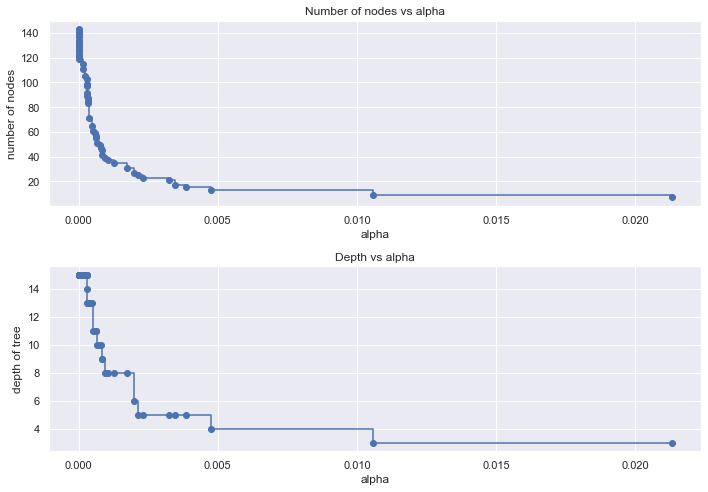

<IPython.core.display.Javascript object>

In [226]:
# set the list of clfs and alphas
clfs = clfs[:-1]
ccp_alphas = ccp_alphas[:-1]

# make a list of nodes
node_counts = [clf.tree_.node_count for clf in clfs]
depth = [clf.tree_.max_depth for clf in clfs]

# plot the depth of nodes and alphas
fig, ax = plt.subplots(2, 1, figsize=(10, 7))
ax[0].plot(ccp_alphas, node_counts, marker="o", drawstyle="steps-post")
ax[0].set_xlabel("alpha")
ax[0].set_ylabel("number of nodes")
ax[0].set_title("Number of nodes vs alpha")
ax[1].plot(ccp_alphas, depth, marker="o", drawstyle="steps-post")
ax[1].set_xlabel("alpha")
ax[1].set_ylabel("depth of tree")
ax[1].set_title("Depth vs alpha")
fig.tight_layout()

#### Accuracy vs alpha

##### GreatLearning Notes:
When ``ccp_alpha`` is set to zero and keeping the other default parameters
of `DecisionTreeClassifier`, the tree overfits. As alpha increases, more
of the tree is pruned, thus creating a decision tree that generalizes better.

In [227]:
# running scoring method on every object in clfs list
train_scores = [clf.score(X_train, y_train) for clf in clfs]
test_scores = [clf.score(X_test, y_test) for clf in clfs]

<IPython.core.display.Javascript object>

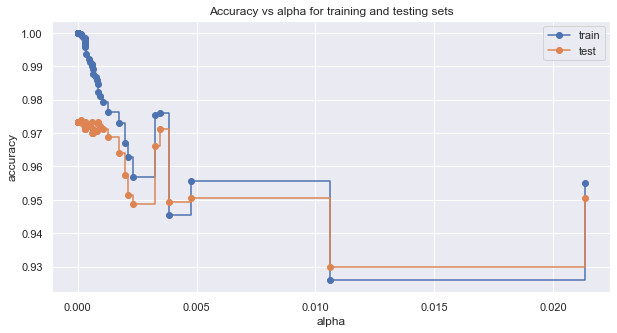

<IPython.core.display.Javascript object>

In [228]:
fig, ax = plt.subplots(figsize=(10, 5))
ax.set_xlabel("alpha")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs alpha for training and testing sets")
ax.plot(ccp_alphas, train_scores, marker="o", label="train", drawstyle="steps-post")
ax.plot(ccp_alphas, test_scores, marker="o", label="test", drawstyle="steps-post")
ax.legend()
plt.show()

In [229]:
index_best_model = np.argmax(test_scores)
best_model = clfs[index_best_model]
print(best_model)
print("Training accuracy of best model: ", best_model.score(X_train, y_train))
print("Test accuracy of best model: ", best_model.score(X_test, y_test))

DecisionTreeClassifier(ccp_alpha=0.00015825845363905665,
                       class_weight={0: 0.1, 1: 0.9}, random_state=1)
Training accuracy of best model:  0.9997142857142857
Test accuracy of best model:  0.974


<IPython.core.display.Javascript object>

#### Recall vs alpha

##### Training set

In [230]:
# create a list of predicted values and recall scores
recall_train = []
for clf in clfs:
    pred_train3 = clf.predict(X_train)
    values_train = metrics.recall_score(y_train, pred_train3)
    recall_train.append(values_train)

<IPython.core.display.Javascript object>

##### Test set

In [231]:
# create a list of predicted values and recall scores
recall_test = []
for clf in clfs:
    pred_test3 = clf.predict(X_test)
    values_test = metrics.recall_score(y_test, pred_test3)
    recall_test.append(values_test)

display(y_test)

2764    0
4767    0
3814    0
3499    0
2735    0
       ..
4140    0
3969    0
2535    0
1361    0
1458    0
Name: Personal_Loan, Length: 1500, dtype: int64

<IPython.core.display.Javascript object>

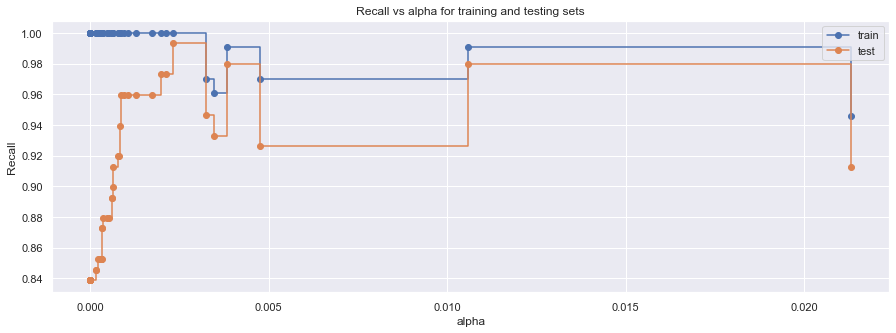

Training recall of best model:  0.9997142857142857
Test recall of best model:  0.974


<IPython.core.display.Javascript object>

In [232]:
# plot
fig, ax = plt.subplots(figsize=(15, 5))  # set-up plot
ax.set_xlabel("alpha")
ax.set_ylabel("Recall")
ax.set_title("Recall vs alpha for training and testing sets")

# plot the alphas vs recall
ax.plot(
    ccp_alphas, recall_train, marker="o", label="train", drawstyle="steps-post",
)
ax.plot(ccp_alphas, recall_test, marker="o", label="test", drawstyle="steps-post")
ax.legend()
plt.show()

print("Training recall of best model: ", best_model.score(X_train, y_train))
print("Test recall of best model: ", best_model.score(X_test, y_test))

**Maximum value of Recall is at ~0.002 alpha, but if we choose decision tree will only have a root node and we would lose the business rules, instead we could choose alpha 0.003 retaining information and getting high recall.**

#### Best Model #1

In [233]:
# creating the model where we get highest train and test recall
index_best_model = np.argmax(recall_test)
best_model = clfs[index_best_model]
print(best_model)

DecisionTreeClassifier(ccp_alpha=0.002328917016620172,
                       class_weight={0: 0.1, 1: 0.9}, random_state=1)


<IPython.core.display.Javascript object>

Using alpha 0.002.

In [234]:
# fit model to training data
best_model.fit(X_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.002328917016620172,
                       class_weight={0: 0.1, 1: 0.9}, random_state=1)

<IPython.core.display.Javascript object>

In [235]:
# Let's Look at Model Performance by doing predicitions

# training set
y_predb = best_model.predict(X_train)
pred_train = list(map(round, y_pred))

# test set
y_predb1 = best_model.predict(X_test)
pred_test = list(map(round, y_pred1))

<IPython.core.display.Javascript object>

##### Confusion Matrix

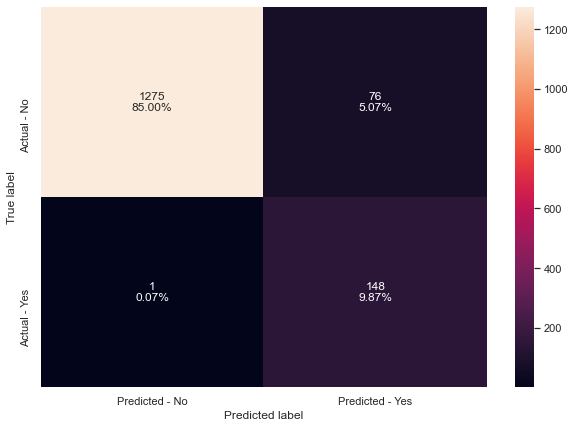

<IPython.core.display.Javascript object>

In [236]:
make_confusion_matrix_dt(best_model, y_test)

The confusion matrix

True Positives (TP): we correctly predicted that they do accept the offered loan: 148.

True Negatives (TN): we correctly predicted that they don't accept the offer. 1275.

False Positives (FP): we incorrectly predicted that they do accept the offered (a "Type I error") 76. Falsely predict positive Type I error

False Negatives (FN): we incorrectly predicted that they don't accept the offered (a "Type II error") 1. Falsely predict negative Type II error

This model has a low score of False Negatives which is a good sign.

##### Train and Test Performance

In [240]:
# print score results

print("Accuracy on train data:", accuracy_score(y_train, y_predb))
print("Accuracy on test data:", accuracy_score(y_test, y_predb1))

print("Recall on train data:", recall_score(y_train, y_predb))
print("Recall on test data:", recall_score(y_test, y_predb1))

print("Precision on train data:", precision_score(y_train, y_predb))
print("Precision on test data:", precision_score(y_test, y_predb1))

print("f1 score on train data:", f1_score(y_train, y_predb))
print("f1 score on test data:", f1_score(y_test, y_predb1))

Accuracy on train data: 0.9568571428571429
Accuracy on test data: 0.9486666666666667
Recall on train data: 1.0
Recall on test data: 0.9932885906040269
Precision on train data: 0.6867219917012448
Precision on test data: 0.6607142857142857
f1 score on train data: 0.8142681426814268
f1 score on test data: 0.7935656836461127


<IPython.core.display.Javascript object>

In [239]:
# print metrics for test test
print(metrics.classification_report(y_test, y_predb1))

              precision    recall  f1-score   support

           0       1.00      0.94      0.97      1351
           1       0.66      0.99      0.79       149

    accuracy                           0.95      1500
   macro avg       0.83      0.97      0.88      1500
weighted avg       0.97      0.95      0.95      1500



<IPython.core.display.Javascript object>

**Observations**
* The best post-pruned model gets very high recall at 99% but is overfitting the data. We are bringing noise into the predictions.

* The accuracy and f1 scores are good. Precision is struggling.

* Conclusion: given that this model is overfitting we cannot use it for our final model.

#####  Visualizing the Decision Tree

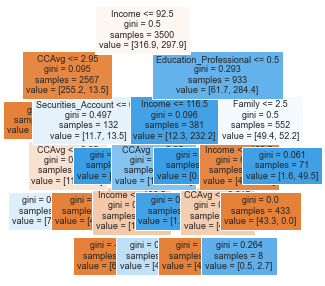

<IPython.core.display.Javascript object>

In [241]:
plt.figure(figsize=(5, 5))

out = tree.plot_tree(
    best_model,
    feature_names=feature_names,
    filled=True,
    fontsize=9,
    node_ids=False,
    class_names=None,
)
for o in out:
    arrow = o.arrow_patch
    if arrow is not None:
        arrow.set_edgecolor("black")
        arrow.set_linewidth(1)
plt.show()

In [242]:
# Text report showing the rules of a decision tree -
column_names = list(df.columns)
# Keep only names of features by removing the name of target variable
column_names.remove("Personal_Loan")
feature_names = column_names
print(feature_names)

print(tree.export_text(best_model, feature_names=feature_names, show_weights=True))

['Age', 'Experience', 'Income', 'Family', 'CCAvg', 'Mortgage', 'Securities_Account', 'CD_Account', 'Online', 'CreditCard', 'ZIPCode_91', 'ZIPCode_92', 'ZIPCode_93', 'ZIPCode_94', 'ZIPCode_95', 'ZIPCode_96', 'Education_Professional', 'Education_Undergraduate']
|--- Income <= 92.50
|   |--- CCAvg <= 2.95
|   |   |--- weights: [243.50, 0.00] class: 0
|   |--- CCAvg >  2.95
|   |   |--- CD_Account <= 0.50
|   |   |   |--- CCAvg <= 3.95
|   |   |   |   |--- weights: [7.50, 9.00] class: 1
|   |   |   |--- CCAvg >  3.95
|   |   |   |   |--- weights: [4.20, 0.00] class: 0
|   |   |--- CD_Account >  0.50
|   |   |   |--- weights: [0.00, 4.50] class: 1
|--- Income >  92.50
|   |--- Education_Undergraduate <= 0.50
|   |   |--- Income <= 116.50
|   |   |   |--- CCAvg <= 2.85
|   |   |   |   |--- Income <= 106.50
|   |   |   |   |   |--- weights: [6.80, 0.00] class: 0
|   |   |   |   |--- Income >  106.50
|   |   |   |   |   |--- weights: [4.30, 6.30] class: 1
|   |   |   |--- CCAvg >  2.85
|   |  

<IPython.core.display.Javascript object>

* This model might be giving the highest recall but a buisness would not be able to use it to actually target the potential customers.

##### Gini Importance

In [243]:
# importance of features in the tree building ( The importance of a feature is computed as the
# (normalized) total reduction of the 'criterion' brought by that feature. It is also known as the Gini importance )

print(
    pd.DataFrame(
        best_model.feature_importances_, columns=["Imp"], index=X_train.columns
    ).sort_values(by="Imp", ascending=False)
)

                         Imp
Income                  0.66
Family                  0.15
Education_Undergraduate 0.09
CCAvg                   0.09
CD_Account              0.01
ZIPCode_92              0.00
Education_Professional  0.00
ZIPCode_96              0.00
ZIPCode_95              0.00
ZIPCode_94              0.00
ZIPCode_93              0.00
Age                     0.00
ZIPCode_91              0.00
Experience              0.00
Online                  0.00
Securities_Account      0.00
Mortgage                0.00
CreditCard              0.00


<IPython.core.display.Javascript object>

We see that `Income` has the highest level of Gini importance.

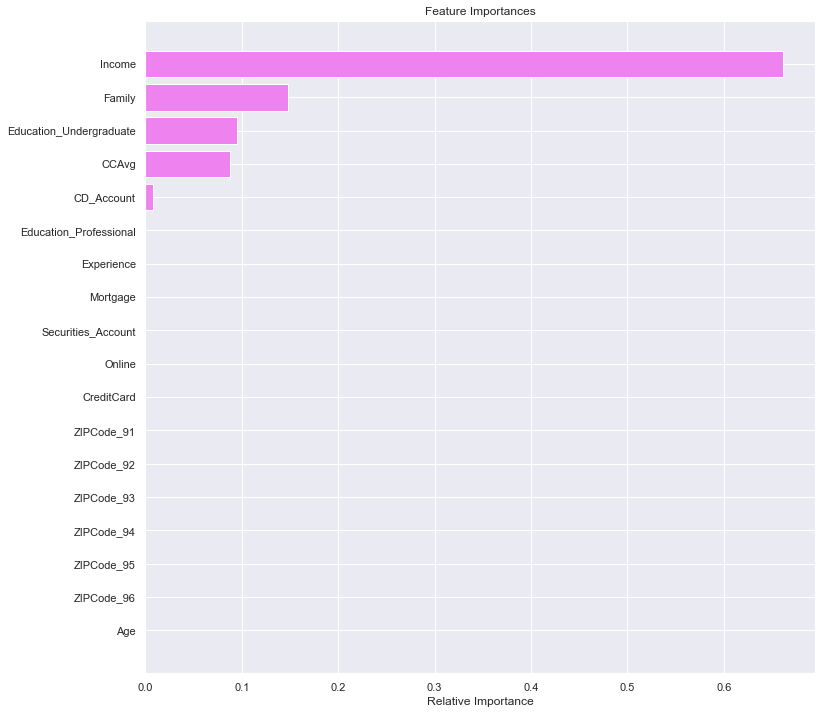

<IPython.core.display.Javascript object>

In [244]:
importances = best_model.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

* `Income`, `Family`,`Education`, and `CCAvg` and  are the most important features with post-pruning too.

#### Best Model #2 

Creating model with 0.015 ccp_alpha for better interpretability.

In [255]:
best_model2 = DecisionTreeClassifier(
    ccp_alpha=0.015, class_weight={0: 0.10, 1: 0.90}, random_state=1
)
best_model2.fit(X_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.015, class_weight={0: 0.1, 1: 0.9},
                       random_state=1)

<IPython.core.display.Javascript object>

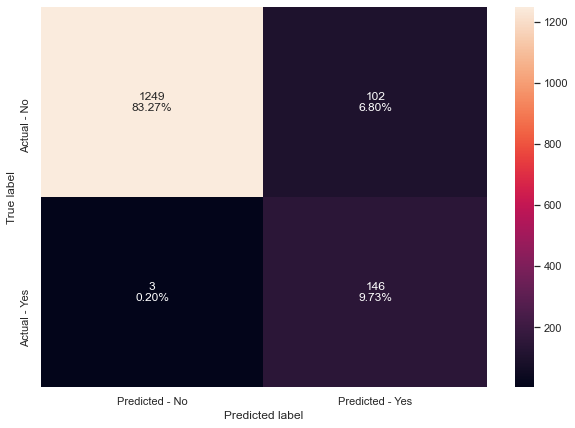

<IPython.core.display.Javascript object>

In [256]:
make_confusion_matrix_dt(best_model2, y_test)

* We are able to identify more True Positives (102) - 
* The False Negative are low at 3 and are higher than the Best Model #1.
* The False Positives are higher than the Best Model #1 which is ok too - customers that are actually going to contribute to revenue.

In [257]:
# Let's Look at Model Performance by doing predicitions

# training set
y_predb = best_model2.predict(X_train)
pred_train = list(map(round, y_pred))

# test set
y_predb1 = best_model2.predict(X_test)
pred_test = list(map(round, y_pred1))

<IPython.core.display.Javascript object>

In [258]:
# print score results

print("Accuracy on train data:", accuracy_score(y_train, y_predb))
print("Accuracy on test data:", accuracy_score(y_test, y_predb1))

print("Recall on train data:", recall_score(y_train, y_predb))
print("Recall on test data:", recall_score(y_test, y_predb1))

print("Precision on train data:", precision_score(y_train, y_predb))
print("Precision on test data:", precision_score(y_test, y_predb1))

print("f1 score on train data:", f1_score(y_train, y_predb))
print("f1 score on test data:", f1_score(y_test, y_predb1))

Accuracy on train data: 0.926
Accuracy on test data: 0.93
Recall on train data: 0.9909365558912386
Recall on test data: 0.9798657718120806
Precision on train data: 0.5616438356164384
Precision on test data: 0.5887096774193549
f1 score on train data: 0.7169398907103826
f1 score on test data: 0.7355163727959698


<IPython.core.display.Javascript object>

* The accuracy, recall, precision and f1 have all decreased, but let's look at the tree to see how deep it is and therefore useful for business interpretation.

##### Visualizing the Decision Tree

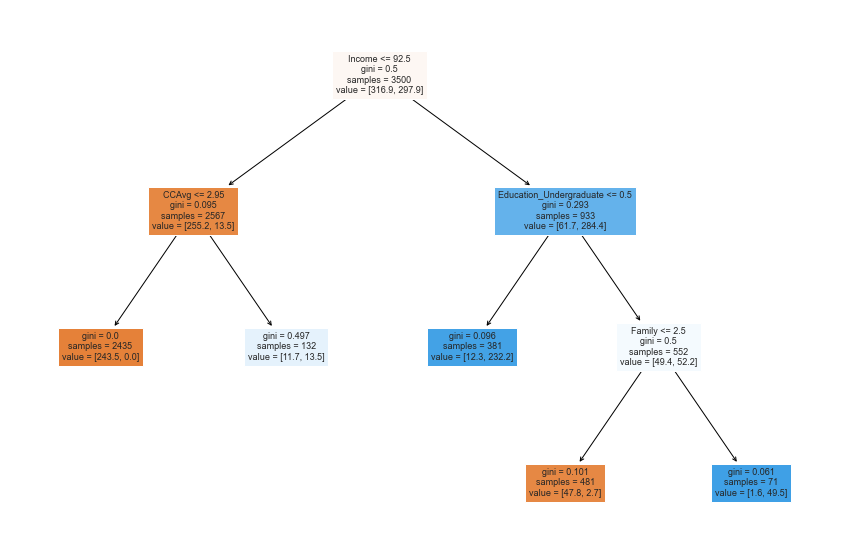

<IPython.core.display.Javascript object>

In [259]:
plt.figure(figsize=(15, 10))

out = tree.plot_tree(
    best_model2,
    feature_names=feature_names,
    filled=True,
    fontsize=9,
    node_ids=False,
    class_names=None,
)
for o in out:
    arrow = o.arrow_patch
    if arrow is not None:
        arrow.set_edgecolor("black")
        arrow.set_linewidth(1)
plt.show()

This model has less nodes than the best model1 and is bit easier to use for business logic.

In [263]:
# importance of features in the tree building ( The importance of a feature is computed as the
# (normalized) total reduction of the 'criterion' brought by that feature. It is also known as the Gini importance )

print(
    pd.DataFrame(
        best_model2.feature_importances_, columns=["Imp"], index=X_train.columns
    ).sort_values(by="Imp", ascending=False)
)

                         Imp
Income                  0.68
Family                  0.16
Education_Undergraduate 0.10
CCAvg                   0.05
ZIPCode_92              0.00
Education_Professional  0.00
ZIPCode_96              0.00
ZIPCode_95              0.00
ZIPCode_94              0.00
ZIPCode_93              0.00
Age                     0.00
ZIPCode_91              0.00
Experience              0.00
Online                  0.00
CD_Account              0.00
Securities_Account      0.00
Mortgage                0.00
CreditCard              0.00


<IPython.core.display.Javascript object>

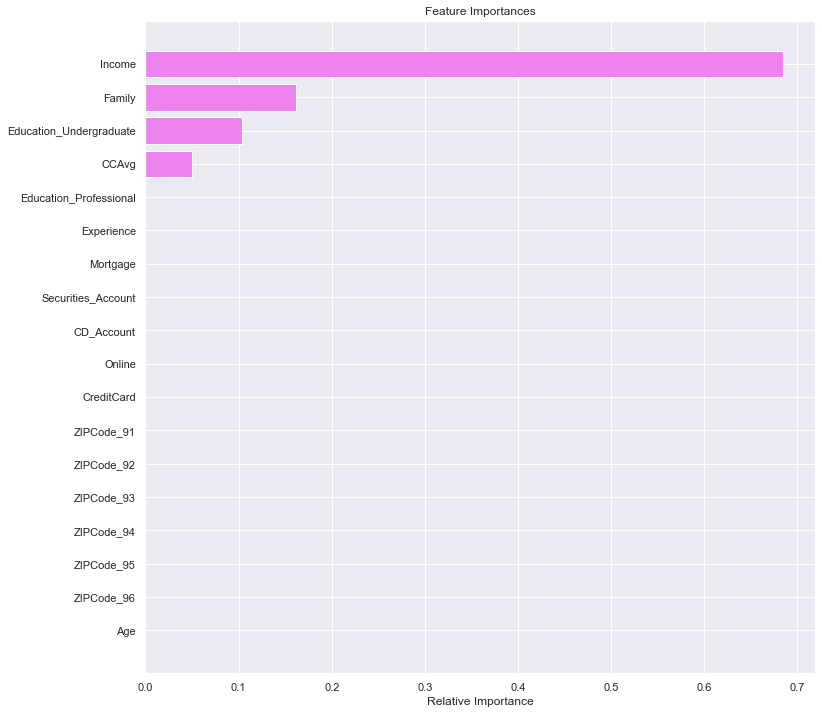

<IPython.core.display.Javascript object>

In [264]:
importances = best_model2.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12, 12))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color="violet", align="center")
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

* `Income` and `Family` are the top two important features to predict liability customer acceptance of personal loans contributing to interest returns.

## Comparing Decision Tree Models

In [270]:
comparison_frame_dt = pd.read_csv("log_reg_metrics_dt.csv")
comparison_frame_dt

,metrics,"Initial decision tree model',","'Decision tree with max depth',","'Decision tree with hyperparameter tuning',","best model #1',",best model #2'
0,Accuracy on training set,1.00,0.91,0.79,0.96,0.93
1,Accuracy on test set,0.98,0.90,0.78,0.95,0.93
2,Recall on training set,1.00,0.00,1.00,1.00,0.99
3,Recall on test set,0.89,0.00,1.00,0.99,0.98
4,Precision on training set,1.00,0.00,0.31,0.69,0.56
5,Precision on test set,0.92,0.00,0.31,0.66,0.59
6,F1 on training set,1.00,0.00,0.47,0.81,0.72
7,F1 on test set,0.90,0.00,0.47,0.79,0.74


<IPython.core.display.Javascript object>

* Decision tree model with hyperparameter tuning is given the best recall score on test data but is not useful for business interpretation and is overfitting. 

* The best model, most well-rounded, is the initial decision tree, for recall score. However, it is not useful business logic.

* Let's examine the customer profile in the dependent variables to find our market segementation from the best model 2.

In [271]:
# Text report showing the rules of a decision tree -
column_names = list(df.columns)
# Keep only names of features by removing the name of target variable
column_names.remove("Personal_Loan")
feature_names = column_names
print(feature_names)

print(tree.export_text(best_model2, feature_names=feature_names, show_weights=True))

['Age', 'Experience', 'Income', 'Family', 'CCAvg', 'Mortgage', 'Securities_Account', 'CD_Account', 'Online', 'CreditCard', 'ZIPCode_91', 'ZIPCode_92', 'ZIPCode_93', 'ZIPCode_94', 'ZIPCode_95', 'ZIPCode_96', 'Education_Professional', 'Education_Undergraduate']
|--- Income <= 92.50
|   |--- CCAvg <= 2.95
|   |   |--- weights: [243.50, 0.00] class: 0
|   |--- CCAvg >  2.95
|   |   |--- weights: [11.70, 13.50] class: 1
|--- Income >  92.50
|   |--- Education_Undergraduate <= 0.50
|   |   |--- weights: [12.30, 232.20] class: 1
|   |--- Education_Undergraduate >  0.50
|   |   |--- Family <= 2.50
|   |   |   |--- weights: [47.80, 2.70] class: 0
|   |   |--- Family >  2.50
|   |   |   |--- weights: [1.60, 49.50] class: 1



<IPython.core.display.Javascript object>

Following this logic we can see that the loan purchasers come from 3 major groups:

1.  Families with 2.5 members or more, where the customer is an undergraduate degree holder, and makes an income of greater than 92,500USD per year.

2. Undergraduates who make over 92,500USD per year.

3. Customers with a credit card average balance of greater than 2950USD and make less than 92,500USD per year.

# Comparing Logistic Regression model and Decision Tree Model

In [294]:
master_comparision_frame = pd.merge(
    left=log_reg_metrics,
    right=comparison_frame_dt,
    how="right",
    right_on="metrics",
    left_on="Metrics",
)

master_comparision_frame.drop(labels="metrics", axis=1)

,Metrics,Logitic Regression (sklearn),Logitic Regression (statsmodel),Logitic Regression (statsmodel - AUC/ROC tuned),Logitic Regression (statsmodel - Pre/Rec tuned),"Initial decision tree model',","'Decision tree with max depth',","'Decision tree with hyperparameter tuning',","best model #1',",best model #2'
0,Accuracy on training set,0.96,0.96,0.86,0.96,1.00,0.91,0.79,0.96,0.93
1,Accuracy on test set,0.96,0.96,0.87,0.96,0.98,0.90,0.78,0.95,0.93
2,Recall on training set,0.65,0.68,0.92,0.76,1.00,0.00,1.00,1.00,0.99
3,Recall on test set,0.63,0.64,0.93,0.71,0.89,0.00,1.00,0.99,0.98
4,Precision on training set,0.88,0.86,0.40,0.79,1.00,0.00,0.31,0.69,0.56
5,Precision on test set,0.90,0.91,0.43,0.82,0.92,0.00,0.31,0.66,0.59
6,F1 on training set,0.75,0.76,0.56,0.77,1.00,0.00,0.47,0.81,0.72
7,F1 on test set,0.74,0.75,0.59,0.76,0.90,0.00,0.47,0.79,0.74


<IPython.core.display.Javascript object>

For Recall and overall fit, the best overall model from Logistic is Logistic Regression (statsmodel) and from the Decision Tree it was the initial DT.

* The Logistic Regression model has decent statistics but not in comparison with the initial Decision Tree Classifier it does not compare in recall. The problem is the overfitting. 

* For business purposes and to make a more accurate prediction we will use the Logistic Regression model. This will help us by giving us those coefficients which we need to say which variables are more powerful in predicting changes in our classification. This is the probability power. 

Looking at the confusion matrix and the desire to lower false negative error:

* The Decision Tree model with hypertuning was the best at lowering False Positives and False Negatives. However, all the models gave great results (<12%).

* The Decision Tree is useful in the creation of business rules but not as useful in identifying the changes that we will see when we apply a model to the population of the entire bank's customers.



**From our StatsModel we come up with the regression (classification) model for our predictions, looking at the log-odds:**

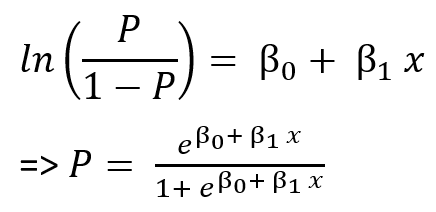


*GreatLearning Notes:*
* Please note that when coefficient is b , than change in odds is (exp(b)-1)*100 %
* Probability = odd/(1+odd)


LogOdds of taking a loan = 	-9.1713(const)+	-3.9497(Education_Undergraduate)+	-1.1414(Securities_Account)+	-1.0648(CreditCard)+	-0.6658(Online)+	0.0593(Income)+	0.2008(CCAvg)+	0.6454(Family)+	3.8488(CD_Account)



In [ ]:
## Model Selection
* As per lg4: `Income`, `Family`, `CCAvg`, `Education`, `Securities_Account`, `CD_Account`, `Online`, and `CreditCard` are important variables here.
* `Securities_Account`, `Online`, and `CreditCard` have negative signs, i.e increase in these will lead to decrease in chances of approving a loan offer (becoming an asset customer).
* 1 unit increase (Getting a credit card account outside of AllBank) in `CreditCard` decreases the odds of being loan offer approver by ~1.1%


# EDA on the Incorrectly Predicted Data

Do an analysis of all the incorrectly predicted or misclassified samples ( Eg: original label = 0 but model predicted it as 1): False Positives. - Perform EDA on such points to see if there is a pattern. This is now heading in the machine learning direction even further. I will use the Decision Tree best model #1 since it is the best predictor and merge it with the original dataframe to get our customer ID's.

In [300]:
# assign the target class
# Features
X = df.drop("Personal_Loan", axis=1)
# Labels (Target Variable)
y = df["Personal_Loan"]

<IPython.core.display.Javascript object>

In [301]:
# Splitting data into training and test set using 70/30:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)
print(X_train.shape, X_test.shape)

(3500, 18) (1500, 18)


<IPython.core.display.Javascript object>

In [302]:
# creating the model where we get highest train and test recall
index_best_model = np.argmax(recall_test)
best_model2 = clfs[index_best_model]
print(best_model2)

DecisionTreeClassifier(ccp_alpha=0.002328917016620172,
                       class_weight={0: 0.1, 1: 0.9}, random_state=1)


<IPython.core.display.Javascript object>

In [304]:
# fit model to training data
best_model2.fit(X_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.015, class_weight={0: 0.1, 1: 0.9},
                       random_state=1)

<IPython.core.display.Javascript object>

In [305]:
# predict on the model
y_hats_test = best_model.predict(X_test)
y_hats_train = best_model.predict(X_train)

<IPython.core.display.Javascript object>

In [306]:
# put the predictions into original dataframe
# https://stackoverflow.com/questions/61951360/how-to-merge-predicted-values-back-to-original-dataframe-in-pandas-and-sklearn
df["preds"] = np.hstack([y_hats_test, y_hats_train])
df.head(100)

,Age,Experience,Income,Family,CCAvg,Mortgage,Personal_Loan,Securities_Account,CD_Account,Online,CreditCard,ZIPCode_91,ZIPCode_92,ZIPCode_93,ZIPCode_94,ZIPCode_95,ZIPCode_96,Education_Professional,Education_Undergraduate,preds
0,25,1,49,4,1.60,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0
1,45,19,34,3,1.50,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
2,39,15,11,1,1.00,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
3,35,9,100,1,2.70,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
4,35,8,45,4,1.00,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0
5,37,13,29,4,0.40,155,0,0,0,1,0,0,1,0,0,0,0,0,0,0
6,53,27,72,2,1.50,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0
7,50,24,22,1,0.30,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0
8,35,10,81,3,0.60,104,0,0,0,1,0,0,0,0,0,0,0,0,0,1
9,34,9,180,1,8.90,0,1,0,0,0,0,0,0,1,0,0,0,1,0,1


<IPython.core.display.Javascript object>

Get dataframe of incorrectly predicted or misclassified samples ( Eg: original label = 0 but model predicted it as 1)

In [307]:
# get dataframe where condition is met
df_inc = df[(df.Personal_Loan != df.preds)]
display(df_inc)

,Age,Experience,Income,Family,CCAvg,Mortgage,Personal_Loan,Securities_Account,CD_Account,Online,CreditCard,ZIPCode_91,ZIPCode_92,ZIPCode_93,ZIPCode_94,ZIPCode_95,ZIPCode_96,Education_Professional,Education_Undergraduate,preds
8,35,10,81,3,0.60,104,0,0,0,1,0,0,0,0,0,0,0,0,0,1
18,46,21,193,2,8.10,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0
27,46,20,158,1,2.40,0,0,0,0,1,1,0,0,0,0,0,0,0,1,1
29,38,13,119,1,3.30,0,1,0,1,1,1,0,0,0,1,0,0,0,0,0
34,31,5,50,4,1.80,0,0,0,0,1,0,0,0,0,1,0,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4968,58,32,41,4,2.50,0,0,0,0,1,1,0,0,1,0,0,0,0,1,1
4970,37,13,95,2,1.70,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1
4971,58,28,73,1,1.40,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1
4980,29,5,135,3,5.30,0,1,0,1,1,1,0,0,0,0,1,0,0,1,0


<IPython.core.display.Javascript object>

Get a dataframe of the predicted "yes" to getting a personal loan. This will be our target segment.

In [308]:
# get dataframe from filter
df_pos = df[(df.preds == 1)]

<IPython.core.display.Javascript object>

### Statistical Summary

In [309]:
df_pos.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,706.00,45.60,11.26,23.00,36.00,45.50,55.00,67.00
Experience,706.00,20.53,11.14,0.00,11.00,20.00,30.00,41.00
Income,706.00,76.81,47.54,8.00,39.00,68.00,104.00,224.00
Family,706.00,2.34,1.14,1.00,1.00,2.00,3.00,4.00
CCAvg,706.00,2.04,1.86,0.00,0.70,1.60,2.70,10.00
Mortgage,706.00,58.61,104.16,0.00,0.00,0.00,101.00,571.00
Personal_Loan,706.00,0.12,0.32,0.00,0.00,0.00,0.00,1.00
Securities_Account,706.00,0.10,0.30,0.00,0.00,0.00,0.00,1.00
CD_Account,706.00,0.07,0.25,0.00,0.00,0.00,0.00,1.00
Online,706.00,0.61,0.49,0.00,0.00,1.00,1.00,1.00


<IPython.core.display.Javascript object>

- Our predicated data set has Family size ~2, CD_Account = 0, and no Education.

In [310]:
for i in df_pos.columns:
    display(df_pos[i].value_counts())

43    32
35    30
58    30
39    27
54    27
55    25
53    22
52    21
50    19
62    19
31    19
47    18
49    18
63    18
38    18
56    17
41    17
45    17
34    17
59    16
33    16
30    16
29    16
28    16
61    16
37    16
42    15
57    15
60    14
44    14
46    13
32    13
51    12
36    12
27    12
48    11
40    11
64    10
26     9
65     9
25     7
24     2
66     2
23     1
67     1
Name: Age, dtype: int64

28    30
32    29
20    27
29    26
18    24
30    22
19    22
14    22
10    20
34    20
3     20
5     20
9     19
37    19
33    19
25    18
11    18
22    18
13    18
7     17
27    17
26    17
17    17
24    16
38    16
12    16
8     15
35    15
2     15
16    14
23    13
15    13
6     13
1     12
36    11
21    11
4     10
39    10
31     9
40     8
0      6
41     4
Name: Experience, dtype: int64

83     16
21     14
39     14
48     13
53     12
31     12
82     12
81     12
44     12
70     12
79     11
38     11
35     11
43     11
30     11
62     10
25     10
28     10
55     10
58      9
50      9
63      9
34      9
59      9
23      9
69      9
85      9
45      8
41      8
42      8
40      8
84      8
80      7
78      7
12      7
61      7
22      7
72      7
180     6
19      6
73      6
93      6
29      6
32      6
33      6
141     6
115     6
90      6
94      5
145     5
74      5
95      5
179     5
118     5
64      5
60      5
54      5
13      5
15      5
130     5
158     4
138     4
104     4
109     4
132     4
110     4
112     4
120     4
129     4
122     4
121     4
101     4
75      4
99      4
88      4
65      4
49      4
183     4
24      4
18      4
131     3
20      3
134     3
182     3
11      3
139     3
140     3
142     3
152     3
125     3
51      3
178     3
68      3
71      3
114     3
169     3
52      3
173     3
164     2
184     2


1    216
2    192
4    159
3    139
Name: Family, dtype: int64

1.00     34
0.30     32
0.80     30
0.10     29
0.70     26
1.50     24
1.40     23
0.20     23
2.10     22
0.40     21
1.70     21
0.60     20
1.80     20
2.00     19
2.80     19
2.20     18
0.00     17
1.90     17
0.90     15
1.60     15
1.30     15
0.50     14
2.50     14
3.00     10
2.40     10
1.10      9
4.50      8
2.90      8
1.20      8
4.00      8
2.30      8
3.40      7
2.60      7
3.60      6
2.70      6
6.50      6
6.10      6
3.70      5
4.70      5
2.67      5
5.00      4
7.00      4
3.80      4
3.10      4
3.90      4
6.80      3
3.20      3
6.00      3
5.40      3
0.67      3
5.20      3
1.75      3
4.10      3
7.50      2
1.33      2
4.33      2
5.70      2
3.30      2
6.67      2
1.67      2
8.10      2
8.00      2
0.75      2
5.90      2
7.60      2
6.30      2
4.30      2
4.40      2
7.80      2
4.90      2
4.80      2
7.40      1
10.00     1
7.30      1
4.20      1
8.30      1
6.90      1
7.20      1
8.90      1
7.90      1
6.20      1
4.67      1
8.80      1
4.25

0      489
185      6
97       5
158      4
184      4
112      3
111      3
104      3
166      3
96       3
98       3
89       3
76       3
193      2
160      2
131      2
231      2
137      2
142      2
144      2
238      2
146      2
297      2
156      2
215      2
205      2
251      2
162      2
164      2
246      2
272      2
327      2
198      2
196      2
170      2
249      2
187      2
129      2
226      2
95       2
109      2
110      2
108      2
115      2
87       2
442      2
408      2
94       2
91       2
101      2
100      2
118      2
78       2
119      2
258      1
263      1
419      1
267      1
256      1
345      1
431      1
270      1
247      1
496      1
245      1
244      1
509      1
243      1
524      1
236      1
437      1
389      1
394      1
342      1
352      1
326      1
325      1
323      1
353      1
319      1
354      1
318      1
315      1
309      1
307      1
303      1
366      1
302      1
294      1
293      1
368      1

0    623
1     83
Name: Personal_Loan, dtype: int64

0    634
1     72
Name: Securities_Account, dtype: int64

0    659
1     47
Name: CD_Account, dtype: int64

1    430
0    276
Name: Online, dtype: int64

0    486
1    220
Name: CreditCard, dtype: int64

0    611
1     95
Name: ZIPCode_91, dtype: int64

0    573
1    133
Name: ZIPCode_92, dtype: int64

0    646
1     60
Name: ZIPCode_93, dtype: int64

0    509
1    197
Name: ZIPCode_94, dtype: int64

0    586
1    120
Name: ZIPCode_95, dtype: int64

0    704
1      2
Name: ZIPCode_96, dtype: int64

0    487
1    219
Name: Education_Professional, dtype: int64

0    418
1    288
Name: Education_Undergraduate, dtype: int64

1    706
Name: preds, dtype: int64

<IPython.core.display.Javascript object>

In [311]:
df_inc.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,1020.00,45.60,11.41,23.00,35.00,45.00,55.00,67.00
Experience,1020.00,20.52,11.32,0.00,11.00,20.00,30.00,41.00
Income,1020.00,97.73,53.40,8.00,50.00,91.00,141.25,224.00
Family,1020.00,2.41,1.14,1.00,1.00,2.00,3.00,4.00
CCAvg,1020.00,2.57,2.07,0.00,0.90,2.00,3.90,10.00
Mortgage,1020.00,75.30,130.41,0.00,0.00,0.00,119.00,617.00
Personal_Loan,1020.00,0.39,0.49,0.00,0.00,0.00,1.00,1.00
Securities_Account,1020.00,0.11,0.31,0.00,0.00,0.00,0.00,1.00
CD_Account,1020.00,0.13,0.34,0.00,0.00,0.00,0.00,1.00
Online,1020.00,0.61,0.49,0.00,0.00,1.00,1.00,1.00


<IPython.core.display.Javascript object>

We find 1020 incorrectly predicted values. 

### Univariate analysis

In [312]:
# Function to perform statistical analysis on every numeric and categorical variable in the dataframe
pd.set_option("display.max_colwidth", 5000)


def univar_num(dataframe):  # argument is the whole dataframe

    # Print statistics for numeric variables
    # Mode (or most popular)
    print("\n Mode Analysis \n", df_inc.mode("index")[0:2])
    print("\n Sum Analysis \n", df_inc.sum())  # Sum analysis
    # Variance analysis
    print("\n Variance analysis \n", df_inc.var())
    print(
        "\n Absolute Deviation or Mean Absolute Deviation \n", df_inc.mad()
    )  # Absolute Deviation or Mean Absolute Deviation
    print("\n  Skew analysis \n ", df_inc.skew())  # Skew analysis

    return

<IPython.core.display.Javascript object>

In [313]:
# Run dataframe through function
univar_num(df_inc)


 Mode Analysis 
    Age  Experience  Income  Family  CCAvg  Mortgage  Personal_Loan  \
0   43          20      83       1   0.30         0              0   

   Securities_Account  CD_Account  Online  CreditCard  ZIPCode_91  ZIPCode_92  \
0                   0           0       1           0           0           0   

   ZIPCode_93  ZIPCode_94  ZIPCode_95  ZIPCode_96  Education_Professional  \
0           0           0           0           0                       0   

   Education_Undergraduate  preds  
0                        0      1  

 Sum Analysis 
 Age                       46516.00
Experience                20932.00
Income                    99681.00
Family                     2455.00
CCAvg                      2625.56
Mortgage                  76809.00
Personal_Loan               397.00
Securities_Account          112.00
CD_Account                  133.00
Online                      623.00
CreditCard                  305.00
ZIPCode_91                  130.00
ZIPCode_92    

<IPython.core.display.Javascript object>

In [315]:
# Frequency tables for every feature
for (
    column_name,
    column_data,
) in (
    df_inc.iteritems()
):  # for every column in the dataframe return the column name and Series of data
    display((column_name, column_data.value_counts()))

('Age',
 43    43
 35    38
 58    36
 54    36
 55    32
 63    30
 52    30
 50    30
 30    29
 33    29
 45    28
 44    28
 39    27
 53    27
 29    27
 57    25
 62    24
 38    24
 61    24
 49    24
 34    23
 41    23
 32    23
 56    23
 51    22
 60    22
 27    22
 31    22
 47    22
 37    22
 48    21
 42    21
 65    21
 36    20
 28    19
 59    19
 40    19
 46    18
 64    18
 26    16
 25     7
 24     2
 66     2
 23     1
 67     1
 Name: Age, dtype: int64)

('Experience',
 20    40
 28    39
 18    36
 32    35
 25    32
 3     31
 30    31
 29    30
 19    30
 37    28
 8     27
 7     27
 26    27
 22    27
 34    26
 14    26
 5     26
 6     25
 9     25
 10    25
 16    25
 11    25
 13    25
 35    24
 33    24
 27    23
 38    22
 24    22
 12    22
 36    21
 23    20
 39    20
 17    20
 4     19
 1     18
 15    18
 2     18
 21    16
 31    15
 41    11
 40    10
 0      9
 Name: Experience, dtype: int64)

('Income',
 83     19
 39     14
 21     14
 48     13
 82     13
 81     13
 44     12
 70     12
 53     12
 158    12
 31     12
 30     11
 43     11
 123    11
 38     11
 35     11
 79     11
 85     11
 28     10
 114    10
 62     10
 25     10
 55     10
 179    10
 130    10
 129    10
 142     9
 131     9
 140     9
 63      9
 58      9
 50      9
 59      9
 34      9
 23      9
 161     9
 84      9
 173     9
 184     9
 69      8
 115     8
 188     8
 101     8
 154     8
 93      8
 45      8
 42      8
 41      8
 40      8
 182     8
 172     8
 170     8
 135     8
 152     8
 104     7
 111     7
 164     7
 132     7
 112     7
 113     7
 145     7
 118     7
 122     7
 141     7
 139     7
 190     7
 99      7
 78      7
 80      7
 61      7
 90      7
 72      7
 12      7
 22      7
 73      7
 60      6
 180     6
 125     6
 33      6
 121     6
 120     6
 119     6
 134     6
 64      6
 32      6
 183     6
 165     6
 185     6
 195     6
 19      6

('Family',
 1    293
 2    260
 4    241
 3    226
 Name: Family, dtype: int64)

('CCAvg',
 0.30     38
 1.00     34
 0.80     33
 0.70     32
 0.10     31
 1.50     28
 0.20     27
 0.40     25
 1.70     25
 1.40     24
 2.80     24
 2.10     23
 2.00     23
 1.30     22
 2.20     21
 1.80     21
 0.60     20
 0.50     20
 3.00     19
 1.90     19
 3.40     18
 0.90     18
 0.00     18
 1.60     18
 2.50     16
 1.10     14
 1.20     14
 4.10     14
 2.90     13
 2.30     13
 3.30     12
 2.60     11
 2.70     11
 5.40     11
 2.40     11
 4.20     10
 4.30     10
 4.50     10
 4.70     10
 3.70     10
 3.10     10
 3.90      9
 4.00      9
 5.00      9
 7.00      9
 6.10      8
 3.60      8
 3.80      8
 6.50      8
 4.40      8
 3.50      7
 4.90      7
 5.60      7
 5.70      7
 6.90      6
 5.20      6
 4.60      6
 2.67      5
 7.50      5
 6.30      5
 6.00      5
 4.80      5
 7.40      5
 5.10      5
 6.60      4
 3.20      4
 5.50      4
 5.30      4
 7.90      3
 5.90      3
 0.67      3
 8.10      3
 6.80      3
 5.80      3
 7.20      3
 1.75      3
 6

('Mortgage',
 0      683
 185      6
 158      5
 301      5
 184      4
       ... 
 243      1
 244      1
 245      1
 246      1
 617      1
 Name: Mortgage, Length: 220, dtype: int64)

('Personal_Loan',
 0    623
 1    397
 Name: Personal_Loan, dtype: int64)

('Securities_Account',
 0    908
 1    112
 Name: Securities_Account, dtype: int64)

('CD_Account',
 0    887
 1    133
 Name: CD_Account, dtype: int64)

('Online',
 1    623
 0    397
 Name: Online, dtype: int64)

('CreditCard',
 0    715
 1    305
 Name: CreditCard, dtype: int64)

('ZIPCode_91',
 0    890
 1    130
 Name: ZIPCode_91, dtype: int64)

('ZIPCode_92',
 0    817
 1    203
 Name: ZIPCode_92, dtype: int64)

('ZIPCode_93',
 0    935
 1     85
 Name: ZIPCode_93, dtype: int64)

('ZIPCode_94',
 0    731
 1    289
 Name: ZIPCode_94, dtype: int64)

('ZIPCode_95',
 0    852
 1    168
 Name: ZIPCode_95, dtype: int64)

('ZIPCode_96',
 0    1017
 1       3
 Name: ZIPCode_96, dtype: int64)

('Education_Professional',
 0    668
 1    352
 Name: Education_Professional, dtype: int64)

('Education_Undergraduate',
 0    665
 1    355
 Name: Education_Undergraduate, dtype: int64)

('preds',
 1    623
 0    397
 Name: preds, dtype: int64)

<IPython.core.display.Javascript object>

### Distributions

In [318]:
# Function to create distribution and statistical plots for each numerical feature in the dataframe
def univar_vis(dataframe):

    sns.set(style="ticks")
    sns.set_style("darkgrid")

    # Univariate visualization of categoricals variables
    for (column_name_c, column_data_c) in df_inc.iteritems():

        print(column_name_c, "Count Plot")
        plt.figure(figsize=(20, 10))
        sns.countplot(x=column_data_c)  # Bar plot against a numeric variable
        plt.show()

        """
        print(column_name_c, "Distribution Plot")
        plt.figure(figsize=(20, 10))
        sns.displot(data=column_data_c)  # distribution plot
        plt.show()
        """

    # Univariate visualization of numeric variables
    for (column_name, column_data) in df_inc.iteritems():

        print(column_name, "Histogram")
        sns.histplot(df[column_name], kde=True)  # histogram
        plt.figure(figsize=(20, 10))
        plt.show()

        """
        print(column_name, "Distribution Plot")
        plt.figure(figsize=(20, 10))
        sns.displot(data=column_data)  # distribution plot
        plt.show()
        """

        print(column_name, "Density Plot")
        sns.kdeplot(data=column_data, x=df_inc[column_name])  # Kernel distribution
        plt.figure(figsize=(20, 10))
        plt.show()

        print(column_name, "Box Plot")
        sns.boxplot(data=column_data, y=df_inc[column_name])  # Box plot
        plt.figure(figsize=(20, 10))
        plt.show()

        # raise Exception("End to kill infinite loop")

    return

<IPython.core.display.Javascript object>

Age Count Plot


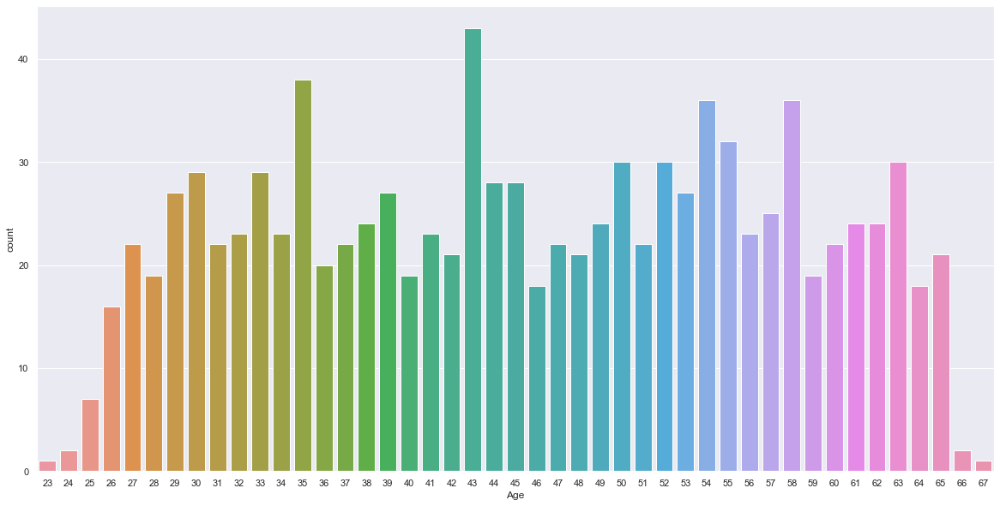

Experience Count Plot


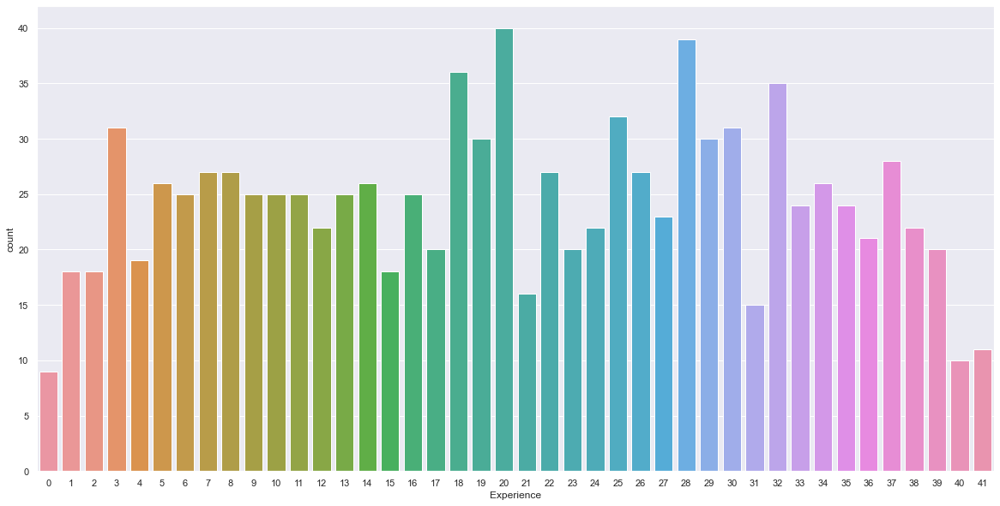

Income Count Plot


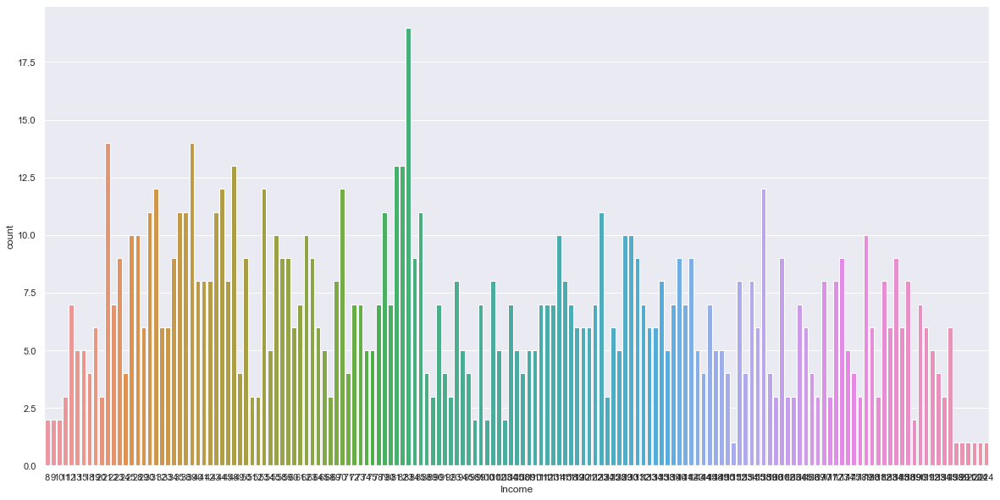

Family Count Plot


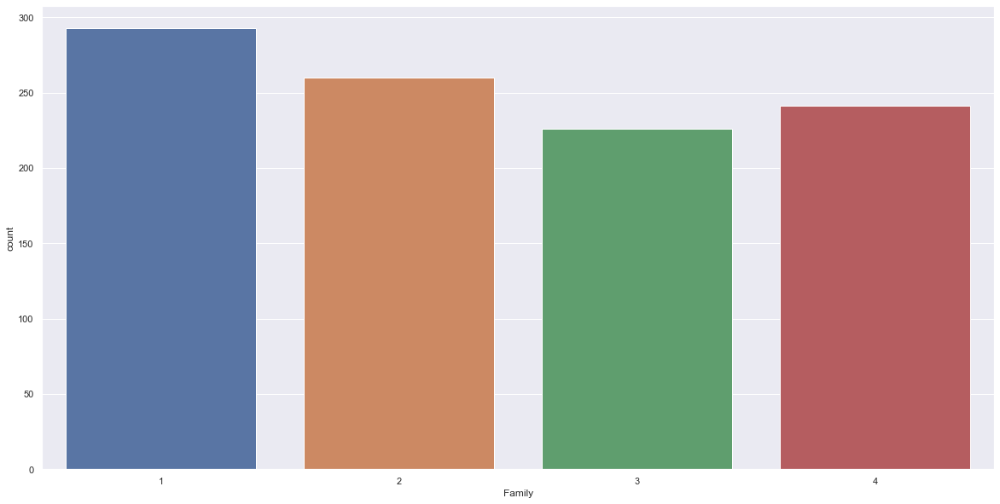

CCAvg Count Plot


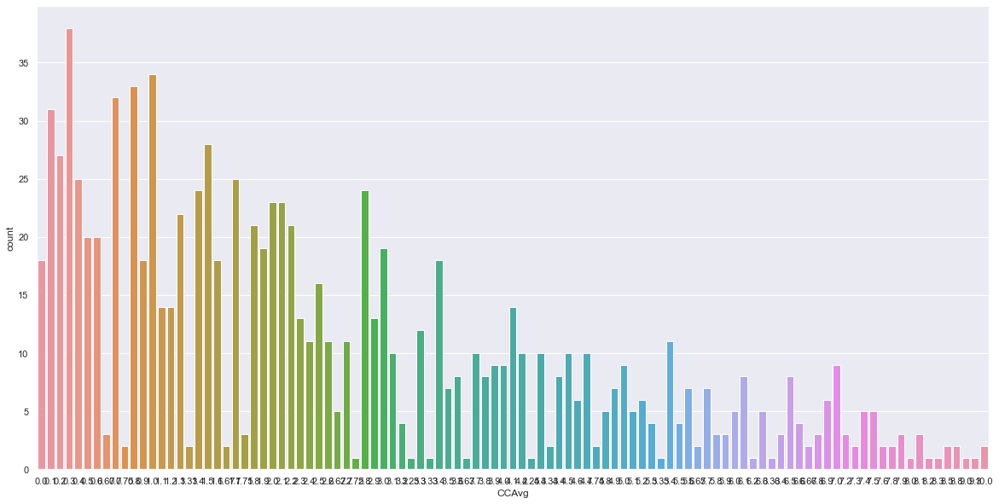

Mortgage Count Plot


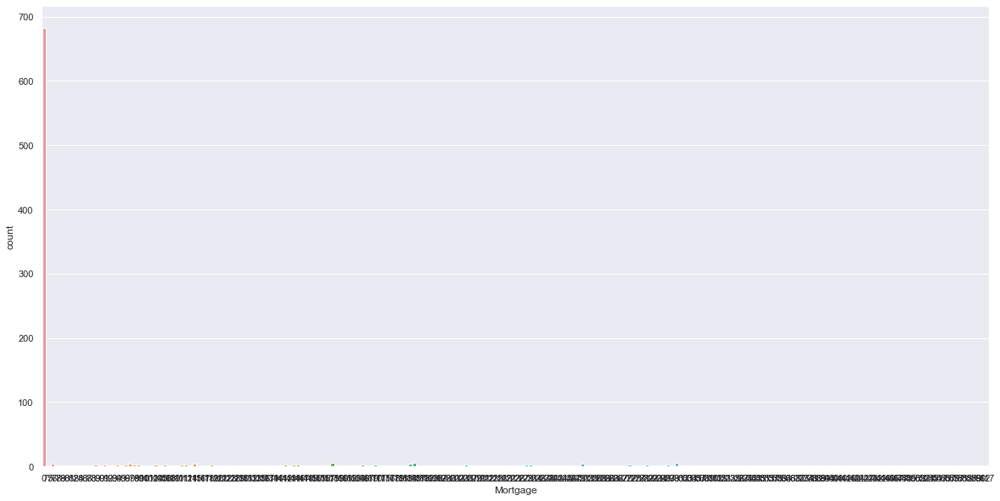

Personal_Loan Count Plot


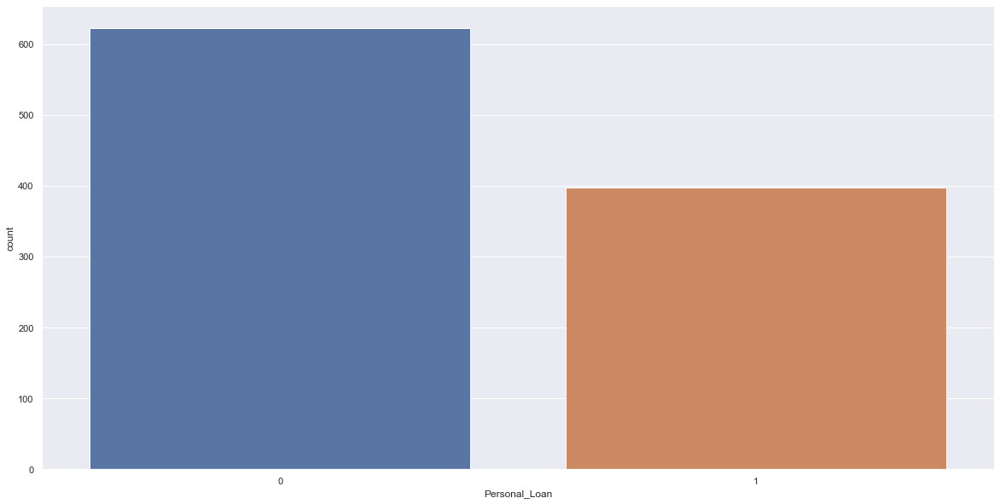

Securities_Account Count Plot


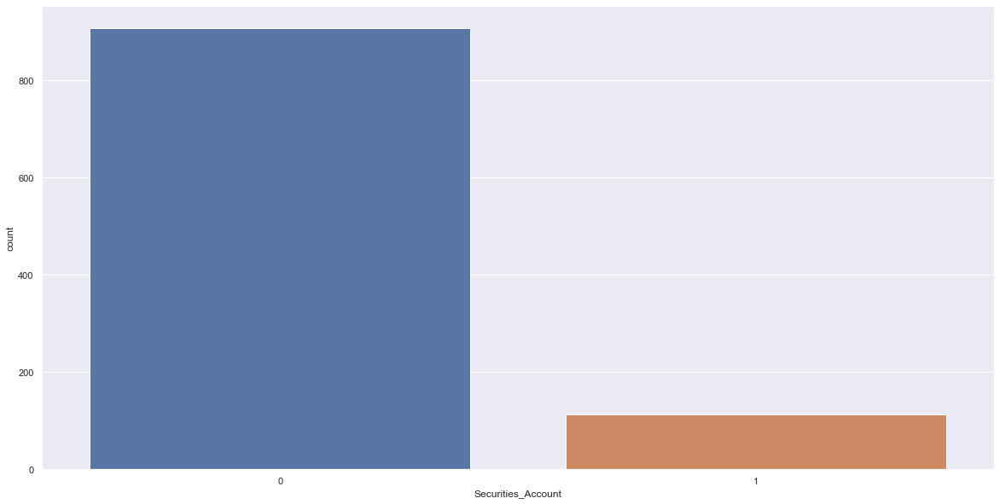

CD_Account Count Plot


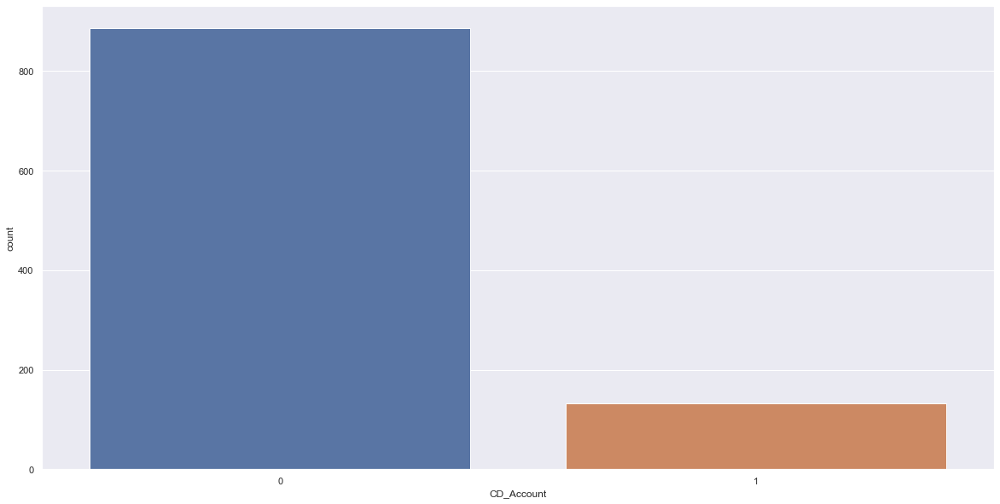

Online Count Plot


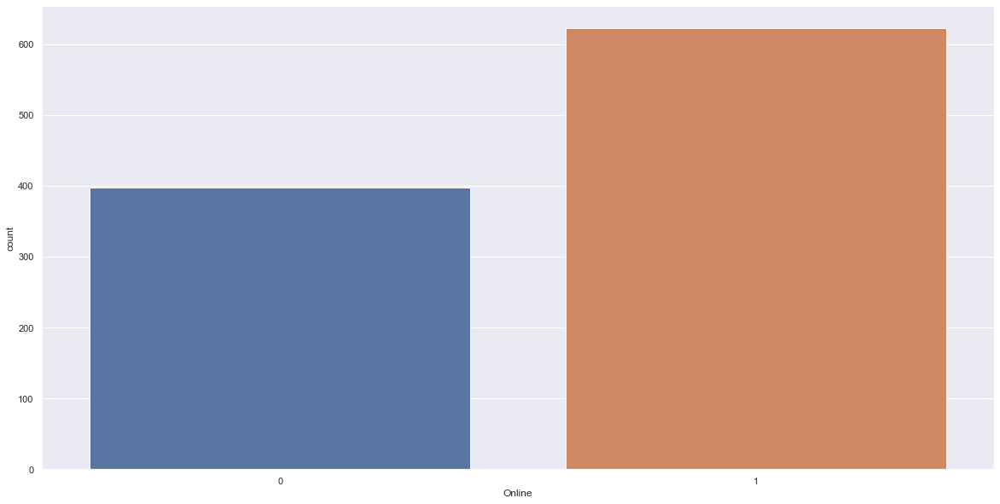

CreditCard Count Plot


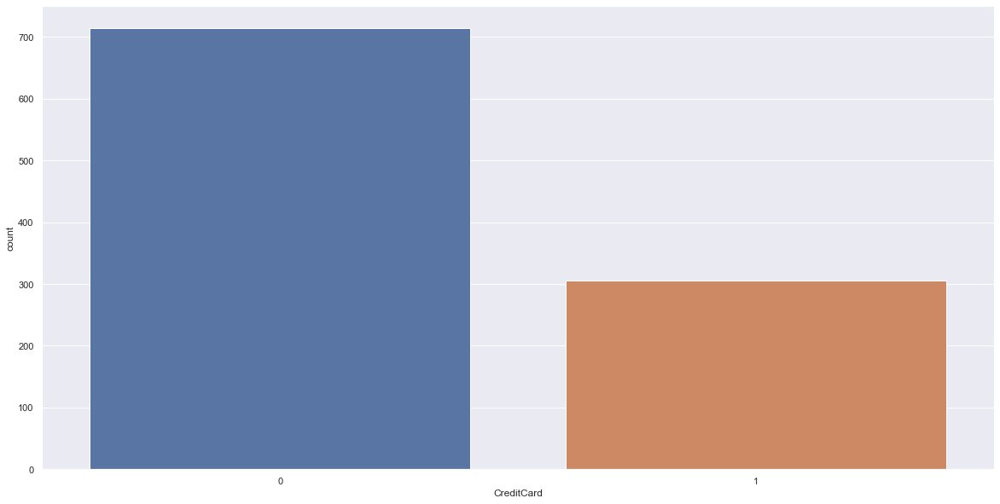

ZIPCode_91 Count Plot


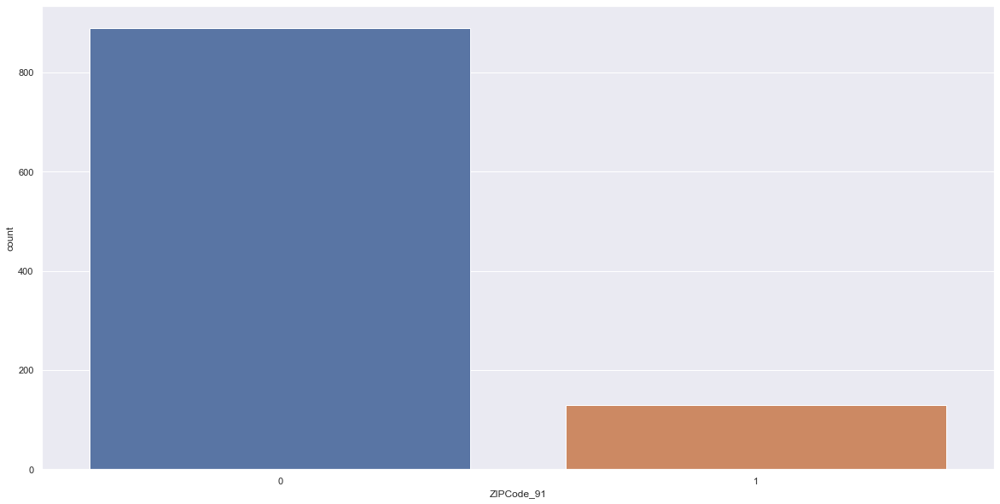

ZIPCode_92 Count Plot


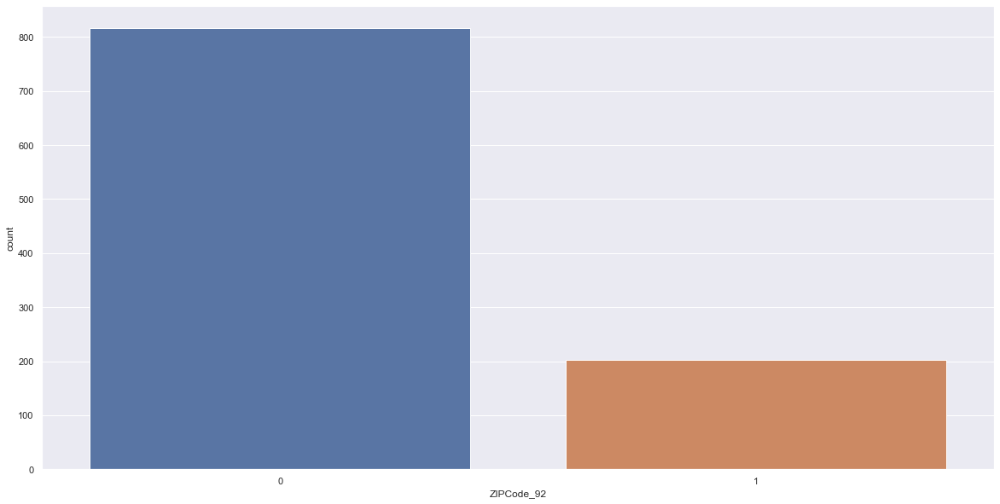

ZIPCode_93 Count Plot


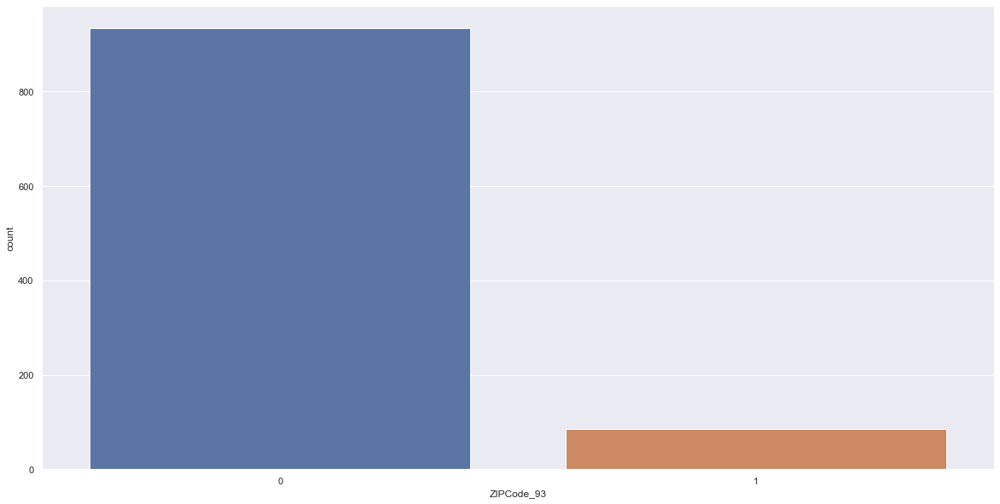

ZIPCode_94 Count Plot


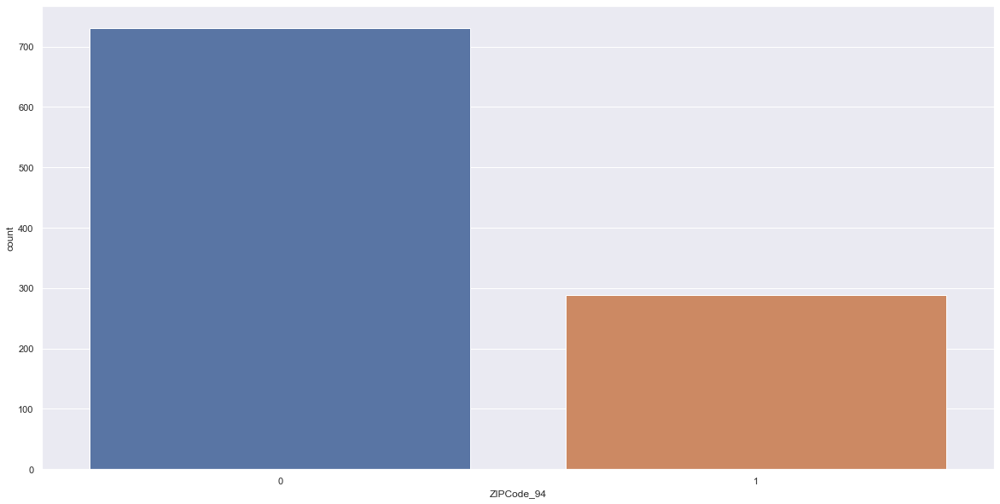

ZIPCode_95 Count Plot


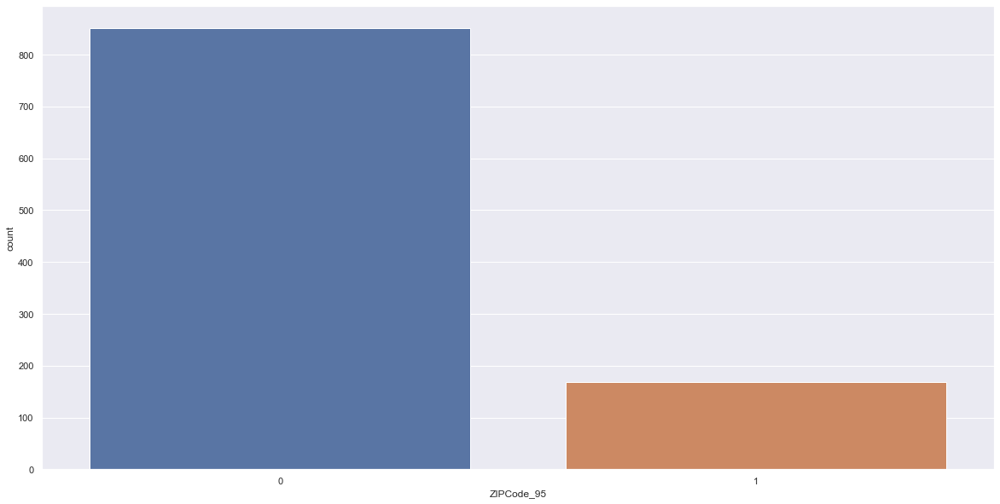

ZIPCode_96 Count Plot


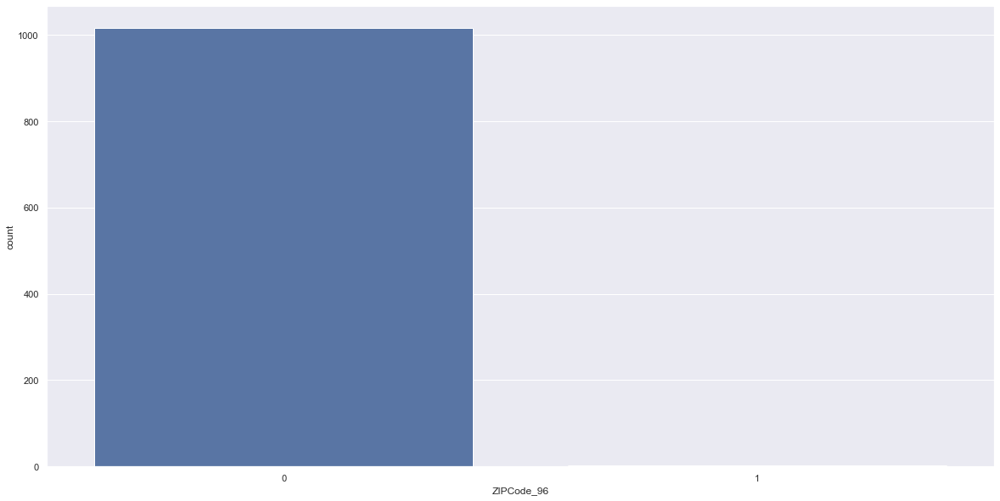

Education_Professional Count Plot


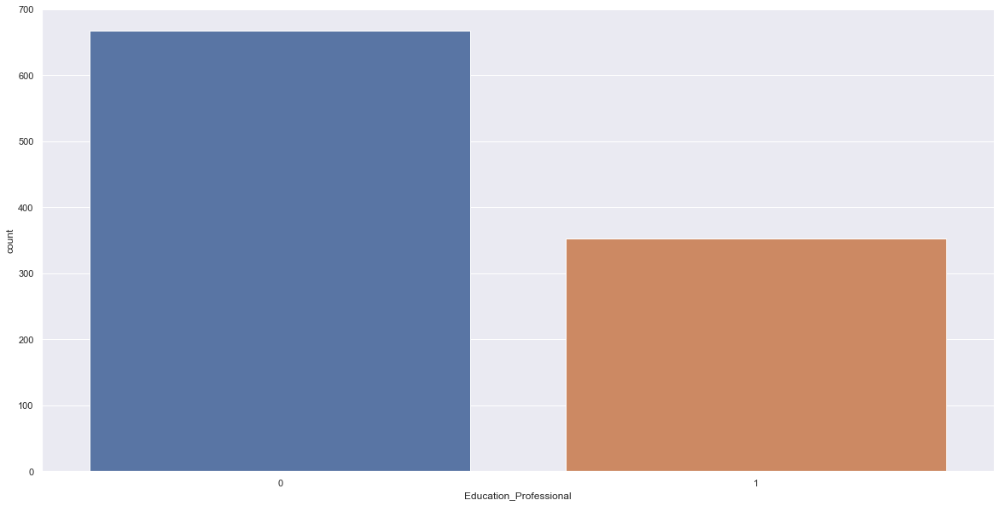

Education_Undergraduate Count Plot


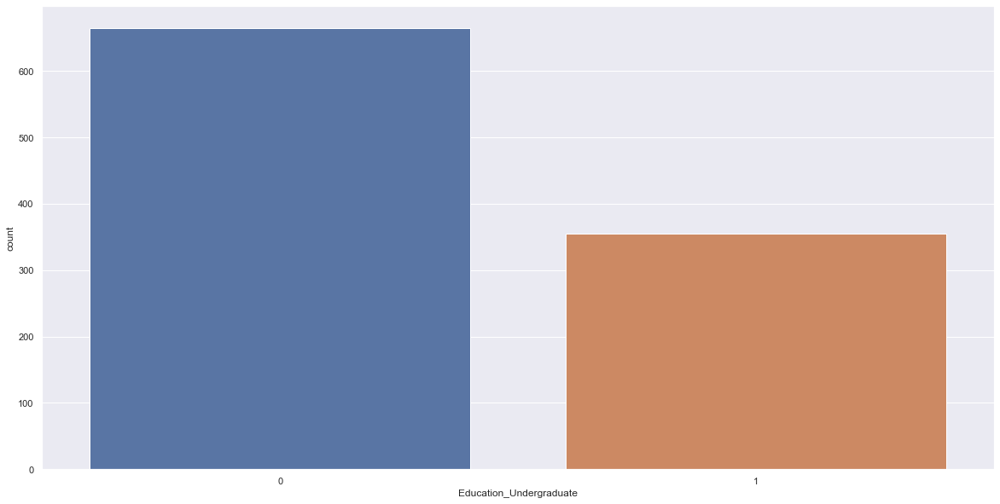

preds Count Plot


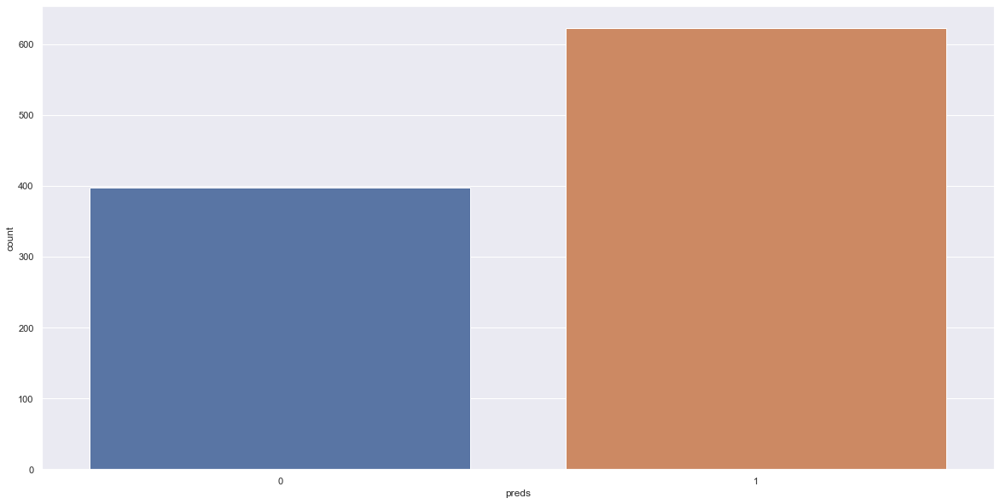

Age Histogram


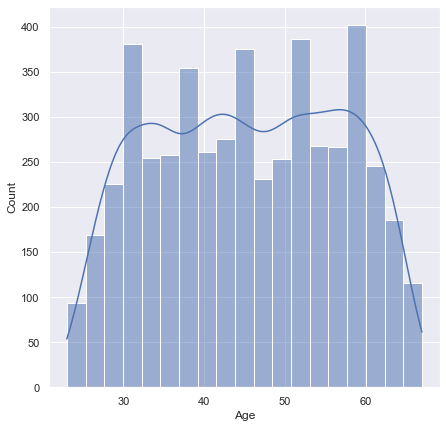

<Figure size 1440x720 with 0 Axes>

Age Density Plot


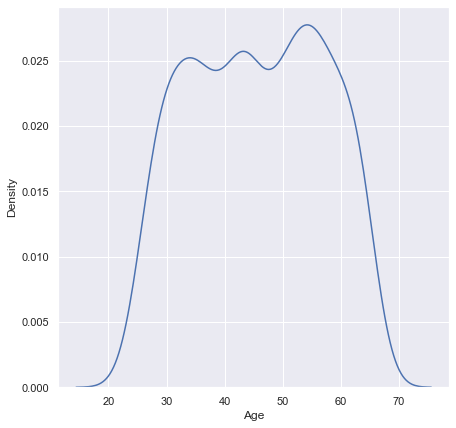

<Figure size 1440x720 with 0 Axes>

Age Box Plot


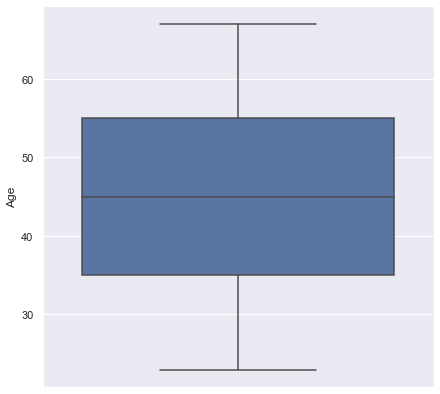

<Figure size 1440x720 with 0 Axes>

Experience Histogram


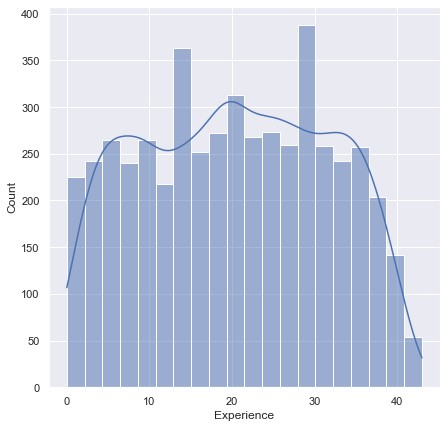

<Figure size 1440x720 with 0 Axes>

Experience Density Plot


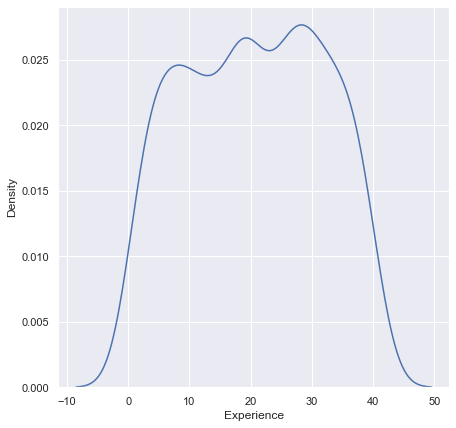

<Figure size 1440x720 with 0 Axes>

Experience Box Plot


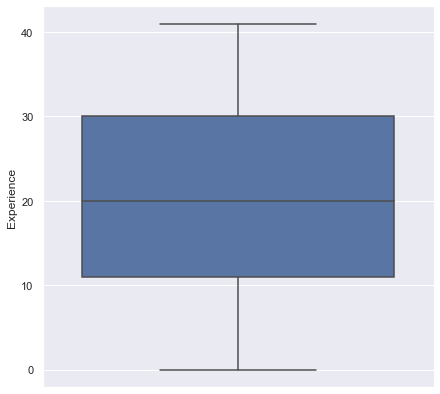

<Figure size 1440x720 with 0 Axes>

Income Histogram


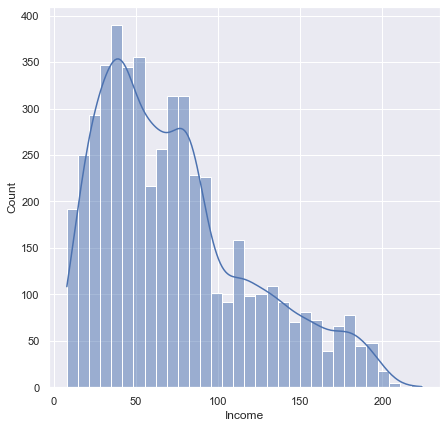

<Figure size 1440x720 with 0 Axes>

Income Density Plot


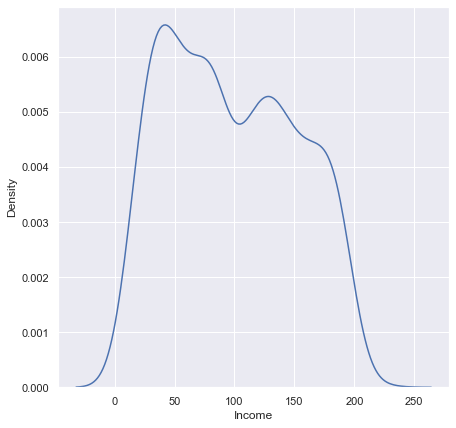

<Figure size 1440x720 with 0 Axes>

Income Box Plot


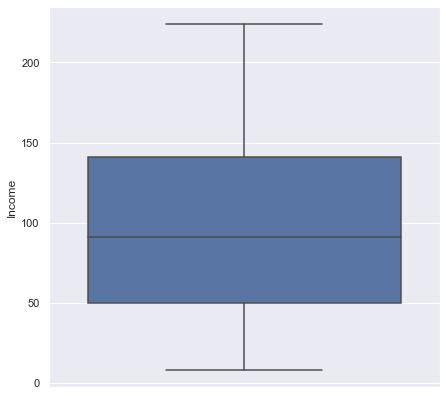

<Figure size 1440x720 with 0 Axes>

Family Histogram


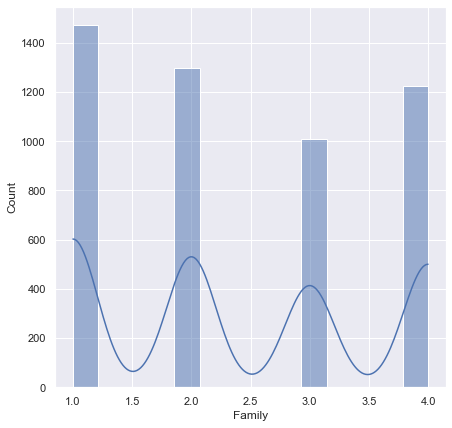

<Figure size 1440x720 with 0 Axes>

Family Density Plot


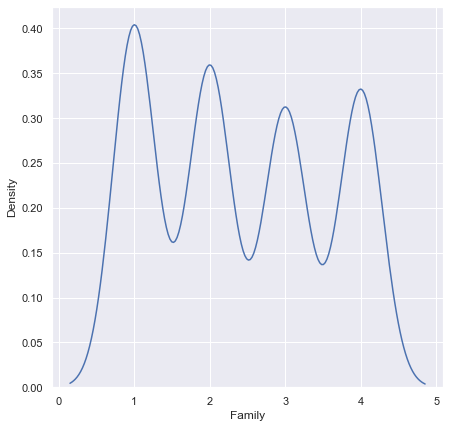

<Figure size 1440x720 with 0 Axes>

Family Box Plot


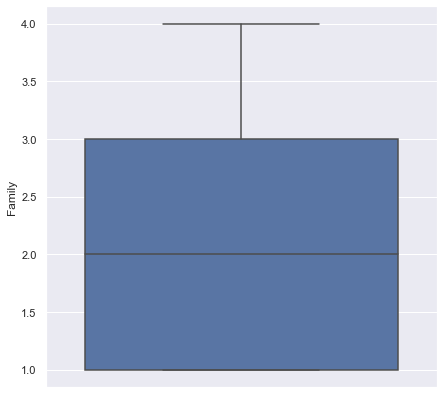

<Figure size 1440x720 with 0 Axes>

CCAvg Histogram


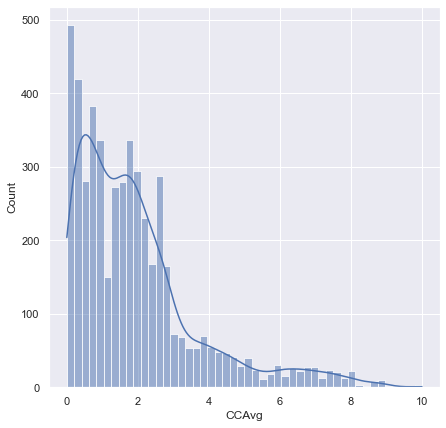

<Figure size 1440x720 with 0 Axes>

CCAvg Density Plot


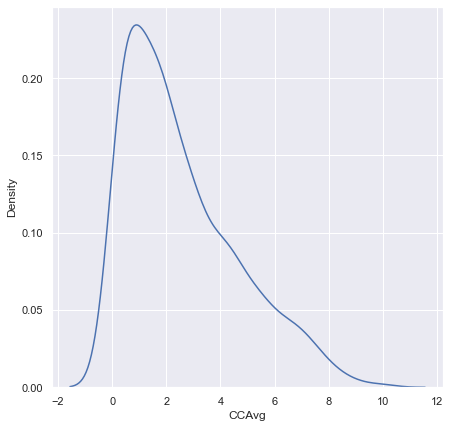

<Figure size 1440x720 with 0 Axes>

CCAvg Box Plot


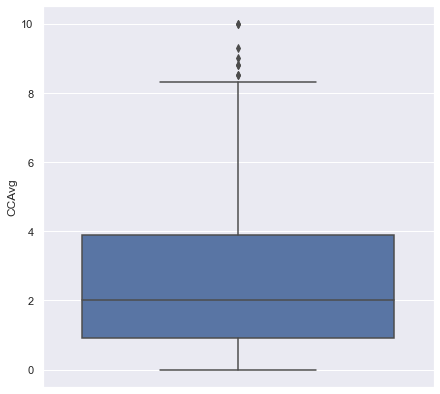

<Figure size 1440x720 with 0 Axes>

Mortgage Histogram


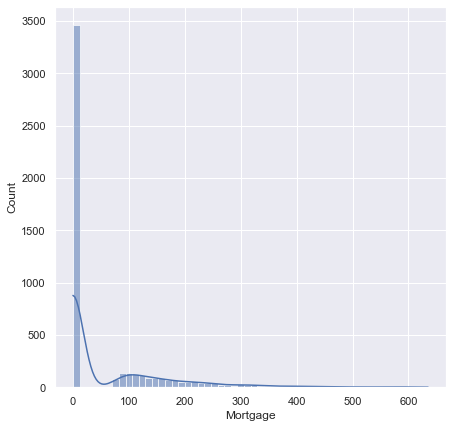

<Figure size 1440x720 with 0 Axes>

Mortgage Density Plot


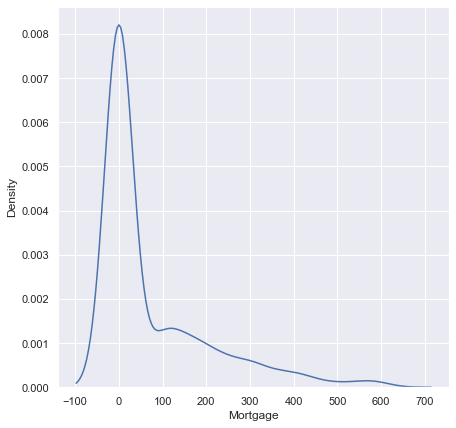

<Figure size 1440x720 with 0 Axes>

Mortgage Box Plot


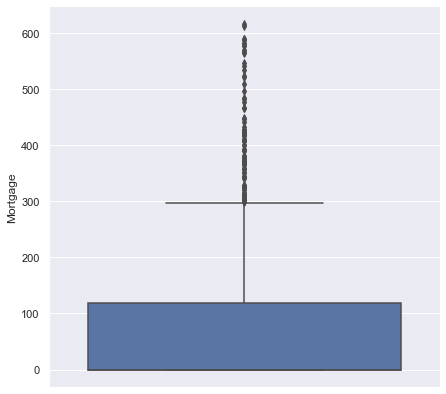

<Figure size 1440x720 with 0 Axes>

Personal_Loan Histogram


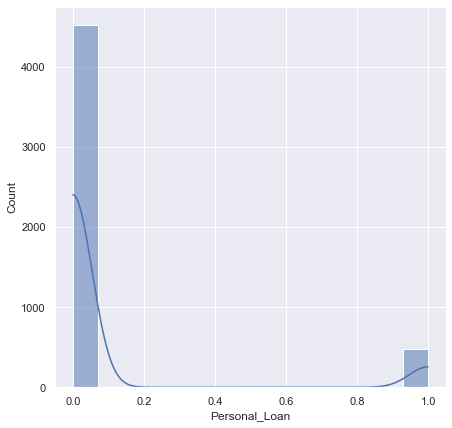

<Figure size 1440x720 with 0 Axes>

Personal_Loan Density Plot


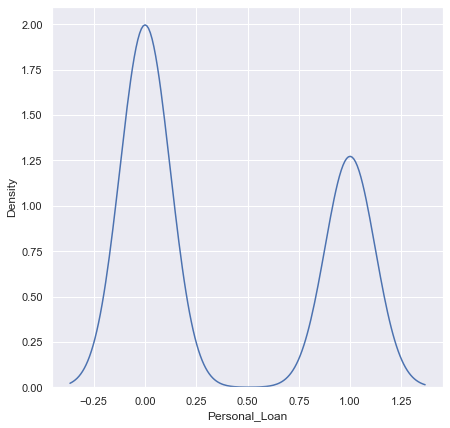

<Figure size 1440x720 with 0 Axes>

Personal_Loan Box Plot


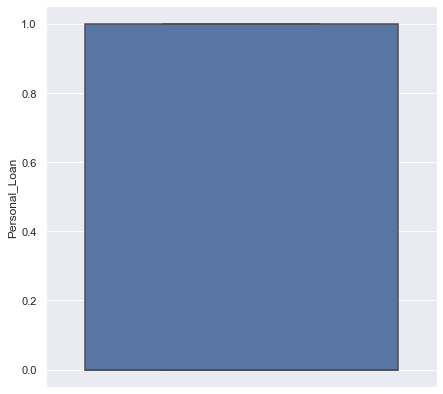

<Figure size 1440x720 with 0 Axes>

Securities_Account Histogram


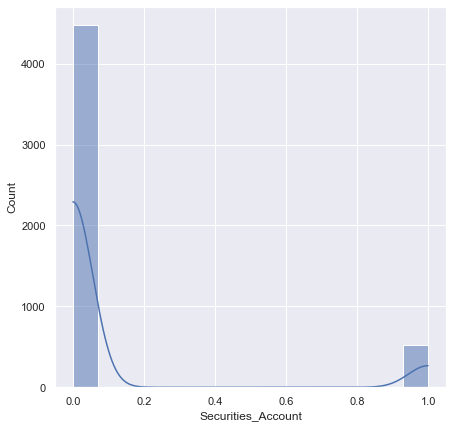

<Figure size 1440x720 with 0 Axes>

Securities_Account Density Plot


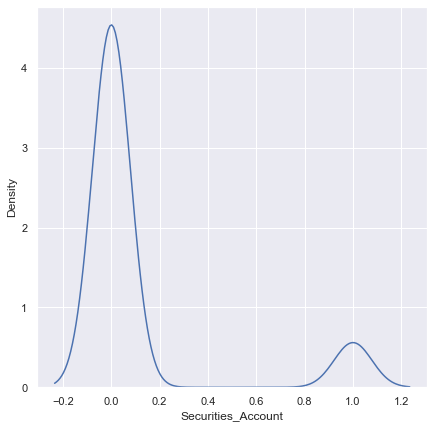

<Figure size 1440x720 with 0 Axes>

Securities_Account Box Plot


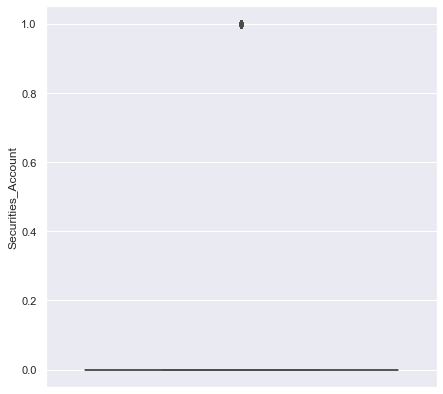

<Figure size 1440x720 with 0 Axes>

CD_Account Histogram


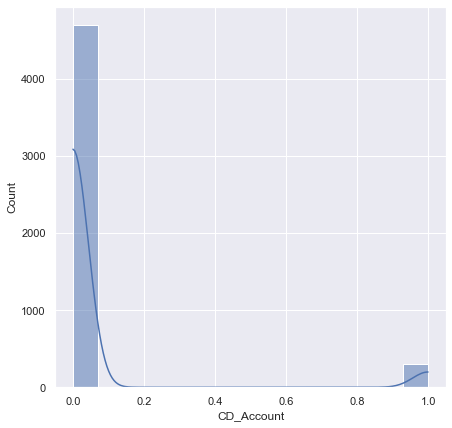

<Figure size 1440x720 with 0 Axes>

CD_Account Density Plot


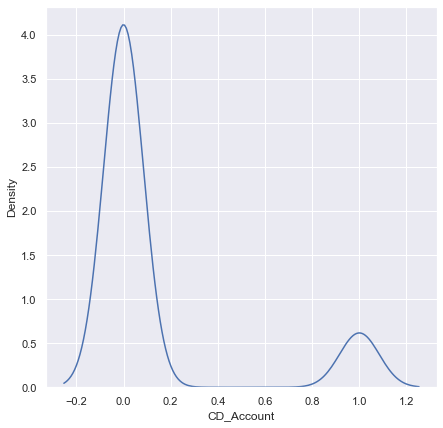

<Figure size 1440x720 with 0 Axes>

CD_Account Box Plot


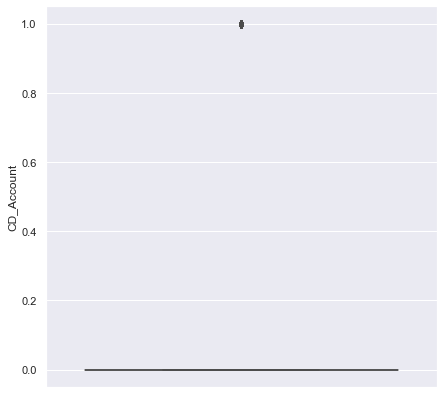

<Figure size 1440x720 with 0 Axes>

Online Histogram


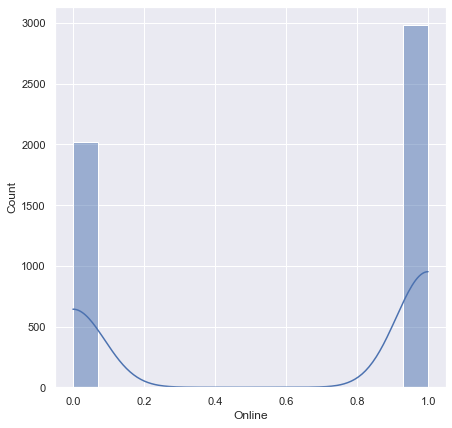

<Figure size 1440x720 with 0 Axes>

Online Density Plot


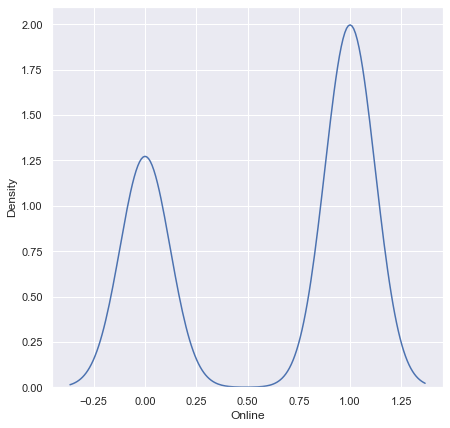

<Figure size 1440x720 with 0 Axes>

Online Box Plot


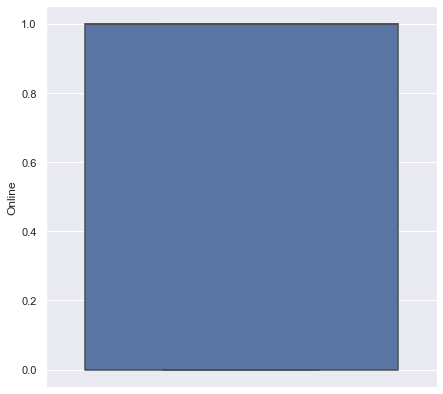

<Figure size 1440x720 with 0 Axes>

CreditCard Histogram


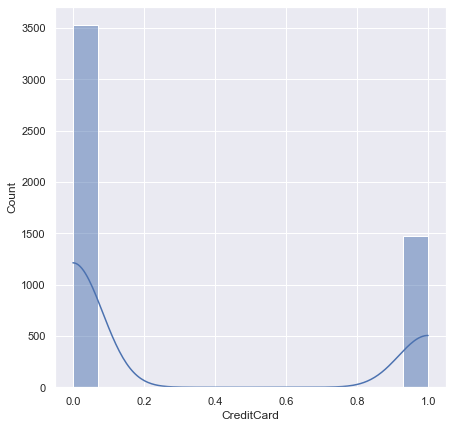

<Figure size 1440x720 with 0 Axes>

CreditCard Density Plot


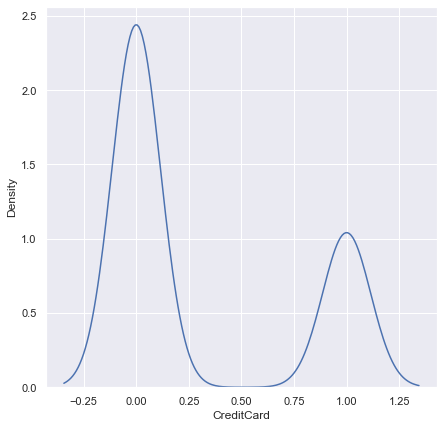

<Figure size 1440x720 with 0 Axes>

CreditCard Box Plot


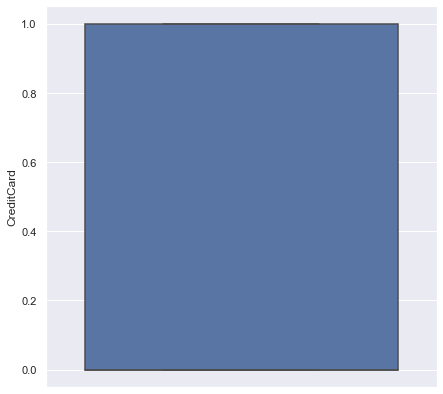

<Figure size 1440x720 with 0 Axes>

ZIPCode_91 Histogram


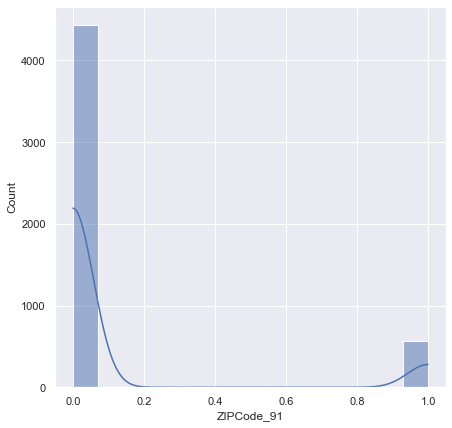

<Figure size 1440x720 with 0 Axes>

ZIPCode_91 Density Plot


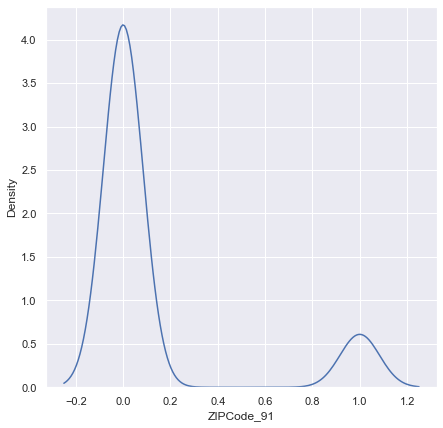

<Figure size 1440x720 with 0 Axes>

ZIPCode_91 Box Plot


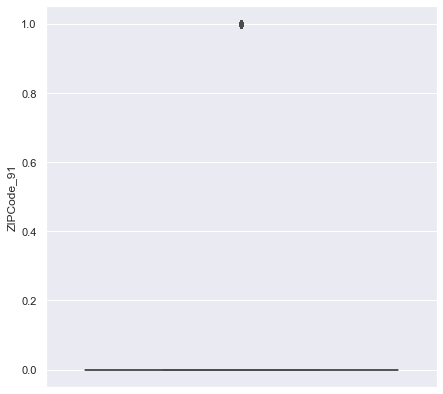

<Figure size 1440x720 with 0 Axes>

ZIPCode_92 Histogram


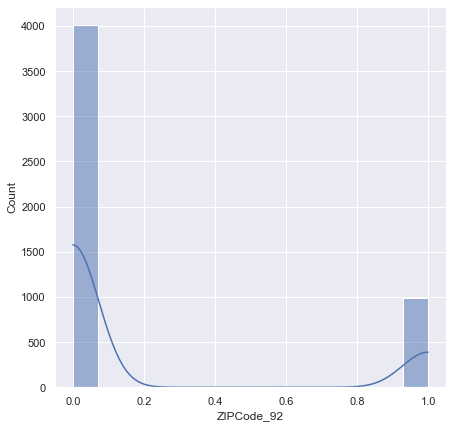

<Figure size 1440x720 with 0 Axes>

ZIPCode_92 Density Plot


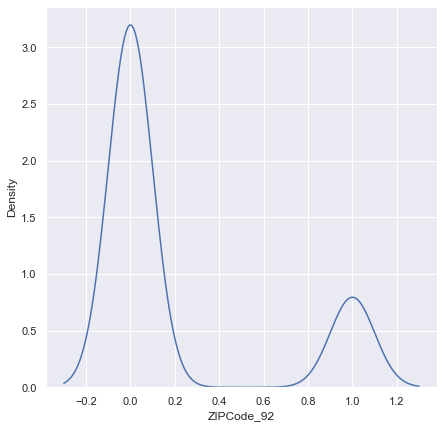

<Figure size 1440x720 with 0 Axes>

ZIPCode_92 Box Plot


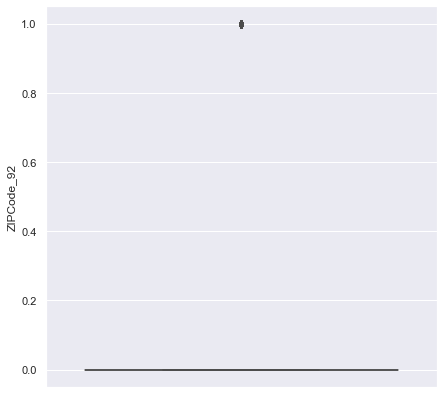

<Figure size 1440x720 with 0 Axes>

ZIPCode_93 Histogram


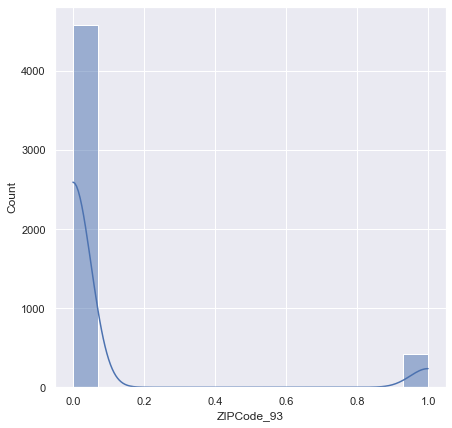

<Figure size 1440x720 with 0 Axes>

ZIPCode_93 Density Plot


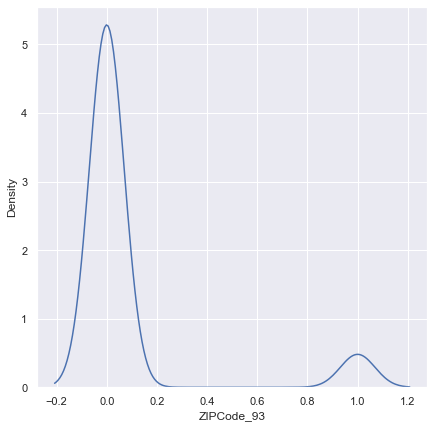

<Figure size 1440x720 with 0 Axes>

ZIPCode_93 Box Plot


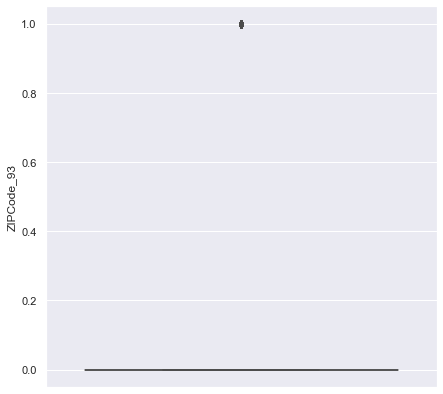

<Figure size 1440x720 with 0 Axes>

ZIPCode_94 Histogram


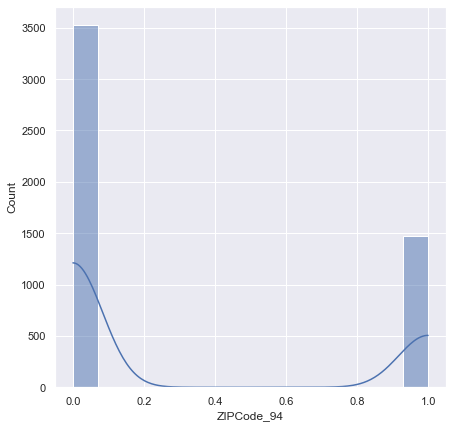

<Figure size 1440x720 with 0 Axes>

ZIPCode_94 Density Plot


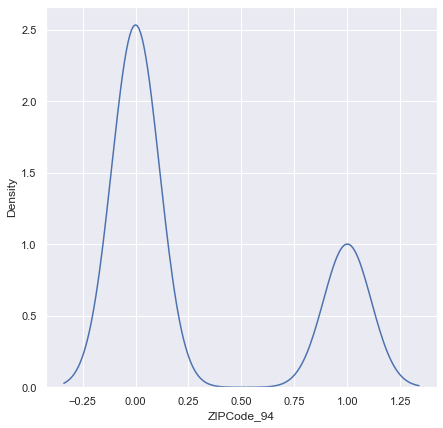

<Figure size 1440x720 with 0 Axes>

ZIPCode_94 Box Plot


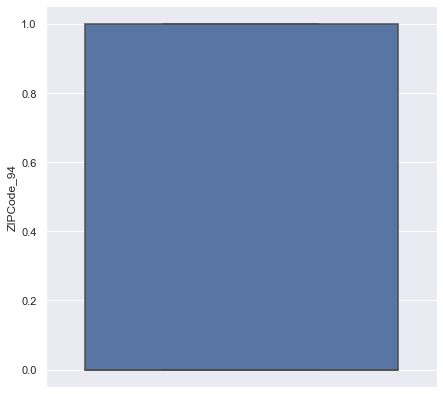

<Figure size 1440x720 with 0 Axes>

ZIPCode_95 Histogram


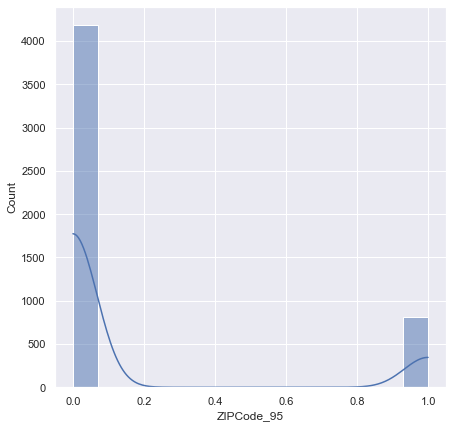

<Figure size 1440x720 with 0 Axes>

ZIPCode_95 Density Plot


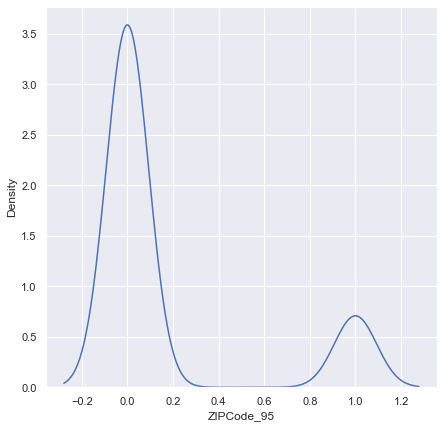

<Figure size 1440x720 with 0 Axes>

ZIPCode_95 Box Plot


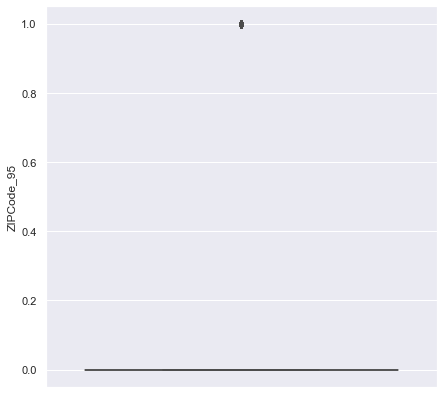

<Figure size 1440x720 with 0 Axes>

ZIPCode_96 Histogram


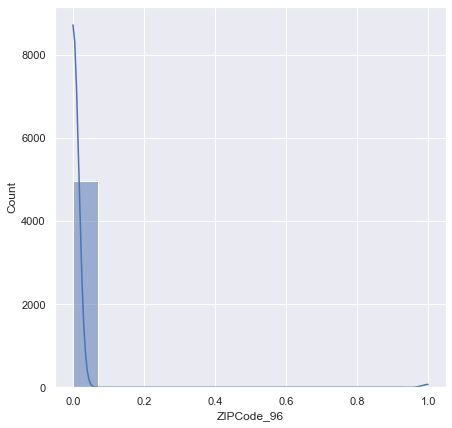

<Figure size 1440x720 with 0 Axes>

ZIPCode_96 Density Plot


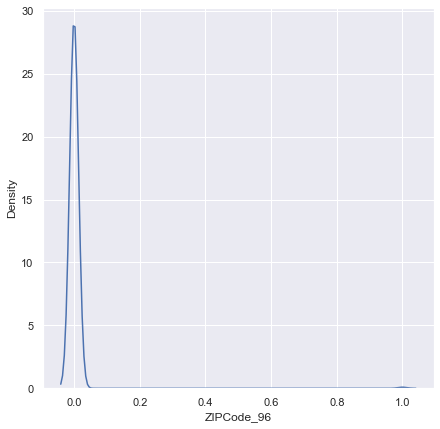

<Figure size 1440x720 with 0 Axes>

ZIPCode_96 Box Plot


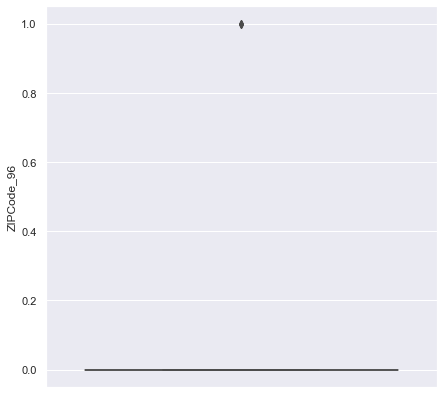

<Figure size 1440x720 with 0 Axes>

Education_Professional Histogram


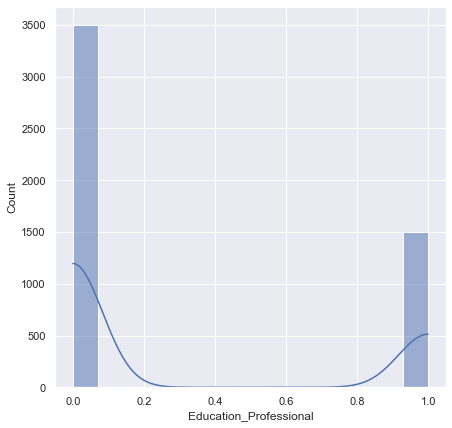

<Figure size 1440x720 with 0 Axes>

Education_Professional Density Plot


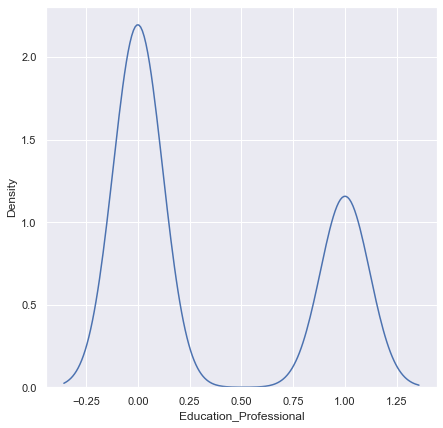

<Figure size 1440x720 with 0 Axes>

Education_Professional Box Plot


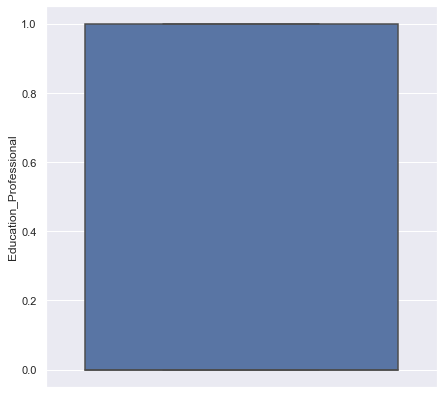

<Figure size 1440x720 with 0 Axes>

Education_Undergraduate Histogram


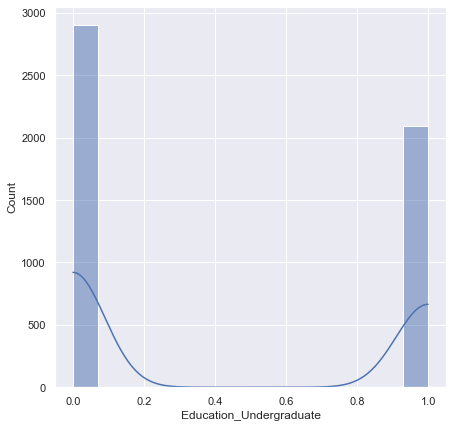

<Figure size 1440x720 with 0 Axes>

Education_Undergraduate Density Plot


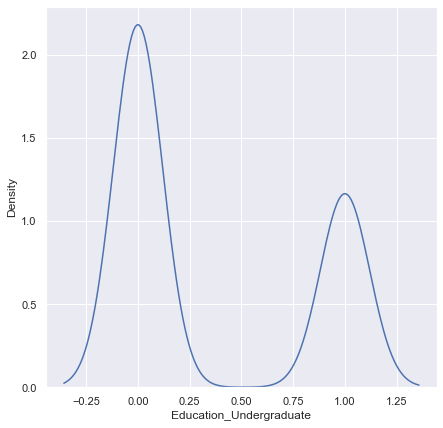

<Figure size 1440x720 with 0 Axes>

Education_Undergraduate Box Plot


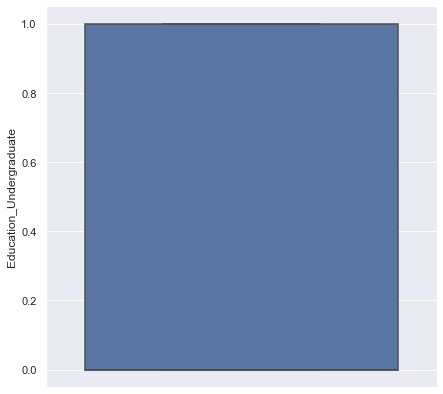

<Figure size 1440x720 with 0 Axes>

preds Histogram


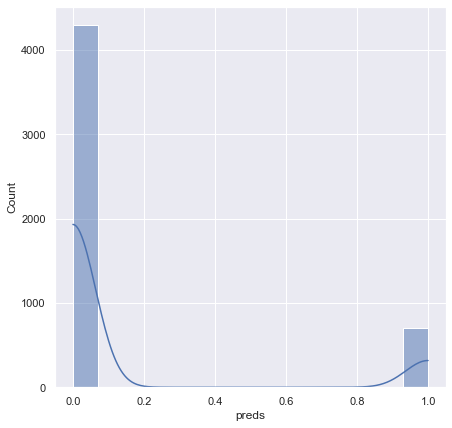

<Figure size 1440x720 with 0 Axes>

preds Density Plot


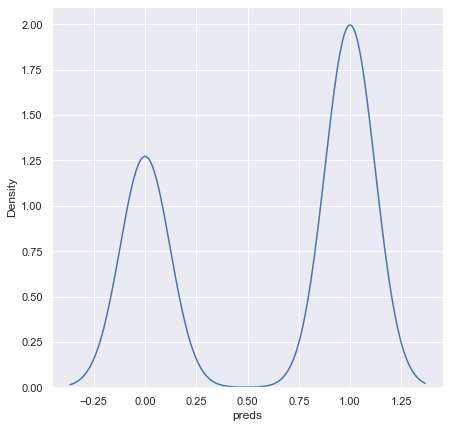

<Figure size 1440x720 with 0 Axes>

preds Box Plot


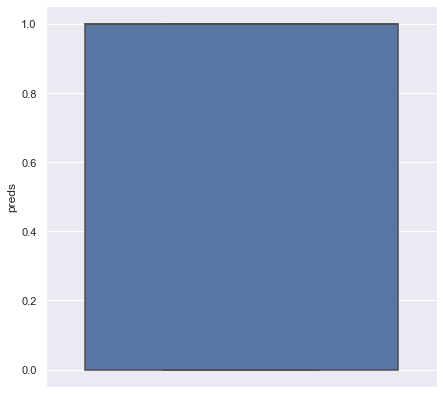

<Figure size 1440x720 with 0 Axes>

<IPython.core.display.Javascript object>

In [319]:
# Run dataframe through function
univar_vis(df_inc)

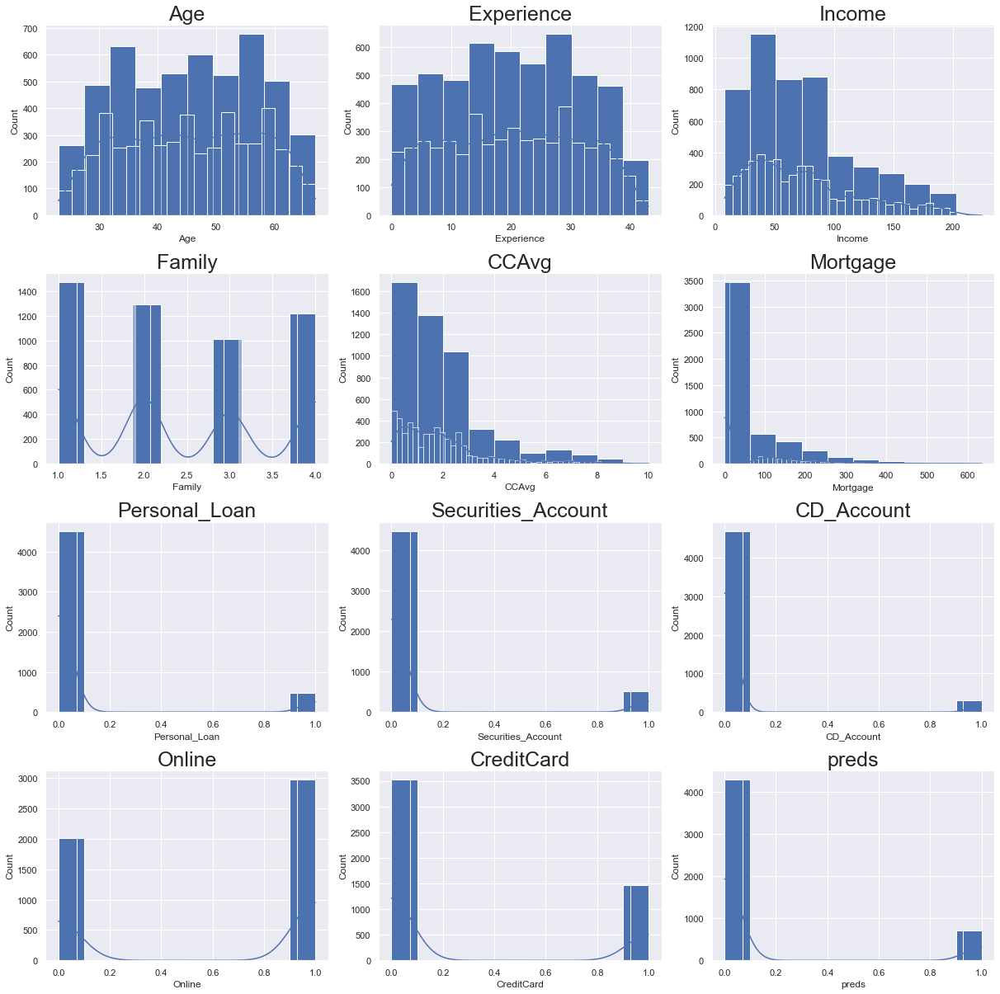

<IPython.core.display.Javascript object>

In [320]:
# From DSBA_SLF_MLS1_LifeExpectancyCaseStudy
all_col = df_inc.select_dtypes(include=["float64", "int64"]).columns.tolist()

plt.figure(figsize=(17, 75))

for i in range(len(all_col)):
    plt.subplot(18, 3, i + 1)
    plt.hist(df[all_col[i]])
    sns.histplot(
        df[all_col[i]], kde=True
    )  # you can comment the previous line and run this one to get distribution curves
    plt.tight_layout()
    plt.title(all_col[i], fontsize=25)

plt.show()

In [321]:
### Code from Mounika of GreatLearning as given in the Uber Case study ###

# While doing uni-variate analysis of numerical variables we want to study their central tendency
# and dispersion.
# Let us write a function that will help us create boxplot and histogram for any input numerical
# variable.
# This function takes the numerical column as the input and returns the boxplots
# and histograms for the variable.
# Let us see if this help us write faster and cleaner code.
def histogram_boxplot(feature, figsize=(15, 10), bins=None):
    """Boxplot and histogram combined
    feature: 1-d feature array
    figsize: size of fig (default (9,8))
    bins: number of bins (default None / auto)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    sns.boxplot(
        feature, ax=ax_box2, showmeans=True, color="red"
    )  # boxplot will be created and a star will indicate the mean value of the column
    sns.distplot(feature, kde=F, ax=ax_hist2, bins=bins) if bins else sns.distplot(
        feature, kde=False, ax=ax_hist2
    )  # For histogram
    ax_hist2.axvline(
        np.mean(feature), color="g", linestyle="--"
    )  # Add mean to the histogram
    ax_hist2.axvline(
        np.median(feature), color="black", linestyle="-"
    )  # Add median to the histogram

<IPython.core.display.Javascript object>

Age                        None
Experience                 None
Income                     None
Family                     None
CCAvg                      None
Mortgage                   None
Personal_Loan              None
Securities_Account         None
CD_Account                 None
Online                     None
CreditCard                 None
ZIPCode_91                 None
ZIPCode_92                 None
ZIPCode_93                 None
ZIPCode_94                 None
ZIPCode_95                 None
ZIPCode_96                 None
Education_Professional     None
Education_Undergraduate    None
preds                      None
dtype: object

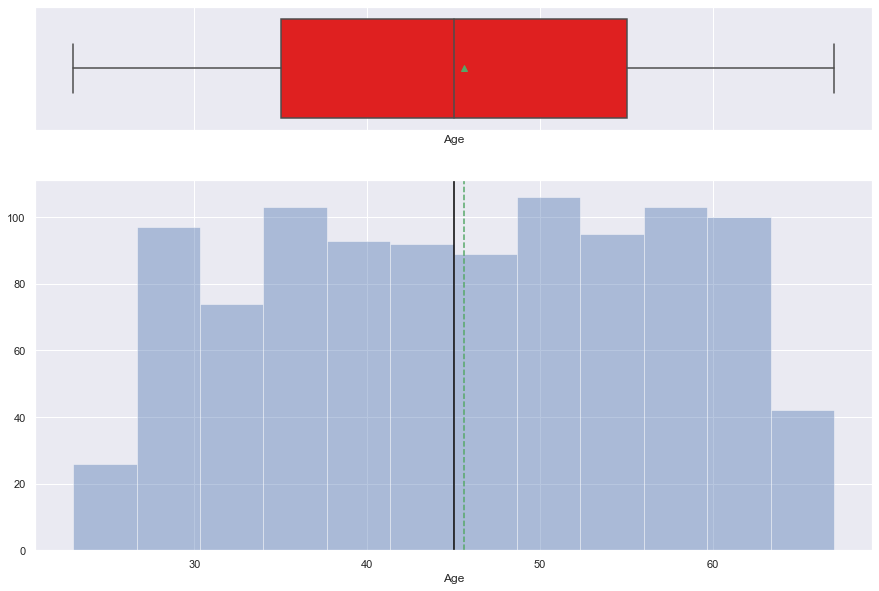

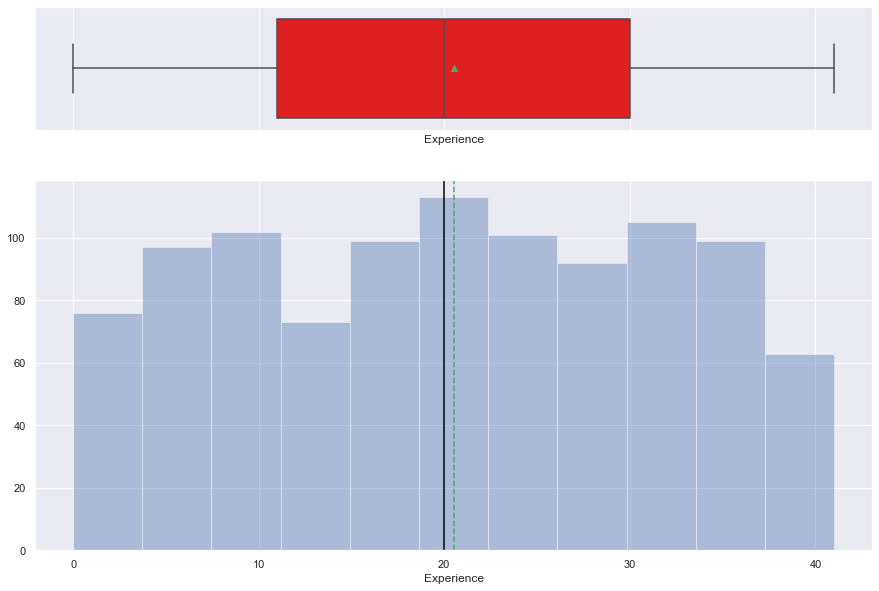

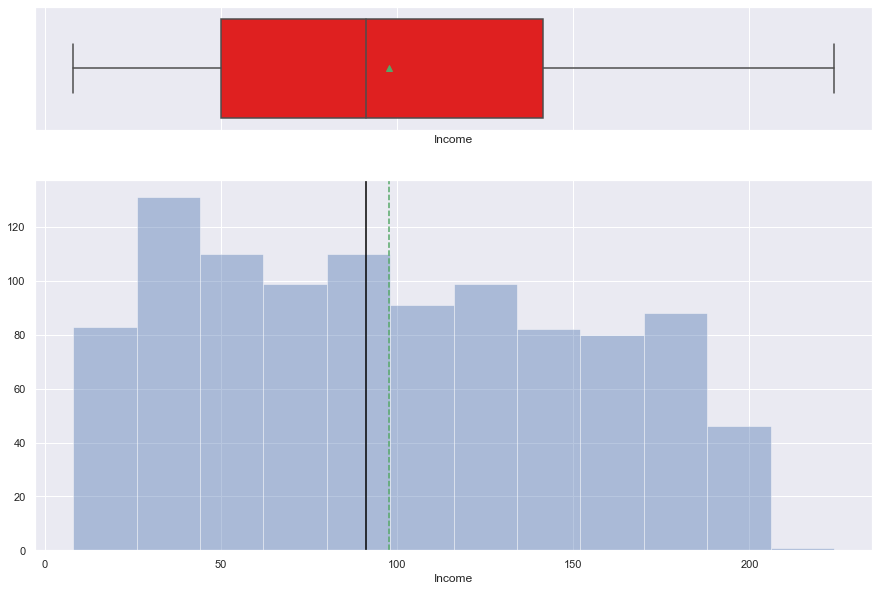

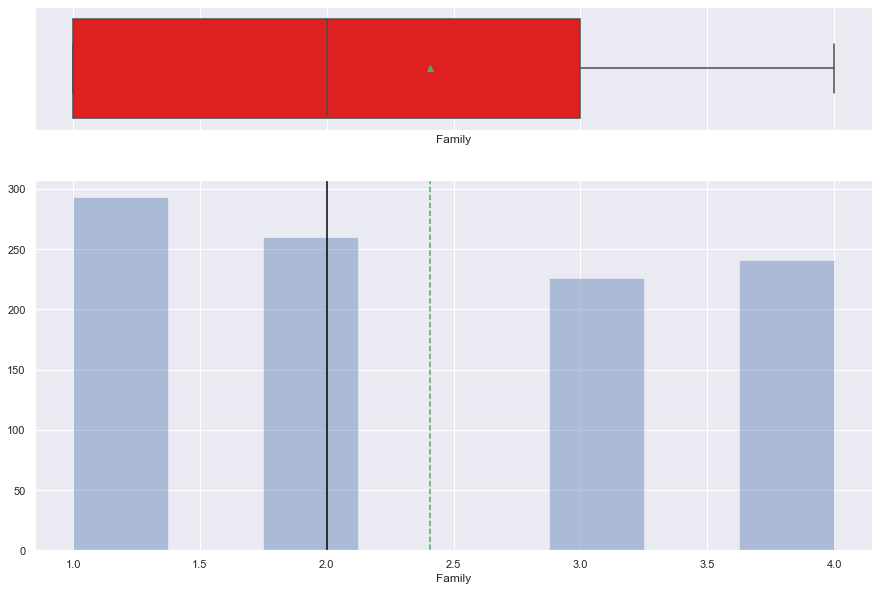

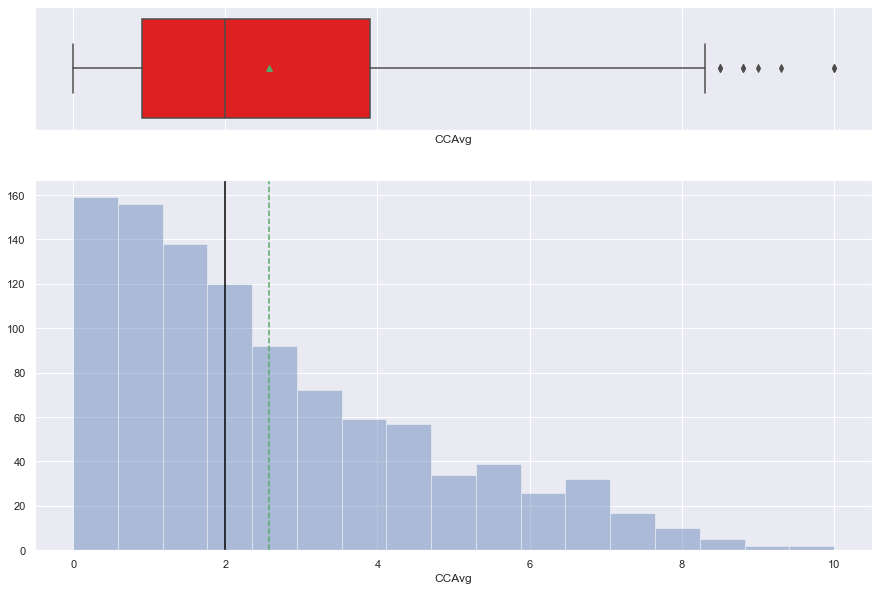

...

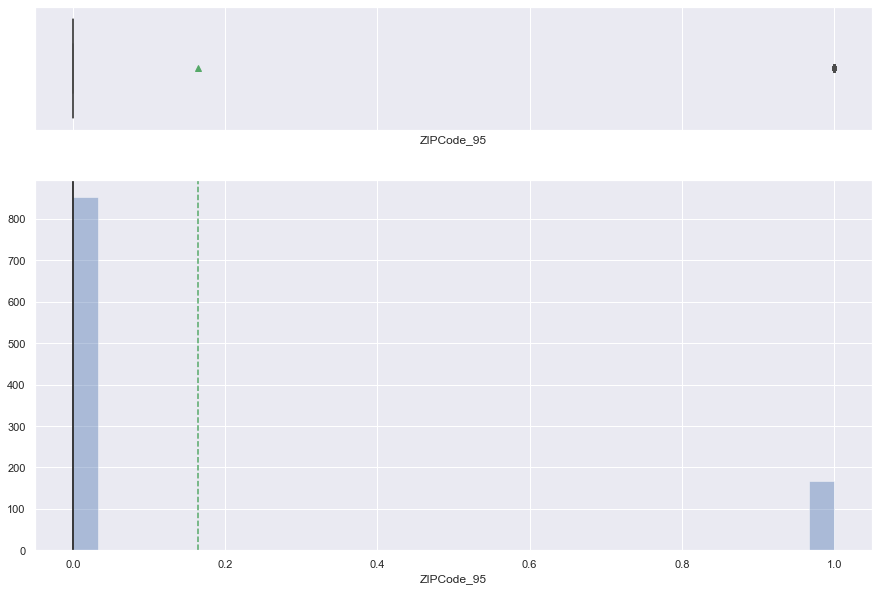

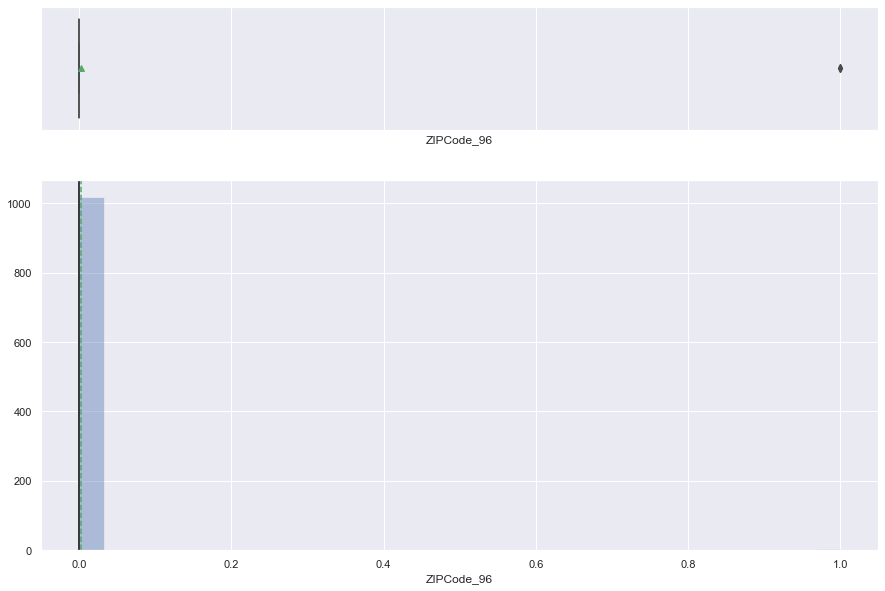

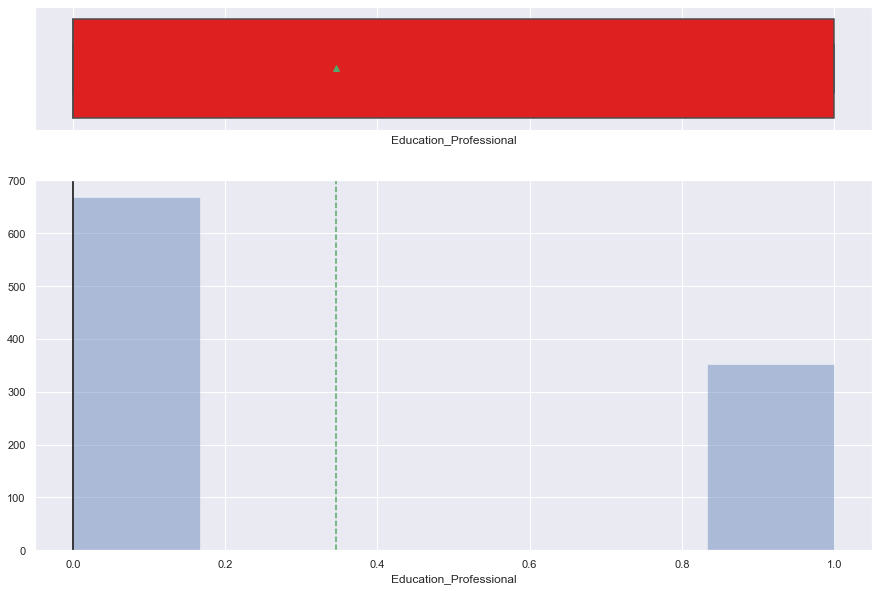

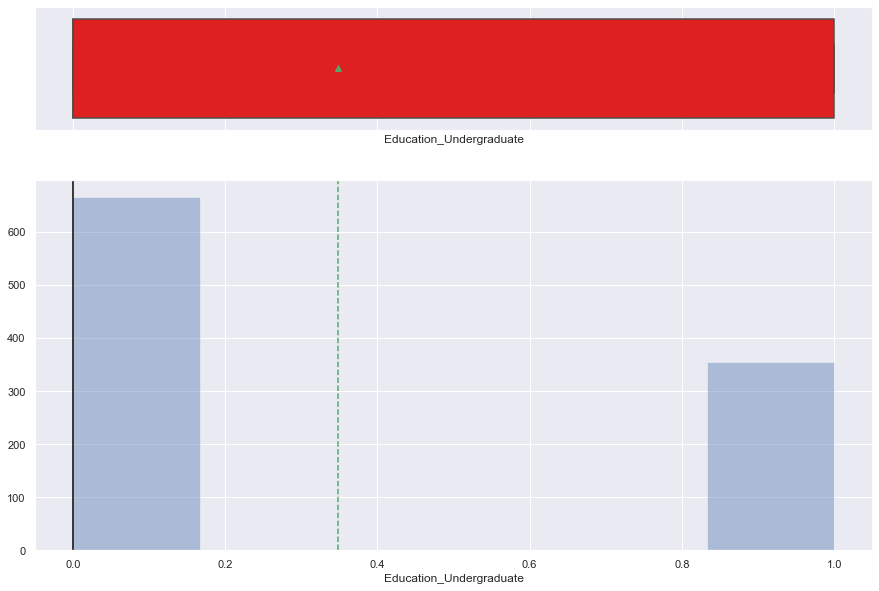

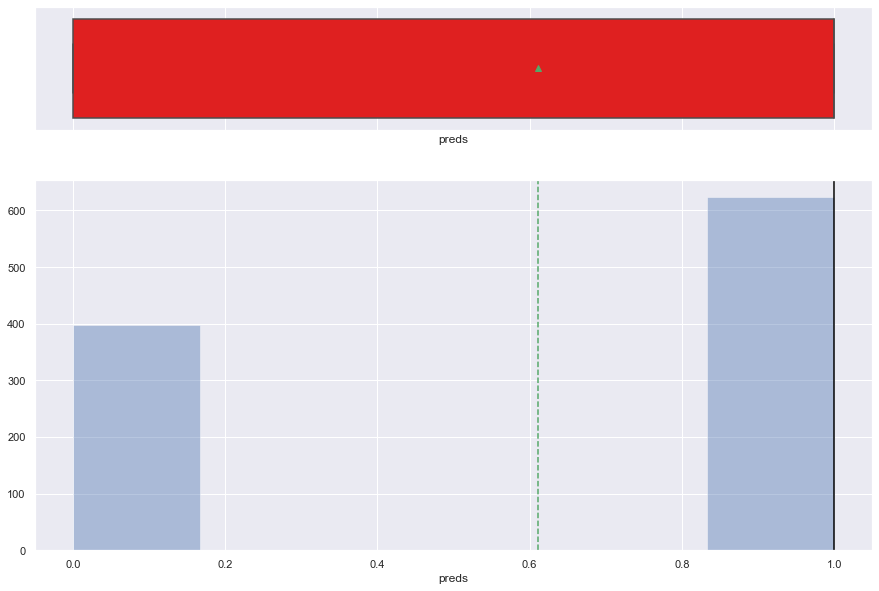

<IPython.core.display.Javascript object>

In [322]:
display(df_inc.apply(lambda x: histogram_boxplot(x)))

### Bivariate Distributions

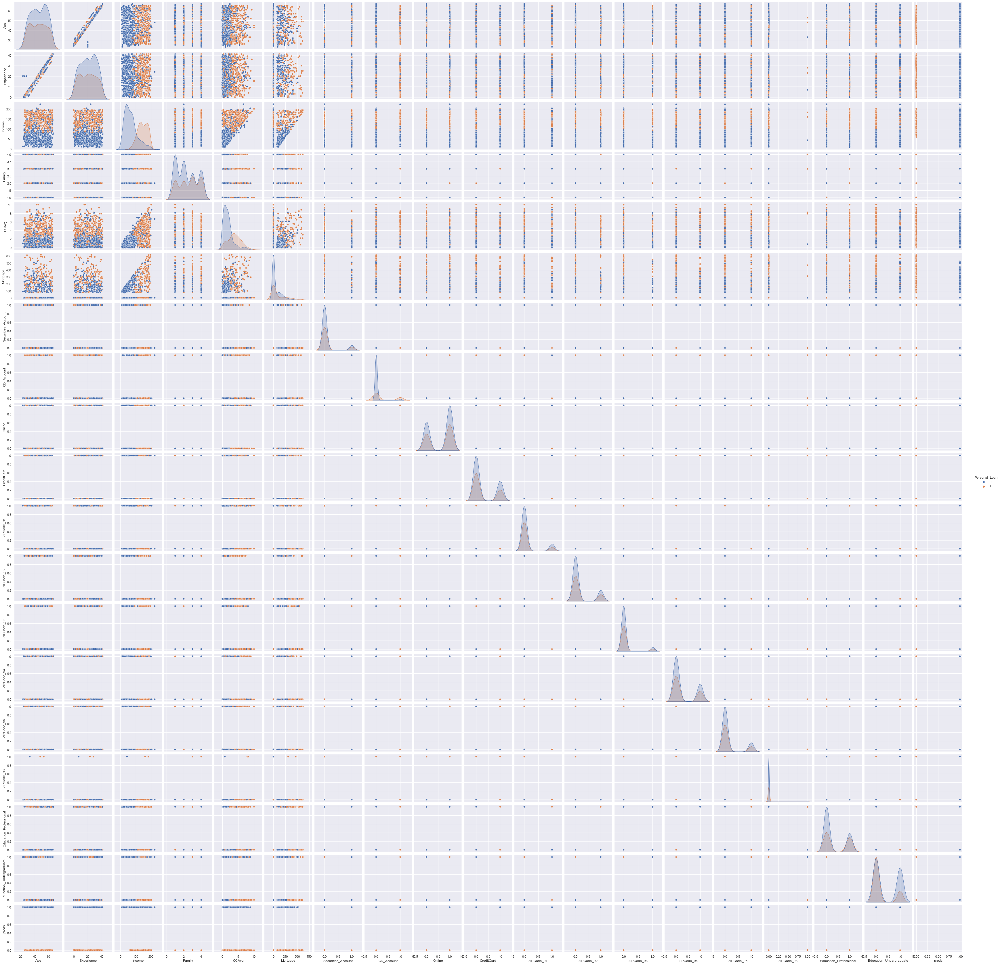

<IPython.core.display.Javascript object>

In [323]:
# Covariance analysis
sns.pairplot(
    data=df_inc, hue="Personal_Loan",
)
plt.show()

#### Categoricals

Age by Securities_Account Bar Plot


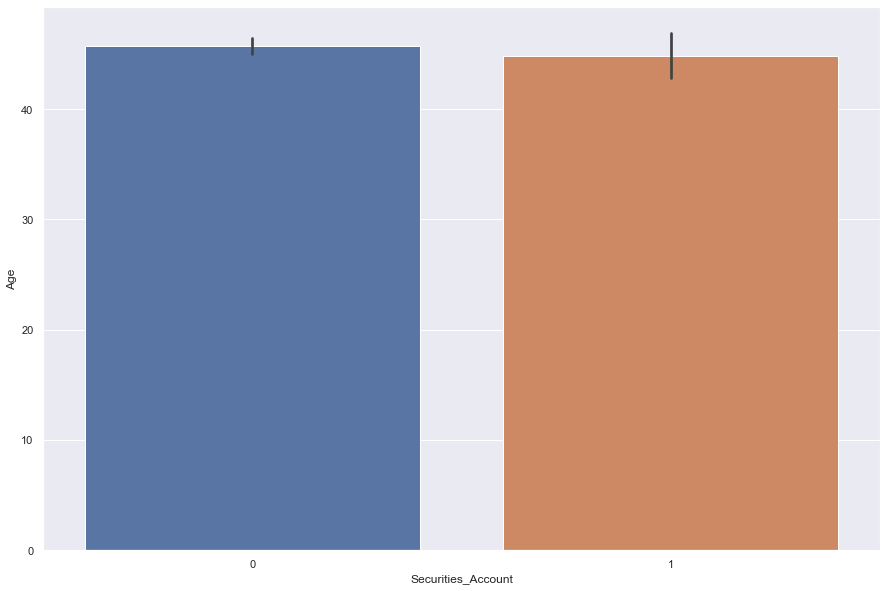

Age by Securities_Account Box Plot


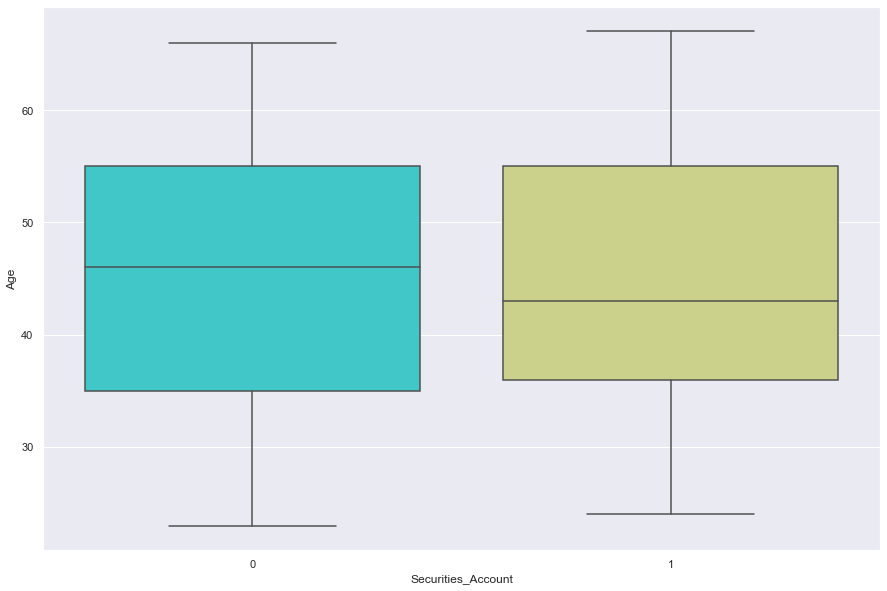

Age by Securities_Account Strip Plot


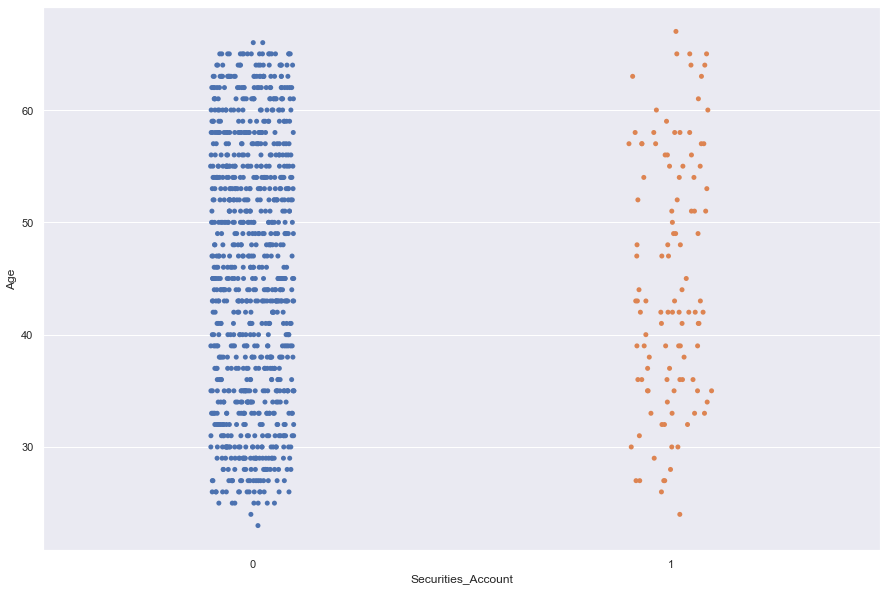

Age by CD_Account Bar Plot


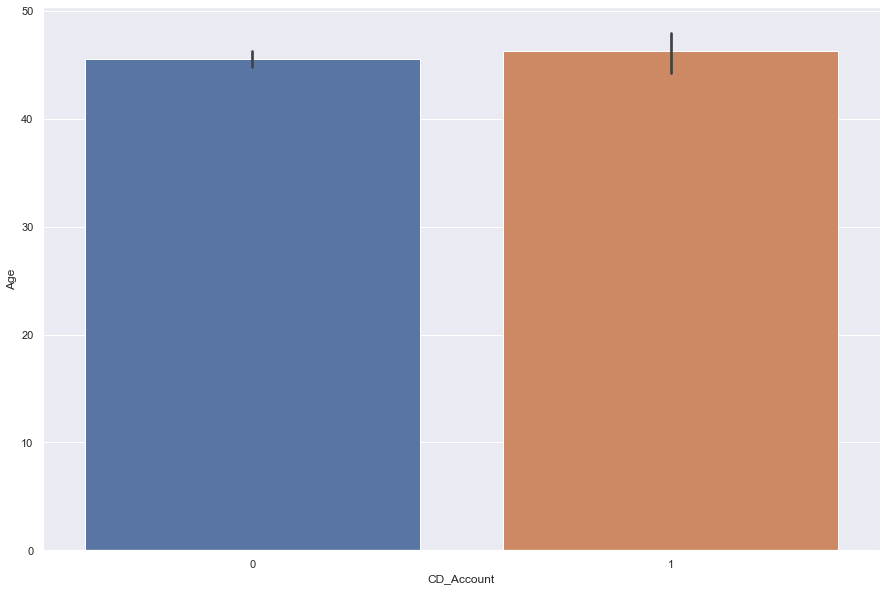

Age by CD_Account Box Plot


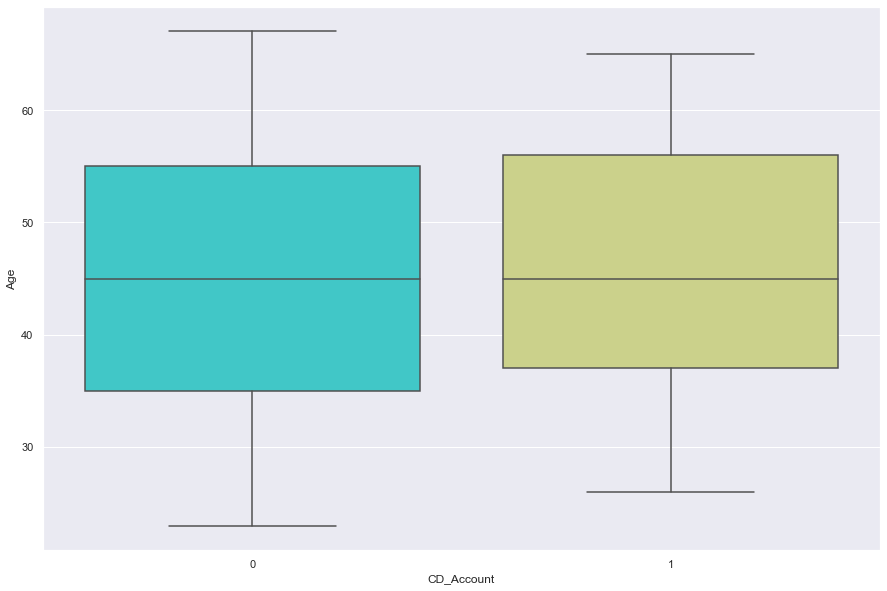

Age by CD_Account Strip Plot


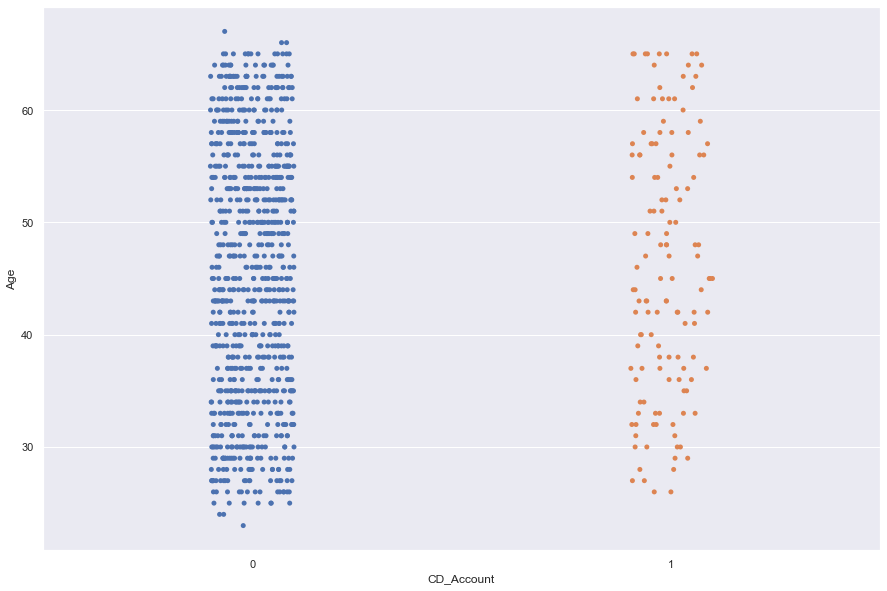

Age by Online Bar Plot


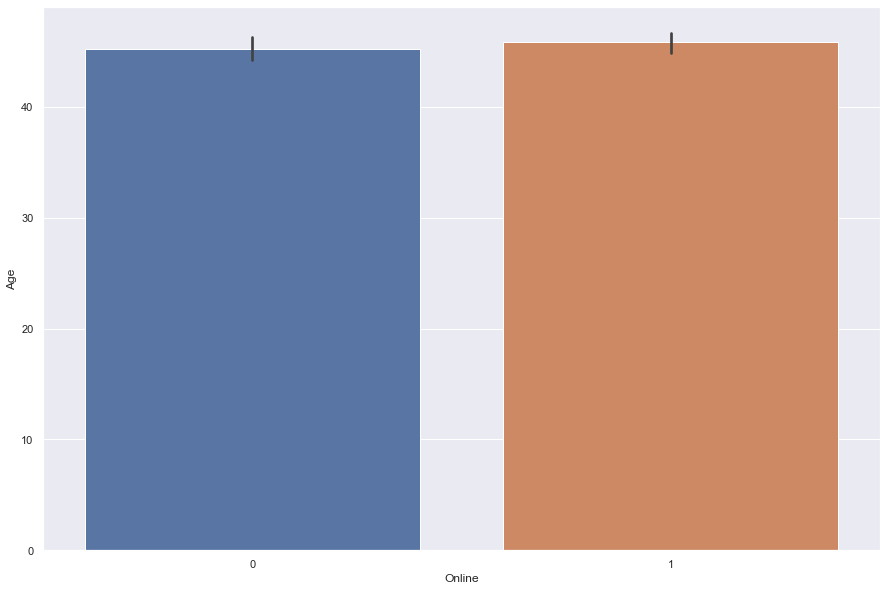

Age by Online Box Plot


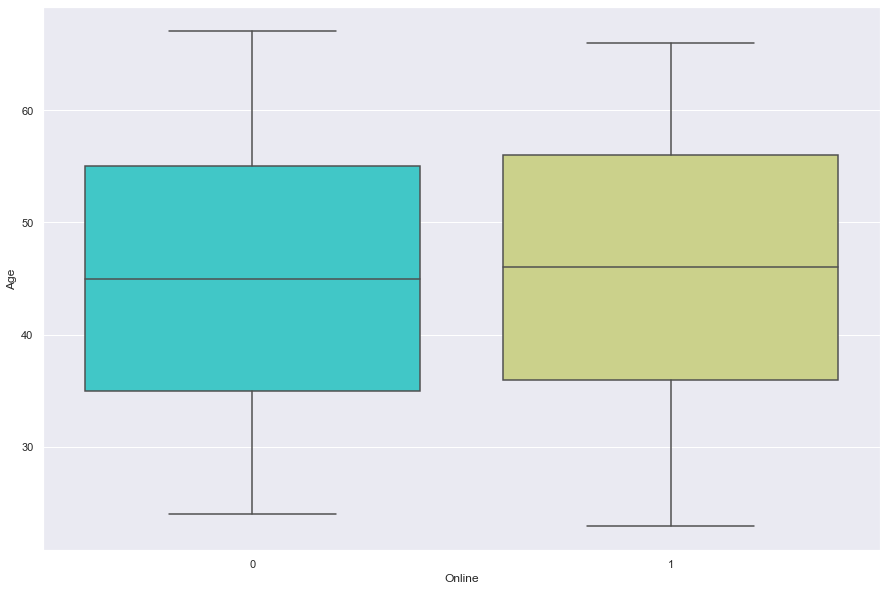

Age by Online Strip Plot


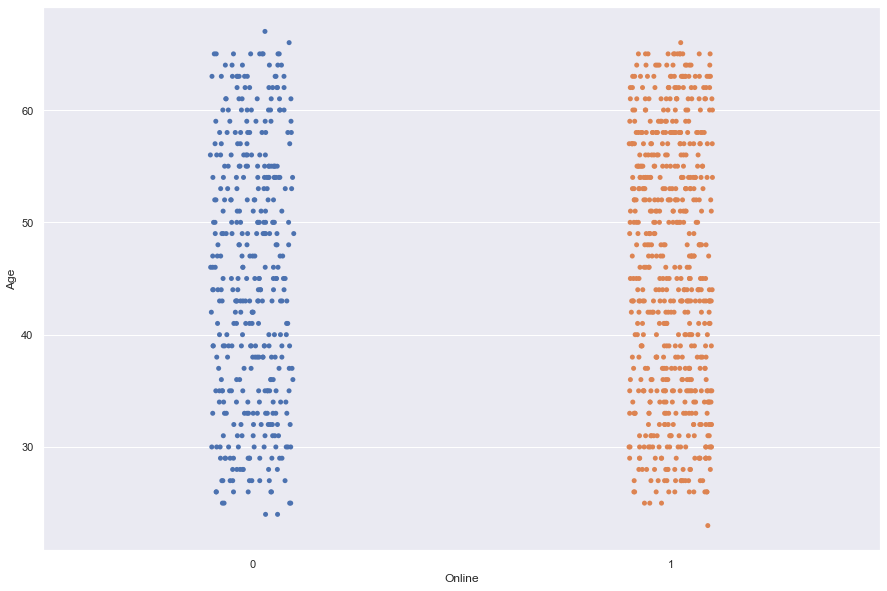

Age by CreditCard Bar Plot


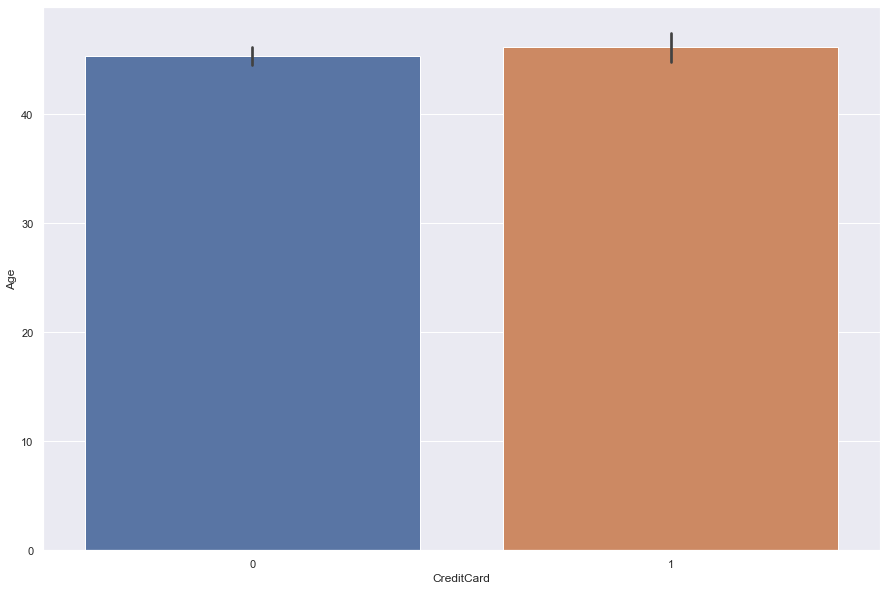

Age by CreditCard Box Plot


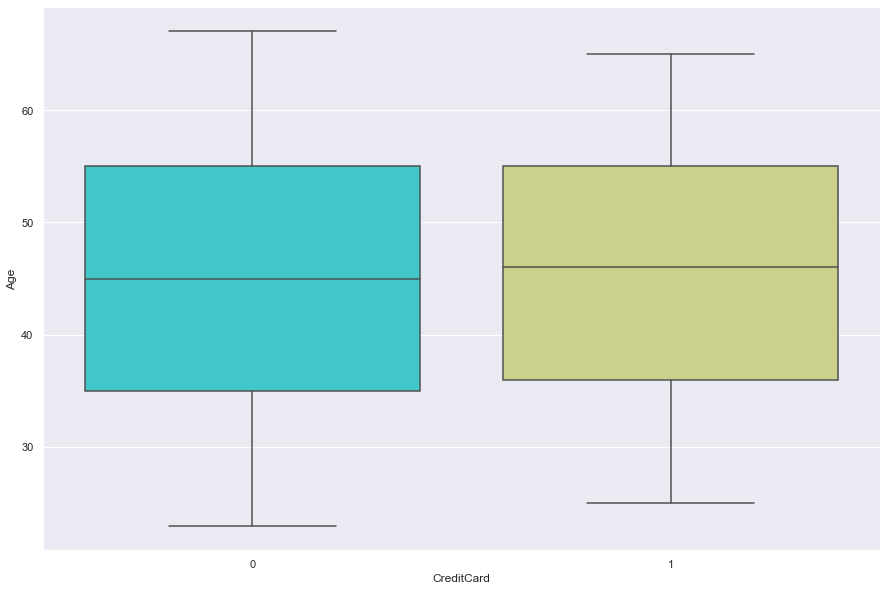

Age by CreditCard Strip Plot


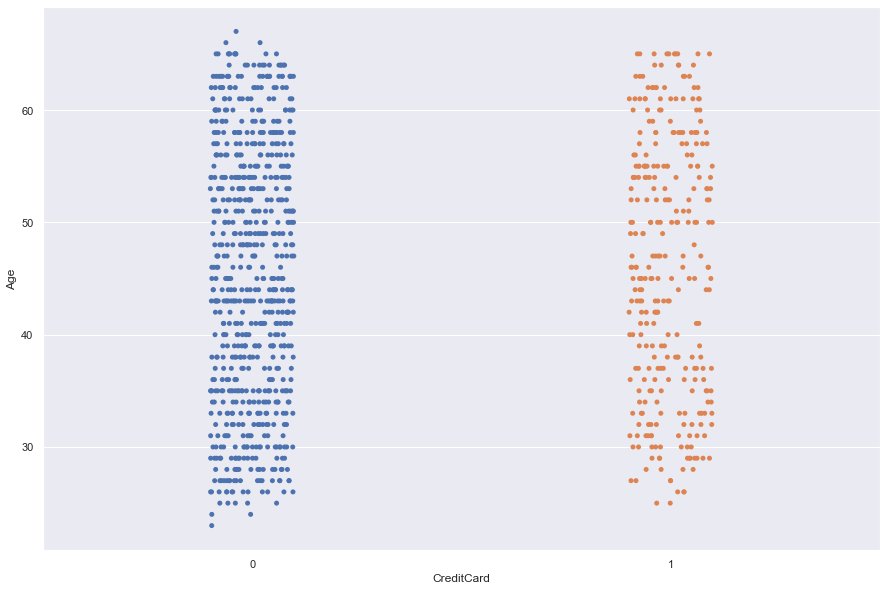

Experience by Securities_Account Bar Plot


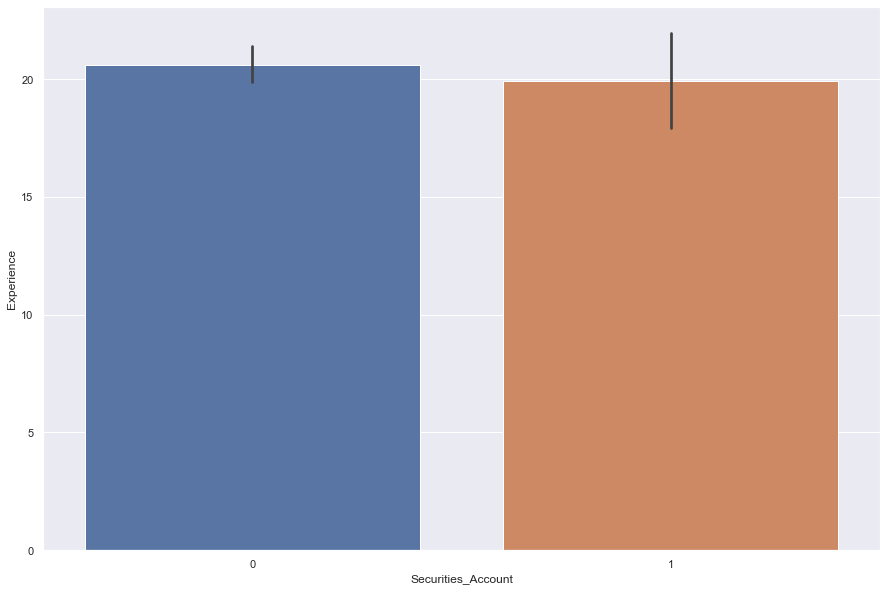

Experience by Securities_Account Box Plot


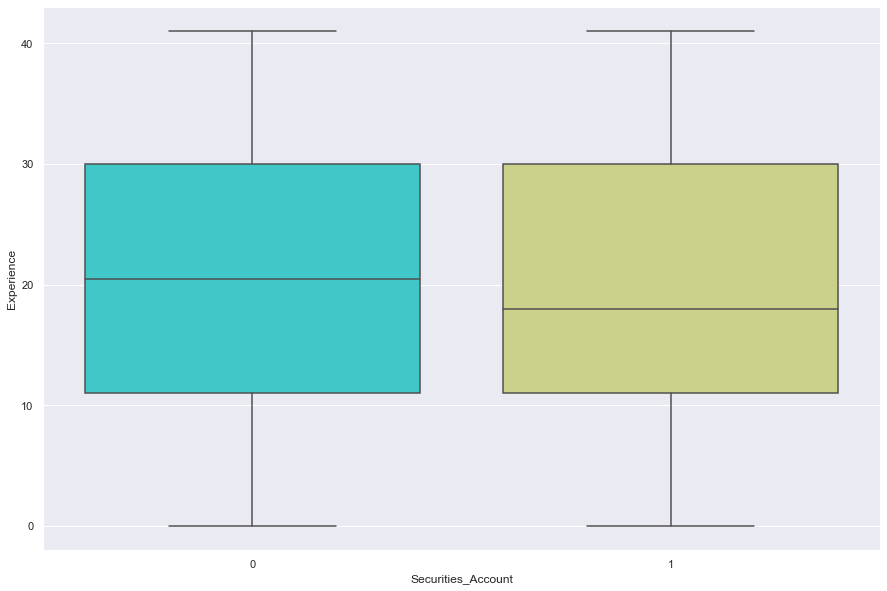

Experience by Securities_Account Strip Plot


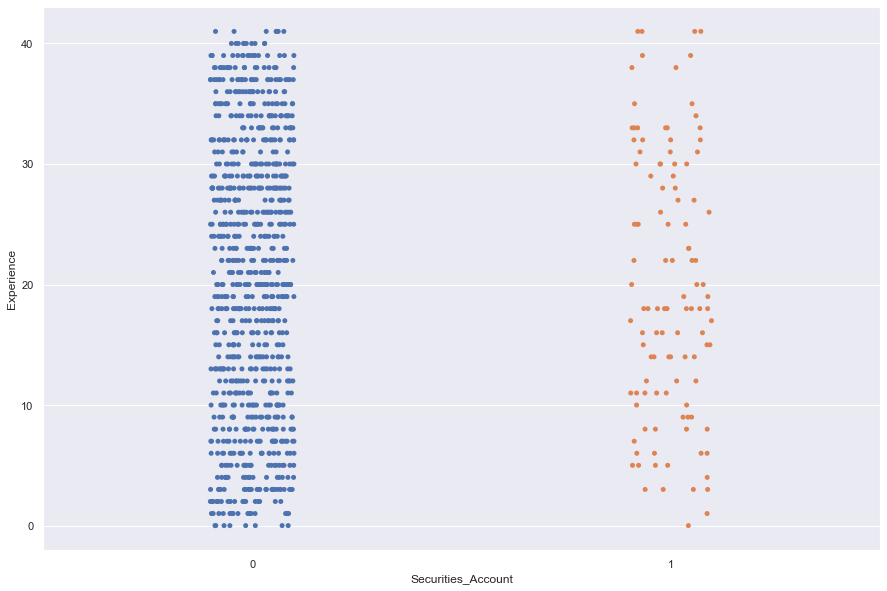

Experience by CD_Account Bar Plot


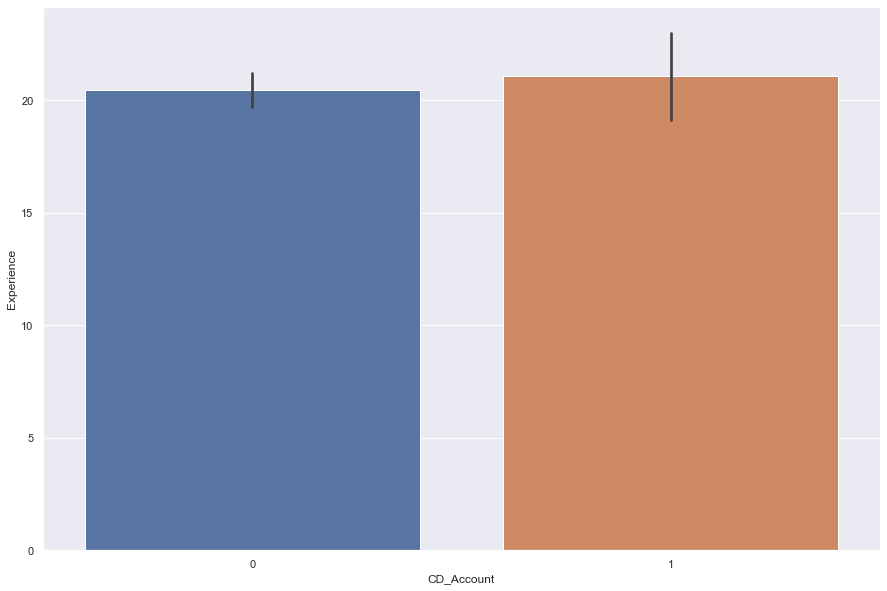

Experience by CD_Account Box Plot


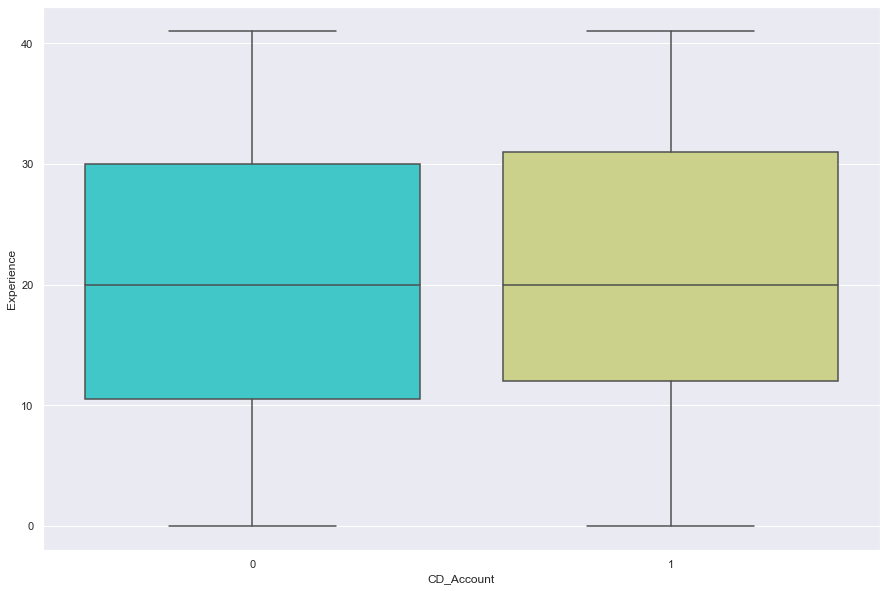

Experience by CD_Account Strip Plot


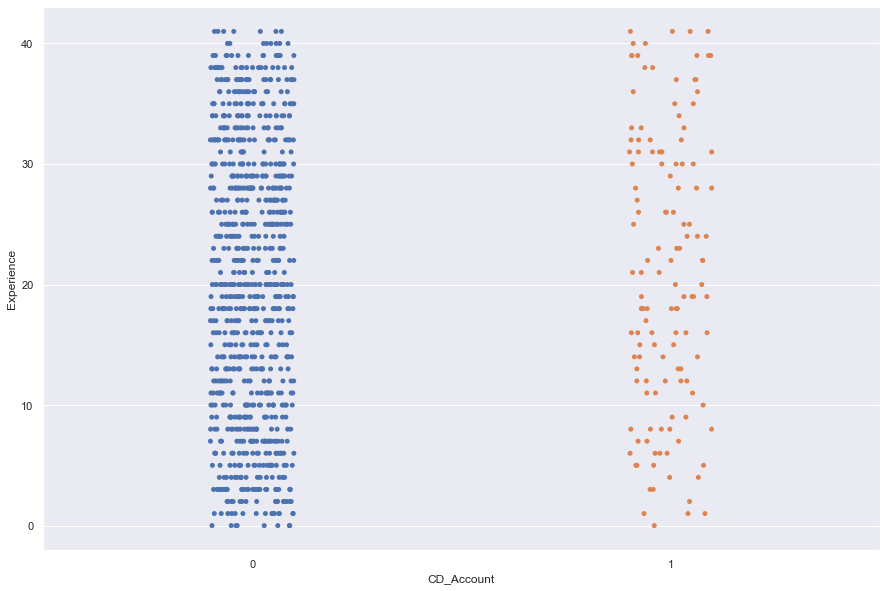

Experience by Online Bar Plot


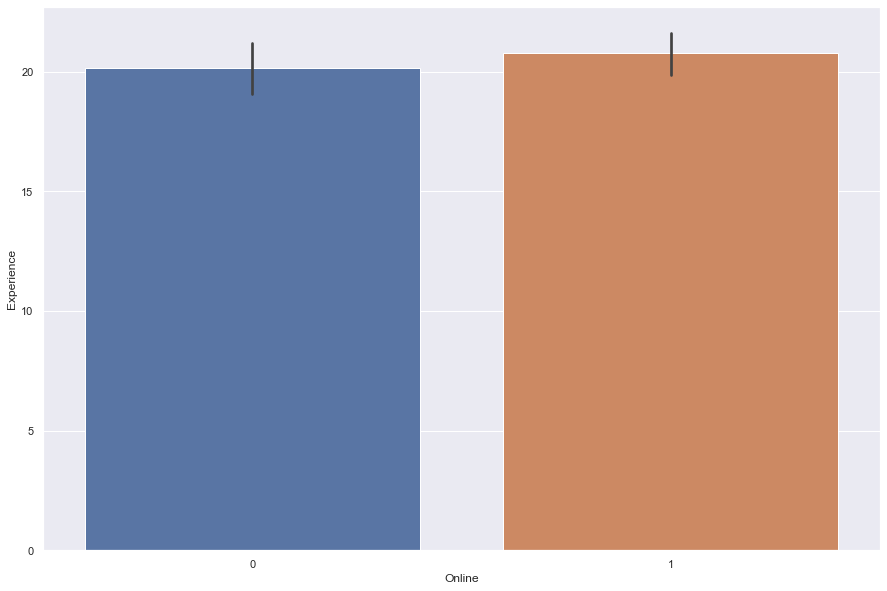

Experience by Online Box Plot


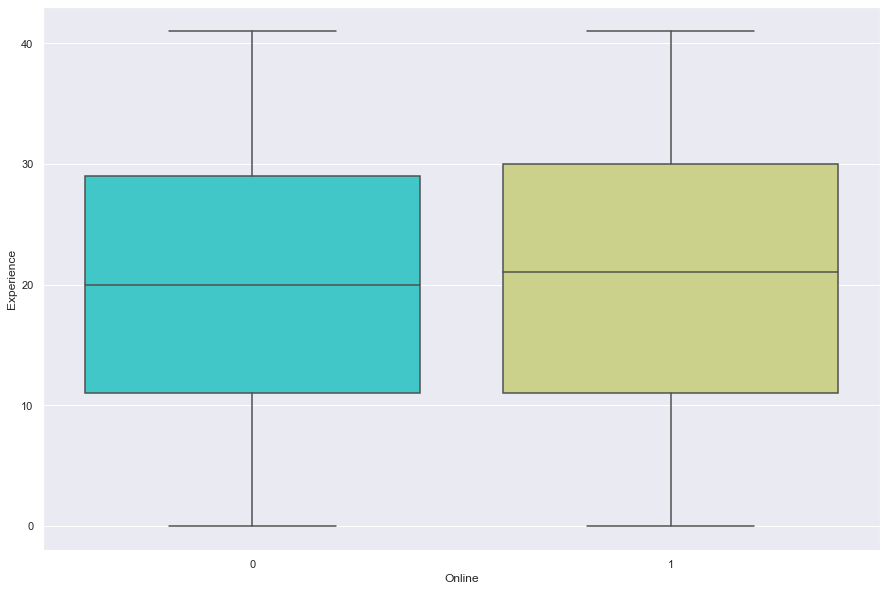

Experience by Online Strip Plot


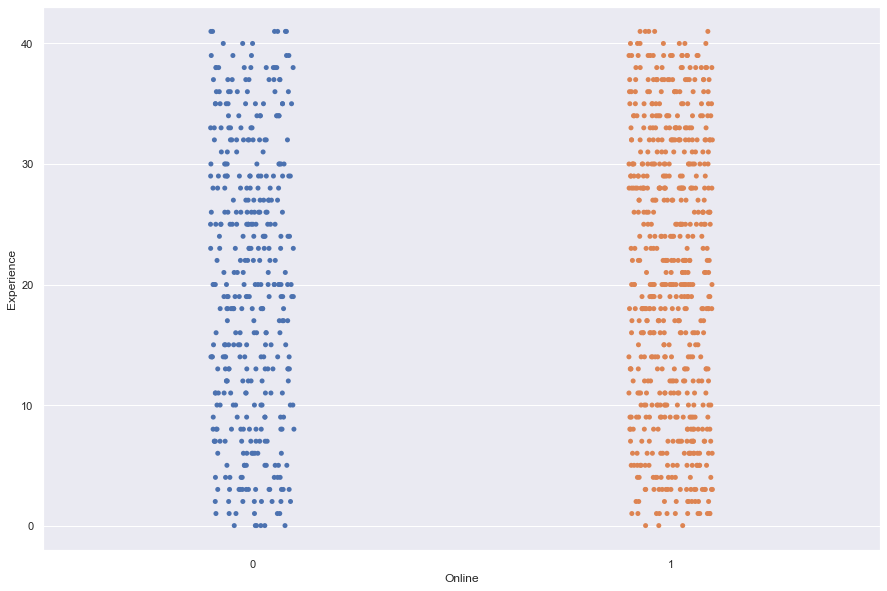

Experience by CreditCard Bar Plot


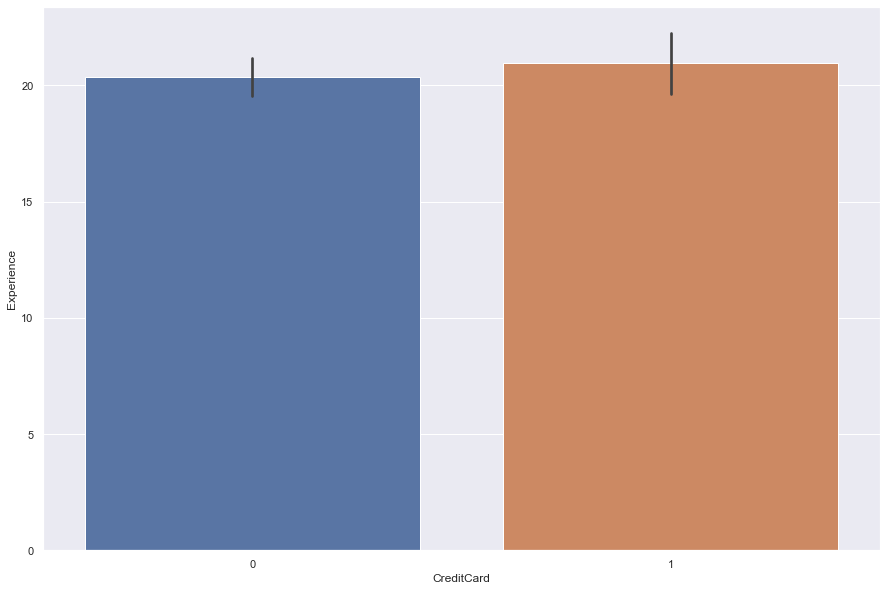

Experience by CreditCard Box Plot


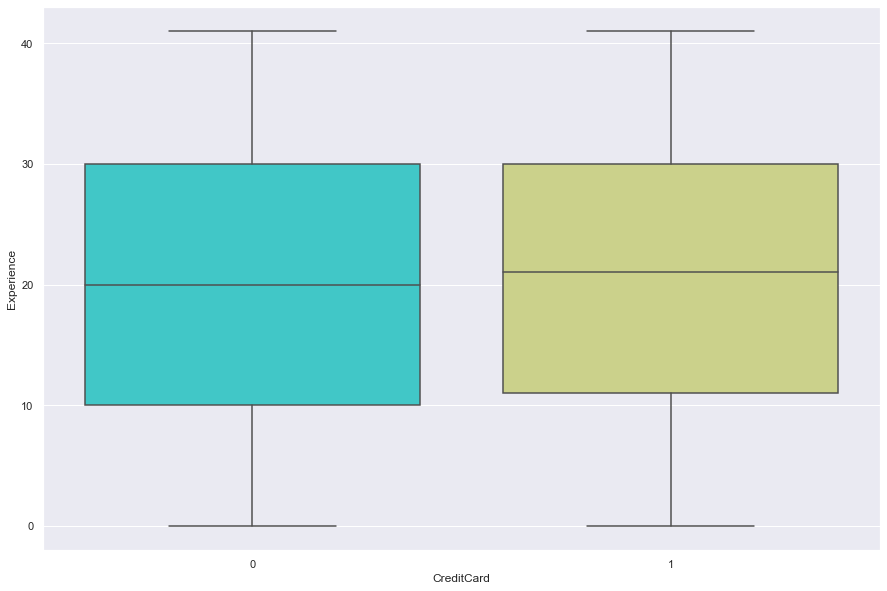

Experience by CreditCard Strip Plot


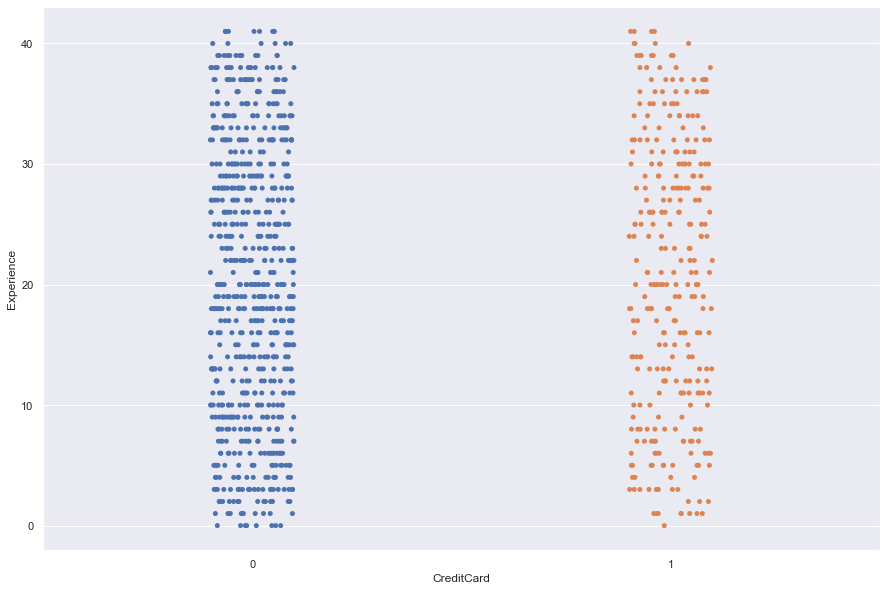

Income by Securities_Account Bar Plot


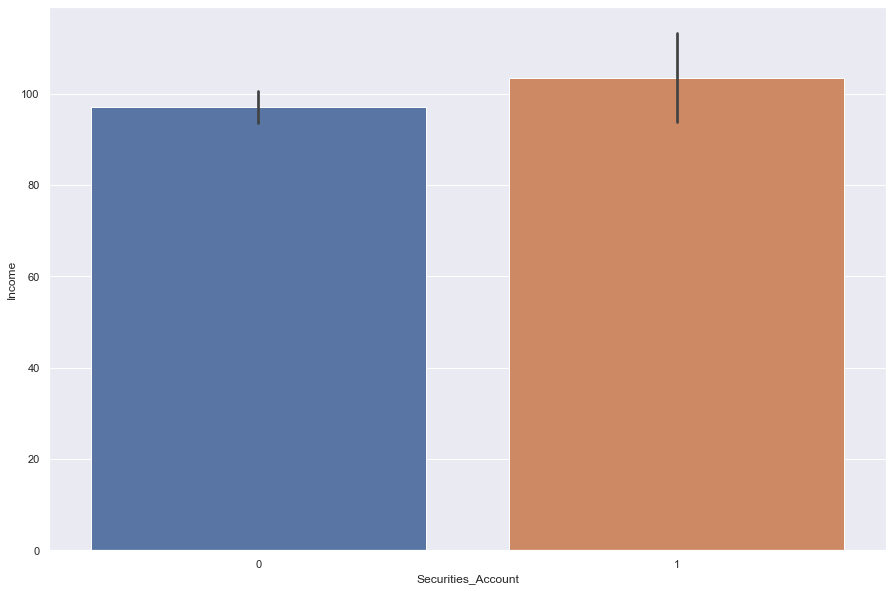

Income by Securities_Account Box Plot


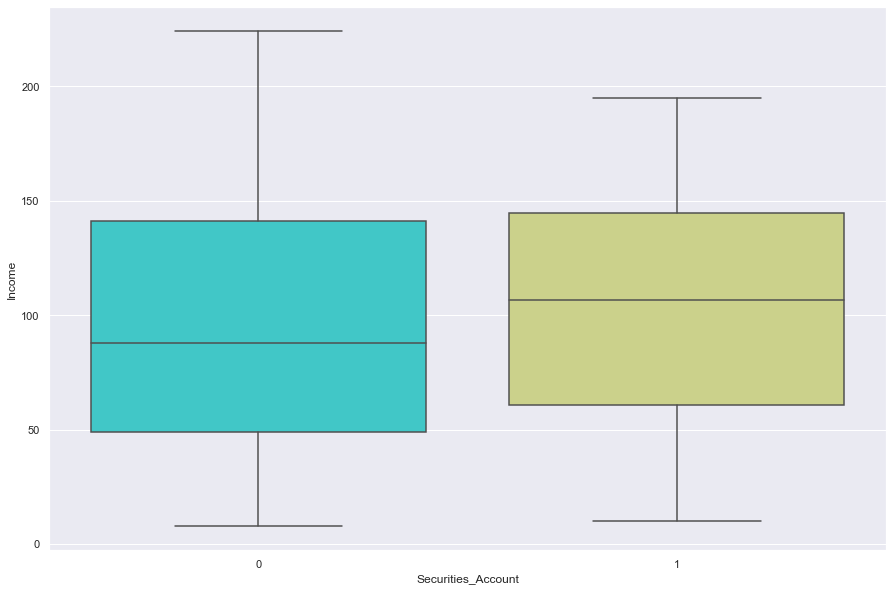

Income by Securities_Account Strip Plot


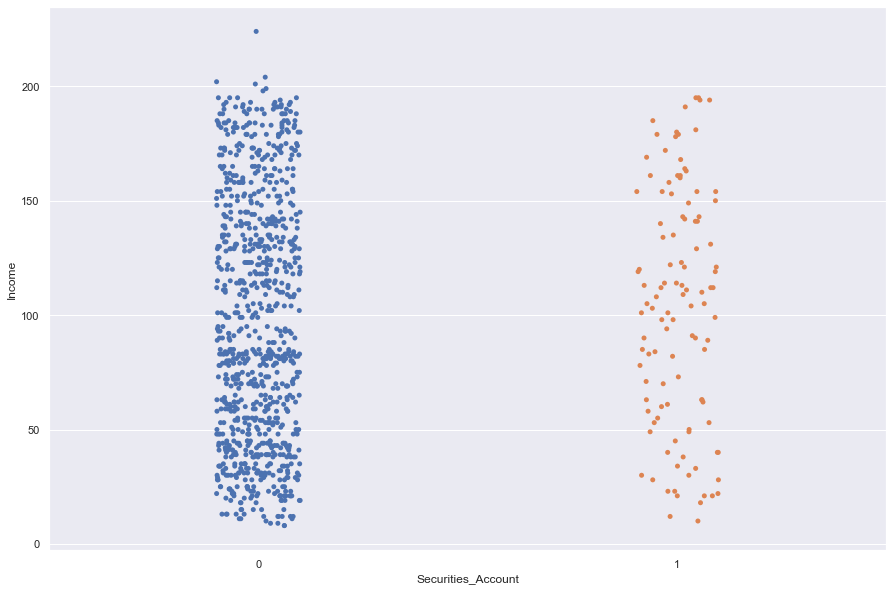

Income by CD_Account Bar Plot


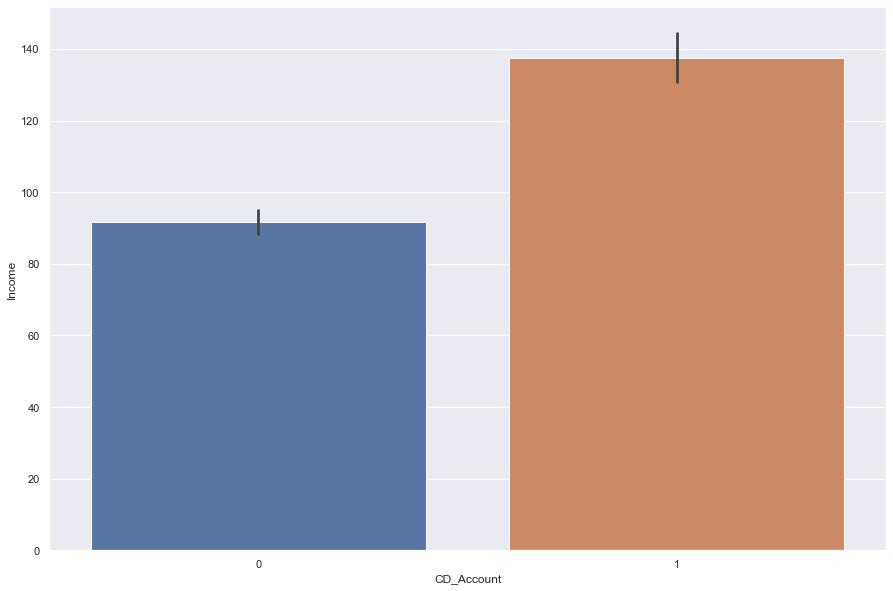

Income by CD_Account Box Plot


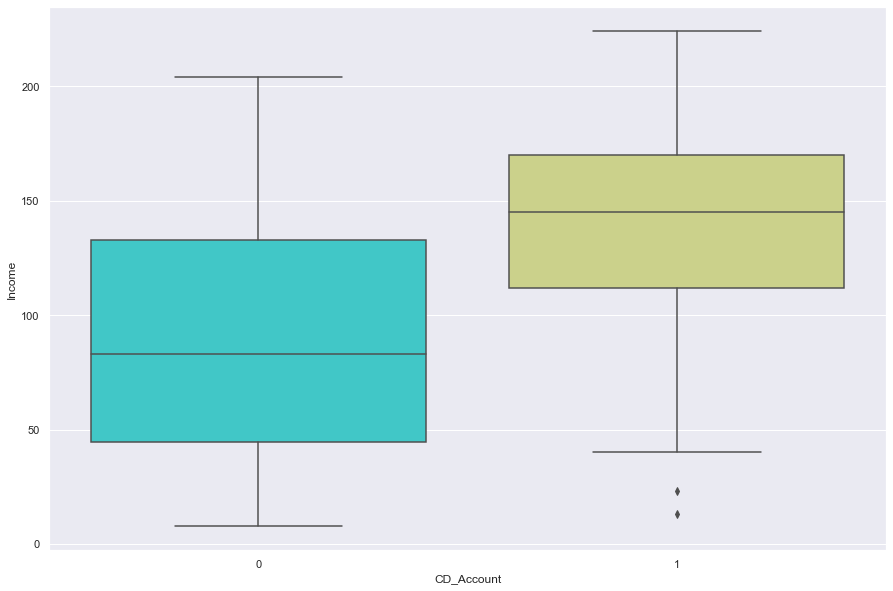

Income by CD_Account Strip Plot


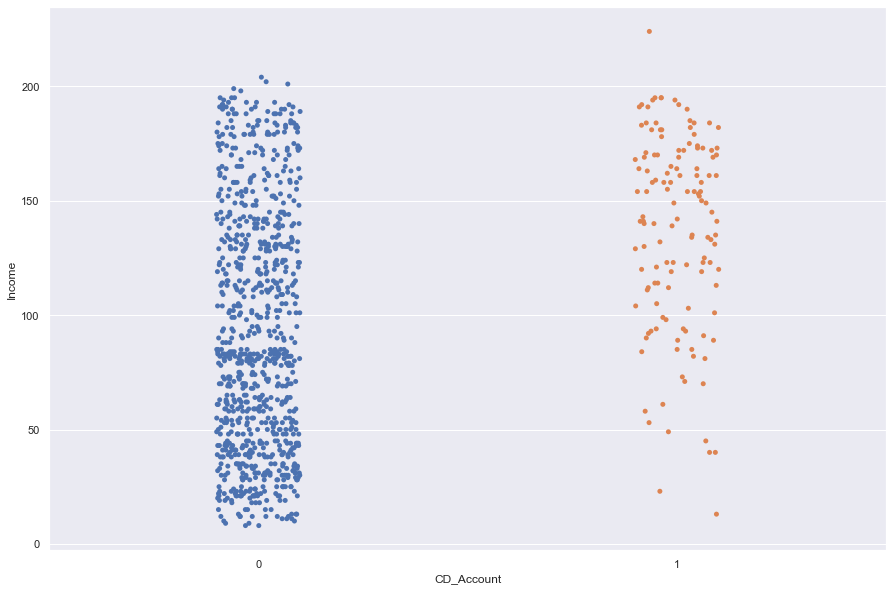

Income by Online Bar Plot


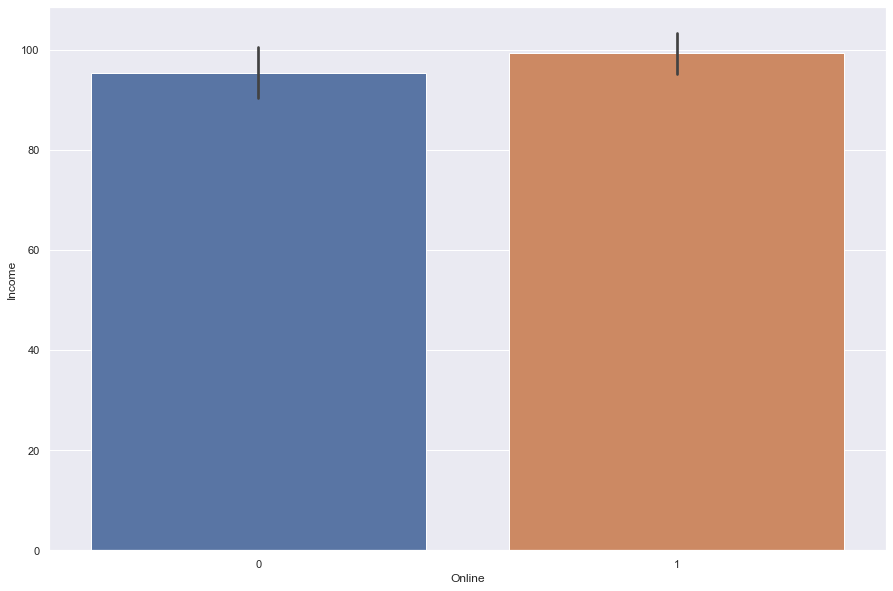

Income by Online Box Plot


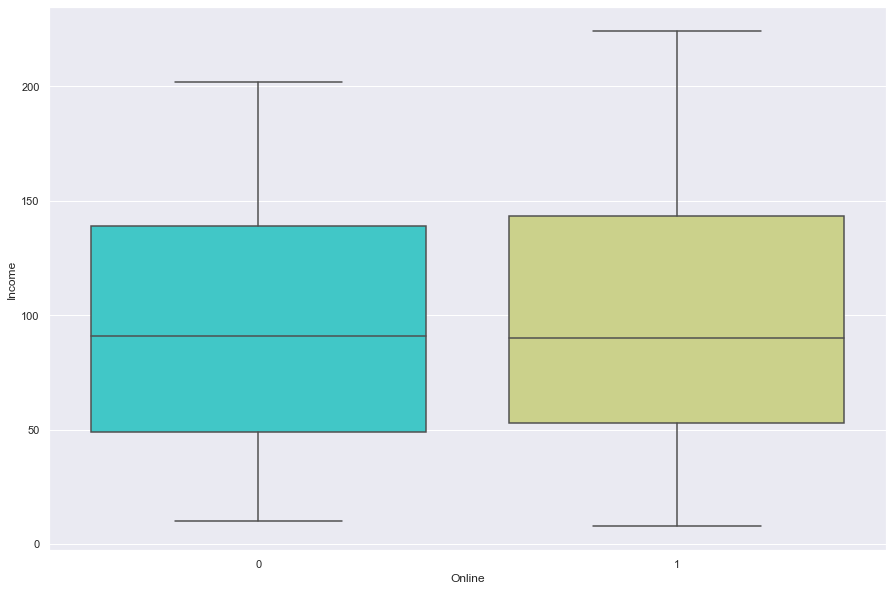

Income by Online Strip Plot


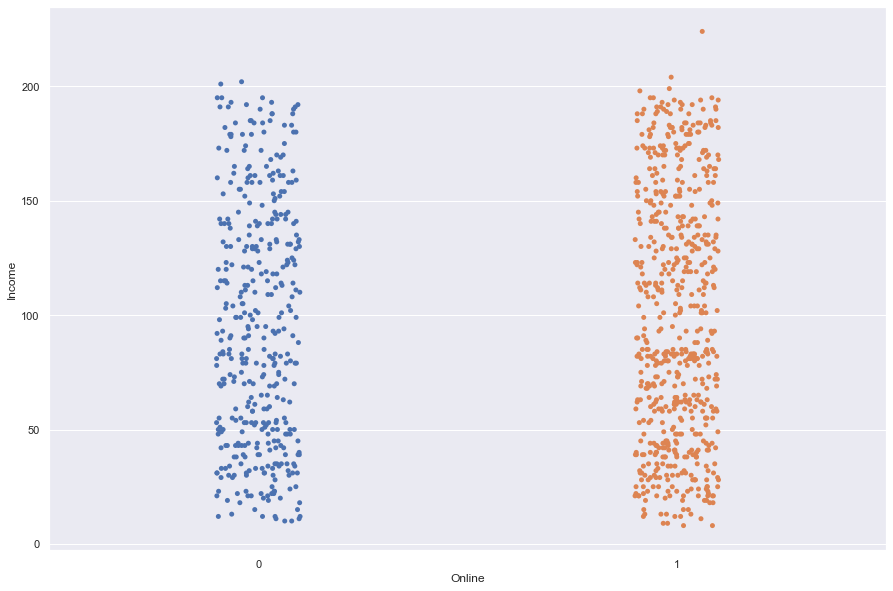

Income by CreditCard Bar Plot


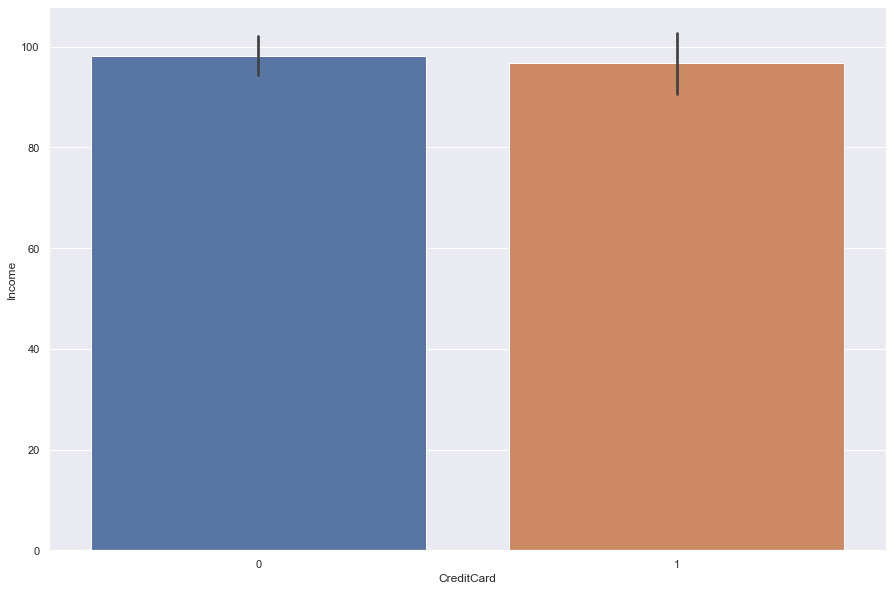

Income by CreditCard Box Plot


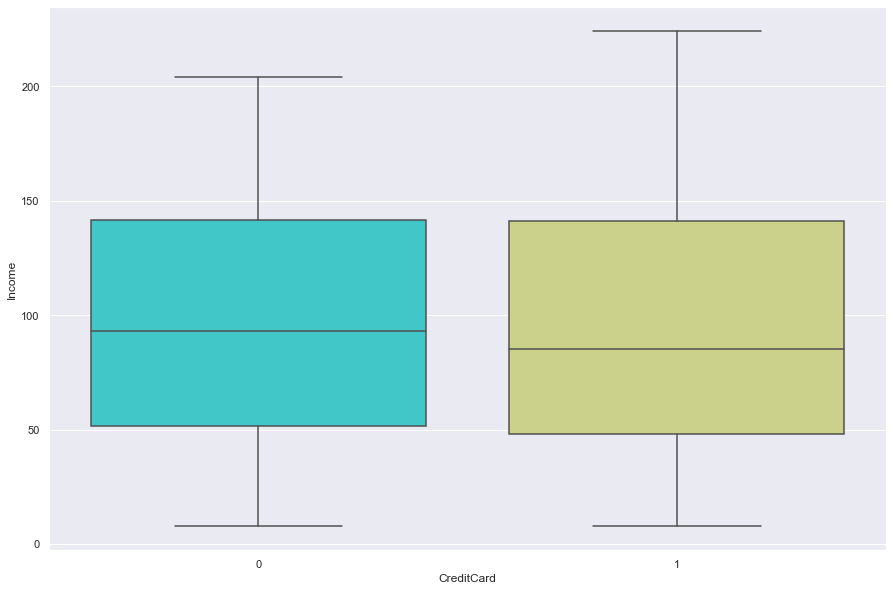

Income by CreditCard Strip Plot


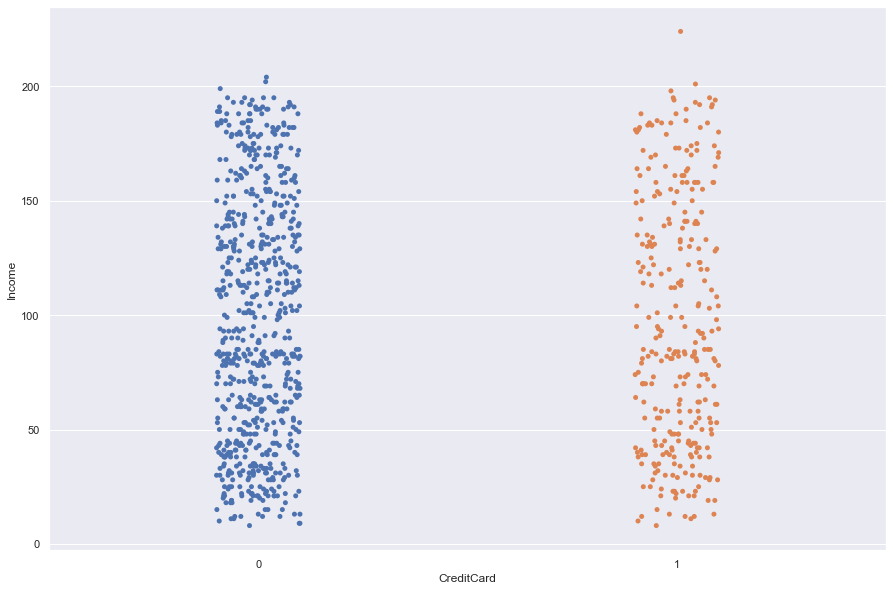

Family by Securities_Account Bar Plot


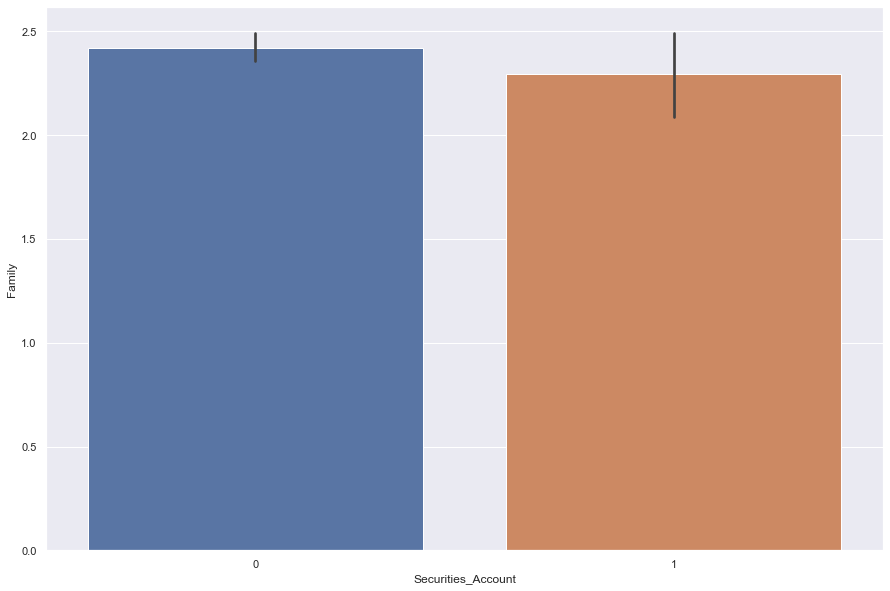

Family by Securities_Account Box Plot


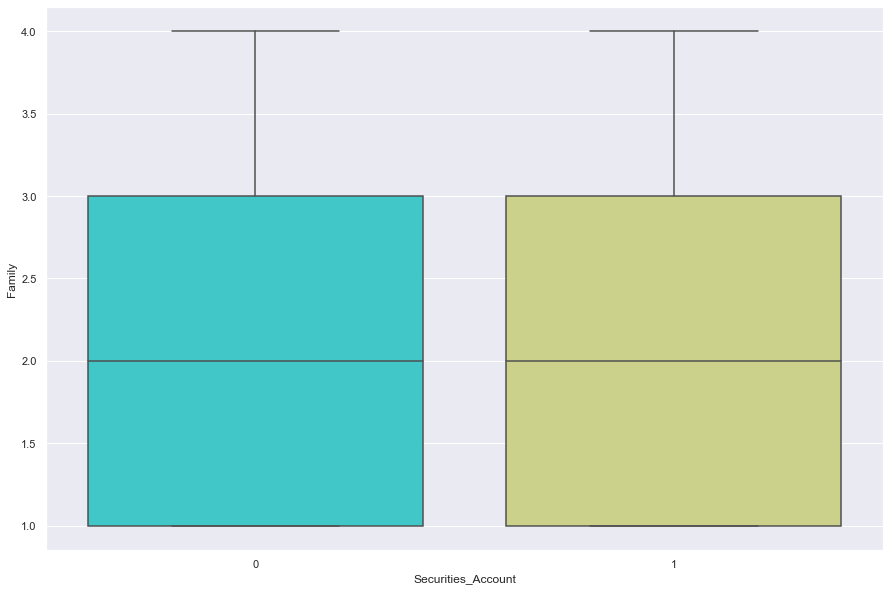

Family by Securities_Account Strip Plot


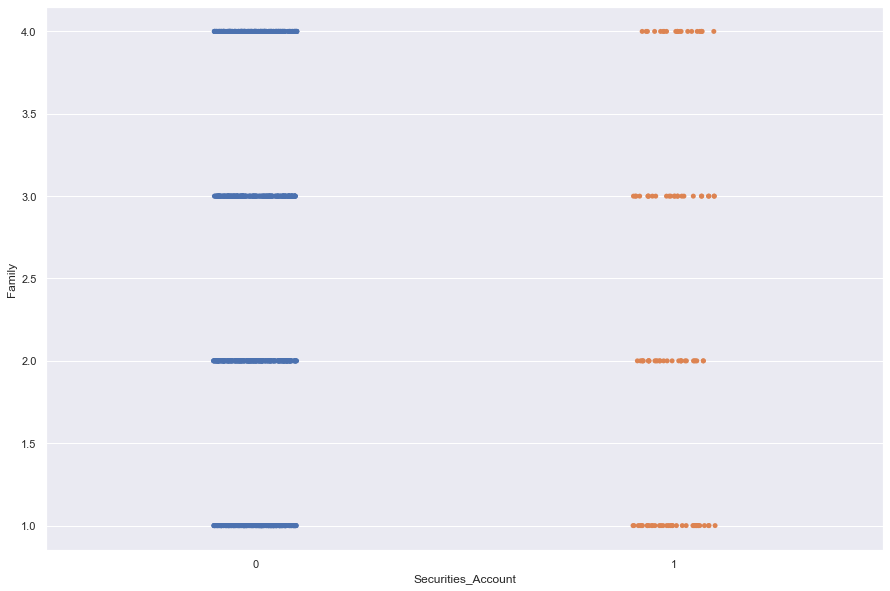

Family by CD_Account Bar Plot


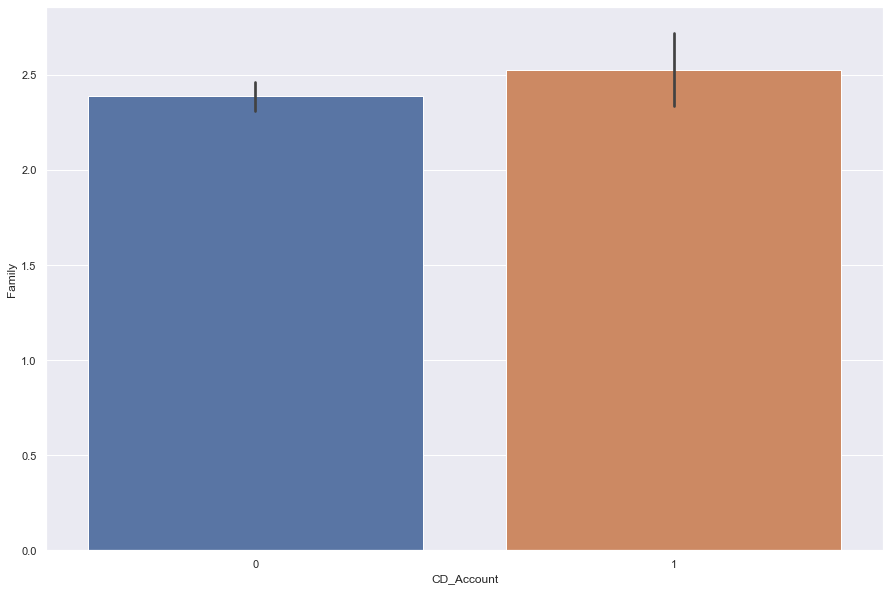

Family by CD_Account Box Plot


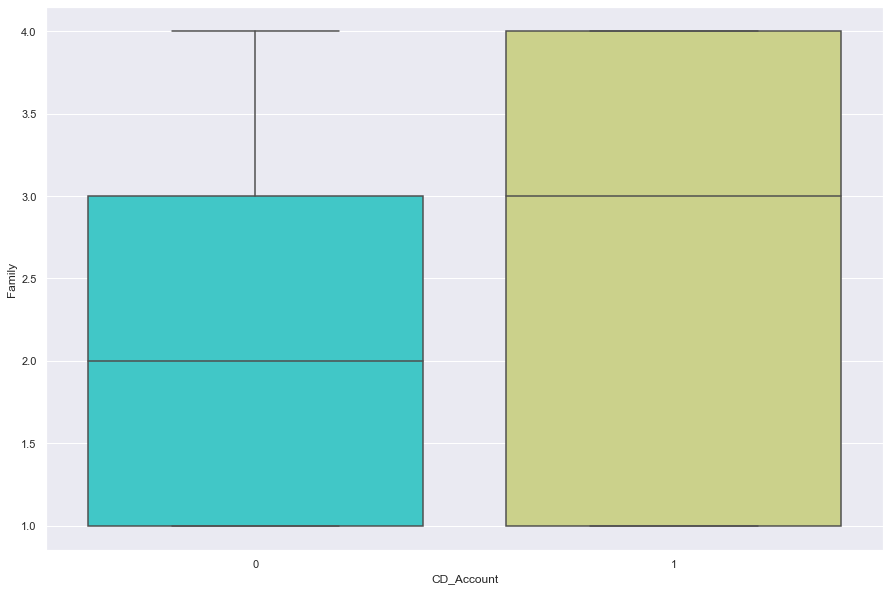

Family by CD_Account Strip Plot


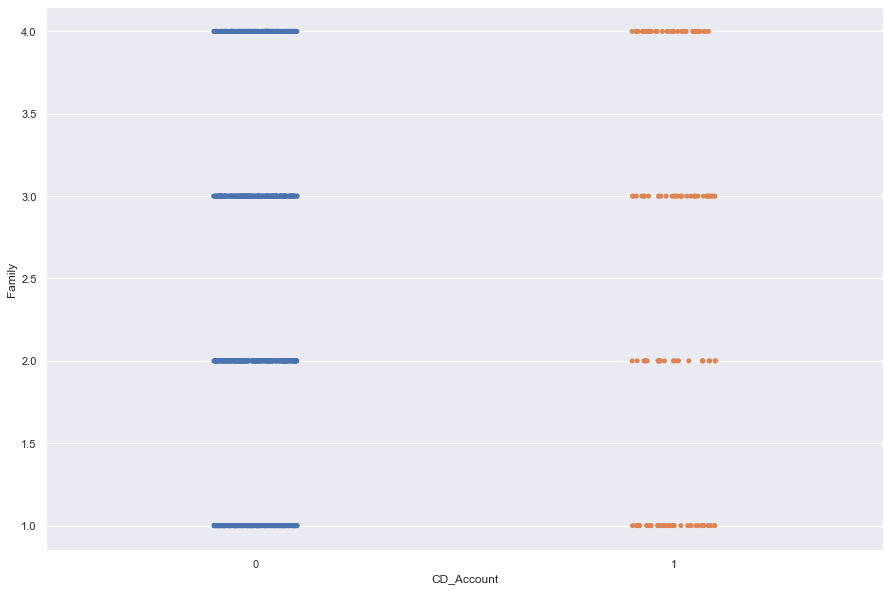

Family by Online Bar Plot


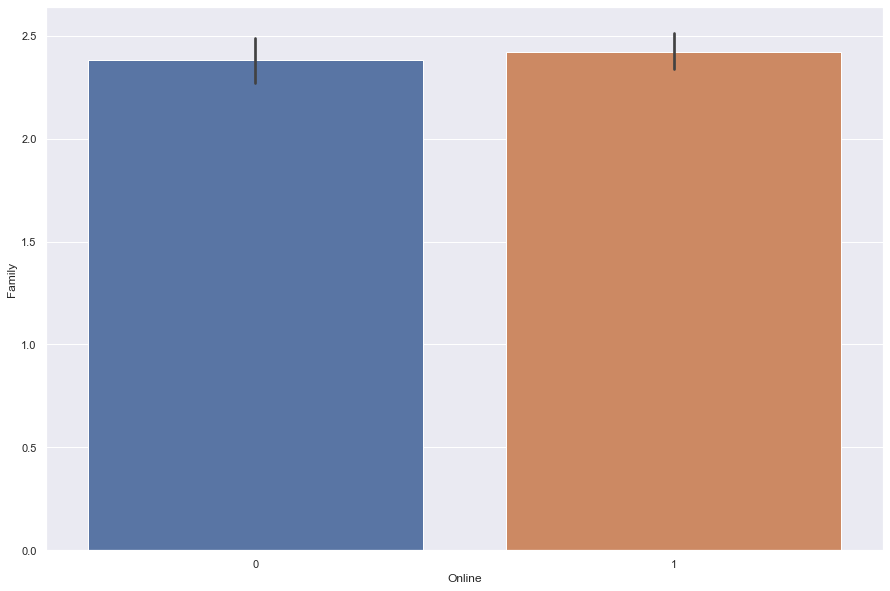

Family by Online Box Plot


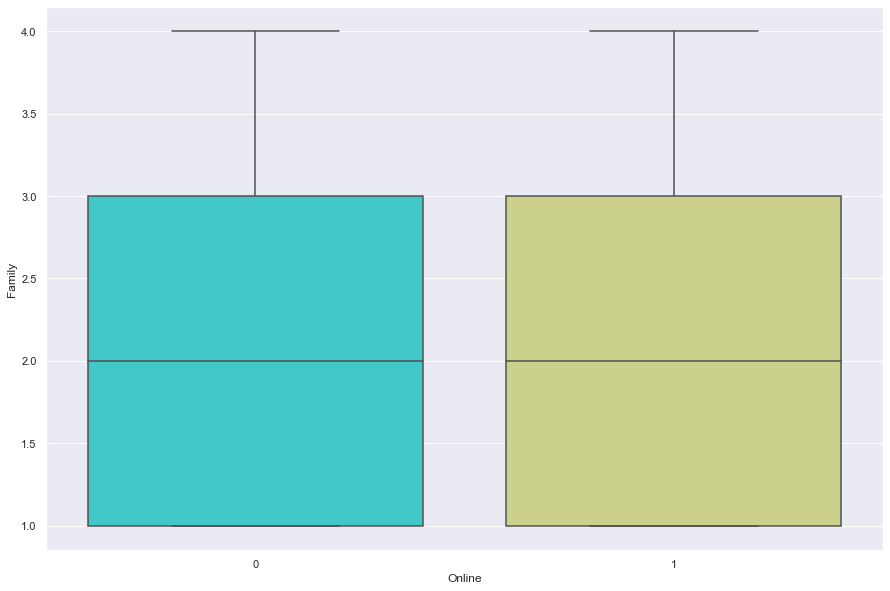

Family by Online Strip Plot


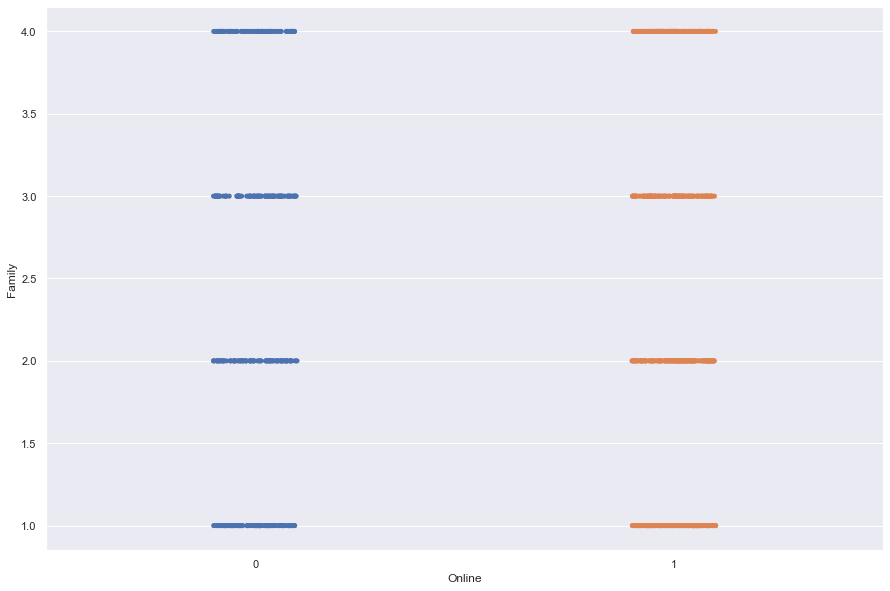

Family by CreditCard Bar Plot


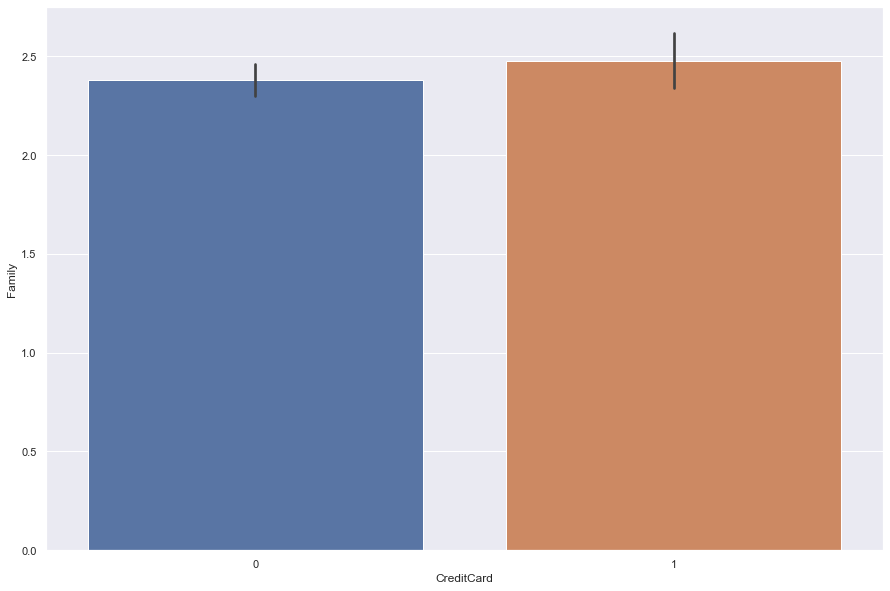

Family by CreditCard Box Plot


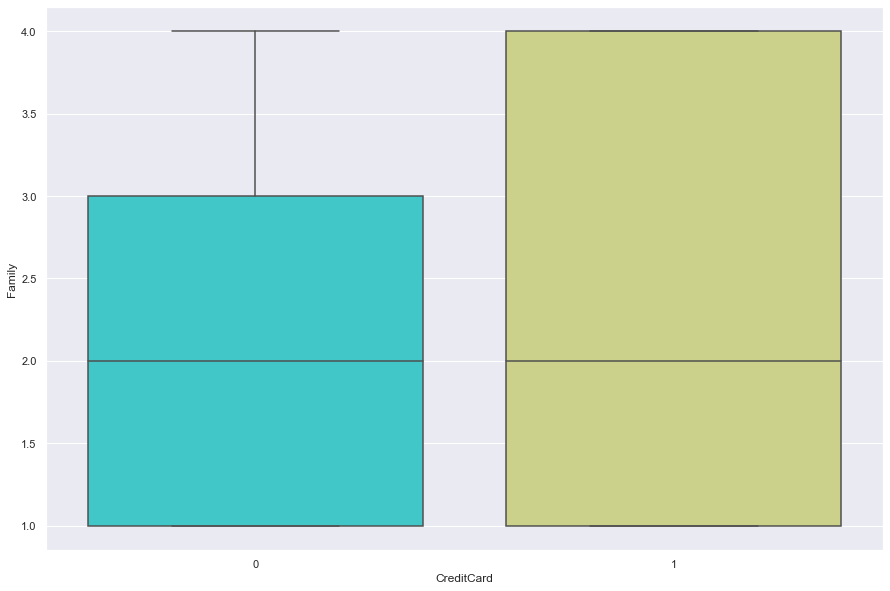

Family by CreditCard Strip Plot


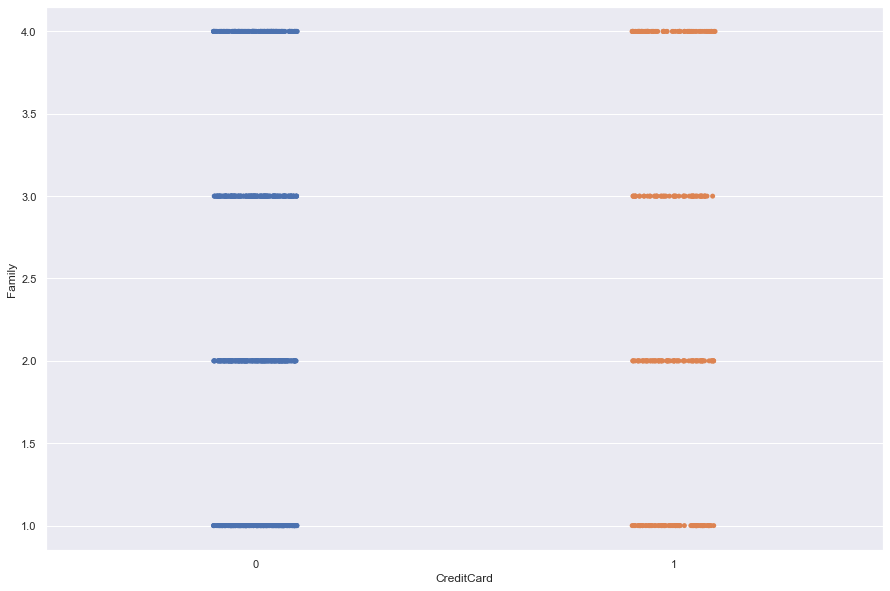

CCAvg by Securities_Account Bar Plot


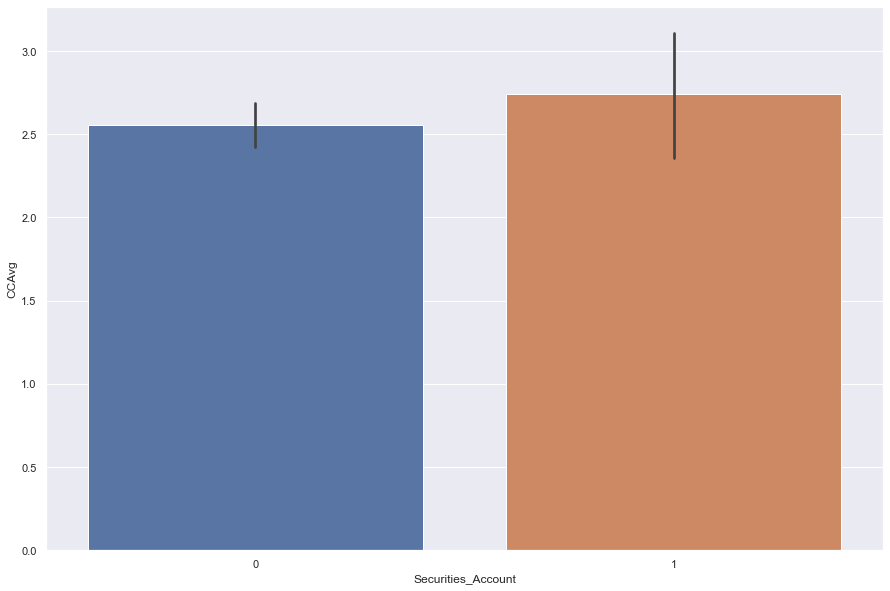

CCAvg by Securities_Account Box Plot


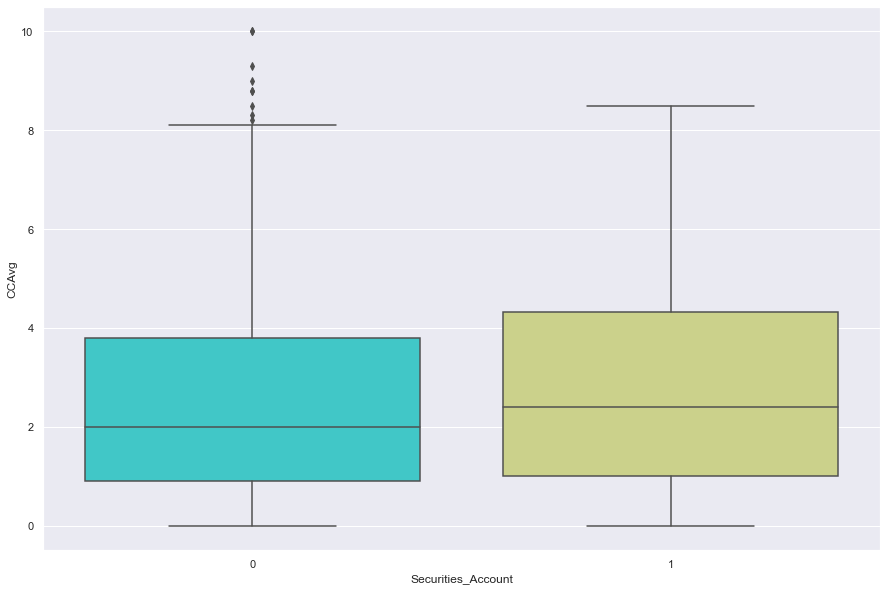

CCAvg by Securities_Account Strip Plot


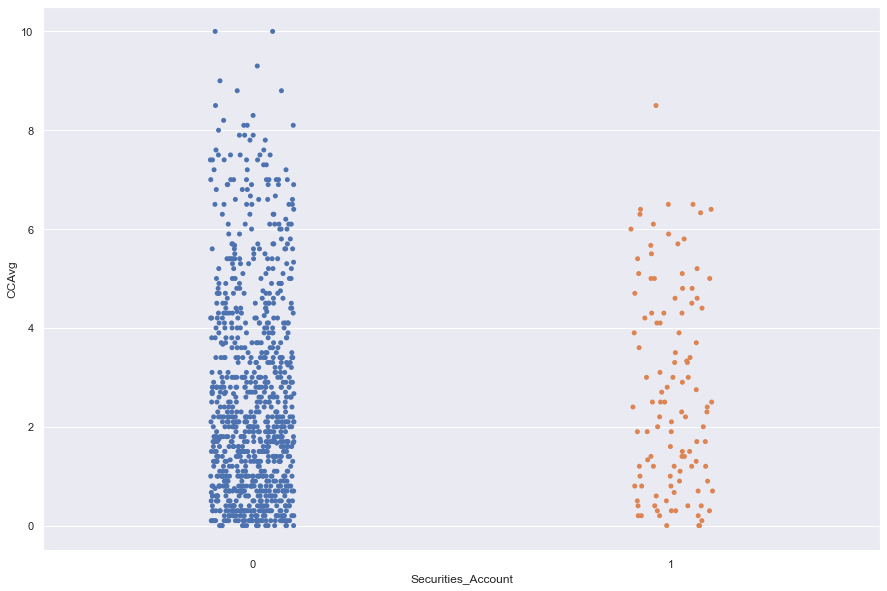

CCAvg by CD_Account Bar Plot


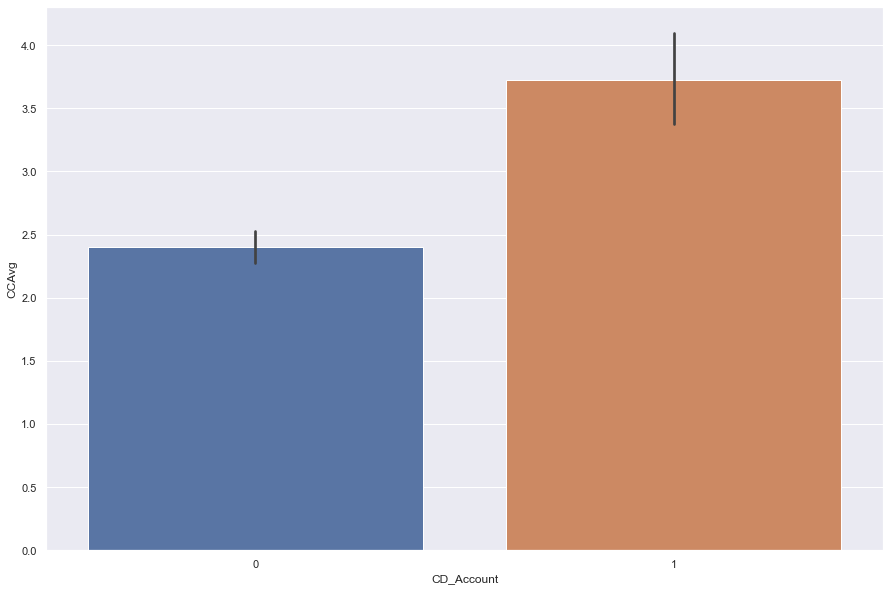

CCAvg by CD_Account Box Plot


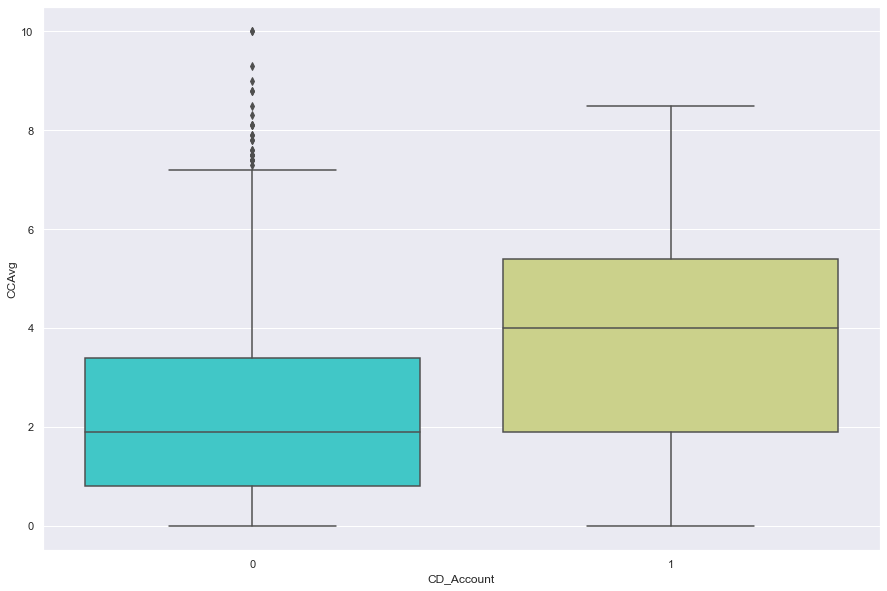

CCAvg by CD_Account Strip Plot


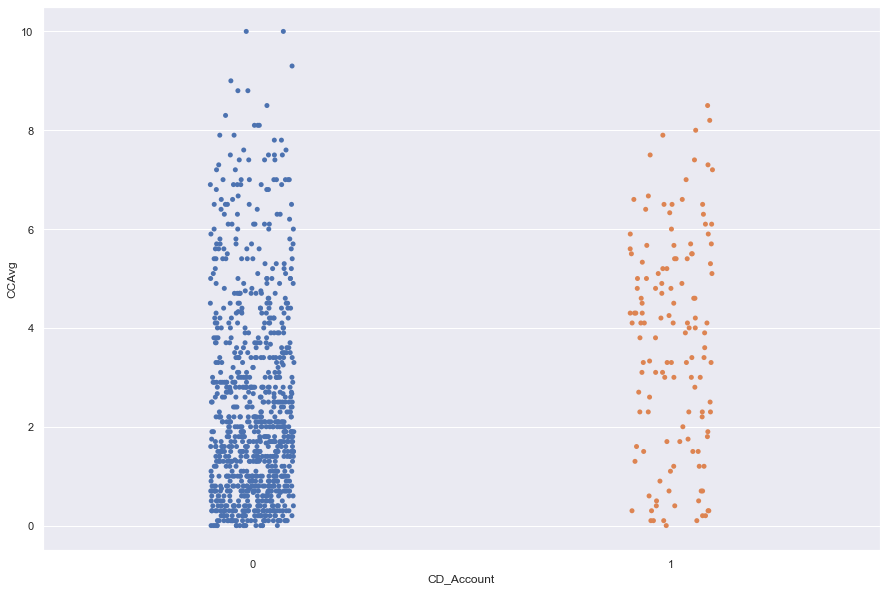

CCAvg by Online Bar Plot


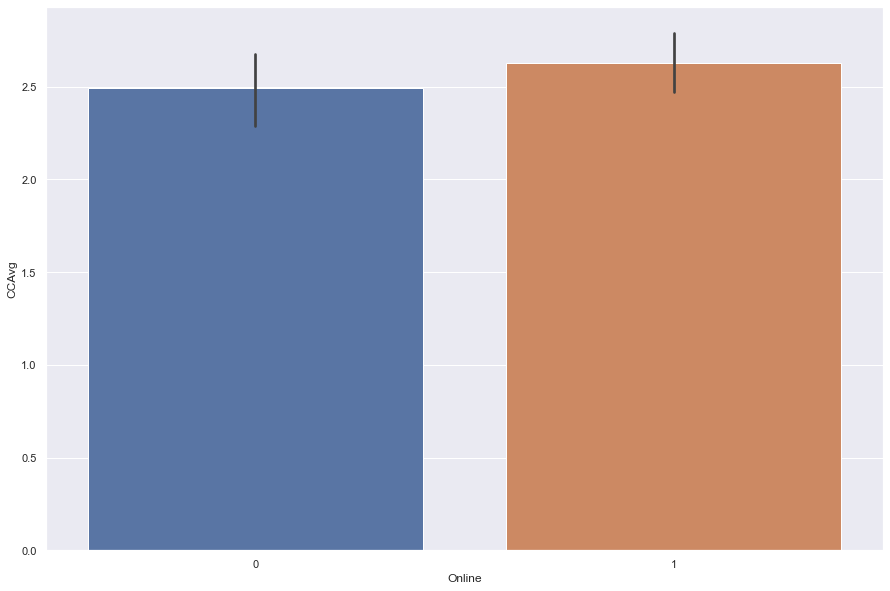

CCAvg by Online Box Plot


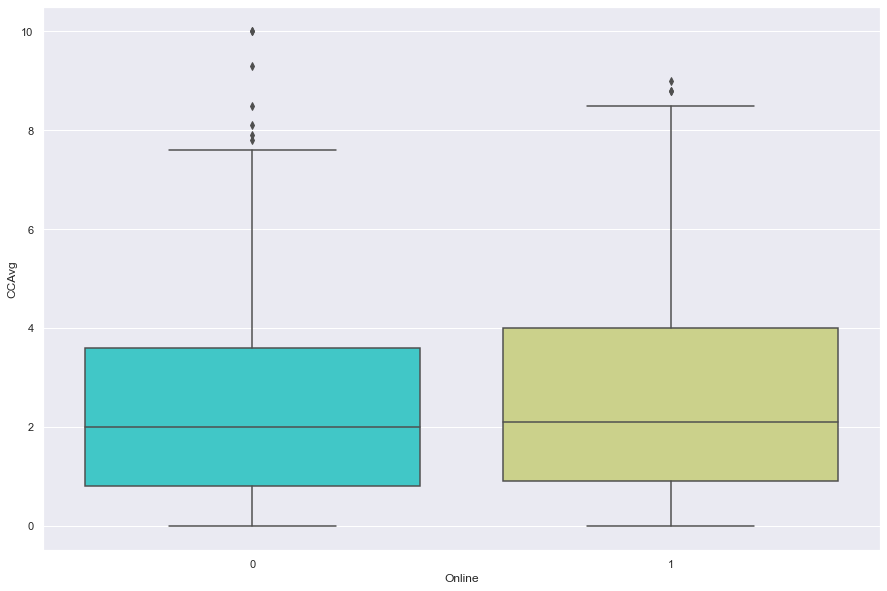

CCAvg by Online Strip Plot


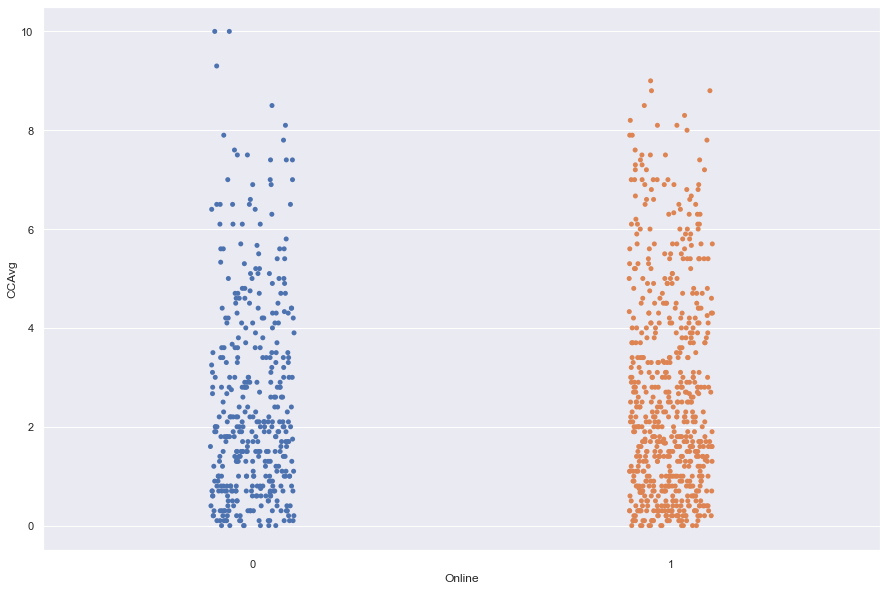

CCAvg by CreditCard Bar Plot


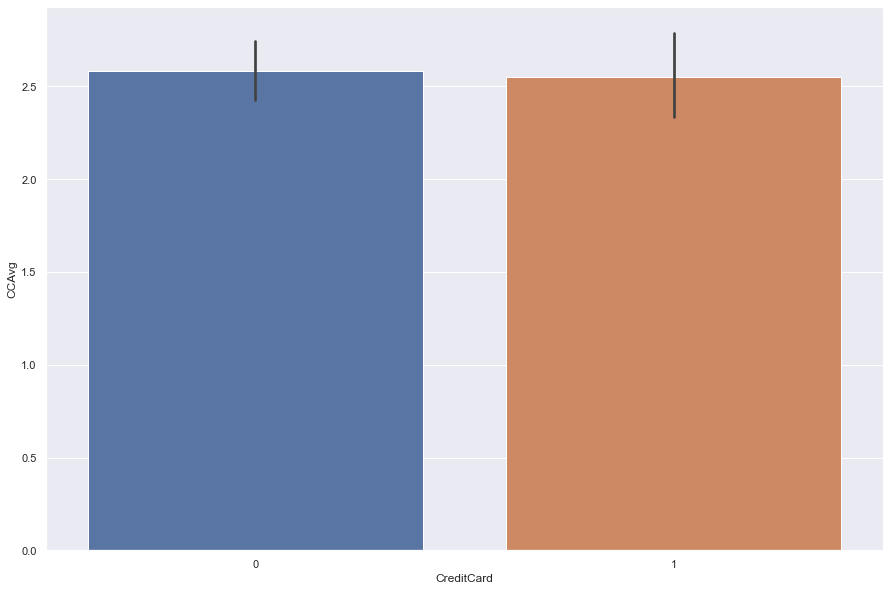

CCAvg by CreditCard Box Plot


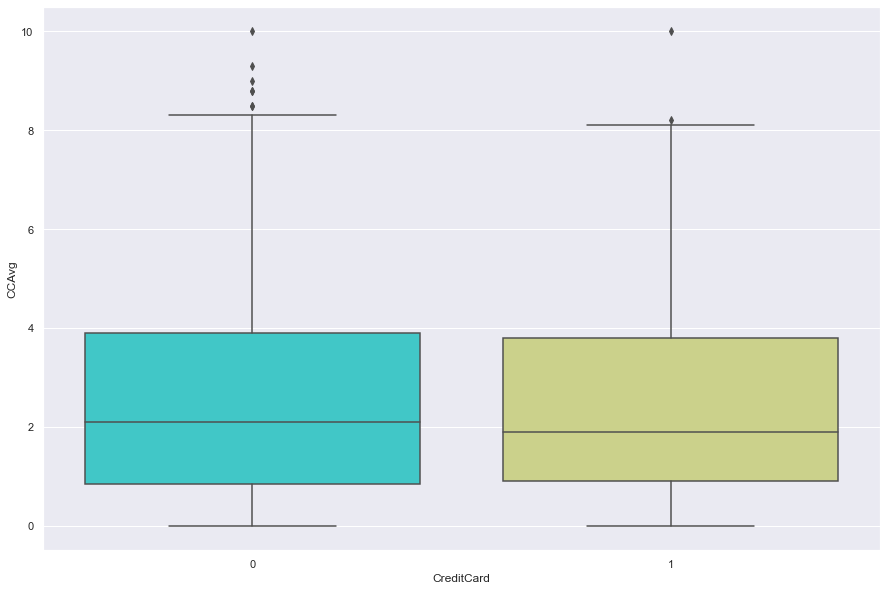

CCAvg by CreditCard Strip Plot


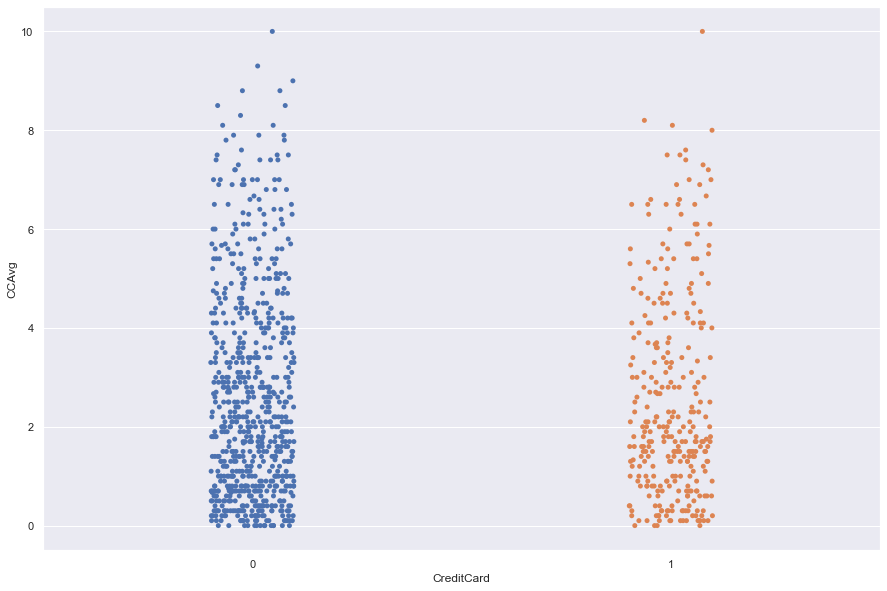

Mortgage by Securities_Account Bar Plot


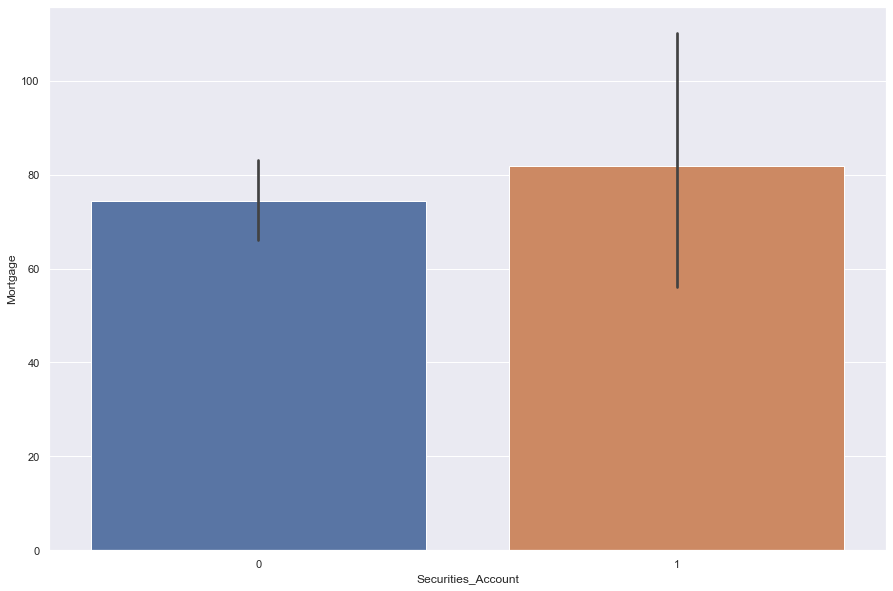

Mortgage by Securities_Account Box Plot


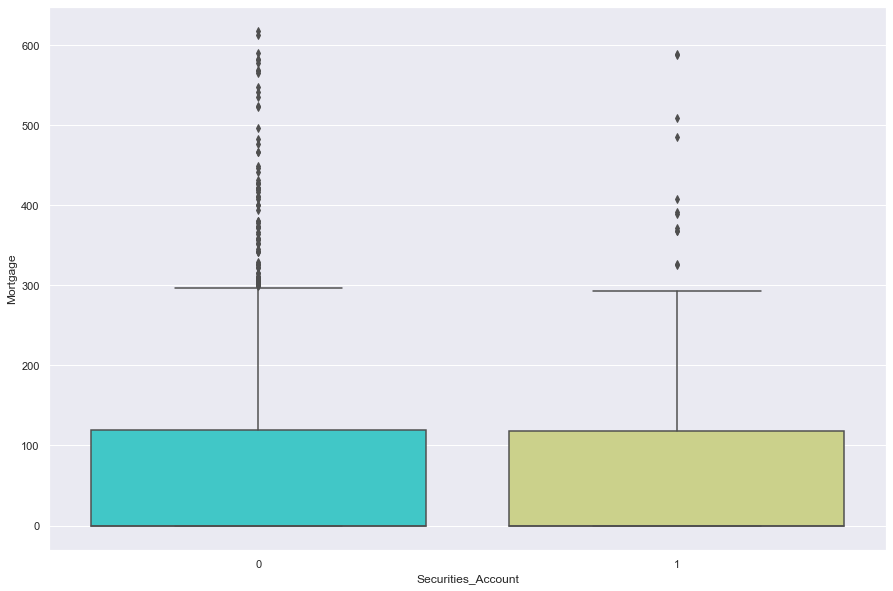

Mortgage by Securities_Account Strip Plot


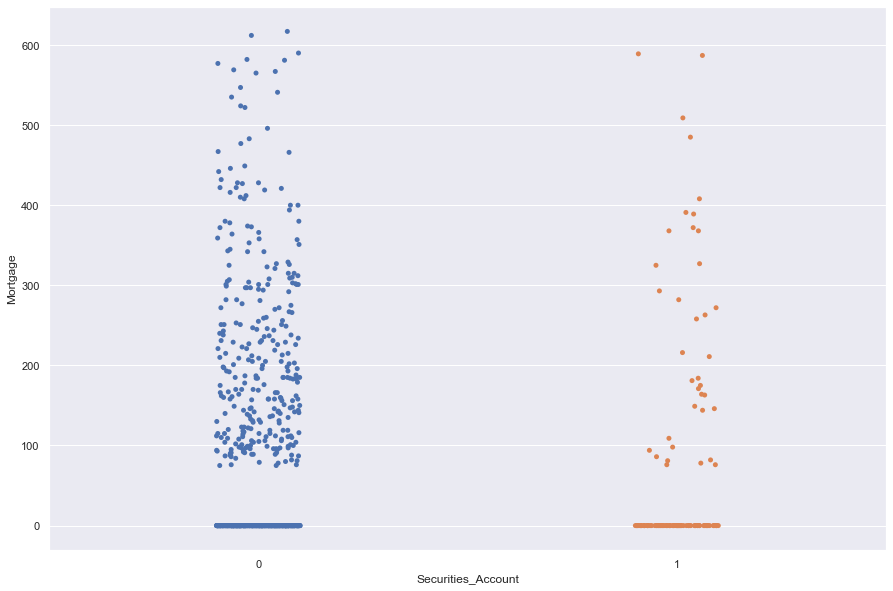

Mortgage by CD_Account Bar Plot


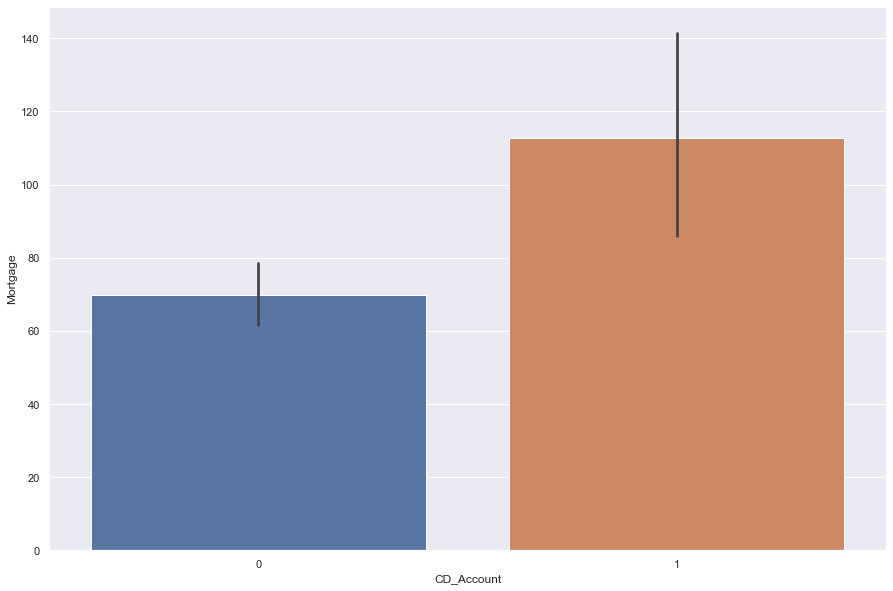

Mortgage by CD_Account Box Plot


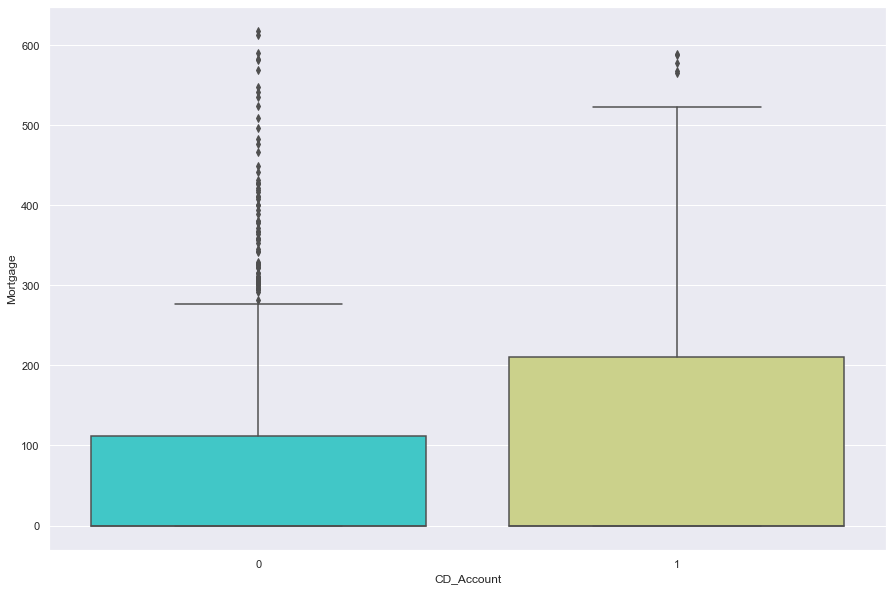

Mortgage by CD_Account Strip Plot


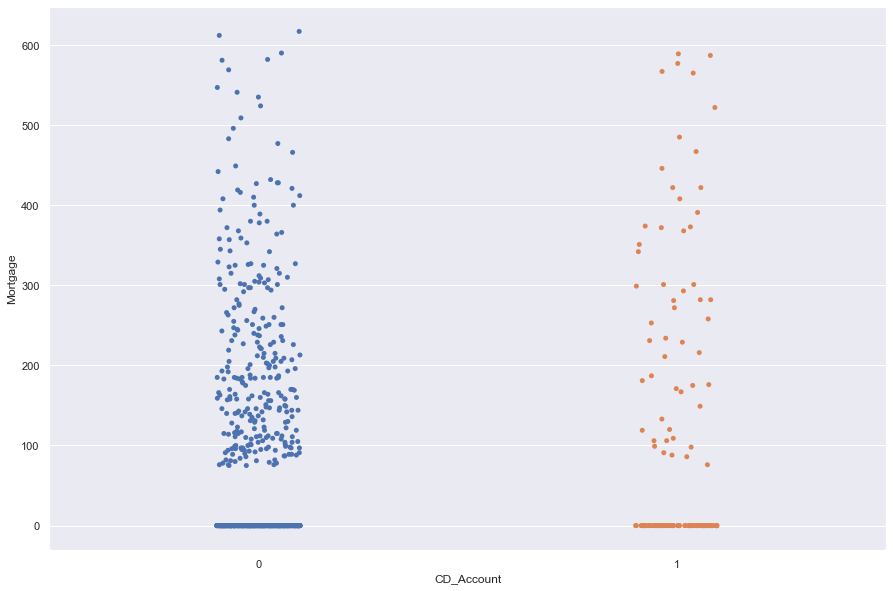

Mortgage by Online Bar Plot


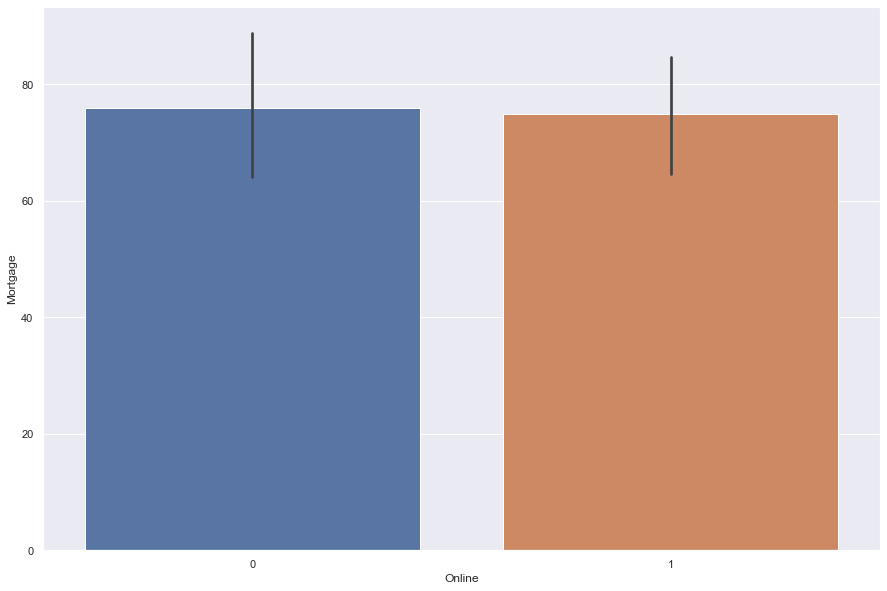

Mortgage by Online Box Plot


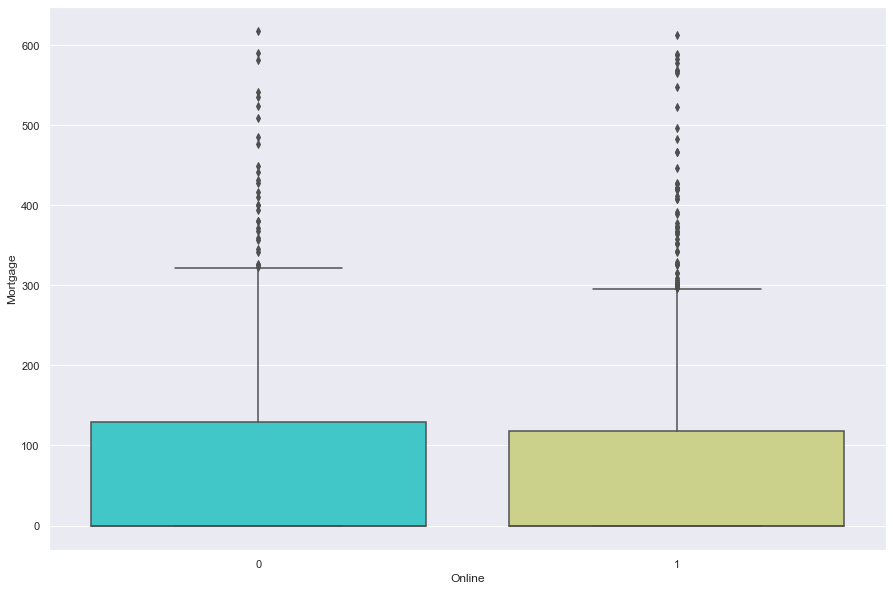

Mortgage by Online Strip Plot


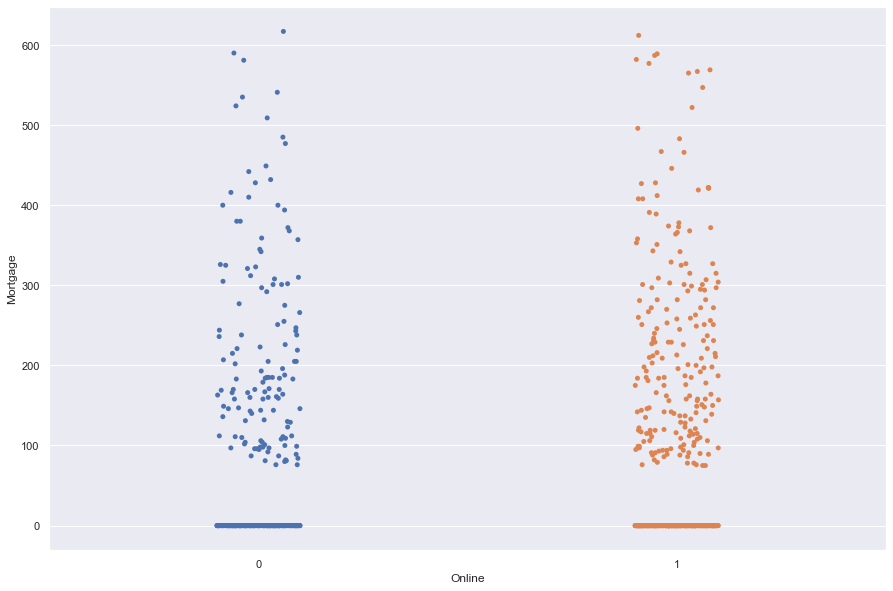

Mortgage by CreditCard Bar Plot


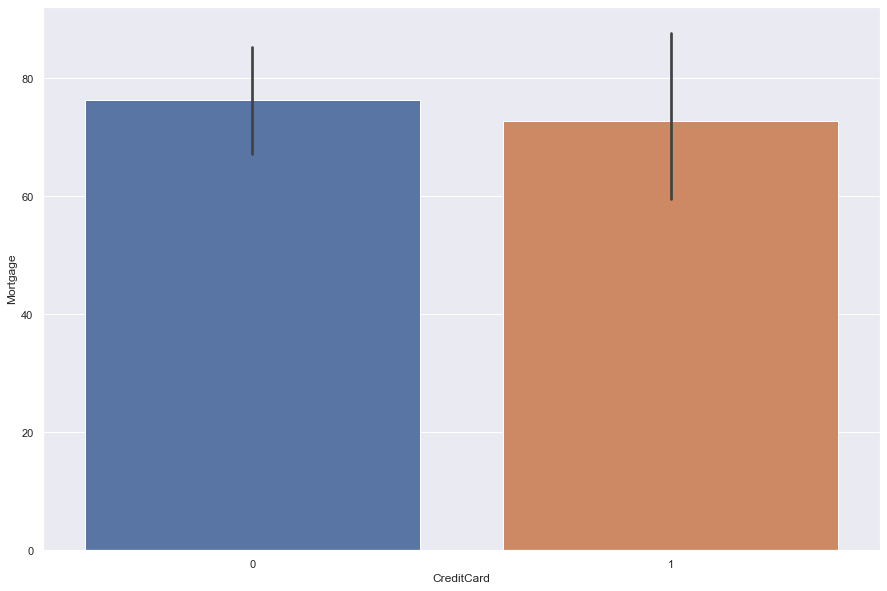

Mortgage by CreditCard Box Plot


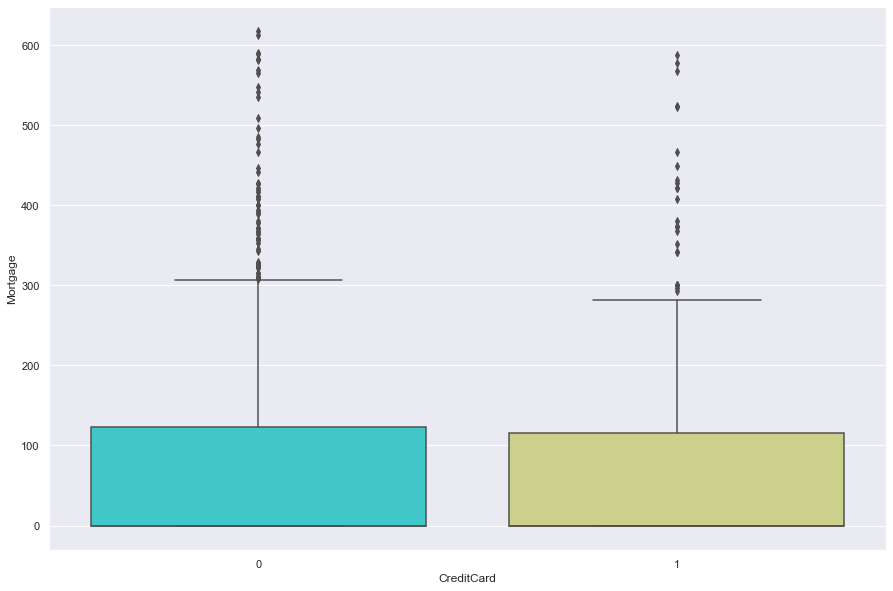

Mortgage by CreditCard Strip Plot


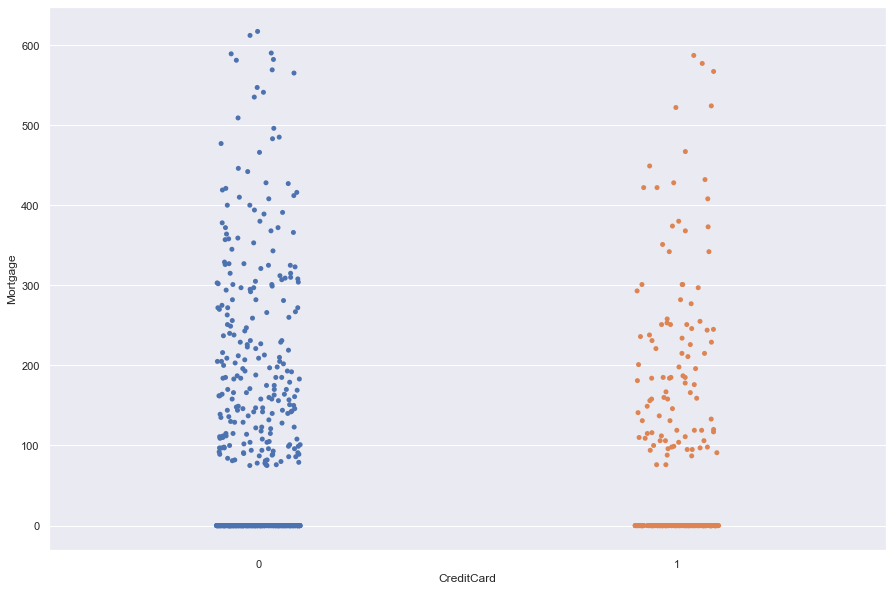

Personal_Loan by Securities_Account Bar Plot


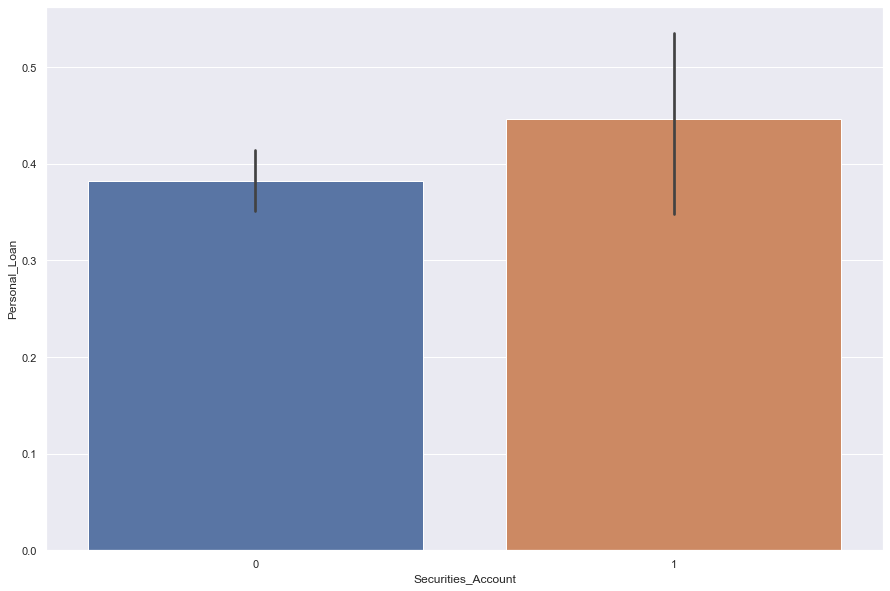

Personal_Loan by Securities_Account Box Plot


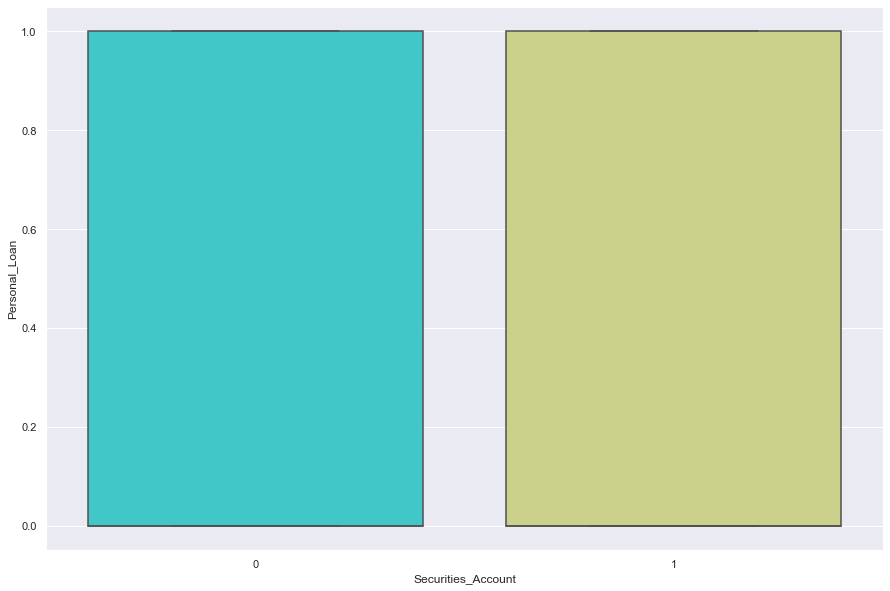

Personal_Loan by Securities_Account Strip Plot


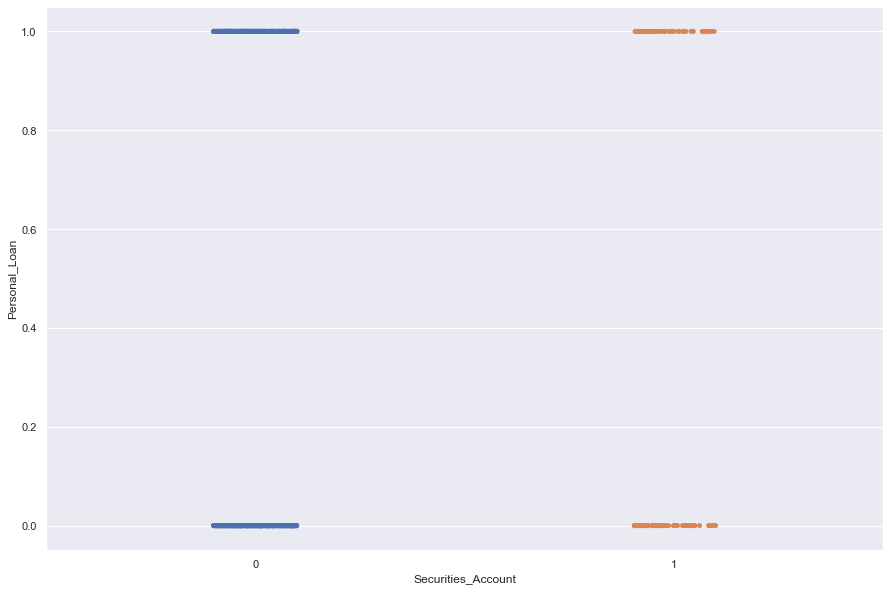

Personal_Loan by CD_Account Bar Plot


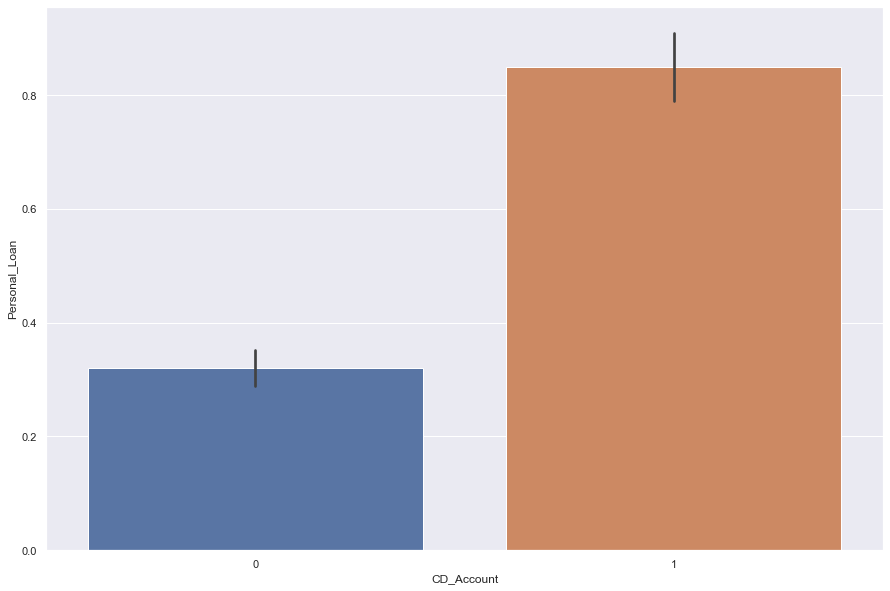

Personal_Loan by CD_Account Box Plot


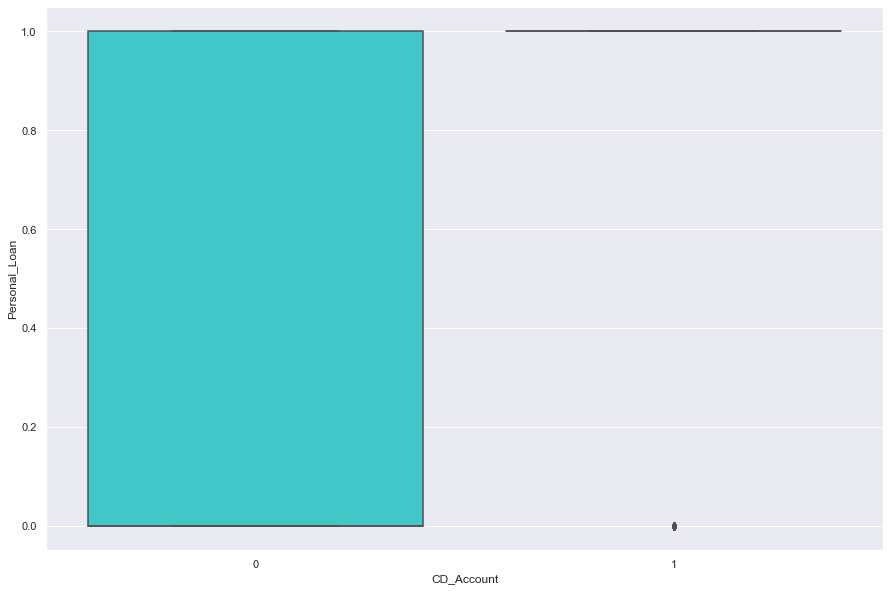

Personal_Loan by CD_Account Strip Plot


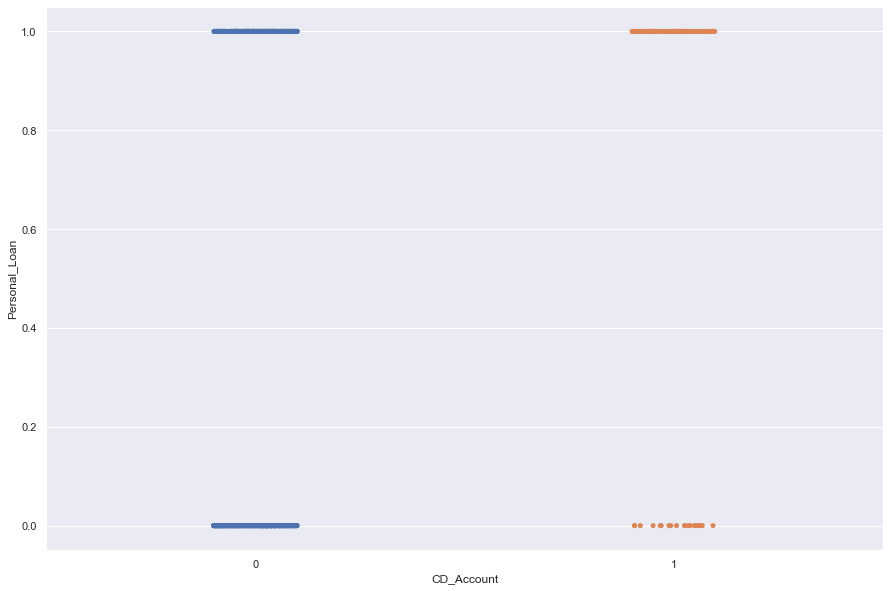

Personal_Loan by Online Bar Plot


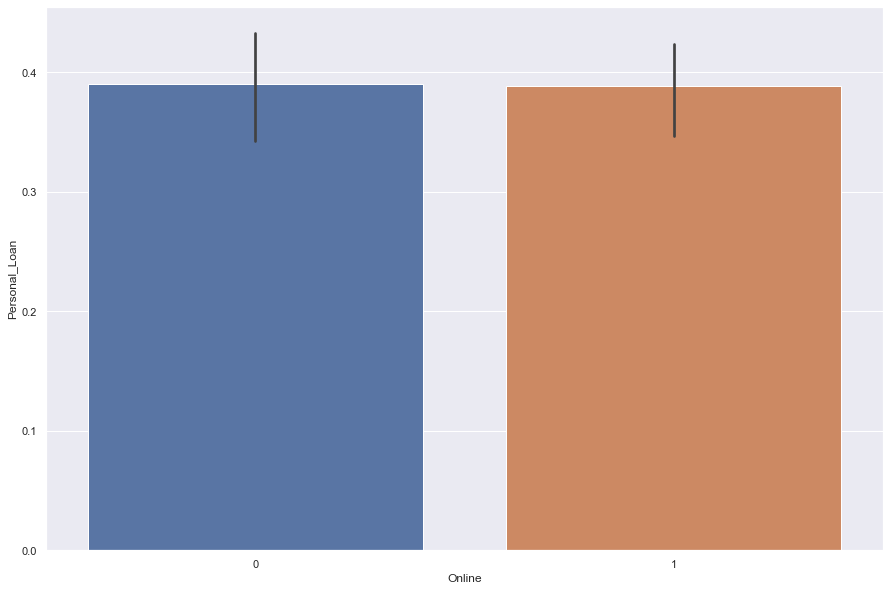

Personal_Loan by Online Box Plot


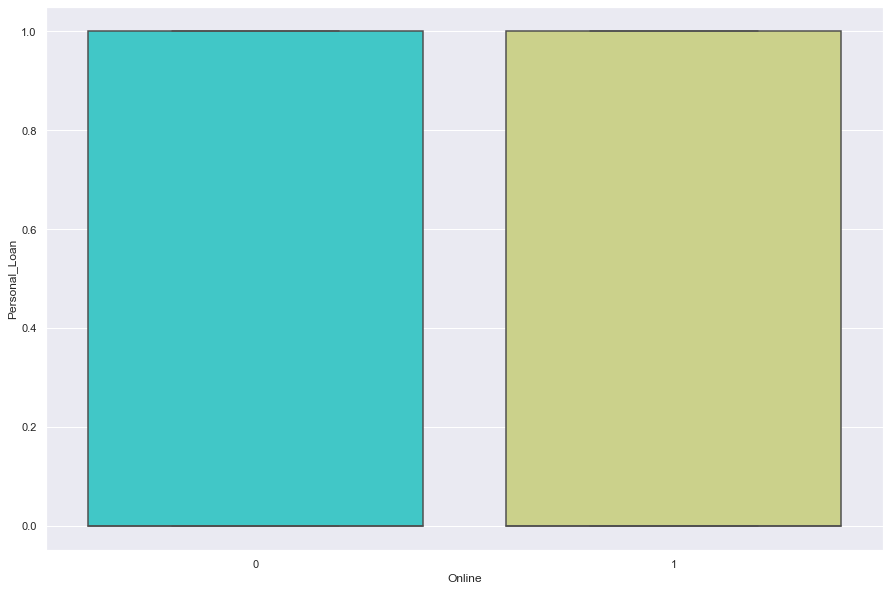

Personal_Loan by Online Strip Plot


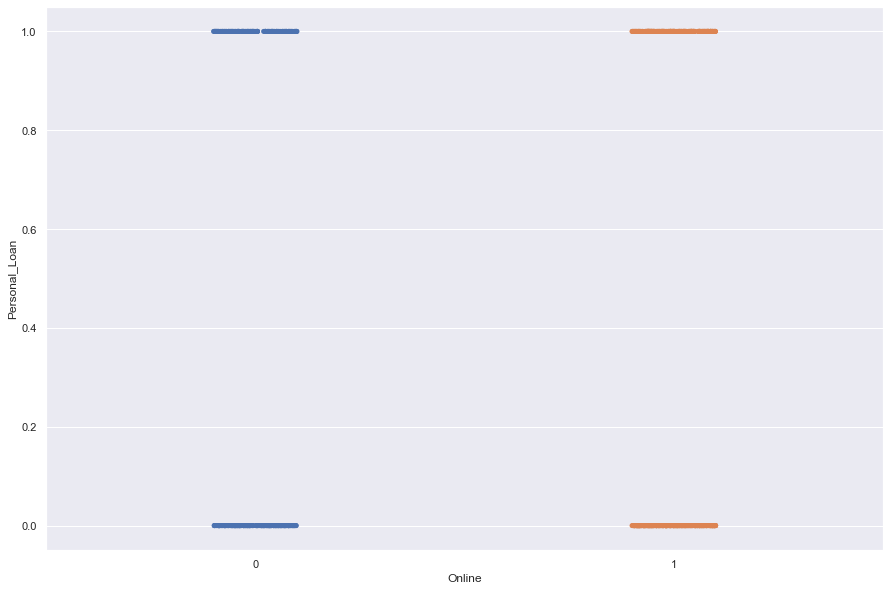

Personal_Loan by CreditCard Bar Plot


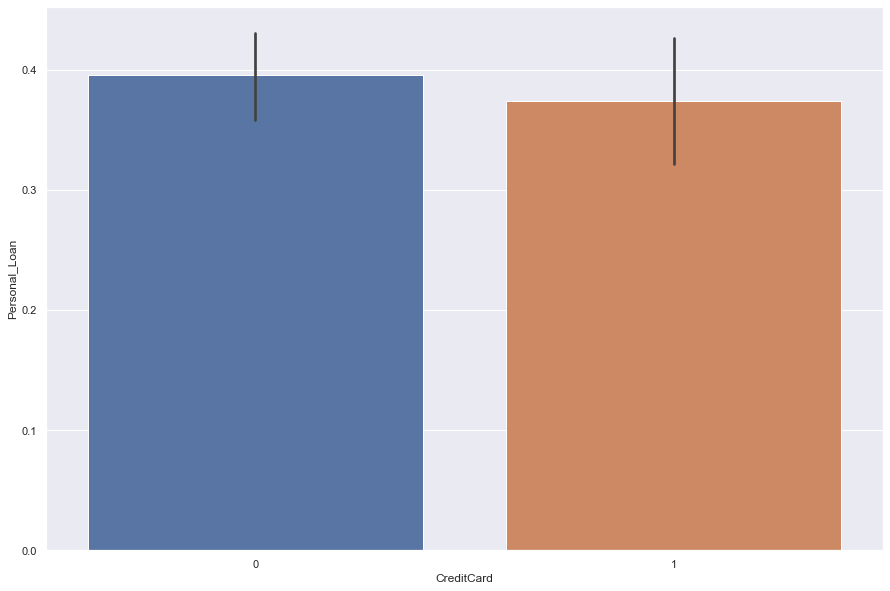

Personal_Loan by CreditCard Box Plot


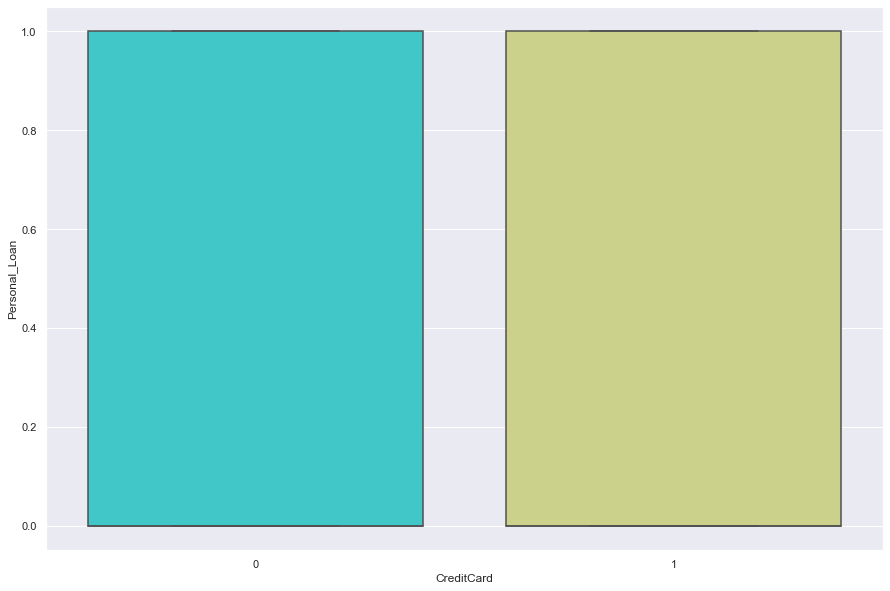

Personal_Loan by CreditCard Strip Plot


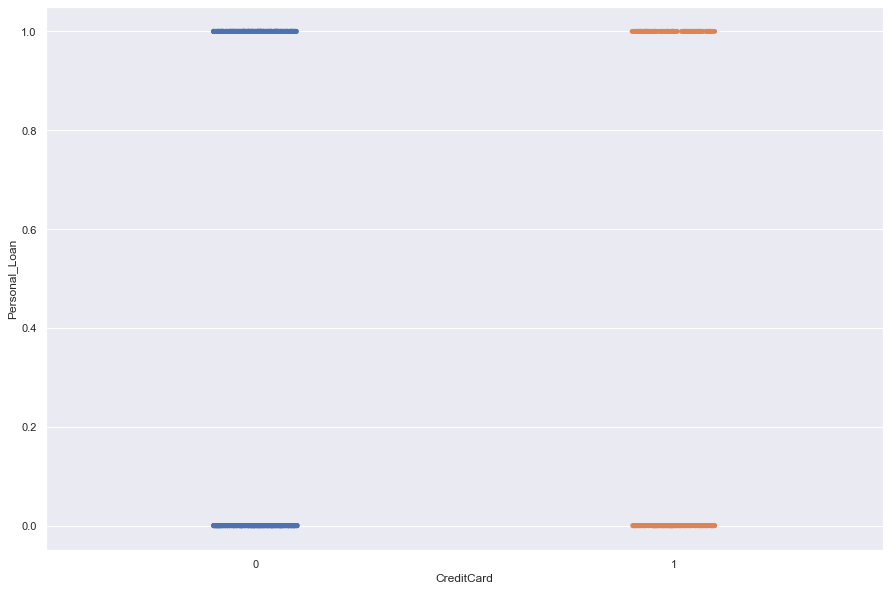

<IPython.core.display.Javascript object>

In [326]:
# Bivariate visualization of categorical against numerical variables
cats = df_inc.loc[:, "Securities_Account":"CreditCard"]

num = df_inc.loc[:, "Age":"Personal_Loan":1]

for a in num:  # for every categorical column

    for b in cats:  # pair it with a numeric variable

        # Bar plot against a numeric variable
        print(a, "by", b, "Bar Plot")
        plt.figure(figsize=(15, 10))
        sns.barplot(x=df_inc[b], y=df_inc[a])
        plt.show()

        # Box plot against a numeric variable
        print(a, "by", b, "Box Plot")
        plt.figure(figsize=(15, 10))
        sns.boxplot(data=df, x=df_inc[b], y=df_inc[a], palette="rainbow")
        plt.show()

        # Scatter plot against a numeric variable
        print(a, "by", b, "Strip Plot")
        plt.figure(figsize=(15, 10))
        sns.stripplot(x=df_inc[b], y=df_inc[a])
        plt.show()

#### Numerics

Age by Age Strip Plot


<Figure size 1080x720 with 0 Axes>

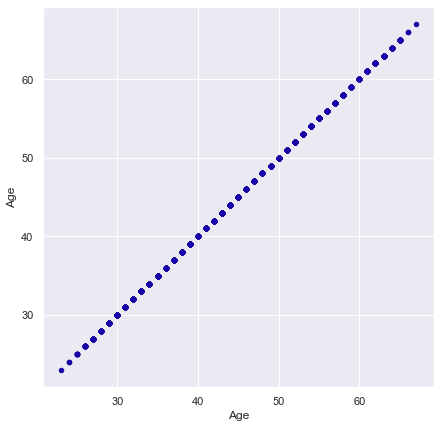

Age by Experience Strip Plot


<Figure size 1080x720 with 0 Axes>

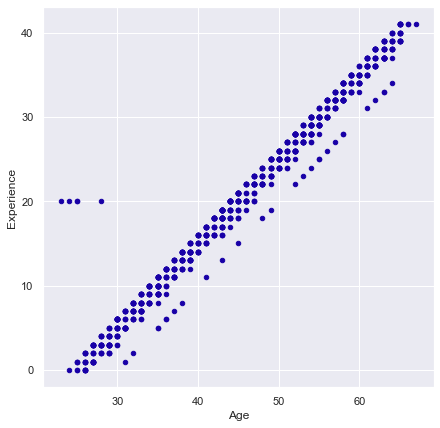

Age by Income Strip Plot


<Figure size 1080x720 with 0 Axes>

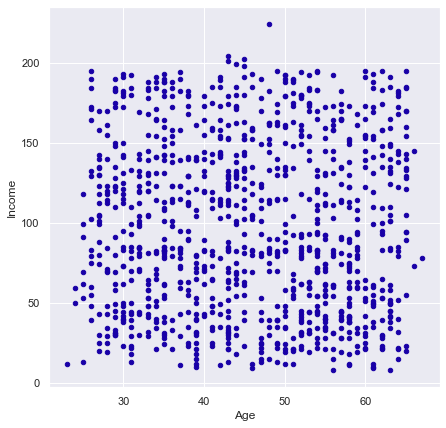

Age by Family Strip Plot


<Figure size 1080x720 with 0 Axes>

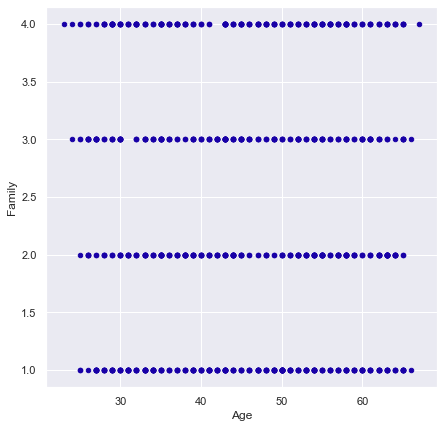

Age by CCAvg Strip Plot


<Figure size 1080x720 with 0 Axes>

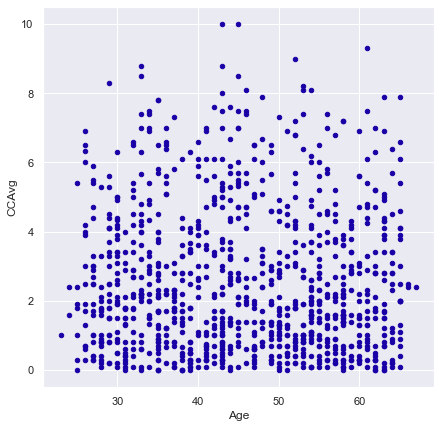

Age by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

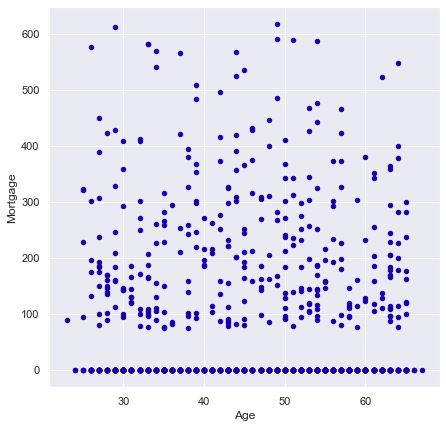

Age by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

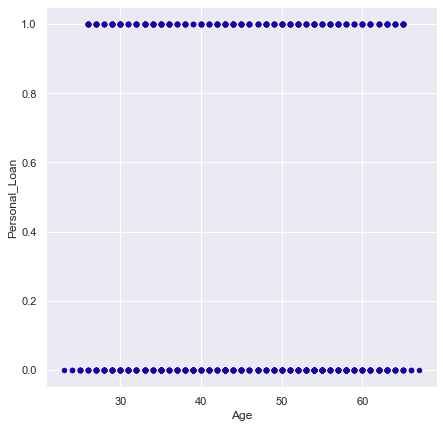

Age by Securities_Account Strip Plot


<Figure size 1080x720 with 0 Axes>

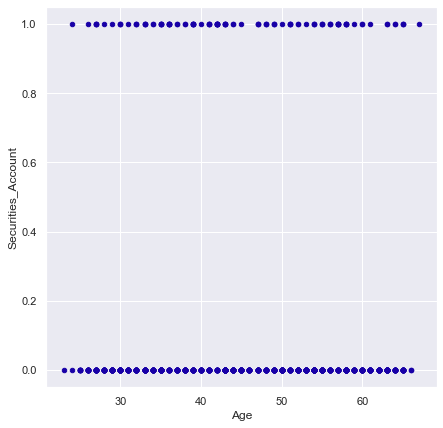

Age by CD_Account Strip Plot


<Figure size 1080x720 with 0 Axes>

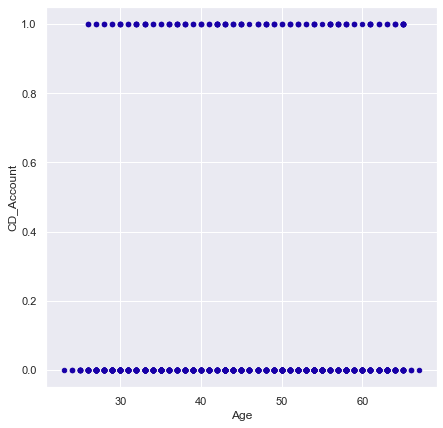

Age by Online Strip Plot


<Figure size 1080x720 with 0 Axes>

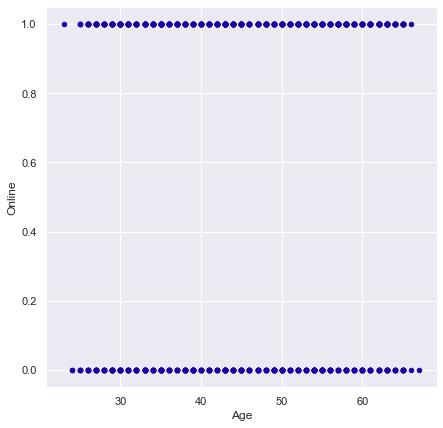

Age by CreditCard Strip Plot


<Figure size 1080x720 with 0 Axes>

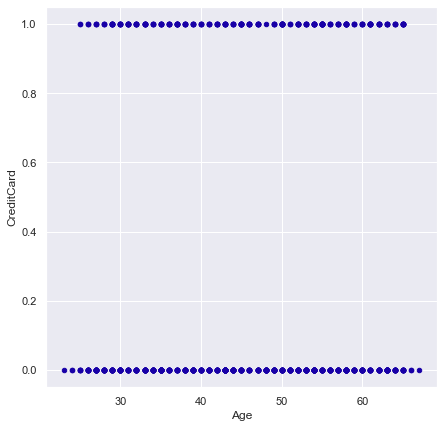

Age by ZIPCode_91 Strip Plot


<Figure size 1080x720 with 0 Axes>

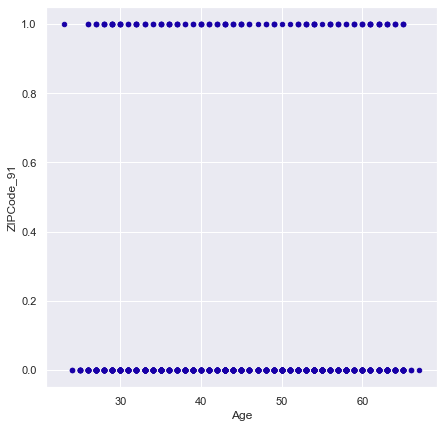

Age by ZIPCode_92 Strip Plot


<Figure size 1080x720 with 0 Axes>

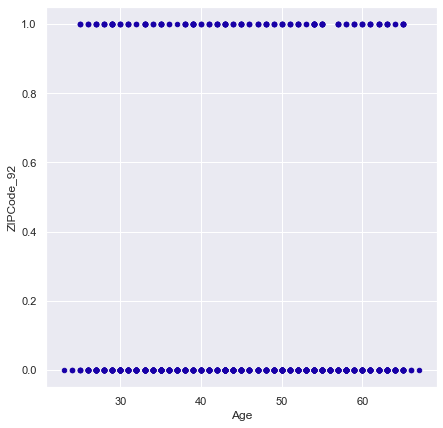

Age by ZIPCode_93 Strip Plot


<Figure size 1080x720 with 0 Axes>

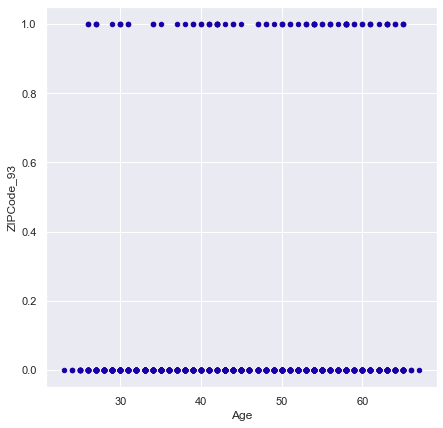

Age by ZIPCode_94 Strip Plot


<Figure size 1080x720 with 0 Axes>

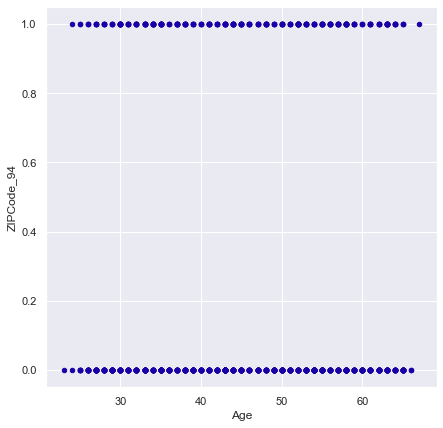

Age by ZIPCode_95 Strip Plot


<Figure size 1080x720 with 0 Axes>

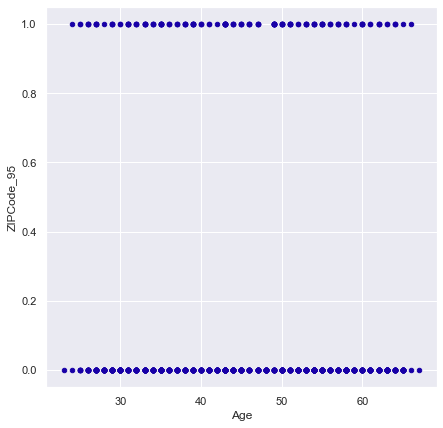

Age by ZIPCode_96 Strip Plot


<Figure size 1080x720 with 0 Axes>

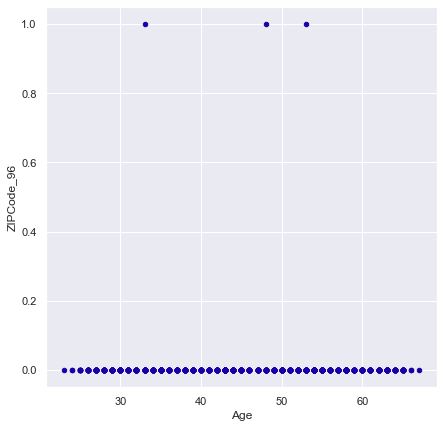

Age by Education_Professional Strip Plot


<Figure size 1080x720 with 0 Axes>

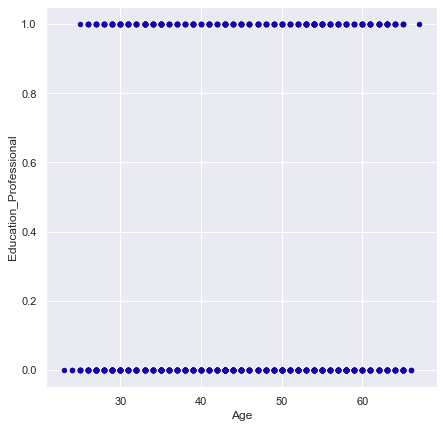

Age by Education_Undergraduate Strip Plot


<Figure size 1080x720 with 0 Axes>

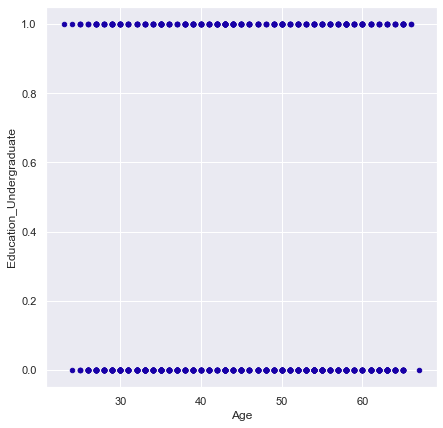

Age by preds Strip Plot


<Figure size 1080x720 with 0 Axes>

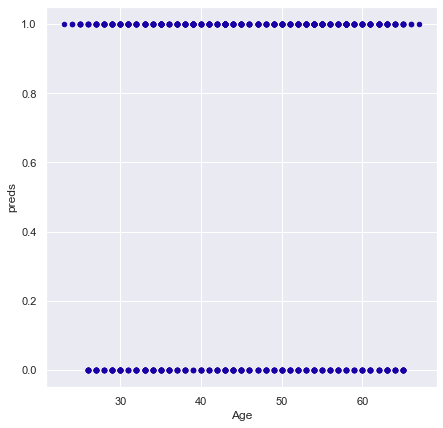

Experience by Age Strip Plot


<Figure size 1080x720 with 0 Axes>

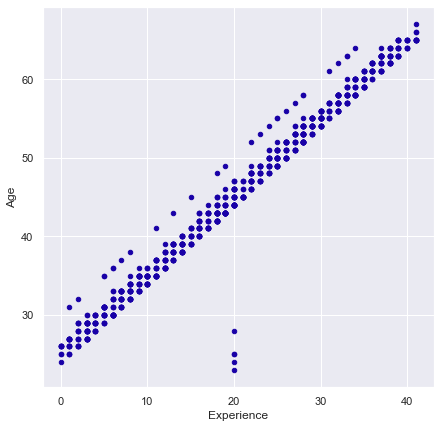

Experience by Experience Strip Plot


<Figure size 1080x720 with 0 Axes>

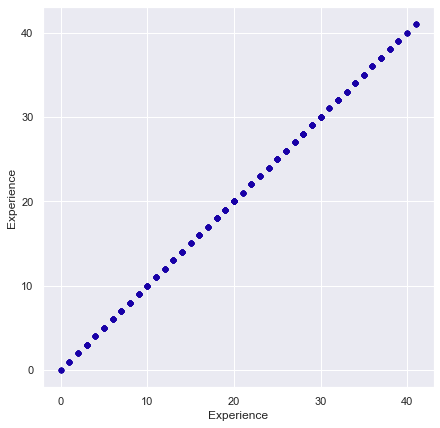

Experience by Income Strip Plot


<Figure size 1080x720 with 0 Axes>

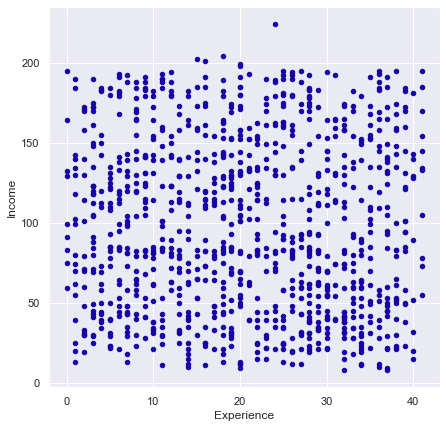

Experience by Family Strip Plot


<Figure size 1080x720 with 0 Axes>

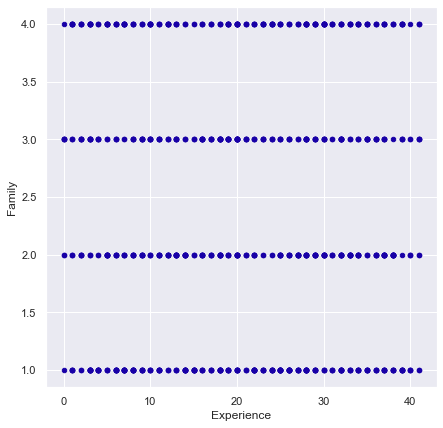

Experience by CCAvg Strip Plot


<Figure size 1080x720 with 0 Axes>

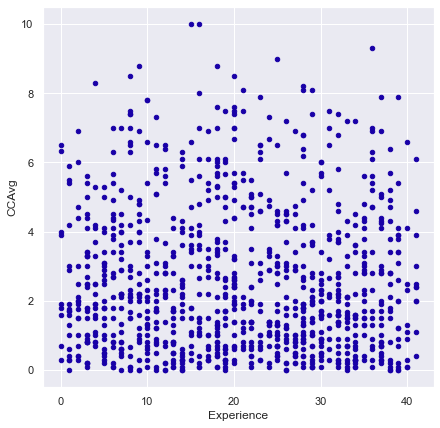

Experience by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

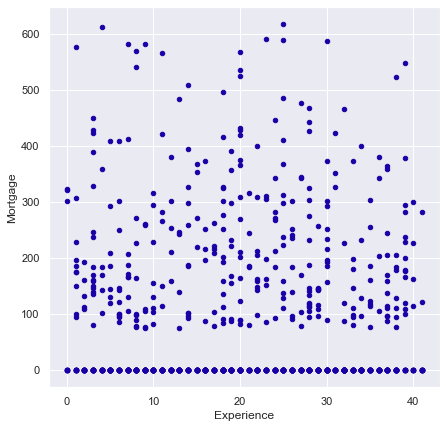

Experience by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

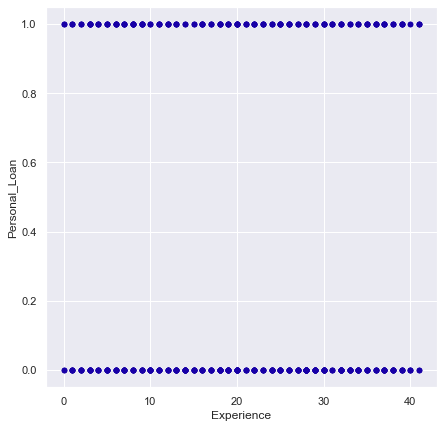

Experience by Securities_Account Strip Plot


<Figure size 1080x720 with 0 Axes>

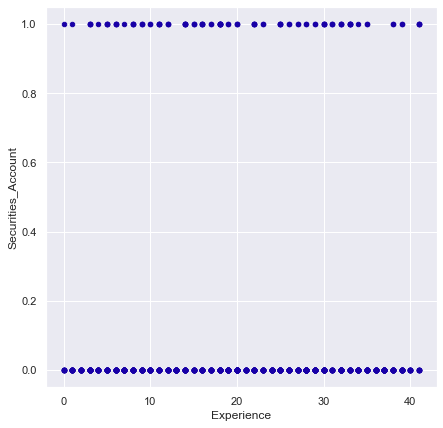

Experience by CD_Account Strip Plot


<Figure size 1080x720 with 0 Axes>

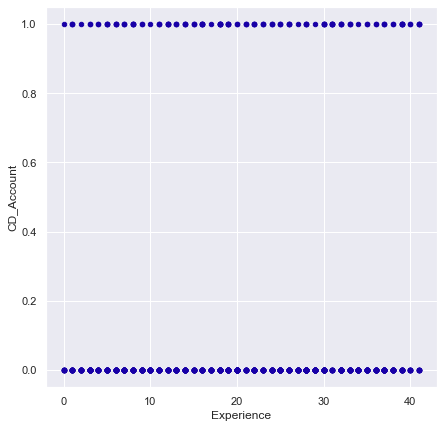

Experience by Online Strip Plot


<Figure size 1080x720 with 0 Axes>

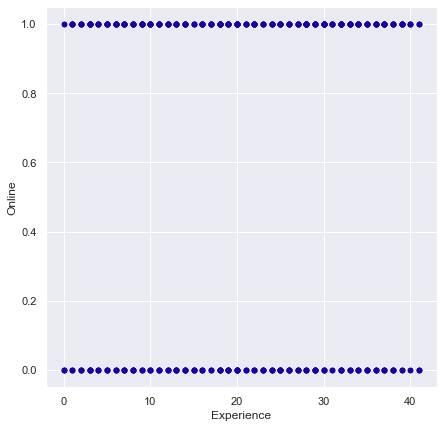

Experience by CreditCard Strip Plot


<Figure size 1080x720 with 0 Axes>

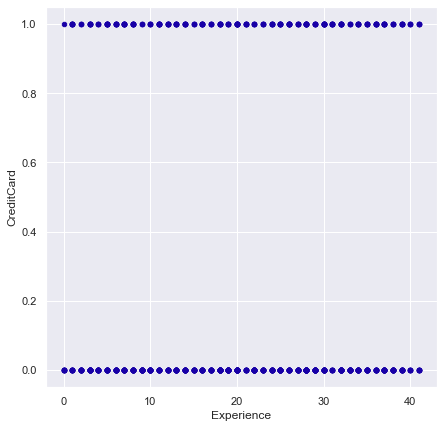

Experience by ZIPCode_91 Strip Plot


<Figure size 1080x720 with 0 Axes>

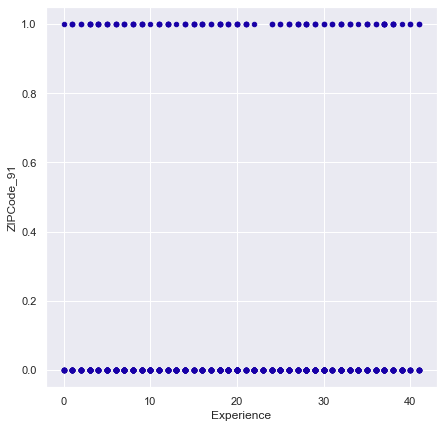

Experience by ZIPCode_92 Strip Plot


<Figure size 1080x720 with 0 Axes>

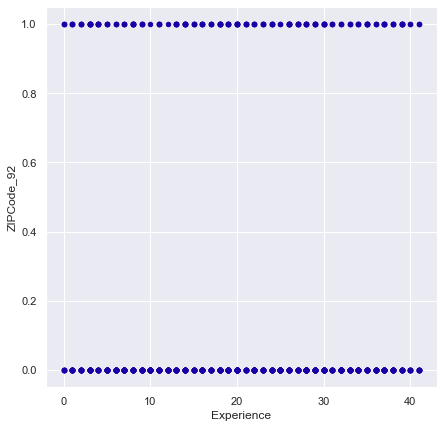

Experience by ZIPCode_93 Strip Plot


<Figure size 1080x720 with 0 Axes>

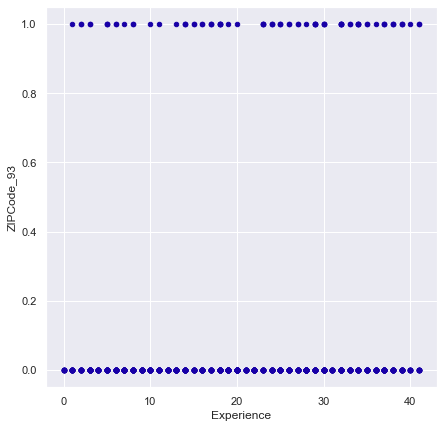

Experience by ZIPCode_94 Strip Plot


<Figure size 1080x720 with 0 Axes>

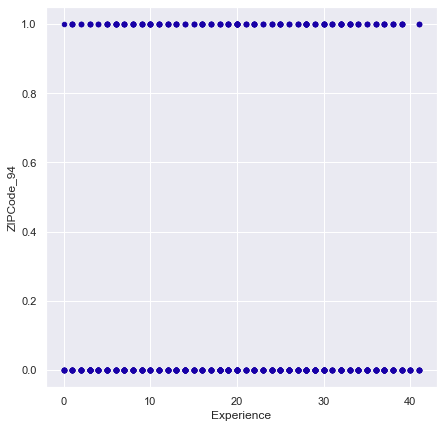

Experience by ZIPCode_95 Strip Plot


<Figure size 1080x720 with 0 Axes>

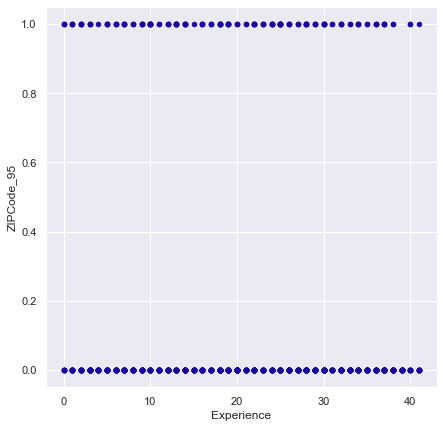

Experience by ZIPCode_96 Strip Plot


<Figure size 1080x720 with 0 Axes>

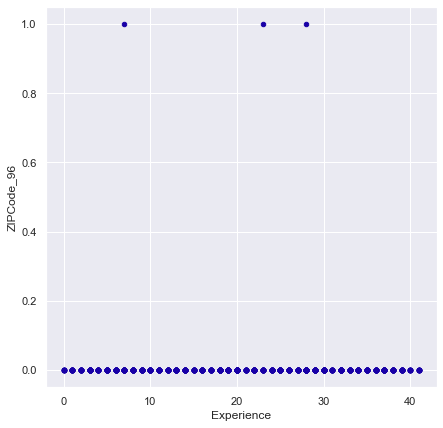

Experience by Education_Professional Strip Plot


<Figure size 1080x720 with 0 Axes>

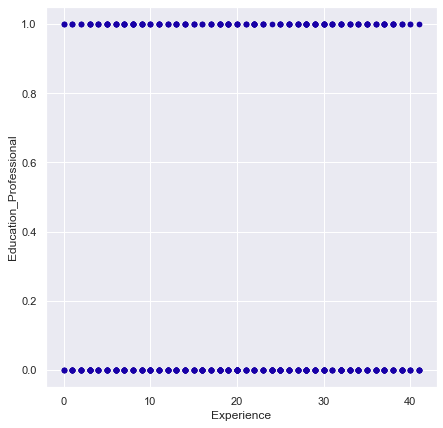

Experience by Education_Undergraduate Strip Plot


<Figure size 1080x720 with 0 Axes>

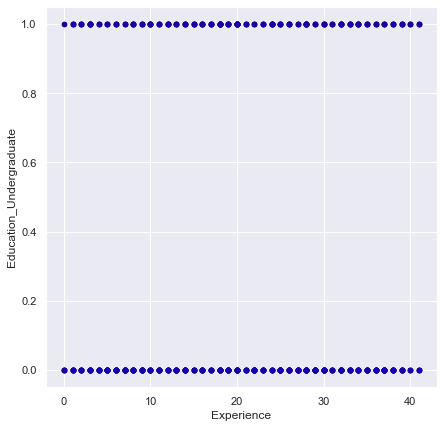

Experience by preds Strip Plot


<Figure size 1080x720 with 0 Axes>

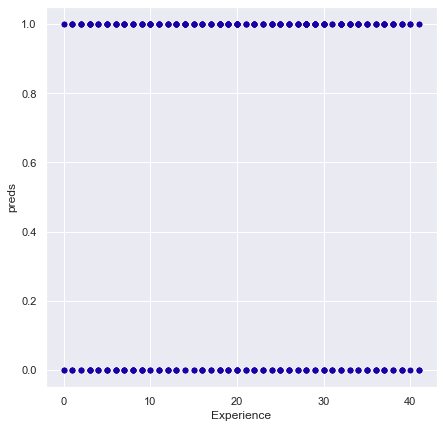

Income by Age Strip Plot


<Figure size 1080x720 with 0 Axes>

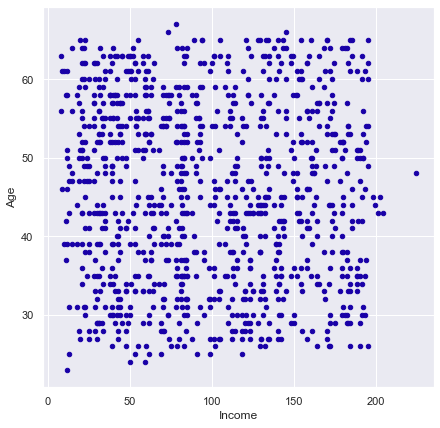

Income by Experience Strip Plot


<Figure size 1080x720 with 0 Axes>

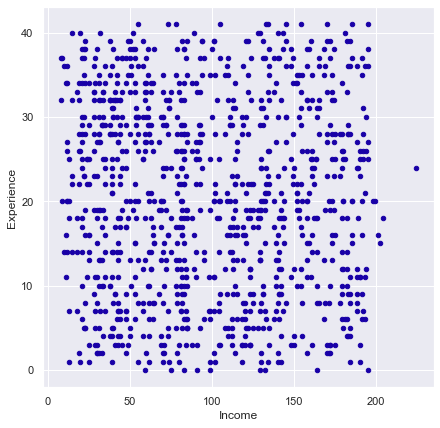

Income by Income Strip Plot


<Figure size 1080x720 with 0 Axes>

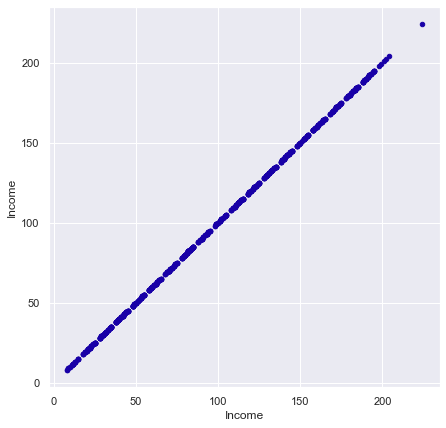

Income by Family Strip Plot


<Figure size 1080x720 with 0 Axes>

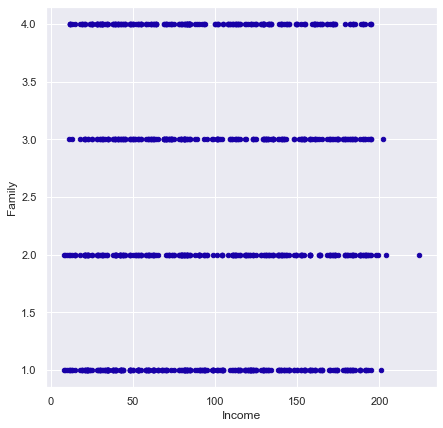

Income by CCAvg Strip Plot


<Figure size 1080x720 with 0 Axes>

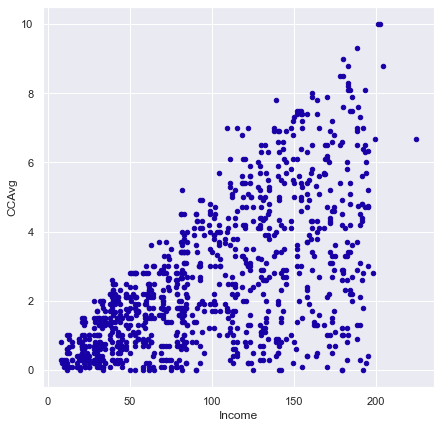

Income by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

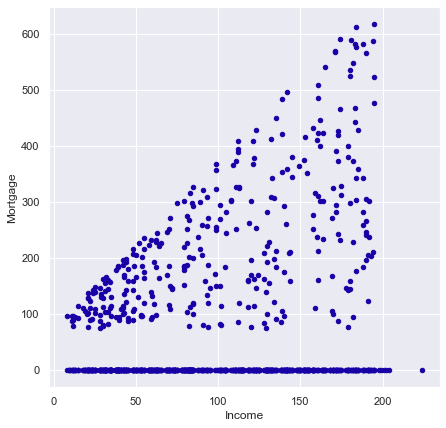

Income by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

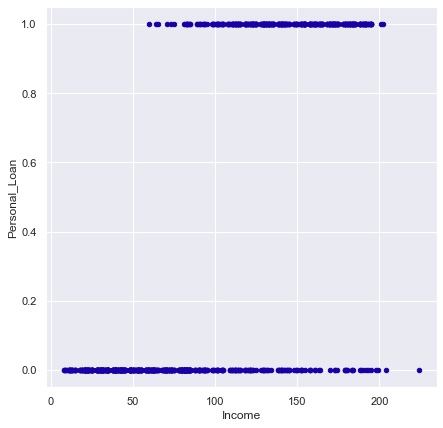

Income by Securities_Account Strip Plot


<Figure size 1080x720 with 0 Axes>

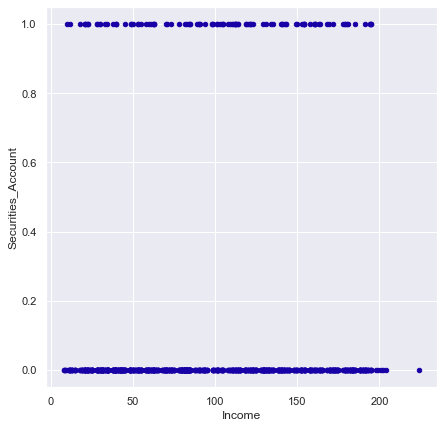

Income by CD_Account Strip Plot


<Figure size 1080x720 with 0 Axes>

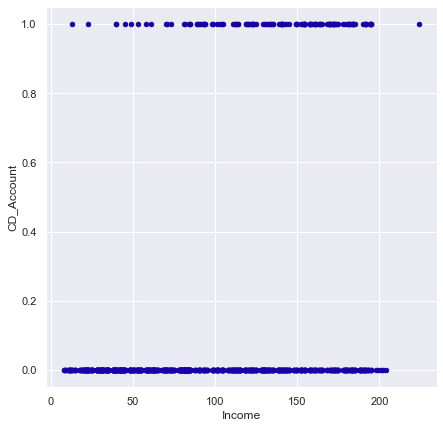

Income by Online Strip Plot


<Figure size 1080x720 with 0 Axes>

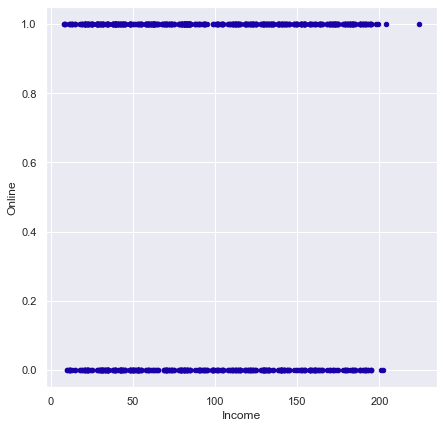

Income by CreditCard Strip Plot


<Figure size 1080x720 with 0 Axes>

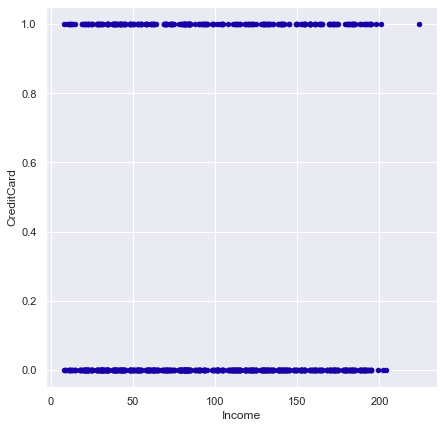

Income by ZIPCode_91 Strip Plot


<Figure size 1080x720 with 0 Axes>

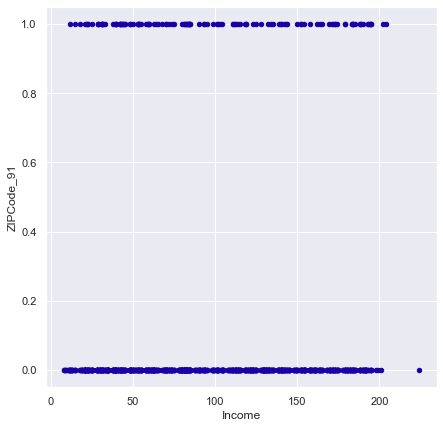

Income by ZIPCode_92 Strip Plot


<Figure size 1080x720 with 0 Axes>

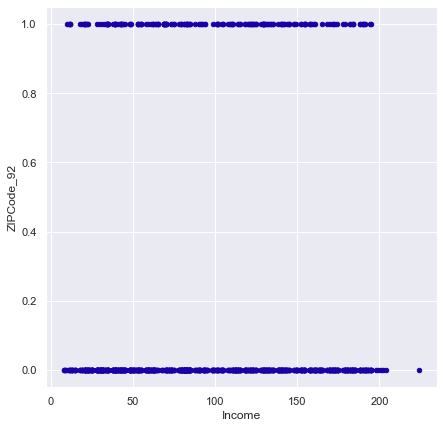

Income by ZIPCode_93 Strip Plot


<Figure size 1080x720 with 0 Axes>

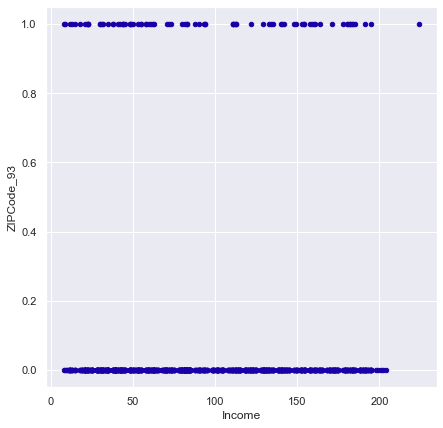

Income by ZIPCode_94 Strip Plot


<Figure size 1080x720 with 0 Axes>

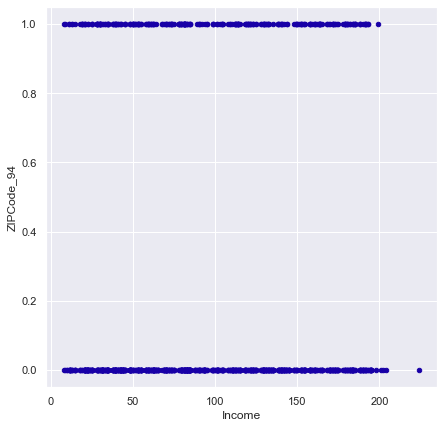

Income by ZIPCode_95 Strip Plot


<Figure size 1080x720 with 0 Axes>

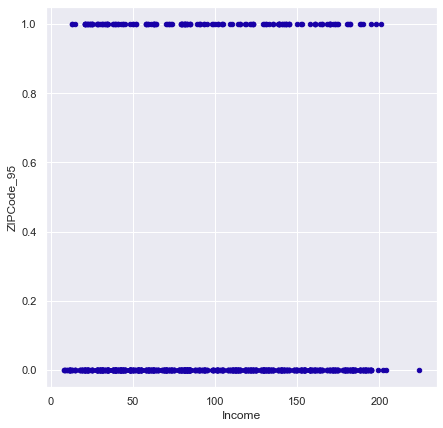

Income by ZIPCode_96 Strip Plot


<Figure size 1080x720 with 0 Axes>

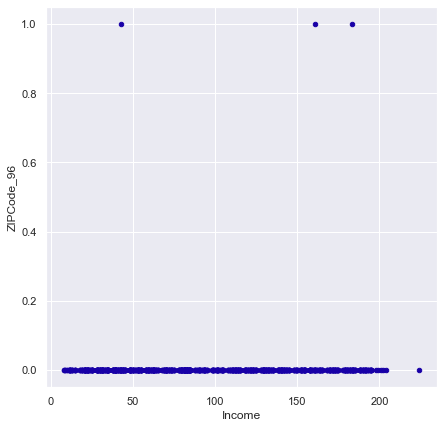

Income by Education_Professional Strip Plot


<Figure size 1080x720 with 0 Axes>

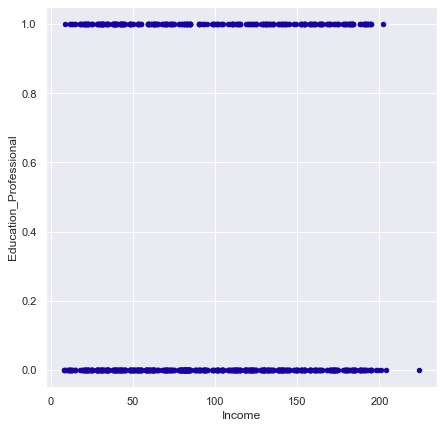

Income by Education_Undergraduate Strip Plot


<Figure size 1080x720 with 0 Axes>

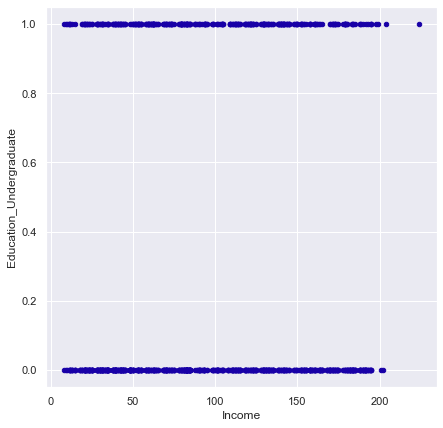

Income by preds Strip Plot


<Figure size 1080x720 with 0 Axes>

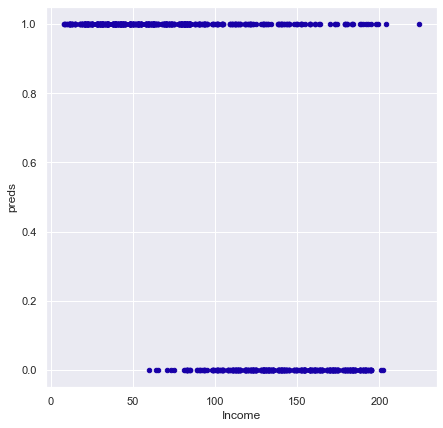

Family by Age Strip Plot


<Figure size 1080x720 with 0 Axes>

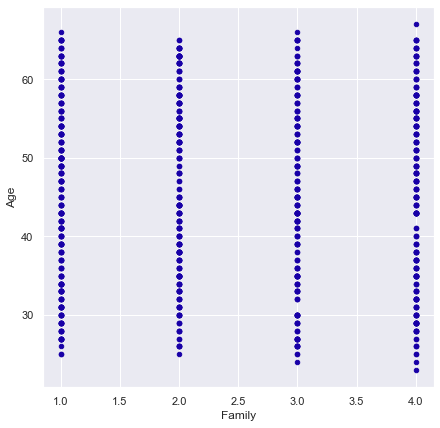

Family by Experience Strip Plot


<Figure size 1080x720 with 0 Axes>

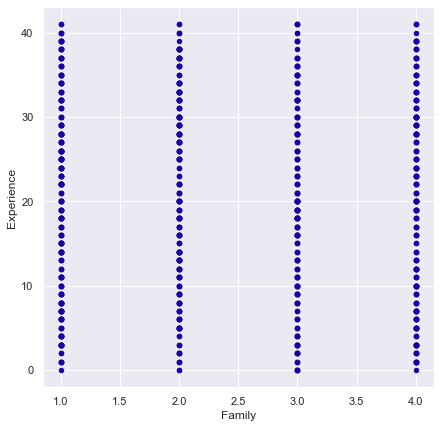

Family by Income Strip Plot


<Figure size 1080x720 with 0 Axes>

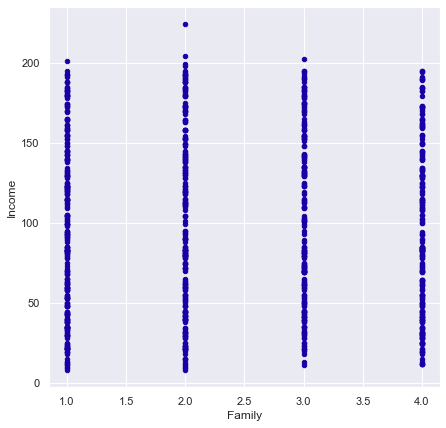

Family by Family Strip Plot


<Figure size 1080x720 with 0 Axes>

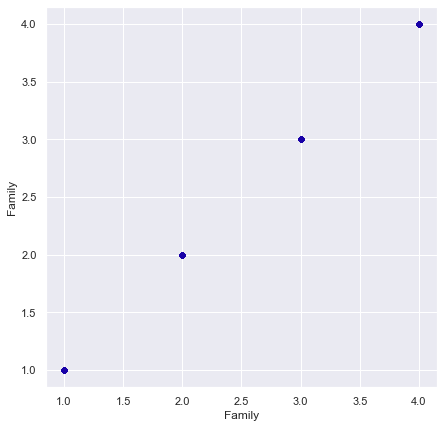

Family by CCAvg Strip Plot


<Figure size 1080x720 with 0 Axes>

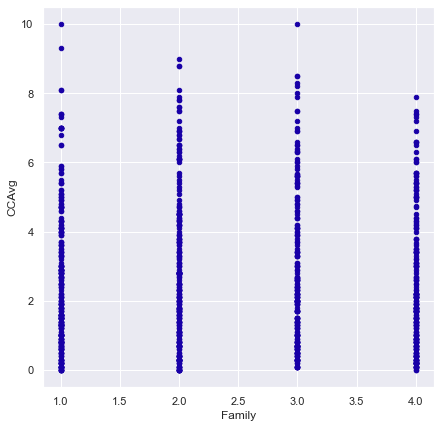

Family by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

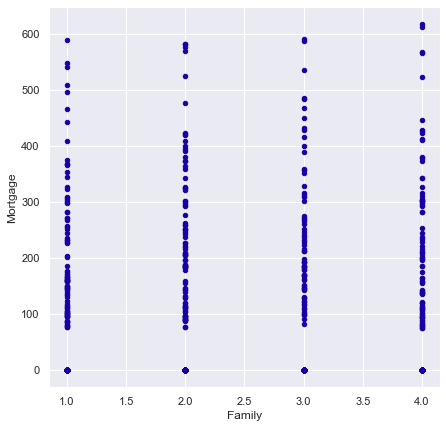

Family by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

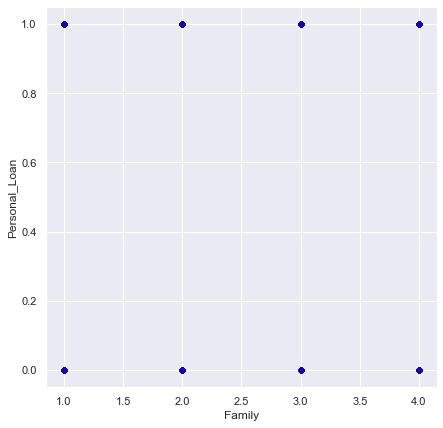

Family by Securities_Account Strip Plot


<Figure size 1080x720 with 0 Axes>

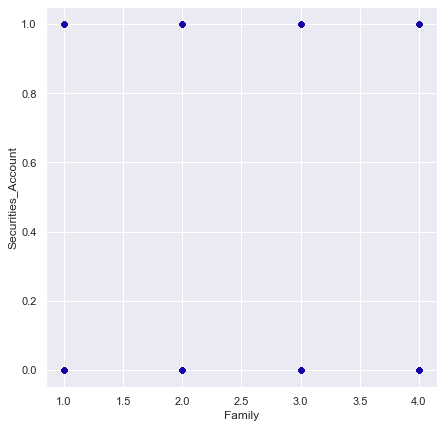

Family by CD_Account Strip Plot


<Figure size 1080x720 with 0 Axes>

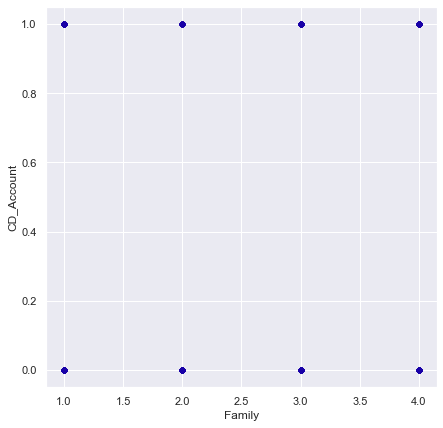

Family by Online Strip Plot


<Figure size 1080x720 with 0 Axes>

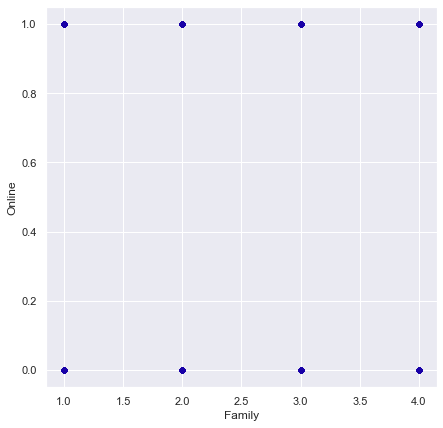

Family by CreditCard Strip Plot


<Figure size 1080x720 with 0 Axes>

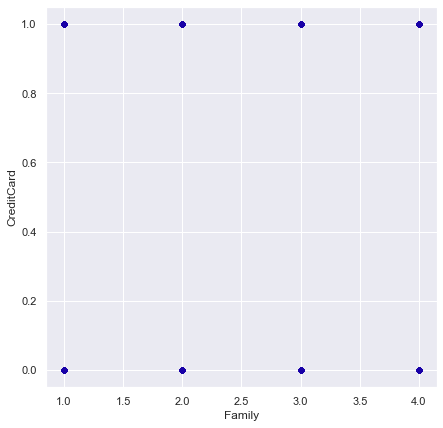

Family by ZIPCode_91 Strip Plot


<Figure size 1080x720 with 0 Axes>

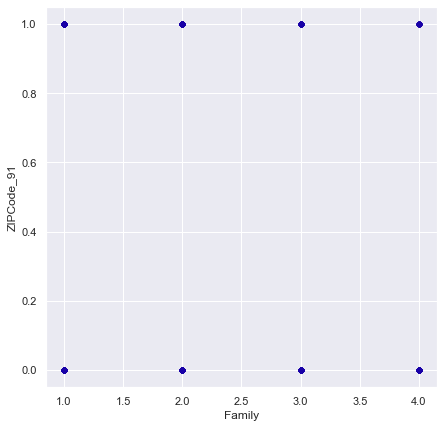

Family by ZIPCode_92 Strip Plot


<Figure size 1080x720 with 0 Axes>

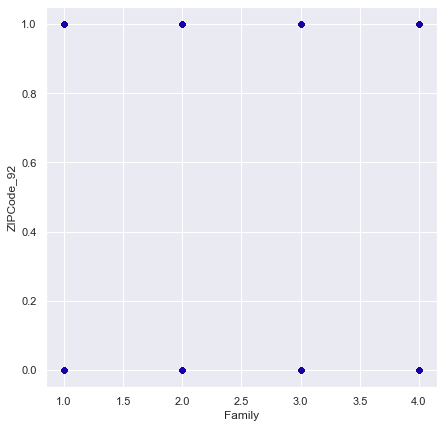

Family by ZIPCode_93 Strip Plot


<Figure size 1080x720 with 0 Axes>

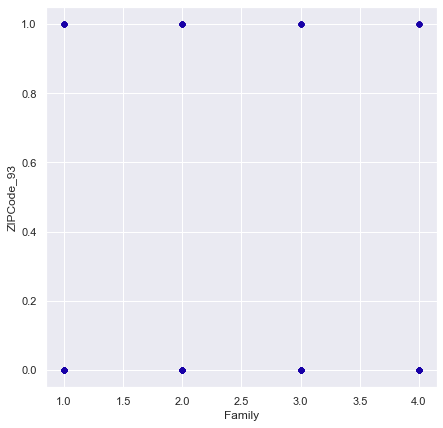

Family by ZIPCode_94 Strip Plot


<Figure size 1080x720 with 0 Axes>

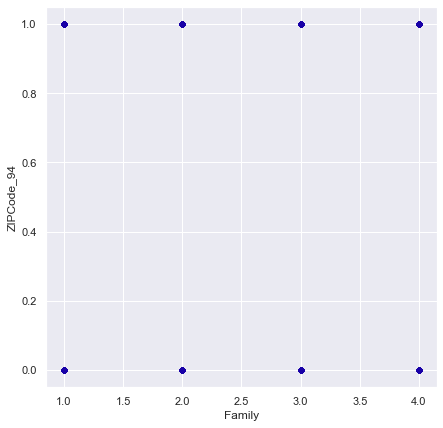

Family by ZIPCode_95 Strip Plot


<Figure size 1080x720 with 0 Axes>

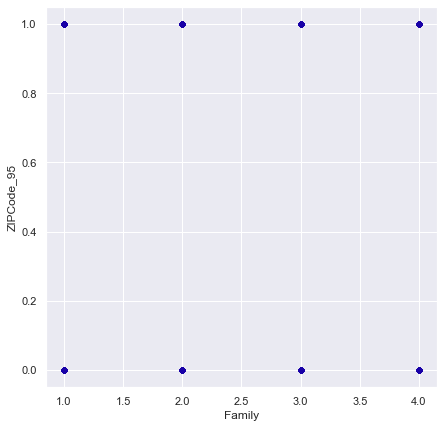

Family by ZIPCode_96 Strip Plot


<Figure size 1080x720 with 0 Axes>

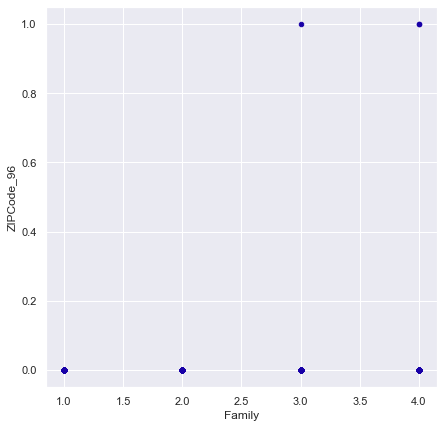

Family by Education_Professional Strip Plot


<Figure size 1080x720 with 0 Axes>

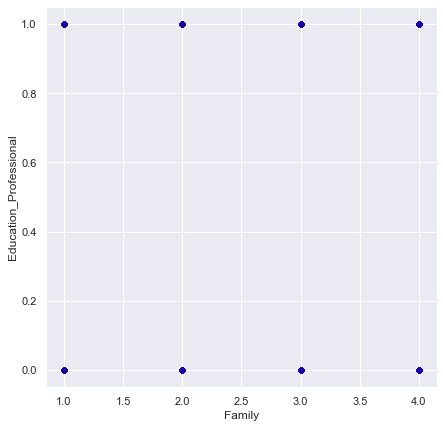

Family by Education_Undergraduate Strip Plot


<Figure size 1080x720 with 0 Axes>

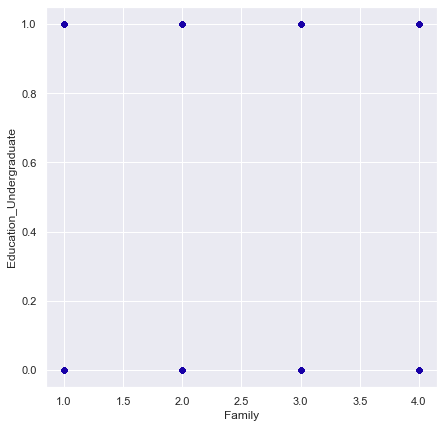

Family by preds Strip Plot


<Figure size 1080x720 with 0 Axes>

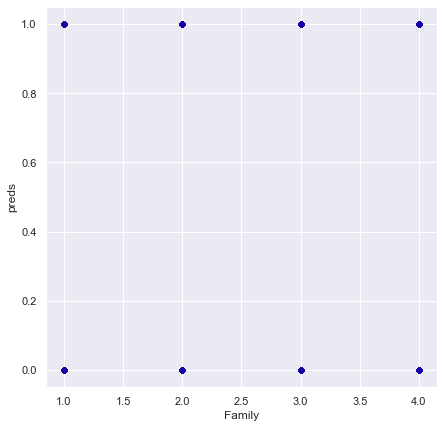

CCAvg by Age Strip Plot


<Figure size 1080x720 with 0 Axes>

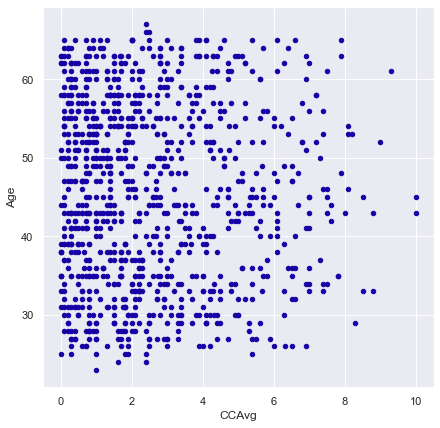

CCAvg by Experience Strip Plot


<Figure size 1080x720 with 0 Axes>

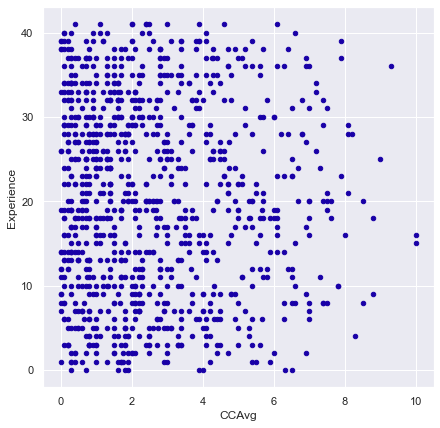

CCAvg by Income Strip Plot


<Figure size 1080x720 with 0 Axes>

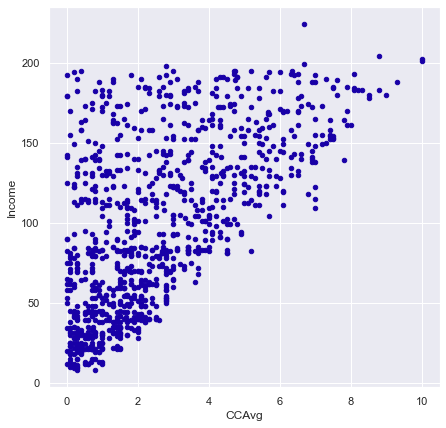

CCAvg by Family Strip Plot


<Figure size 1080x720 with 0 Axes>

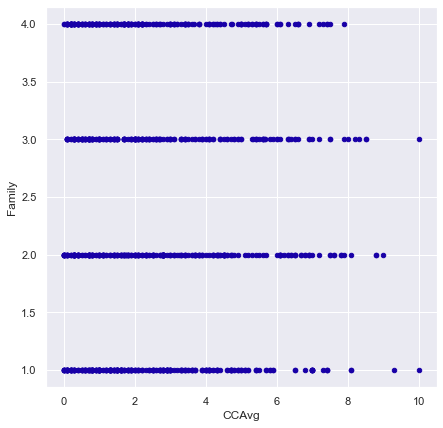

CCAvg by CCAvg Strip Plot


<Figure size 1080x720 with 0 Axes>

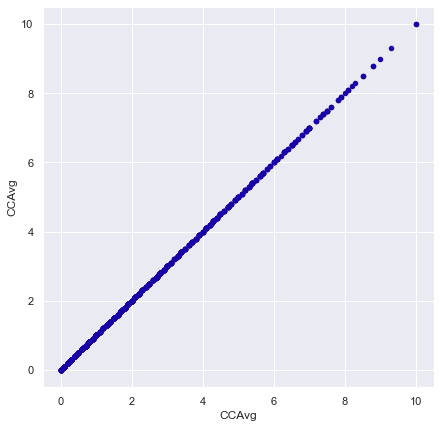

CCAvg by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

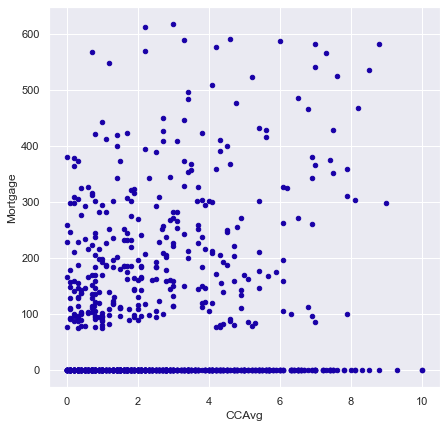

CCAvg by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

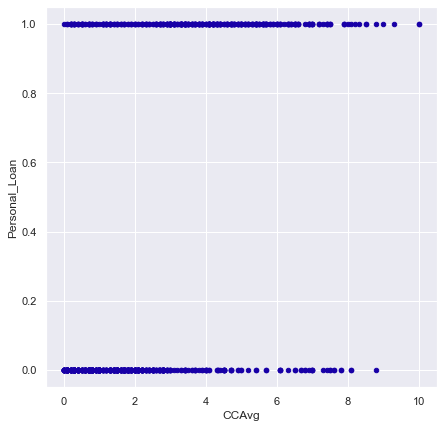

CCAvg by Securities_Account Strip Plot


<Figure size 1080x720 with 0 Axes>

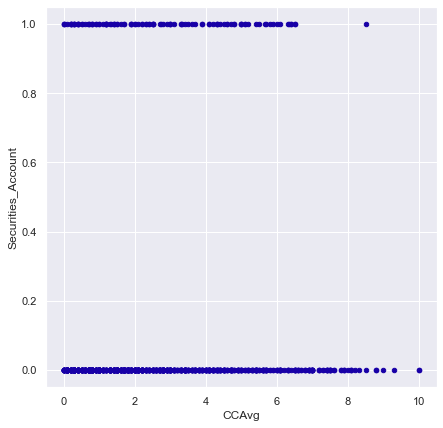

CCAvg by CD_Account Strip Plot


<Figure size 1080x720 with 0 Axes>

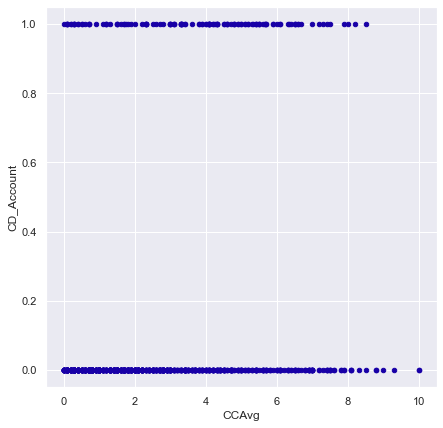

CCAvg by Online Strip Plot


<Figure size 1080x720 with 0 Axes>

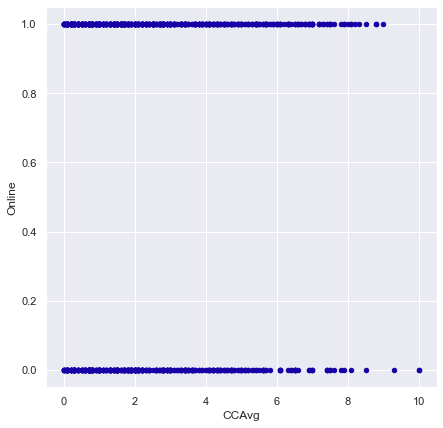

CCAvg by CreditCard Strip Plot


<Figure size 1080x720 with 0 Axes>

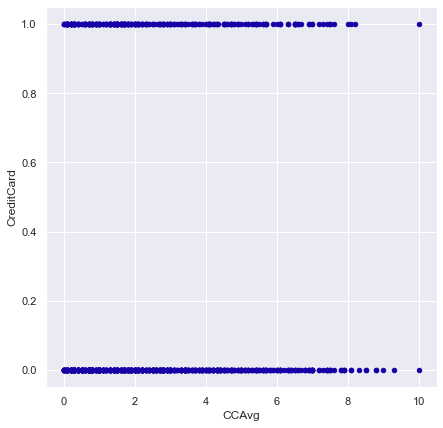

CCAvg by ZIPCode_91 Strip Plot


<Figure size 1080x720 with 0 Axes>

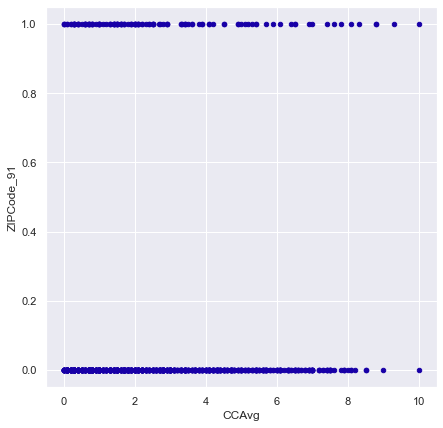

CCAvg by ZIPCode_92 Strip Plot


<Figure size 1080x720 with 0 Axes>

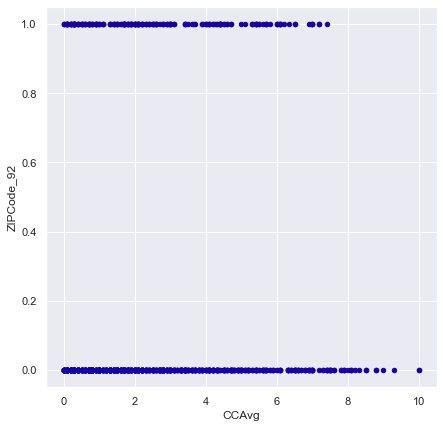

CCAvg by ZIPCode_93 Strip Plot


<Figure size 1080x720 with 0 Axes>

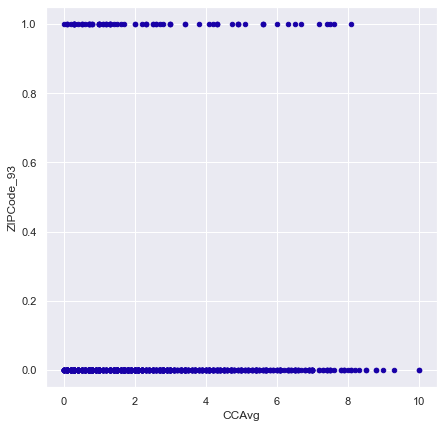

CCAvg by ZIPCode_94 Strip Plot


<Figure size 1080x720 with 0 Axes>

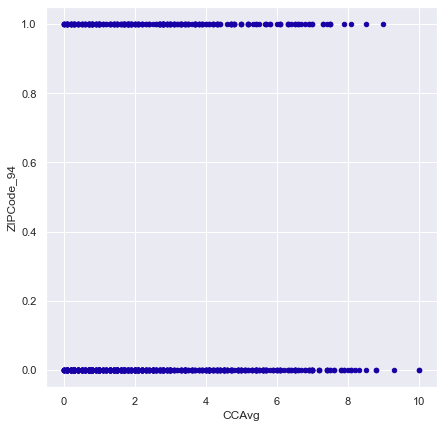

CCAvg by ZIPCode_95 Strip Plot


<Figure size 1080x720 with 0 Axes>

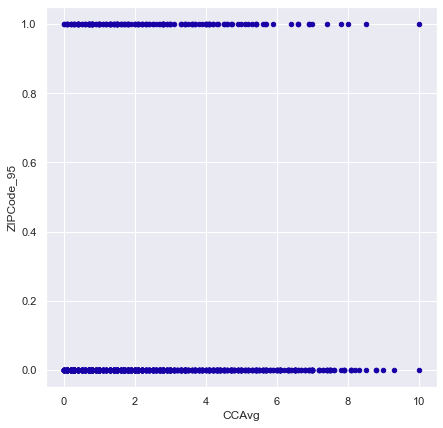

CCAvg by ZIPCode_96 Strip Plot


<Figure size 1080x720 with 0 Axes>

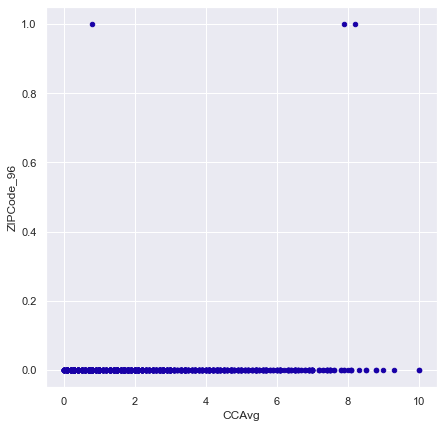

CCAvg by Education_Professional Strip Plot


<Figure size 1080x720 with 0 Axes>

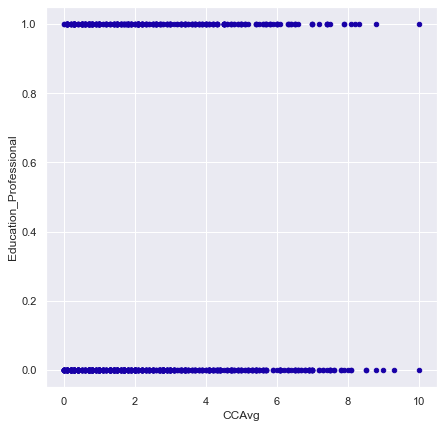

CCAvg by Education_Undergraduate Strip Plot


<Figure size 1080x720 with 0 Axes>

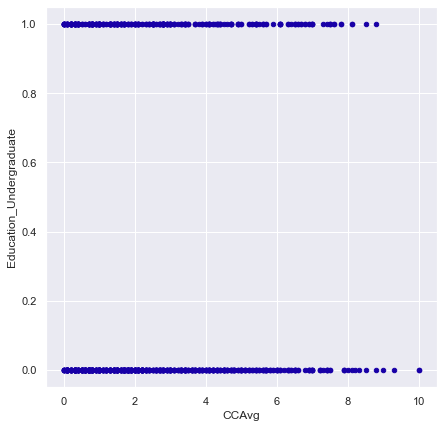

CCAvg by preds Strip Plot


<Figure size 1080x720 with 0 Axes>

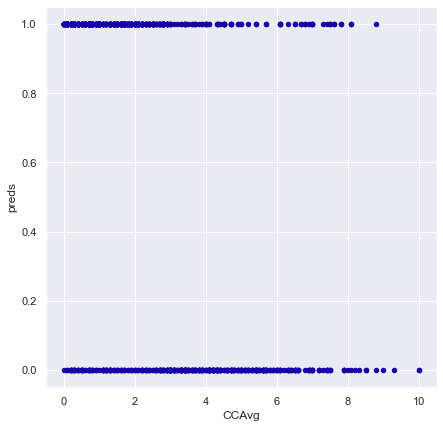

Mortgage by Age Strip Plot


<Figure size 1080x720 with 0 Axes>

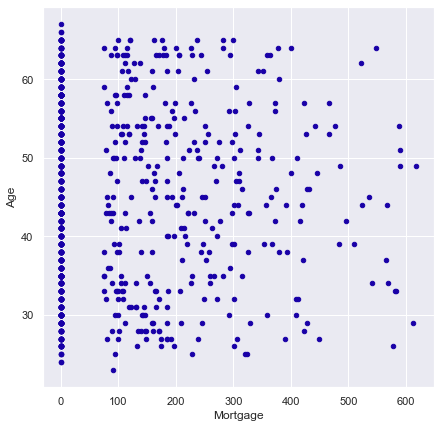

Mortgage by Experience Strip Plot


<Figure size 1080x720 with 0 Axes>

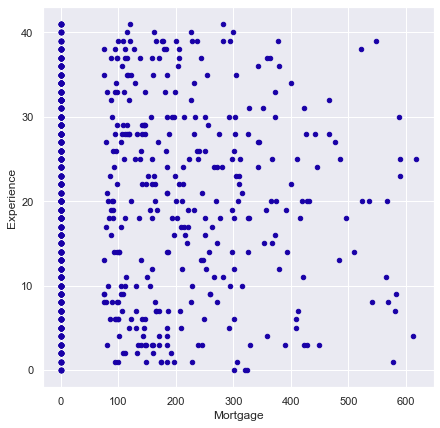

Mortgage by Income Strip Plot


<Figure size 1080x720 with 0 Axes>

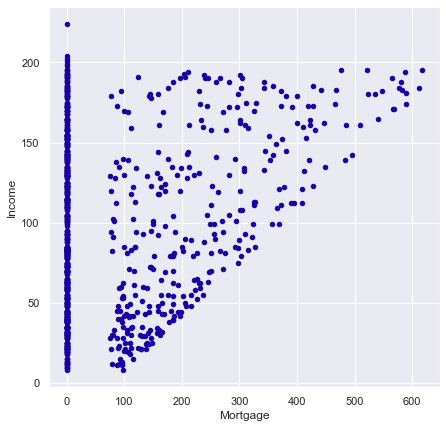

Mortgage by Family Strip Plot


<Figure size 1080x720 with 0 Axes>

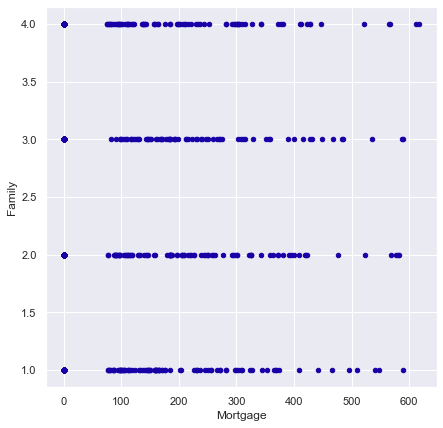

Mortgage by CCAvg Strip Plot


<Figure size 1080x720 with 0 Axes>

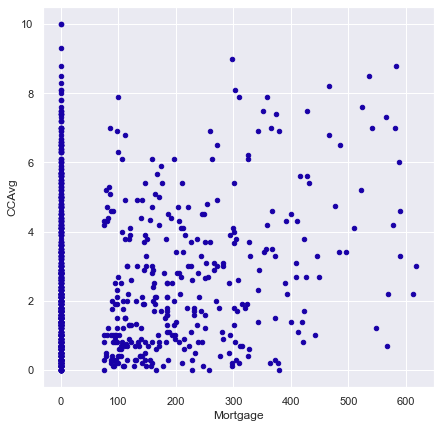

Mortgage by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

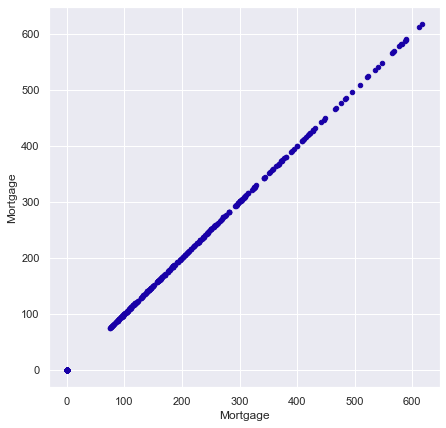

Mortgage by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

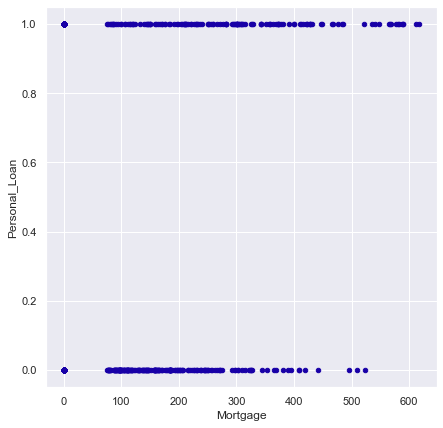

Mortgage by Securities_Account Strip Plot


<Figure size 1080x720 with 0 Axes>

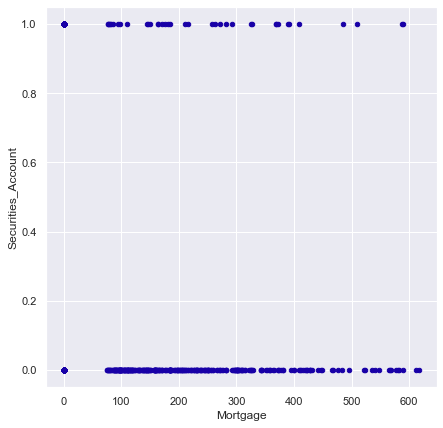

Mortgage by CD_Account Strip Plot


<Figure size 1080x720 with 0 Axes>

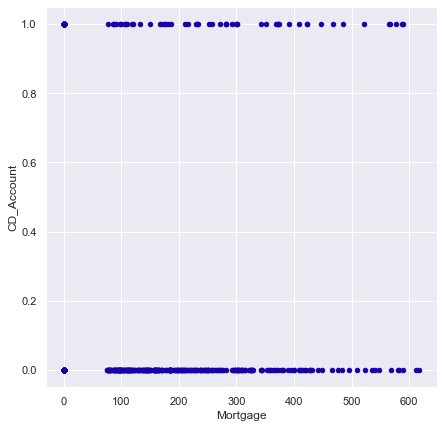

Mortgage by Online Strip Plot


<Figure size 1080x720 with 0 Axes>

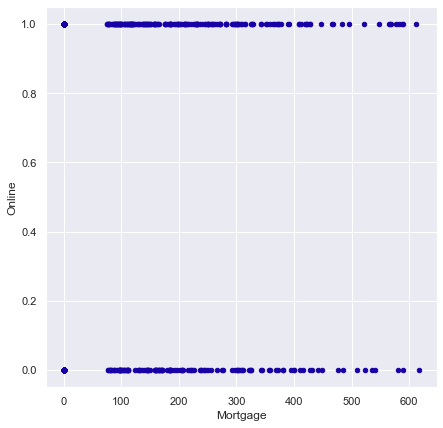

Mortgage by CreditCard Strip Plot


<Figure size 1080x720 with 0 Axes>

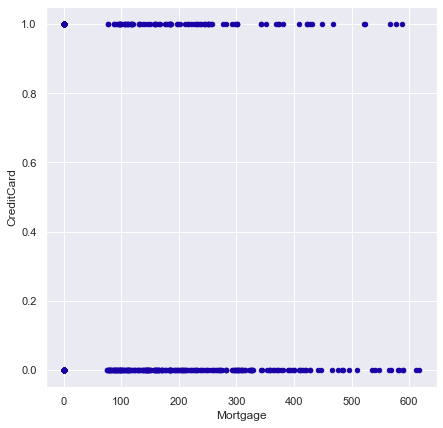

Mortgage by ZIPCode_91 Strip Plot


<Figure size 1080x720 with 0 Axes>

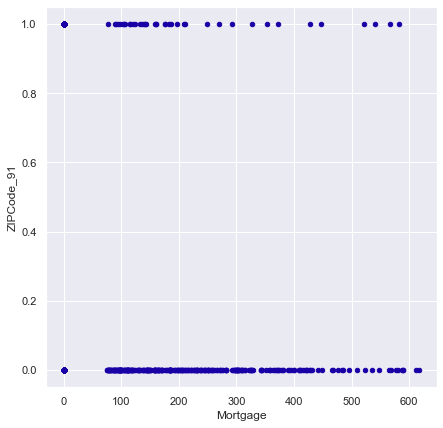

Mortgage by ZIPCode_92 Strip Plot


<Figure size 1080x720 with 0 Axes>

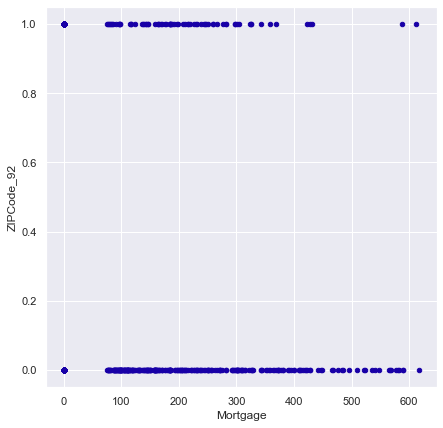

Mortgage by ZIPCode_93 Strip Plot


<Figure size 1080x720 with 0 Axes>

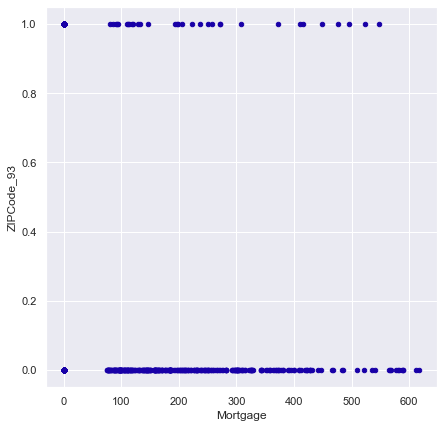

Mortgage by ZIPCode_94 Strip Plot


<Figure size 1080x720 with 0 Axes>

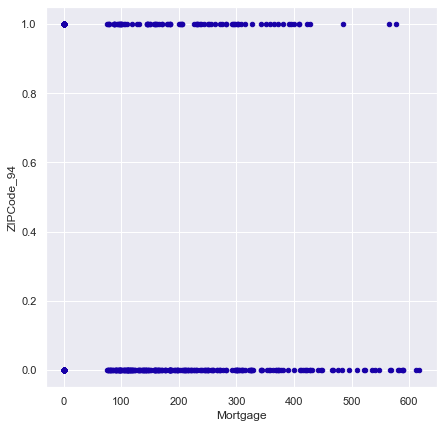

Mortgage by ZIPCode_95 Strip Plot


<Figure size 1080x720 with 0 Axes>

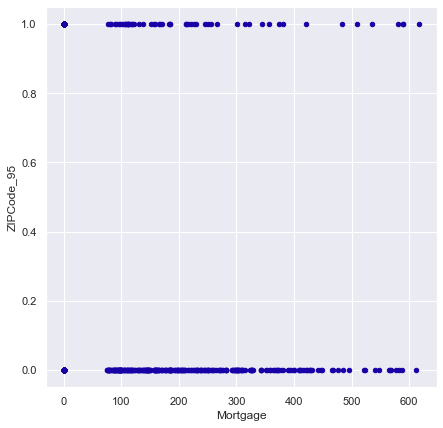

Mortgage by ZIPCode_96 Strip Plot


<Figure size 1080x720 with 0 Axes>

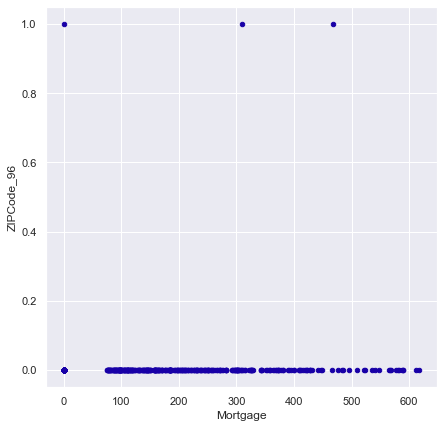

Mortgage by Education_Professional Strip Plot


<Figure size 1080x720 with 0 Axes>

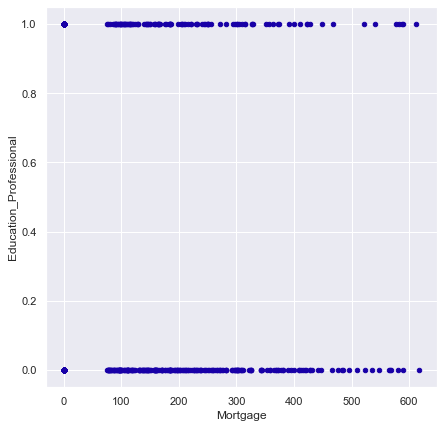

Mortgage by Education_Undergraduate Strip Plot


<Figure size 1080x720 with 0 Axes>

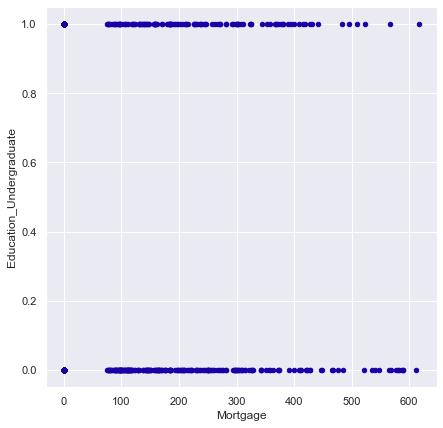

Mortgage by preds Strip Plot


<Figure size 1080x720 with 0 Axes>

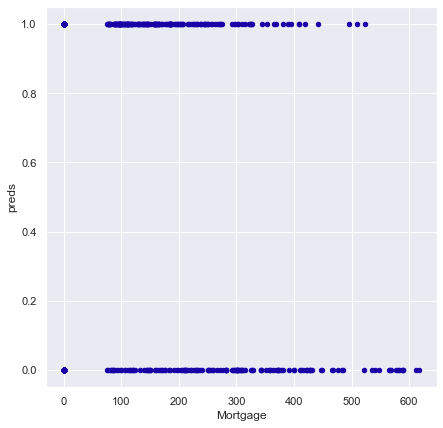

Personal_Loan by Age Strip Plot


<Figure size 1080x720 with 0 Axes>

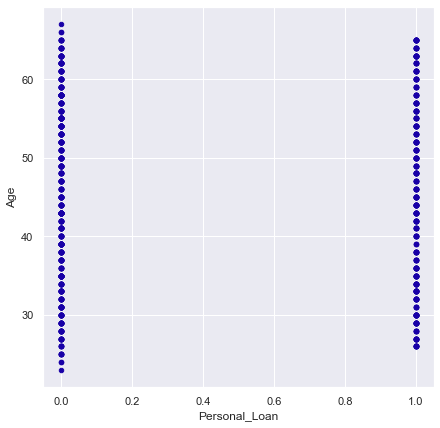

Personal_Loan by Experience Strip Plot


<Figure size 1080x720 with 0 Axes>

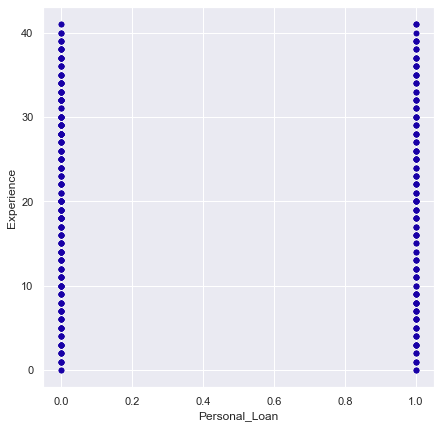

Personal_Loan by Income Strip Plot


<Figure size 1080x720 with 0 Axes>

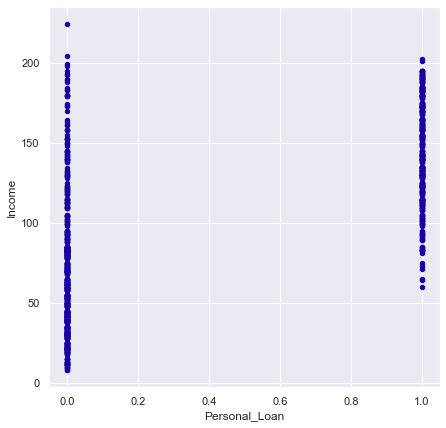

Personal_Loan by Family Strip Plot


<Figure size 1080x720 with 0 Axes>

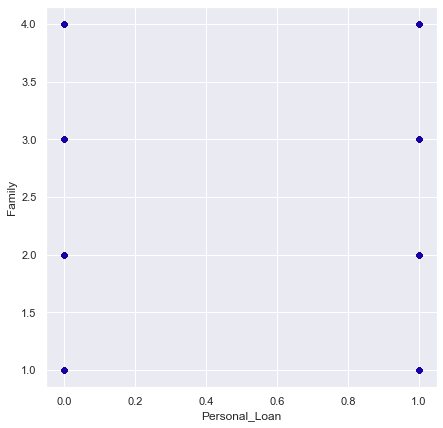

Personal_Loan by CCAvg Strip Plot


<Figure size 1080x720 with 0 Axes>

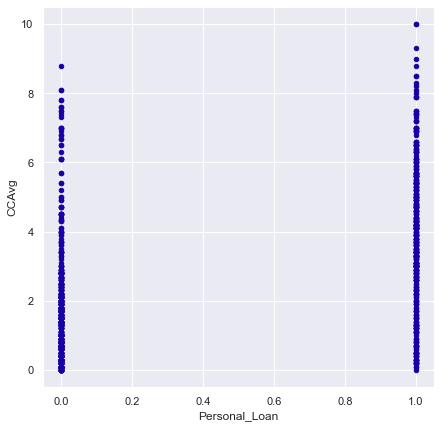

Personal_Loan by Mortgage Strip Plot


<Figure size 1080x720 with 0 Axes>

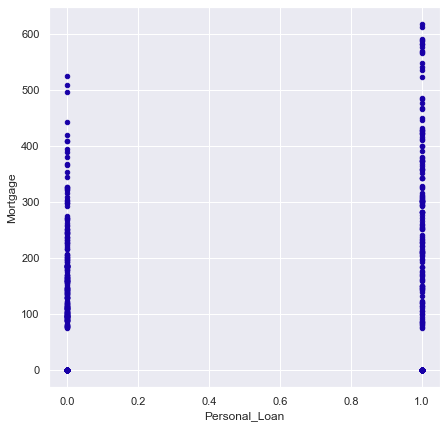

Personal_Loan by Personal_Loan Strip Plot


<Figure size 1080x720 with 0 Axes>

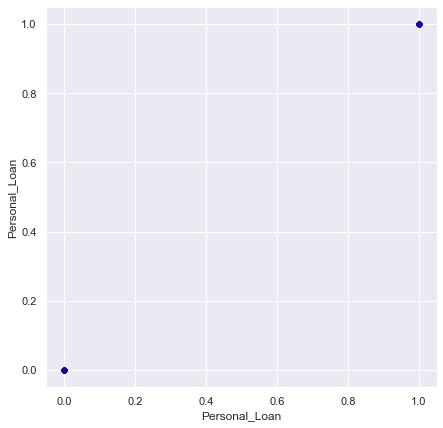

Personal_Loan by Securities_Account Strip Plot


<Figure size 1080x720 with 0 Axes>

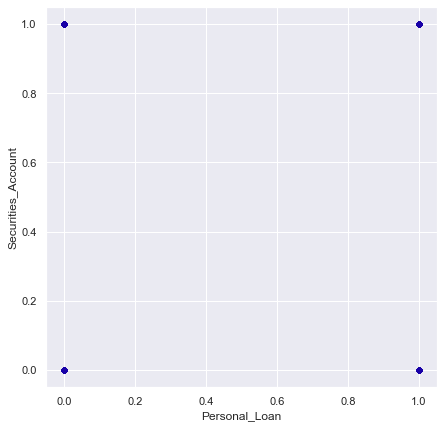

Personal_Loan by CD_Account Strip Plot


<Figure size 1080x720 with 0 Axes>

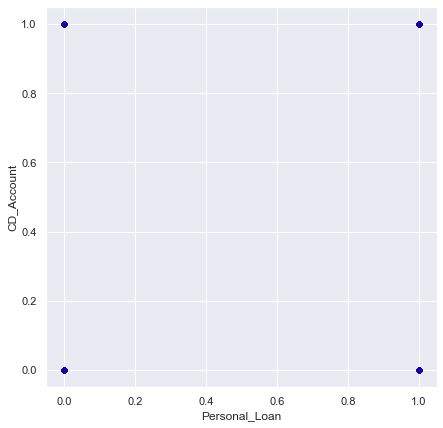

Personal_Loan by Online Strip Plot


<Figure size 1080x720 with 0 Axes>

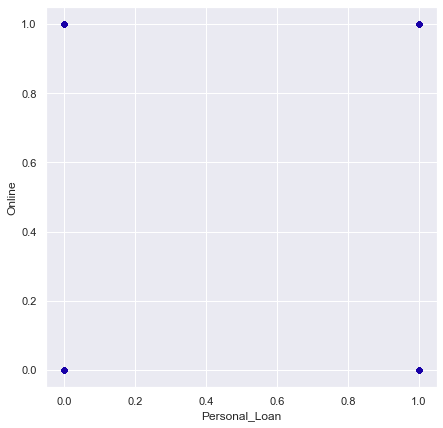

Personal_Loan by CreditCard Strip Plot


<Figure size 1080x720 with 0 Axes>

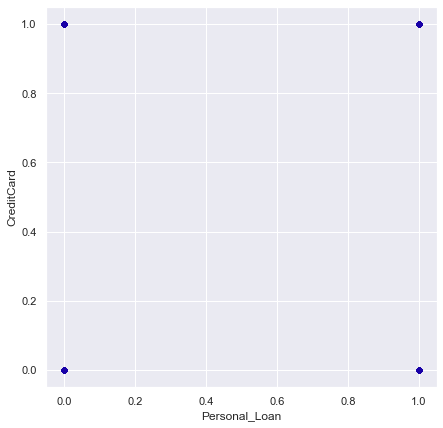

Personal_Loan by ZIPCode_91 Strip Plot


<Figure size 1080x720 with 0 Axes>

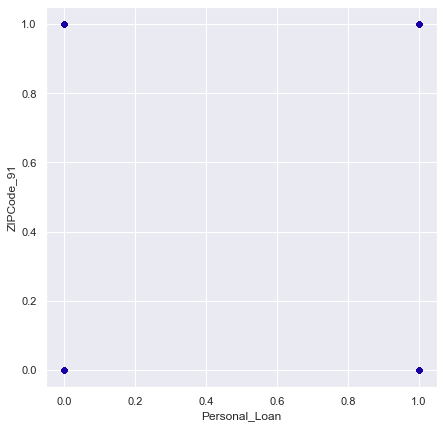

Personal_Loan by ZIPCode_92 Strip Plot


<Figure size 1080x720 with 0 Axes>

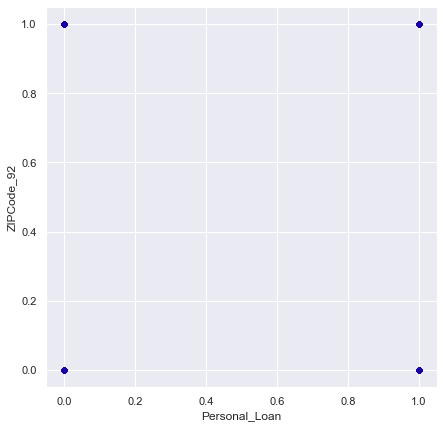

Personal_Loan by ZIPCode_93 Strip Plot


<Figure size 1080x720 with 0 Axes>

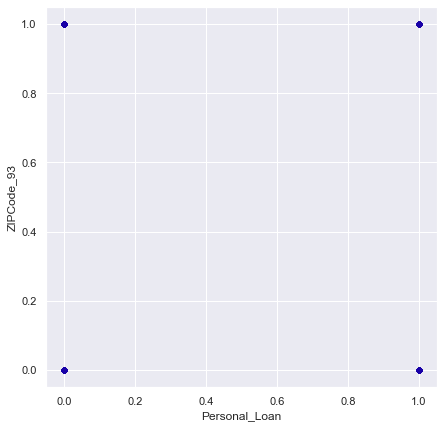

Personal_Loan by ZIPCode_94 Strip Plot


<Figure size 1080x720 with 0 Axes>

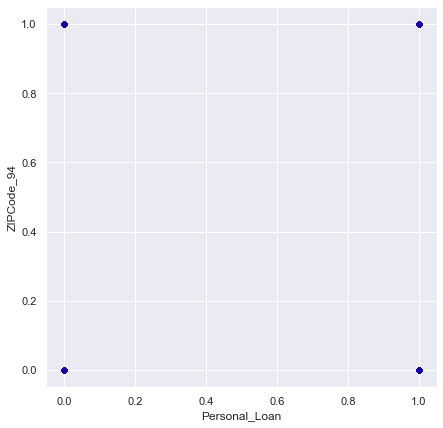

Personal_Loan by ZIPCode_95 Strip Plot


<Figure size 1080x720 with 0 Axes>

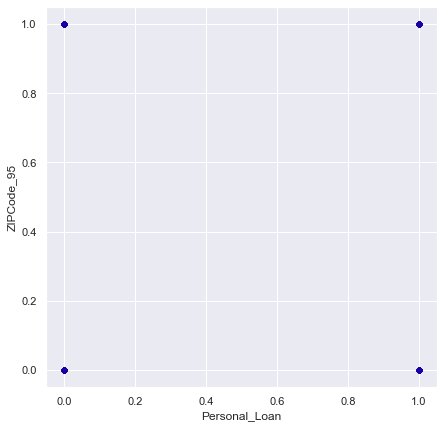

Personal_Loan by ZIPCode_96 Strip Plot


<Figure size 1080x720 with 0 Axes>

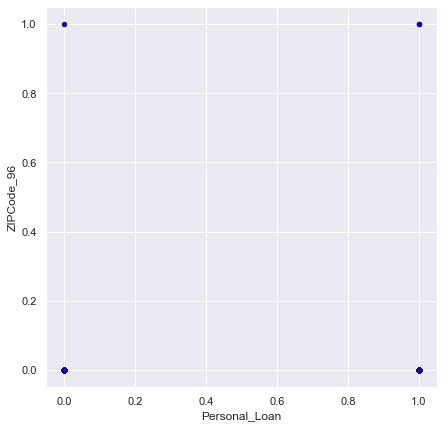

Personal_Loan by Education_Professional Strip Plot


<Figure size 1080x720 with 0 Axes>

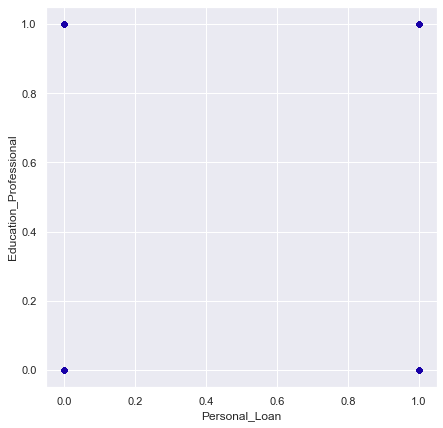

Personal_Loan by Education_Undergraduate Strip Plot


<Figure size 1080x720 with 0 Axes>

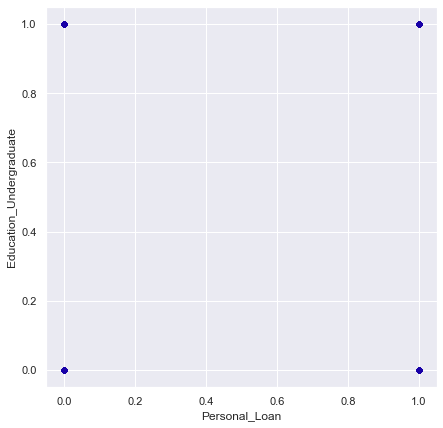

Personal_Loan by preds Strip Plot


<Figure size 1080x720 with 0 Axes>

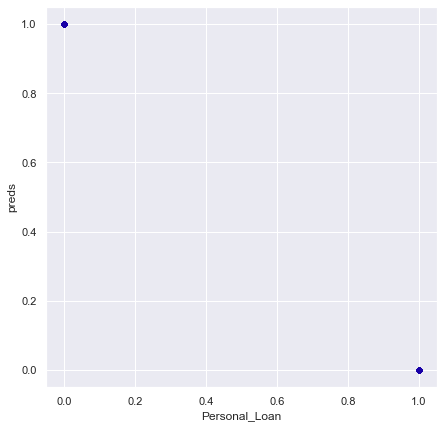

<IPython.core.display.Javascript object>

In [331]:
# lock subsets
nums = df_inc.loc[:, "Age":"Personal_Loan":1]
num = df_inc.loc[:, "Age":"preds":1]

# call column names for plotting
for a in nums.columns:
    for b in num.columns:  # for every numeric
        # Scatter plot against a numeric variable
        print(a, "by", b, "Strip Plot")
        plt.figure(figsize=(15, 10))
        df_inc.plot.scatter(x=a, y=b)
        plt.show()

### Correlation

In [332]:
# Correlation Analysis
corr = df_inc.corr()
display(corr)

,Age,Experience,Income,Family,CCAvg,Mortgage,Personal_Loan,Securities_Account,CD_Account,Online,CreditCard,ZIPCode_91,ZIPCode_92,ZIPCode_93,ZIPCode_94,ZIPCode_95,ZIPCode_96,Education_Professional,Education_Undergraduate,preds
Age,1.00,0.99,-0.04,-0.02,-0.02,-0.03,-0.02,-0.02,0.02,0.03,0.03,-0.02,-0.02,0.08,-0.00,-0.05,-0.00,0.02,-0.00,0.02
Experience,0.99,1.00,-0.04,-0.01,-0.03,-0.03,-0.03,-0.02,0.02,0.03,0.02,-0.02,-0.02,0.08,0.00,-0.06,-0.01,0.00,0.01,0.03
Income,-0.04,-0.04,1.00,-0.01,0.62,0.26,0.70,0.04,0.29,0.03,-0.01,0.01,-0.00,-0.02,0.02,-0.04,0.03,0.01,0.00,-0.70
Family,-0.02,-0.01,-0.01,1.00,-0.02,0.03,0.13,-0.03,0.04,0.02,0.04,-0.04,0.03,-0.00,0.05,-0.03,0.06,-0.09,-0.02,-0.13
CCAvg,-0.02,-0.03,0.62,-0.02,1.00,0.14,0.49,0.03,0.21,0.03,-0.01,0.02,0.00,-0.02,0.04,-0.01,0.08,0.01,0.00,-0.49
Mortgage,-0.03,-0.03,0.26,0.03,0.14,1.00,0.19,0.02,0.11,-0.00,-0.01,-0.02,0.01,0.04,-0.02,0.01,0.08,-0.01,0.03,-0.19
Personal_Loan,-0.02,-0.03,0.70,0.13,0.49,0.19,1.00,0.04,0.37,-0.00,-0.02,-0.03,0.02,0.01,0.01,-0.01,0.03,0.14,-0.25,-1.00
Securities_Account,-0.02,-0.02,0.04,-0.03,0.03,0.02,0.04,1.00,0.37,0.05,-0.03,-0.05,-0.01,0.01,0.06,-0.03,-0.02,-0.02,0.03,-0.04
CD_Account,0.02,0.02,0.29,0.04,0.21,0.11,0.37,0.37,1.00,0.24,0.33,-0.02,-0.03,0.07,0.01,-0.02,0.03,0.00,-0.05,-0.37
Online,0.03,0.03,0.03,0.02,0.03,-0.00,-0.00,0.05,0.24,1.00,-0.03,-0.01,-0.05,0.03,0.03,-0.03,-0.03,-0.04,-0.00,0.00


<IPython.core.display.Javascript object>

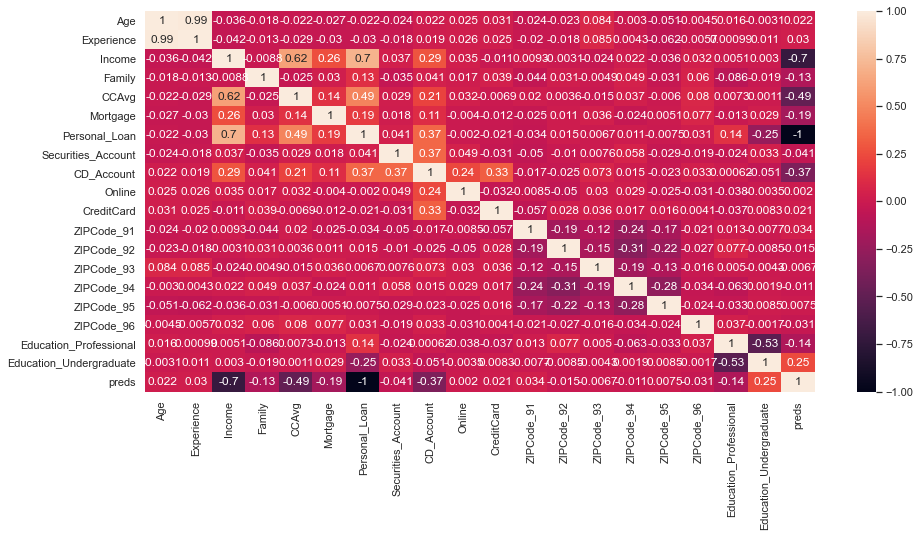

<IPython.core.display.Javascript object>

In [333]:
plt.figure(figsize=(15, 7))
sns.heatmap(df_inc.corr(), annot=True)
plt.show()

### Features of Interest

`Personal_Loan` as the dependent variable against every numeric variable.

In [334]:
df_inc[df_inc.Personal_Loan == 1].describe().T

,count,mean,std,min,25%,50%,75%,max
Age,397.00,45.28,11.66,26.00,35.00,45.00,55.00,65.00
Experience,397.00,20.10,11.65,0.00,9.00,20.00,30.00,41.00
Income,397.00,144.75,31.50,60.00,122.00,143.00,172.00,202.00
Family,397.00,2.59,1.12,1.00,2.00,3.00,4.00,4.00
CCAvg,397.00,3.85,2.08,0.00,2.50,3.80,5.30,10.00
Mortgage,397.00,105.59,164.62,0.00,0.00,0.00,205.00,617.00
Personal_Loan,397.00,1.00,0.00,1.00,1.00,1.00,1.00,1.00
Securities_Account,397.00,0.13,0.33,0.00,0.00,0.00,0.00,1.00
CD_Account,397.00,0.28,0.45,0.00,0.00,0.00,1.00,1.00
Online,397.00,0.61,0.49,0.00,0.00,1.00,1.00,1.00


<IPython.core.display.Javascript object>

In [335]:
df_inc[df_inc.Personal_Loan == 0].describe().T

,count,mean,std,min,25%,50%,75%,max
Age,623.00,45.81,11.26,23.00,36.00,46.00,55.00,67.00
Experience,623.00,20.79,11.11,0.00,11.00,20.00,30.00,41.00
Income,623.00,67.76,41.57,8.00,38.00,60.00,84.00,224.00
Family,623.00,2.29,1.13,1.00,1.00,2.00,3.00,4.00
CCAvg,623.00,1.76,1.61,0.00,0.70,1.40,2.20,8.80
Mortgage,623.00,56.00,98.25,0.00,0.00,0.00,100.00,524.00
Personal_Loan,623.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Securities_Account,623.00,0.10,0.30,0.00,0.00,0.00,0.00,1.00
CD_Account,623.00,0.03,0.18,0.00,0.00,0.00,0.00,1.00
Online,623.00,0.61,0.49,0.00,0.00,1.00,1.00,1.00


<IPython.core.display.Javascript object>

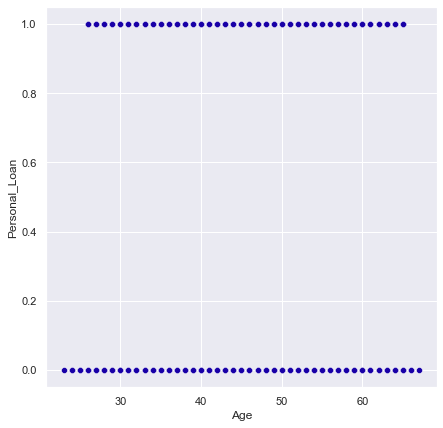

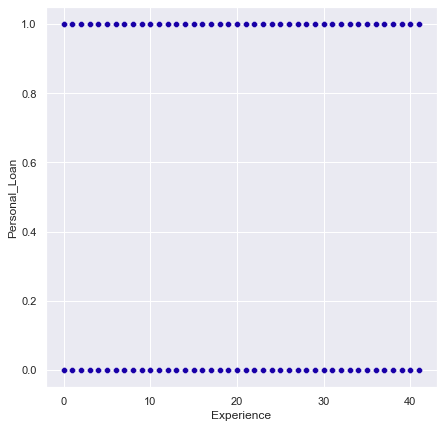

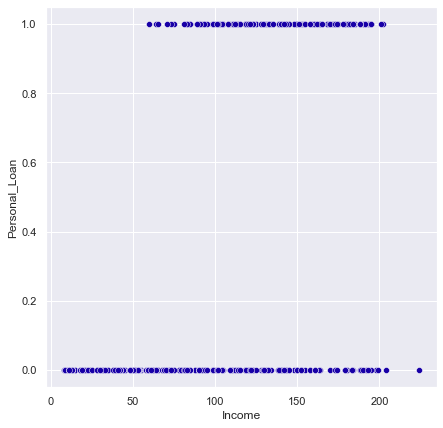

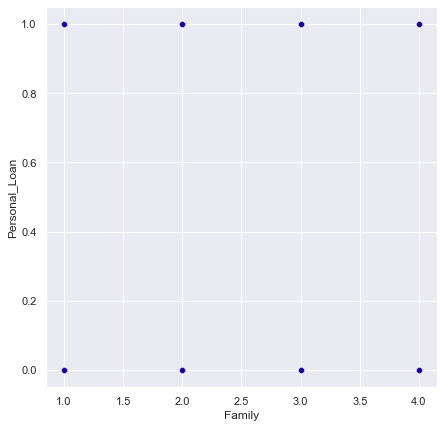

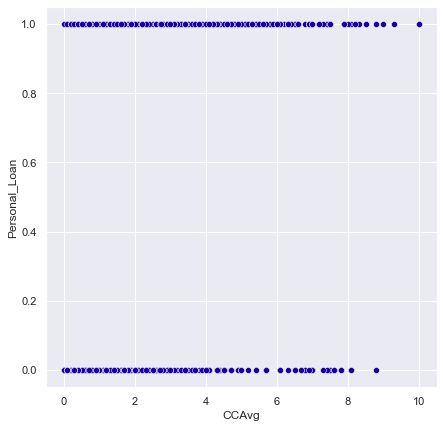

...

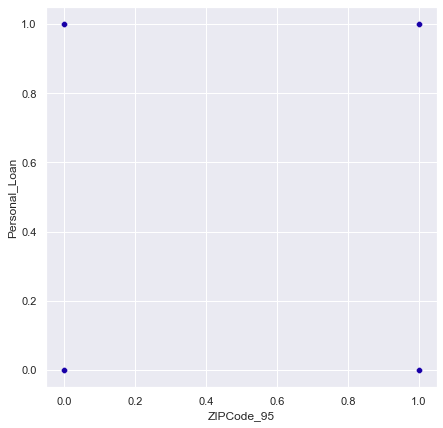

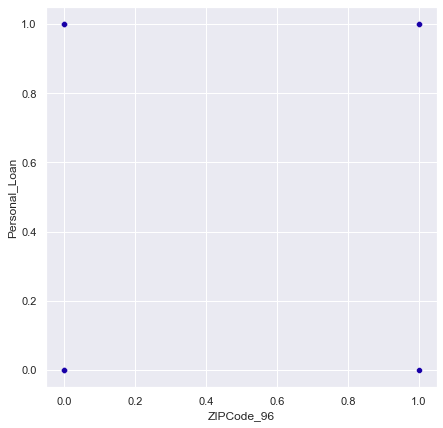

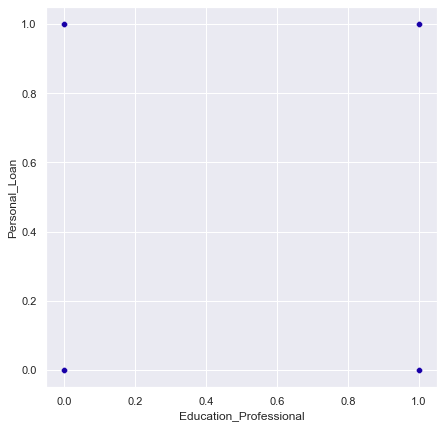

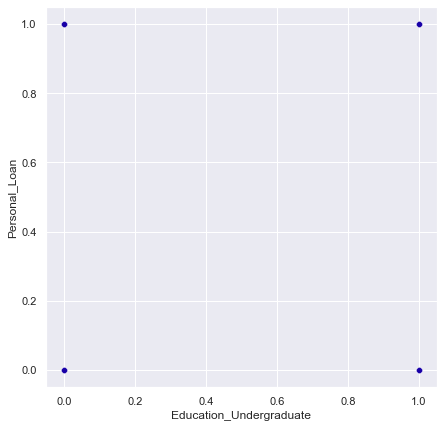

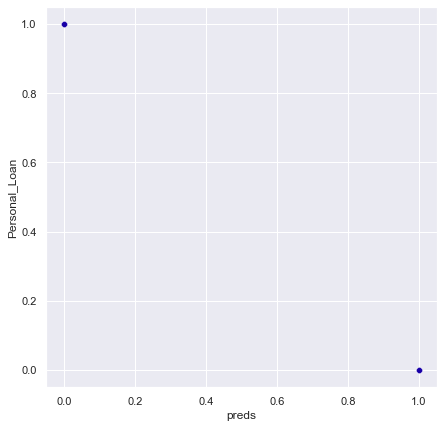

<IPython.core.display.Javascript object>

In [336]:
# plot indepdents against dependent
for i, variable in enumerate(df_inc):
    sns.scatterplot(x=df[variable], y=df_inc.Personal_Loan)
    plt.show()

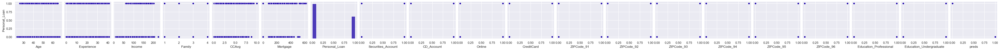

<IPython.core.display.Javascript object>

In [337]:
# create pairplot
sns.pairplot(data=df_inc, y_vars=["Personal_Loan"], x_vars=df_inc.columns)

In [338]:
import warnings

warnings.filterwarnings("ignore")

# Function to plot stacked bar chart
def stacked_plot(x):
    sns.set(palette="nipy_spectral")
    tab1 = pd.crosstab(x, df_inc["Personal_Loan"], margins=True)
    print(tab1)
    print("-" * 120)
    tab = pd.crosstab(x, df_inc["Personal_Loan"], normalize="index")
    tab.plot(kind="bar", stacked=True, figsize=(10, 5))
    # plt.legend(loc='lower left', frameon=False)
    # plt.legend(loc="upper left", bbox_to_anchor=(0,1))
    plt.show()

<IPython.core.display.Javascript object>

Personal_Loan         0    1   All
Securities_Account                
0                   561  347   908
1                    62   50   112
All                 623  397  1020
------------------------------------------------------------------------------------------------------------------------


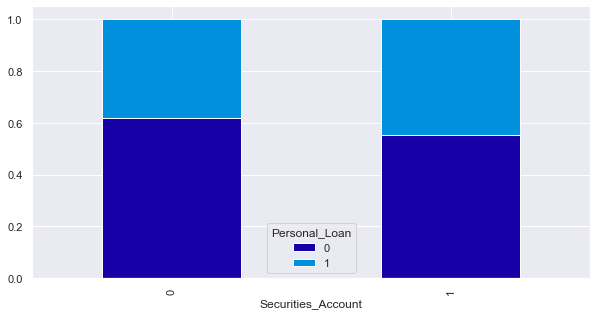

Personal_Loan    0    1   All
CD_Account                   
0              603  284   887
1               20  113   133
All            623  397  1020
------------------------------------------------------------------------------------------------------------------------


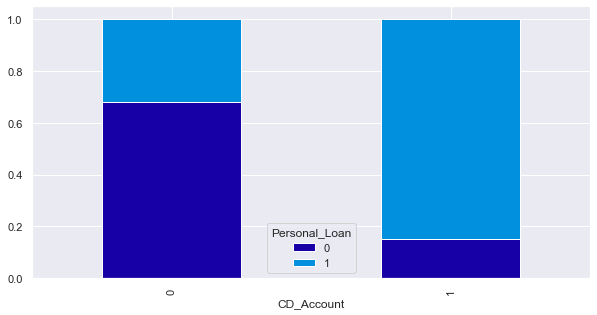

Personal_Loan    0    1   All
Online                       
0              242  155   397
1              381  242   623
All            623  397  1020
------------------------------------------------------------------------------------------------------------------------


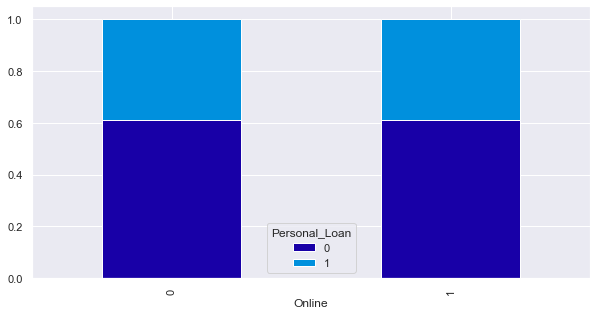

Personal_Loan    0    1   All
CreditCard                   
0              432  283   715
1              191  114   305
All            623  397  1020
------------------------------------------------------------------------------------------------------------------------


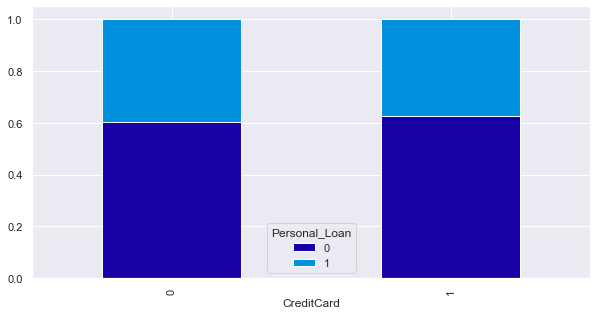

<IPython.core.display.Javascript object>

In [339]:
# stack plots against categoricals
cats = df_inc.loc[:, "Securities_Account":"CreditCard"]

for i in cats:
    stacked_plot(df_inc[i])

##### Predicted bar charts

In [340]:
import warnings

warnings.filterwarnings("ignore")

# Function to plot stacked bar chart
def stacked_plot(x):
    sns.set(palette="nipy_spectral")
    tab1 = pd.crosstab(x, df_inc["preds"], margins=True)
    print(tab1)
    print("-" * 120)
    tab = pd.crosstab(x, df_inc["preds"], normalize="index")
    tab.plot(kind="bar", stacked=True, figsize=(10, 5))
    # plt.legend(loc='lower left', frameon=False)
    # plt.legend(loc="upper left", bbox_to_anchor=(0,1))
    plt.show()

<IPython.core.display.Javascript object>

preds                 0    1   All
Securities_Account                
0                   347  561   908
1                    50   62   112
All                 397  623  1020
------------------------------------------------------------------------------------------------------------------------


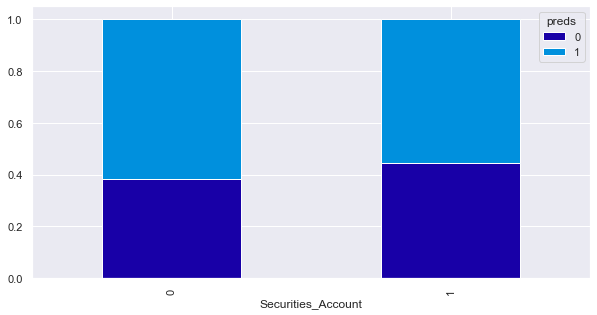

preds         0    1   All
CD_Account                
0           284  603   887
1           113   20   133
All         397  623  1020
------------------------------------------------------------------------------------------------------------------------


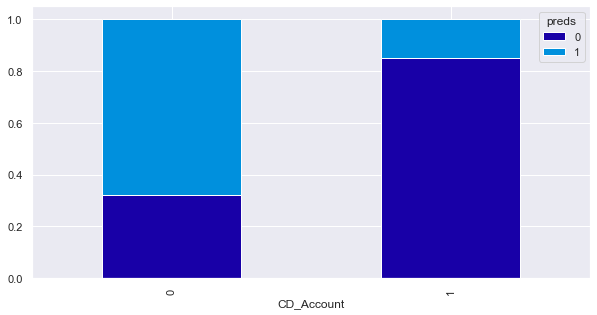

preds     0    1   All
Online                
0       155  242   397
1       242  381   623
All     397  623  1020
------------------------------------------------------------------------------------------------------------------------


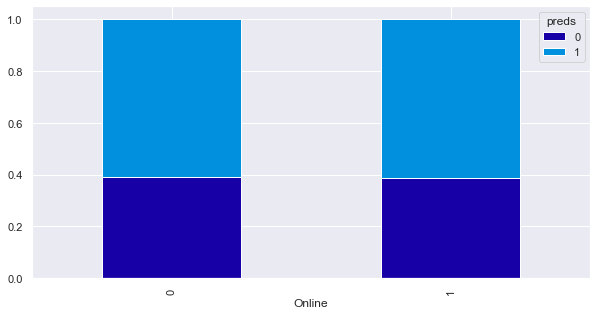

preds         0    1   All
CreditCard                
0           283  432   715
1           114  191   305
All         397  623  1020
------------------------------------------------------------------------------------------------------------------------


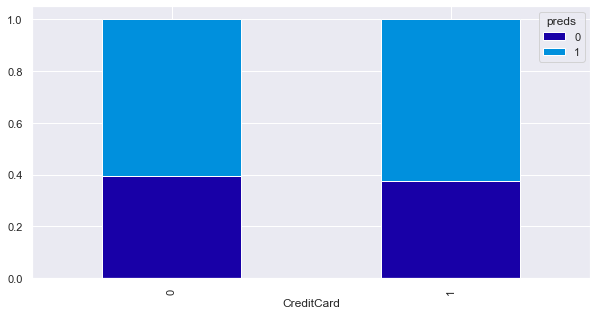

<IPython.core.display.Javascript object>

In [341]:
import warnings

warnings.filterwarnings("ignore")

# stack plots against categoricals
cats = df_inc.loc[:, "Securities_Account":"CreditCard"]

for i in cats:
    stacked_plot(df_inc[i])

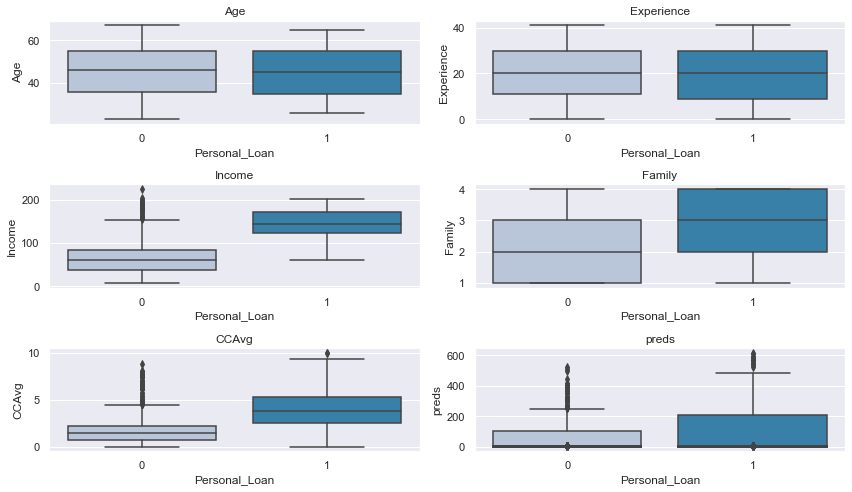

<IPython.core.display.Javascript object>

In [342]:
import warnings

warnings.filterwarnings("ignore")

# create subplots against target variable
cols = df_inc.columns
plt.figure(figsize=(12, 7))

for i, variable in enumerate(cols):
    try:
        plt.subplot(3, 2, i + 1)
    except ValueError:
        pass  # do nothing!
    sns.boxplot(df_inc["Personal_Loan"], df_inc[variable], palette="PuBu")
    plt.tight_layout()
    plt.title(variable)
plt.show()

#### Examine Predicated vs Actual Values

In [343]:
# cross table
pd.crosstab(df_inc.Personal_Loan, df_inc.preds)

preds,0,1
Personal_Loan,,
0,0,623
1,397,0


<IPython.core.display.Javascript object>

##### False Positives

In [344]:
# make subset
df_fp = df_inc[(df_inc.Personal_Loan == 0) & (df_inc.preds == 1)]

<IPython.core.display.Javascript object>

In [345]:
# get statistics
df_fp.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,623.00,45.81,11.26,23.00,36.00,46.00,55.00,67.00
Experience,623.00,20.79,11.11,0.00,11.00,20.00,30.00,41.00
Income,623.00,67.76,41.57,8.00,38.00,60.00,84.00,224.00
Family,623.00,2.29,1.13,1.00,1.00,2.00,3.00,4.00
CCAvg,623.00,1.76,1.61,0.00,0.70,1.40,2.20,8.80
Mortgage,623.00,56.00,98.25,0.00,0.00,0.00,100.00,524.00
Personal_Loan,623.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Securities_Account,623.00,0.10,0.30,0.00,0.00,0.00,0.00,1.00
CD_Account,623.00,0.03,0.18,0.00,0.00,0.00,0.00,1.00
Online,623.00,0.61,0.49,0.00,0.00,1.00,1.00,1.00


<IPython.core.display.Javascript object>

##### False Negatives

In [346]:
# make subset
df_fn = df_inc[(df_inc.Personal_Loan == 1) & (df_inc.preds == 0)]

<IPython.core.display.Javascript object>

In [347]:
# get statistics
df_fn.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,397.00,45.28,11.66,26.00,35.00,45.00,55.00,65.00
Experience,397.00,20.10,11.65,0.00,9.00,20.00,30.00,41.00
Income,397.00,144.75,31.50,60.00,122.00,143.00,172.00,202.00
Family,397.00,2.59,1.12,1.00,2.00,3.00,4.00,4.00
CCAvg,397.00,3.85,2.08,0.00,2.50,3.80,5.30,10.00
Mortgage,397.00,105.59,164.62,0.00,0.00,0.00,205.00,617.00
Personal_Loan,397.00,1.00,0.00,1.00,1.00,1.00,1.00,1.00
Securities_Account,397.00,0.13,0.33,0.00,0.00,0.00,0.00,1.00
CD_Account,397.00,0.28,0.45,0.00,0.00,0.00,1.00,1.00
Online,397.00,0.61,0.49,0.00,0.00,1.00,1.00,1.00


<IPython.core.display.Javascript object>

* Our incorrectly predicated and therefore now false negatives are high income earners, with 2.5+ kids, and a ccredit balance of over 3.8k, who do not have CD_accounts.

### Key Observations on Incorrectly Predicted Data

In [325]:
df_inc.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,1020.00,45.60,11.41,23.00,35.00,45.00,55.00,67.00
Experience,1020.00,20.52,11.32,0.00,11.00,20.00,30.00,41.00
Income,1020.00,97.73,53.40,8.00,50.00,91.00,141.25,224.00
Family,1020.00,2.41,1.14,1.00,1.00,2.00,3.00,4.00
CCAvg,1020.00,2.57,2.07,0.00,0.90,2.00,3.90,10.00
Mortgage,1020.00,75.30,130.41,0.00,0.00,0.00,119.00,617.00
Personal_Loan,1020.00,0.39,0.49,0.00,0.00,0.00,1.00,1.00
Securities_Account,1020.00,0.11,0.31,0.00,0.00,0.00,0.00,1.00
CD_Account,1020.00,0.13,0.34,0.00,0.00,0.00,0.00,1.00
Online,1020.00,0.61,0.49,0.00,0.00,1.00,1.00,1.00


<IPython.core.display.Javascript object>

### Insights

Does the make-up of the incorrectly predicated data customers match the original or is it unique?
- In large part the customer profile of these folks is the same.

What is the pattern, if any, in the falsely predicated data?
- Predicted non-loan accepters (current asset customers) tended to have security accounts.
- Those incorrectly predicted customers tended to have higher incomes.
- These customers who were incorrectly labeled non-accepters of loans but were in fact accepters tended to have larger families.
- Credit Card average debt is lower among those who were false positives: liability customers after the last campaign who were predicted to accept a loan offer in the next campaign.
- Mortgage debt is higher (average) among predicted loan accepters than predicted non-loan accepters.
- Those who already have CD accounts are more likely to be predicted as loan-accepters from the next campaign and are currently liability customers.

`ID.` : 
 - 1020 of 5000 (~20%) customers incorrectly predicted from a bank is not a large sample size. 

`Age` :
- Ranges from 23 to 67 years old - the same as the original data.
- These customers tend to have CD accounts.
- Has a strong correlation with `Experience`.

`Experience` : 
- The mean years of experience is 20.33 and is similar to the original.
- Experience mean is 20 years which is the same as original with a range of 18 - 28.
- Customers will `CD_Account` have slightly more experience.
- Correlated with `Age` as before.

`Income` : 
- The median is 91k vs  64.00 (thousands) of dollars in the original.
- Income average is around 97.73k with most popular at 83k.
- Those who were predicted not to accept another loan offer via the ad but were asset customers have considerably higher income.
- Strongly correlated with `preds` values showing the incorrect prediction might be related to income.

` ZIP Code` : 
 - Most of the data is in zipcodes starting with 96 then 93.

`Family` : 
 - The range of family members is 1 - 4.
 - The mean is 2.41, the median is 2 with full range present and 1 being popular (same as the original). The mode is 1.
 - Those who accepted a loan offer tend to have more than 2 members in the family (2.41 is the mean).

`CCAvg` : 
 - There is atleast one customer who has >10,000USD in average credit card spending.
 - The distribution looks similar to the original.
 - Mean is 2.57 (thousand) with .30 - .80 being popular.
 - ~70% correlation with income.


`Education` : 
 - Leans towards not have undergraduate or professional degrees.
 

`Mortgage` : 
 - Mean is 73.5k which is like the original.
 - Has a number of outliers in the higher values.
 - The difference in average between false positive (non-accepters) and false negative (accepters) is 50kUSD.


`Personal_Loan` : 
 - Not accepting a loan from the last campaign is the most popular choice.
 - Only 623 customers were predicted to take a loan after the last campaign, about the same as the original.
 - Is again correlated with `Income`.


`Securities_Account` : 
 - Those who are predicted to not have loans after an offer (but are asset customers) are more likely to have a security account.
 - The vast majority do not have an account (~75%).

`CD_Account` : 
 - The majority of `Personal Loan` accepters do not have CD accounts.
 
`Online` : 
 - The use of online features is about even for this group between loan accepters and non.
 - The majority of this group does use online features.


`CreditCard` : 
 - The majority of predicted loan accepters (who are non-loan accepters) is the highest amongst the options.
 - The majority of loan purchasers who were predicted to be non-loan purchasers did not have credit cards.

#  Business Insights

### Conclusions

**Recap**
- We analyzed the "Personal Loan offer acceptance" using different techniques and used a Logistic Regression model and Decision Tree Classifier to build a predictive model for the problem.

- The model built can be used to predict if a potential asset customer is going to accept a loan offer through target marketing or not. 

- We visualized different trees and their confusion matrix to get a better understanding of the model. Easy interpretation is one of the key benefits of Decision Trees.

- We verified the fact that how much less data preparation is needed for Decision Trees and such a simple model gave good results even with outliers and imbalanced classes which shows the robustness of Decision Trees.

- We established the importance of hyper-parameters/ pruning to reduce overfitting.

**Objectives**

* To predict whether a liability customer will buy a personal loan or not.

* Which variables are most significant.

* Which segment of customers should be targeted more.

***According to the Logistic Regression model***

* To predict whether a liability customer will buy a personal loan or not.

    a) We can accurately (to ~64%) predict whether a liability customer will buy a personal loan or not in the next campaign.
    

* Which variables are most significant:

    b) Openning a CD account, the likelihood of converting to an asset customer increases the log odds of loan purchases by 3.84% or almost 4x and decreases 4x if you have an undergraduate degree.


***According to the Decision Tree Model*** 

* To predict whether a liability customer will buy a personal loan or not.

    a) We can accurately (to ~86%) predict whether a liability customer will buy a personal loan or not in the next campaign. We reduced the number of undesirable False Negatives to <1%.
    

* Which variables are most significant.

    b)  `Income`, `Education`, `Family` , and `CCAvg` are the most important features in that order.


***Which segment of customers should be targeted more.***

We can conclude that liability customers targeted in the last campaign include folks who are 35 - 43, have 9-32 years of professional experience, make around 38-44k (dollars) a year, live near Palo Alto or Berkeley, have 1 -2 children, have credit debt of 300-1000 (dollars)/month, have an undergraduate degree, no mortgage, non-investors, non-CD holders, online feature-users, and credit card holders with other banks.

Now the key to this problem is that the target customer is both a liability customer before and after the last campaign (they have no loan and are not borrowers) and are predicted to be loan purchases (have a loan and be a borrower). This class of people are considered False Positives because it is saying that in the future "test" of another ad campaign they will be shown to be positive, while in the past they were not positive (non-loan accepters). The make-up of these people is slightly different than the over-all data-set since it comprises both False Positives and True Positives. We are going to target the True Positives but we also want to target those who could convert since that is our goal: conversion. Since they are still liability customers after the last campaign they are considered useful or potential asset customers and are worth targeting even though the common sense tells us that if they did not purchase a loan from the last campaign then they would not in the next. But the difference between the last and the first campaign is this very analysis (an assumption). Where as in the first campaign we broadly marketed to every liability customer here we are targeting two segments: those who are still liability customers and those who are asset customers but could be second-time loan purchasers. The conversion rate or success ratio is not agnostic to the categorization and only cares that someone who does not have a loan gets a loan. Even though people who do get another loan will be a win for the campaign as it is the probability of purchasing a loan and not the probability of purchasing a loan for the first time. Though more broadly we do want new asset customers meaning liability customers who convert to asset customers.

All predicted positives are then segmented as follows:

| Age  | Experience  | Income | ZIPCode | Family | CCAvg | Education | Mortgage | Personal_Loan | Securities_Account | CD_Account |  Online | CreditCard |
| --- | --- | --- | --- | --- | --- | --- | --- | --- | --- | --- | --- | --- |
| 35 - 58 | 18 -28 | 39 - 83 | Berkeley, Standford, Los Angeles CA | 1 - 2 | .3 - 1 | 1 or 3 | 0 | 0 | 0 | 1 | 0 | 1 |


### Recommendations

My advice would be to try the following:

* Target marketing - towards liability customers ages 35 - 58, with 18 - 28 years of professional experience, who make about 39k to 83k USD a year, and live in the Berkeley, Standford, Los Angeles areas, who have a family size of 1 or 2, and credit debt of 300 to 1000USD a month. They are either Undergraduates or Professioals who have no mortgage, no current loan, are not investors, have a certificate of deposit, do not use online banking feautures and have a credit card with another bank.

* Try broadening the question to include whether or not loan accepters (current asset customers) tend to purchase a second loan ***at all***. That is, widen the population of the data to understand the behavior of first-time loan borrowers and whether or not (and how much) they are likely to get a second loan. This will tell you whether targeting the same liability customers in subsequent campaigns is a worth-while effort or not.

* Get more data on customers - The bank should keep more details about such customers like hometown address, etc. to be able to track them and include them in analysis. 

* Business savvy - Initiate schemes/offers on liability customers to attract them to become asset customers.

* Customer retention - Member Loyalty programs initiatives like special discounts, deals, etc can be provided to current asset customers to get them coming back for additional loans.

* General marketing - previous loan accepters had higher incomes and more family members and these types should be targeted in the future.

* Loan offers appeal - using this customer profile but also the best of psychology to target market to potential customers. The average customer purchases based on emotions and not economic prowess so consider these factors.

* Gather better data - do a survey on the loan accepters to better understand their reasons for purchasing the loan. Include this information in further research and target marketing.

### Data scientist things to try

* Try tuning the model using the different hyper-parameters.

* Try getting a dataset from the next campaign which includes whether the customer has a checking or savings account.

* Try getting additional data points from liability customers such as car ownership (car loans), ages of children (college loans) and credit score (pay-day loans).

* Looking at the ID's to know who we are targeting and target market them.